In [1]:
from google.colab import files
src = list(files.upload().values())[0]
open('NetworkSIR.py','wb').write(src)

Saving NetworkSIR.py to NetworkSIR.py


6180

In [2]:
from google.colab import files
src = list(files.upload().values())[0]
open('centralitynodes.py','wb').write(src)

Saving centralitynodes.py to centralitynodes.py


4260

IMPORT DEL MODULO PYTHON IN COLAB

IMPORT DEL FILE/FILES CSV IN COLAB

In [3]:
uploaded = files.upload()

Saving musae_ENGB_edges.csv to musae_ENGB_edges.csv


In [4]:
from NetworkSIR import Sir
import pandas as pd
import numpy as np
from tabulate import tabulate

In [5]:
# run random simulation and collect the node super spreaders for all simulation
def random_simulation(init_infect, filename, delimiter, p_trans, t_rec, t_sus, t_sim, num_sim):

  networks = []
  spreaders_df = pd.DataFrame()
  
  if num_sim > 1:
    for i in range(num_sim):
      networks.append(Sir(init_infect, filename, delimiter))
  
    for network in networks:
      spread_count = network.simulation(p_trans, t_rec, t_sus, t_sim)
      spreaders_df = spreaders_df.append(spread_count)
  
    top_spreaders = spreaders_df.groupby(['NODE'])['SPREAD_COUNTS'].count().reset_index(
    name='FREQUENCY').sort_values(['FREQUENCY'], ascending=False)
  
    top_spreaders.index = np.arange(1, len(top_spreaders) + 1)
    top_spreaders.index.name = 'RANK'
    top_15 = top_spreaders[:15]
    print(tabulate(top_15, headers='keys', tablefmt='psql'))
  else: #else if is only 1 sim, we get the draw graph output
    sim = Sir(init_infect, filename, delimiter)
    sim.draw_network()
    sim.simulation(p_trans, t_rec, t_sus, t_sim)
    sim.draw_network()

SIMULAZIONI SINGOLE

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: FutureWarning: In a future version of pandas all arguments of read_csv except for the argument 'filepath_or_buffer' will be keyword-only


Nodi Tot. Grafo:4039
Nodi Infetti Iniziali:25
:[225, 298, 899, 912, 1022, 1303, 2292, 721, 745, 2047, 2285, 2727, 3008, 3031, 3093, 3276, 1978, 1987, 2092, 2120, 2366, 2479, 3689, 3778, 3843]


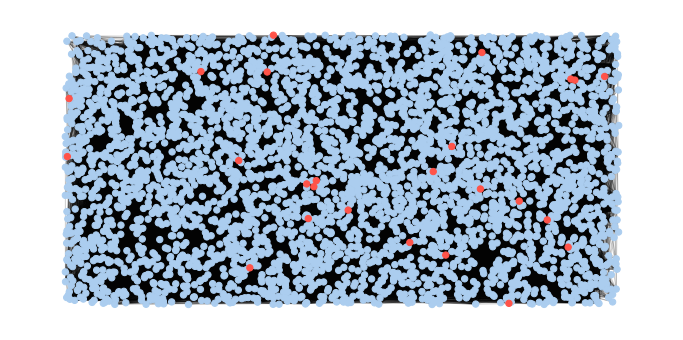

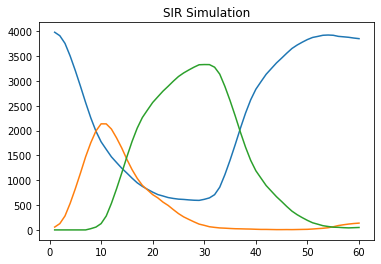

Giorno 60 :
Suscettibili: 3853
Infetti: 137
Guariti: 49
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             122 |
|      2 |   1684 |              98 |
|      3 |      0 |              84 |
|      4 |   3437 |              84 |
|      5 |   1912 |              39 |
|      6 |    686 |              20 |
|      7 |    348 |              17 |
|      8 |   2047 |              17 |
|      9 |     56 |              15 |
|     10 |   2543 |              12 |
|     11 |   2391 |              12 |
|     12 |   2292 |              12 |
|     13 |   3019 |              12 |
|     14 |    414 |              11 |
|     15 |    484 |              11 |
+--------+--------+-----------------+


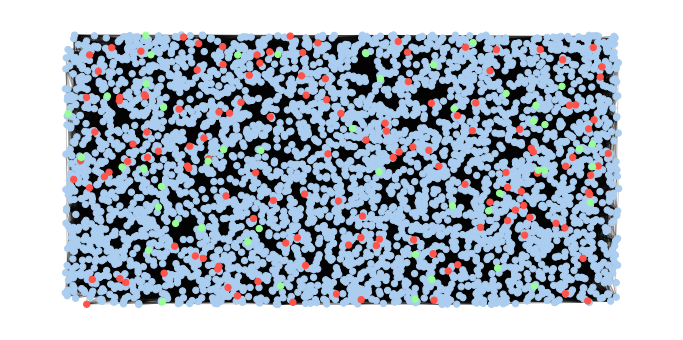

In [7]:
#input parametri simulazione:p_trans, t_rec, t_sus, t_sim, num_sim 
random_simulation(25, 'facebook_combined.csv', ' ', 0.02, 7, 21, 60, 1)

seconda simulazione con probabilità infezione al 5%

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: FutureWarning: In a future version of pandas all arguments of read_csv except for the argument 'filepath_or_buffer' will be keyword-only


Nodi Tot. Grafo:4039
Nodi Infetti Iniziali:25
:[39, 110, 295, 1019, 1041, 1133, 1252, 1270, 1430, 1780, 1806, 777, 3136, 2137, 2947, 3098, 3415, 1988, 2000, 2162, 2270, 2637, 3519, 3589, 3754]


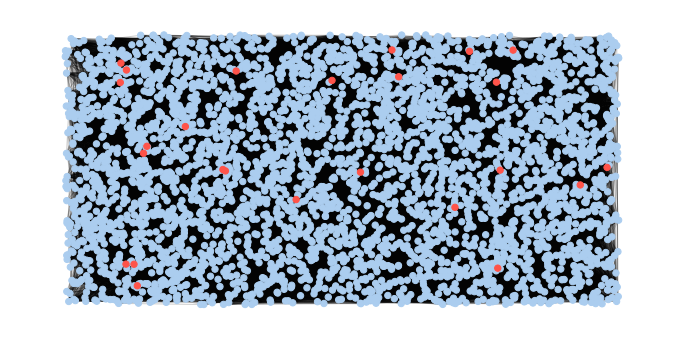

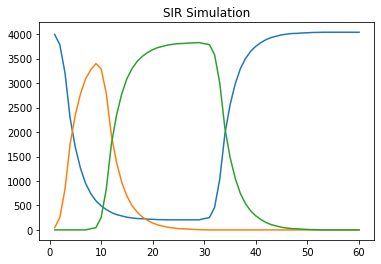

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             212 |
|      2 |   3437 |             136 |
|      3 |   1912 |             128 |
|      4 |   1684 |              92 |
|      5 |      0 |              63 |
|      6 |    414 |              28 |
|      7 |    686 |              26 |
|      8 |   3980 |              22 |
|      9 |   2266 |              21 |
|     10 |    348 |              20 |
|     11 |    483 |              18 |
|     12 |   2074 |              16 |
|     13 |   2724 |              12 |
|     14 |    517 |              12 |
|     15 |    698 |              12 |
+--------+--------+-----------------+


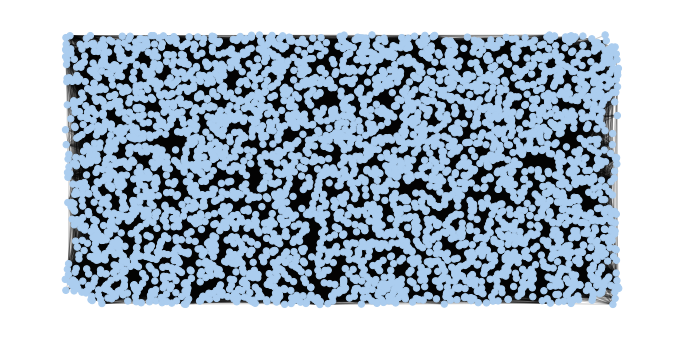

In [8]:
#input parametri simulazione:p_trans, t_rec, t_sus, t_sim, num_sim
random_simulation(25, 'facebook_combined.csv', ' ', 0.05, 7, 21, 60, 1)

aumento p_trans a 25%, t_rec 14 giorni in periodo di 180 giorni. In una rete modestamente grande, con un t_sus grande la malattia tenderà sempre a scomparire

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: In a future version of pandas all arguments of read_csv except for the argument 'filepath_or_buffer' will be keyword-only
  """Entry point for launching an IPython kernel.


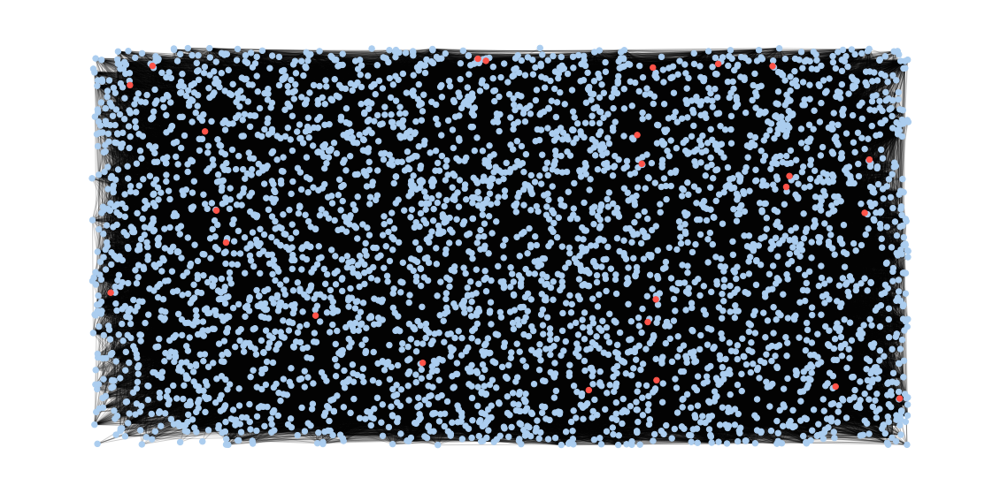

Nodi Tot. Grafo:4039
Nodi Infetti Iniziali:25
:[124, 1384, 1452, 1478, 1613, 1745, 1768, 1776, 1785, 591, 703, 809, 830, 2679, 2745, 2810, 2969, 3000, 3035, 3053, 3332, 2421, 2518, 3553, 3768]


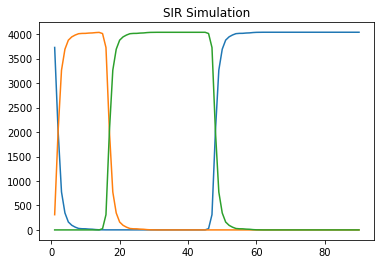

Giorno 90 :
Suscettibili: 4039
Infetti: 0
Guariti: 0


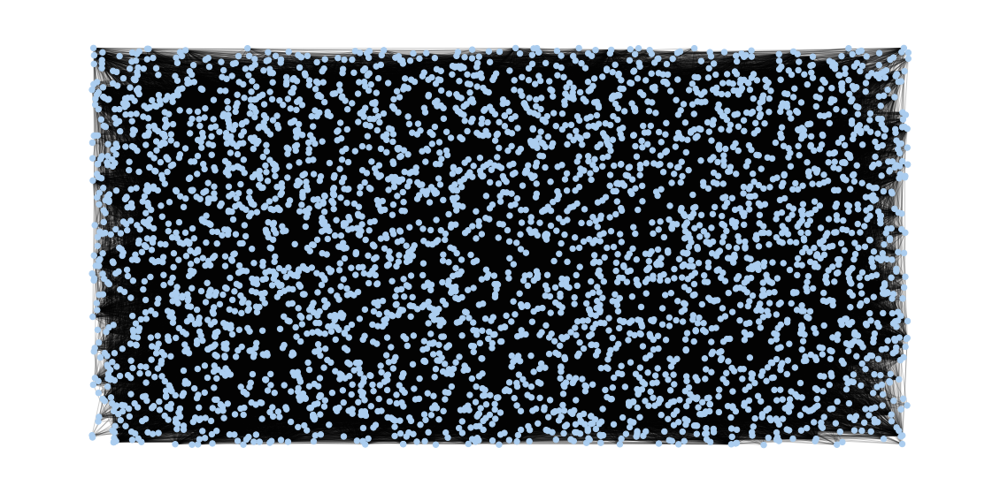

In [ ]:
#input parametri simulazione:p_trans, t_rec, t_sus, t_sim, num_sim
random_simulation(25, 'facebook_combined.csv', ' ', 0.25, 14, 30, 90, 1)

note: con probabilità diffusione malattia più alta si ha naturalamente uno spread maggiore nei timestep.
L'andamento può essere caratterizzato da alcune diversità che dipendono in piccola parte dalla influenza dei nodi. 
Qui avviene lo spread massimo, tutti i nodi sono stati infettati; la malattia è raggiunta a tutti e si potrà più espandere. Con il tempo i nodi guariscono e tornano per sempre nello stato "susceptible"

test: t_rec e t_sus bassi -> malattia sempre in vita e espansione

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: In a future version of pandas all arguments of read_csv except for the argument 'filepath_or_buffer' will be keyword-only
  """Entry point for launching an IPython kernel.


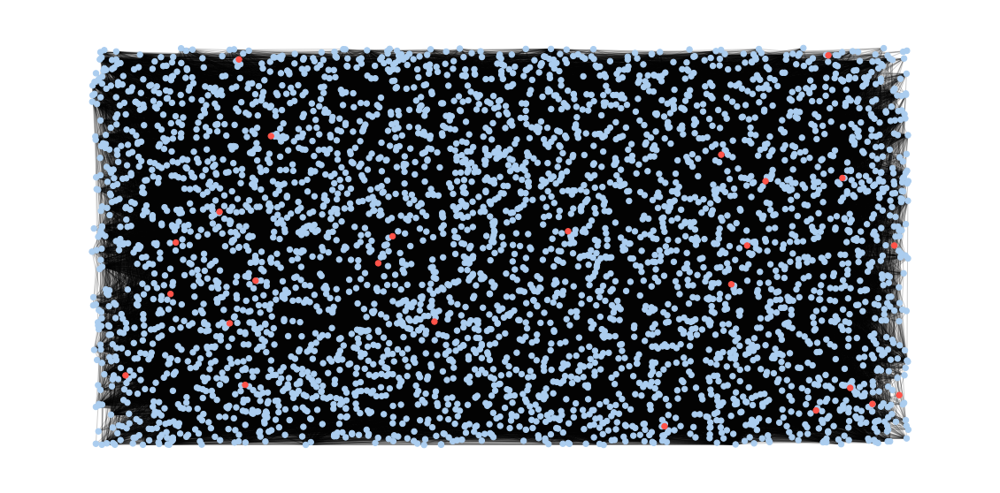

Nodi Tot. Grafo:4039
Nodi Infetti Iniziali:25
:[182, 235, 254, 334, 1382, 1396, 1452, 1543, 2223, 2250, 2268, 693, 3081, 3092, 3152, 3309, 3332, 3342, 3415, 1965, 3513, 3526, 3654, 3733, 3822]
Giorno 60 :
Suscettibili: 1926
Infetti: 951
Guariti: 1162


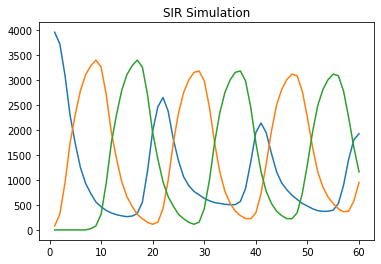

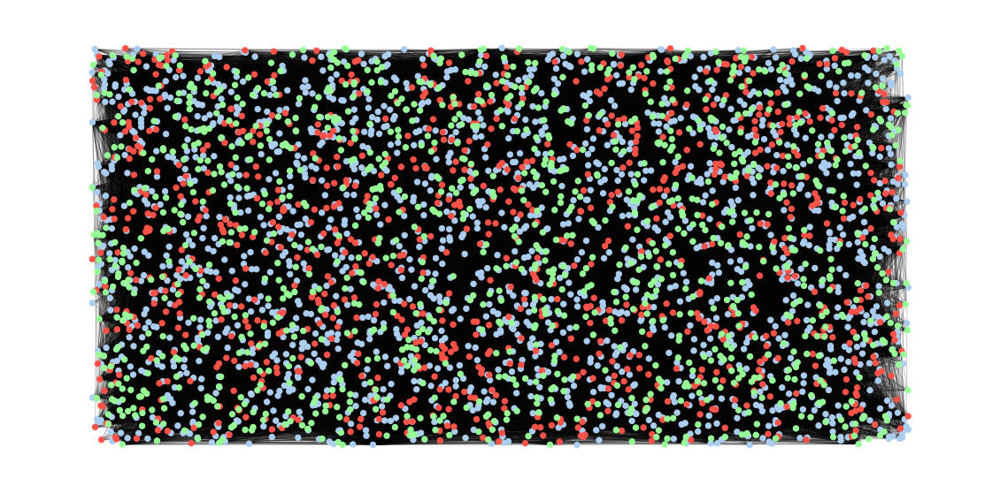

In [ ]:
#input parametri simulazione:p_trans, t_rec, t_sus, t_sim, num_sim
random_simulation(25, 'facebook_combined.csv', ' ', 0.05, 7, 7, 60, 1)

dimunendo il tempo di guarigione (quindi + veloce), le probabilità di infezione aumentano perchè i nodi passano nello stato Suscettibile più immediatamente quindi con probabilità maggiore di contagiare più nodi. Allo stesso tempo influisce il tempo t_sus: se anche questo è elevato si ritorna ad essere vulnerabili molto più tardi, in questo caso la malattia tenderà a morire. Se il t_sus tende infinito, i nodi saranno per sempre guariti

Fattori che incidono sono il tempo di guarigione e il tempo di ritorno alla vulnerabilità:

- Più la guarigione è lenta, più la malattia nella maggior parte dei casi sarà più letale inizialmente e andrà a colpire la maggior parte dei nodi. Al contrario, se ci si guarisce più velocemente , si avrà il rischio di tornare ad essere infettati (caso escluso con la guarigione che portà immunità)
- il t_sus basso(lento) portà ad avere più probabilità di essere contagiati, mantenendo in vita la malattia. Viceversa un t_sus più elevanto permette di mantenere l'immunità dalla malattia, quindi portando la malattia alla morte (infetti = 0)

TEST SECONDA RETE

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: FutureWarning: In a future version of pandas all arguments of read_csv except for the argument 'filepath_or_buffer' will be keyword-only


Nodi Tot. Grafo:6960
Nodi Infetti Iniziali:25
:[6892, 4305, 2064, 3087, 1941, 1532, 323, 5412, 205, 3978, 4883, 4186, 4297, 1501, 1754, 920, 1010, 1358, 6207, 2072, 3492, 3329, 2116, 4096, 4852]


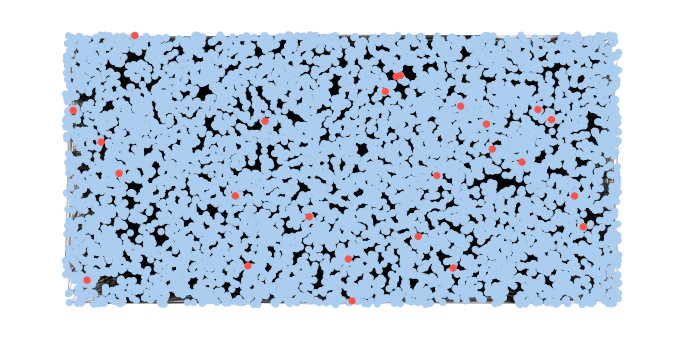

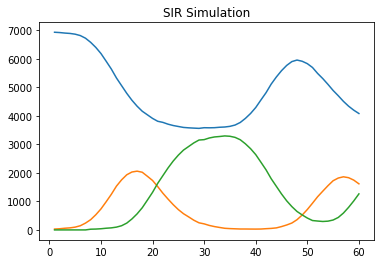

Giorno 60 :
Suscettibili: 4081
Infetti: 1616
Guariti: 1263
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             150 |
|      2 |   1773 |             148 |
|      3 |   3401 |             100 |
|      4 |    166 |              75 |
|      5 |   6136 |              70 |
|      6 |   5842 |              61 |
|      7 |   2732 |              60 |
|      8 |   2447 |              52 |
|      9 |   1924 |              51 |
|     10 |   4016 |              51 |
|     11 |   1103 |              47 |
|     12 |    581 |              47 |
|     13 |   3706 |              47 |
|     14 |   4196 |              46 |
|     15 |   2481 |              37 |
+--------+--------+-----------------+


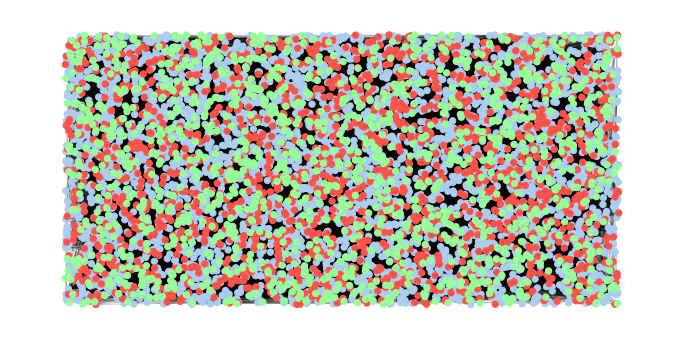

In [9]:
#input parametri simulazione:p_trans, t_rec, t_sus, t_sim, num_sim
random_simulation(25, 'musae_ENGB_edges.csv', ',', 0.02, 7, 21, 60, 1)

aumento infetti iniziali

In [ ]:
#input parametri simulazione:p_trans, t_rec, t_sus, t_sim, num_sim
random_simulation(50, 'musae_ENGB_edges.csv', ',', 0.02, 7, 21, 60, 1)

t_rec e t_sus bassi, malattia sempre in espansione

In [ ]:
#input parametri simulazione:p_trans, t_rec, t_sus, t_sim, num_sim
random_simulation(25, 'musae_ENGB_edges.csv', ',', 0.02, 7, 7, 60, 1)

aumento p_trans a 7 % -> maggiore impatto della trasmissione

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: FutureWarning: In a future version of pandas all arguments of read_csv except for the argument 'filepath_or_buffer' will be keyword-only


Nodi Tot. Grafo:6960
Nodi Infetti Iniziali:25
:[2444, 4032, 3835, 3725, 5894, 3551, 4448, 7108, 2899, 4738, 5298, 1634, 1904, 3147, 5254, 1251, 1118, 1362, 3946, 2893, 1453, 4412, 2655, 3256, 3658]


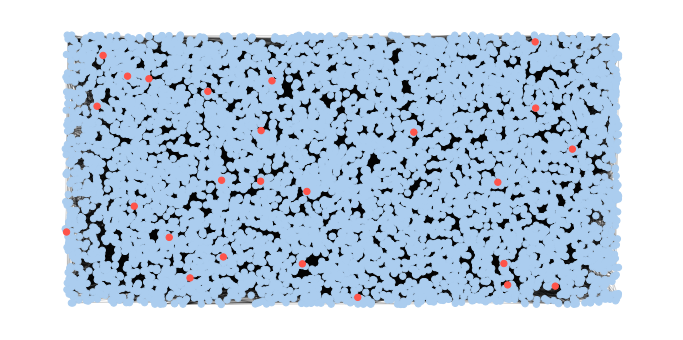

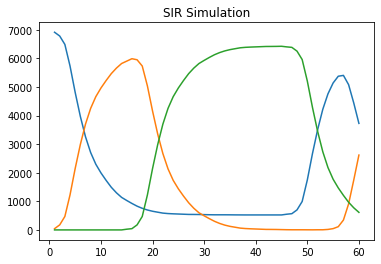

Giorno 60 :
Suscettibili: 3727
Infetti: 2619
Guariti: 614
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             374 |
|      2 |   1773 |             274 |
|      3 |   3401 |             172 |
|      4 |    166 |             131 |
|      5 |   1103 |             121 |
|      6 |   5842 |             116 |
|      7 |   6136 |             108 |
|      8 |    581 |             104 |
|      9 |   2447 |              88 |
|     10 |   1924 |              86 |
|     11 |   2732 |              85 |
|     12 |   4406 |              63 |
|     13 |   1598 |              63 |
|     14 |   4639 |              56 |
|     15 |   3706 |              53 |
+--------+--------+-----------------+


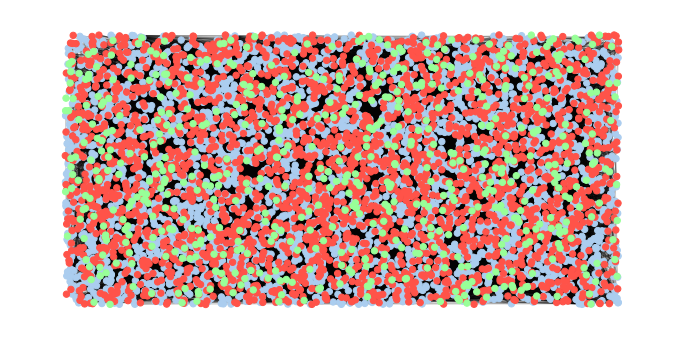

In [10]:
#input parametri simulazione:p_trans, t_rec, t_sus, t_sim, num_sim
random_simulation(25, 'musae_ENGB_edges.csv', ',', 0.07, 14, 30, 60, 1)

t_sus infinito -> guarigione completa

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: FutureWarning: In a future version of pandas all arguments of read_csv except for the argument 'filepath_or_buffer' will be keyword-only


Nodi Tot. Grafo:6960
Nodi Infetti Iniziali:25
:[2162, 5194, 2967, 3932, 241, 6631, 6937, 3077, 269, 1182, 617, 4323, 370, 6884, 4589, 2791, 1161, 5926, 4565, 6414, 3776, 4891, 5099, 3665, 7114]


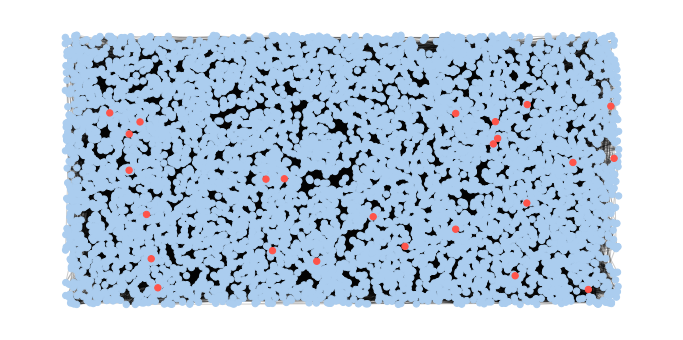

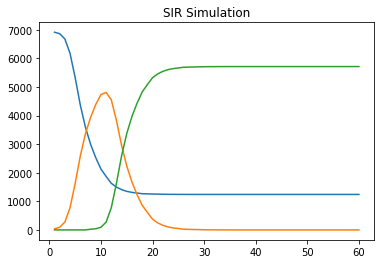

Giorno 60 :
Suscettibili: 1242
Infetti: 0
Guariti: 5718
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             177 |
|      2 |   1773 |             137 |
|      3 |   3401 |             101 |
|      4 |   5842 |              85 |
|      5 |   6136 |              59 |
|      6 |    166 |              56 |
|      7 |   1924 |              55 |
|      8 |    581 |              53 |
|      9 |   2447 |              50 |
|     10 |   1598 |              48 |
|     11 |   3706 |              48 |
|     12 |   1103 |              46 |
|     13 |   5269 |              46 |
|     14 |   4016 |              42 |
|     15 |   5945 |              41 |
+--------+--------+-----------------+


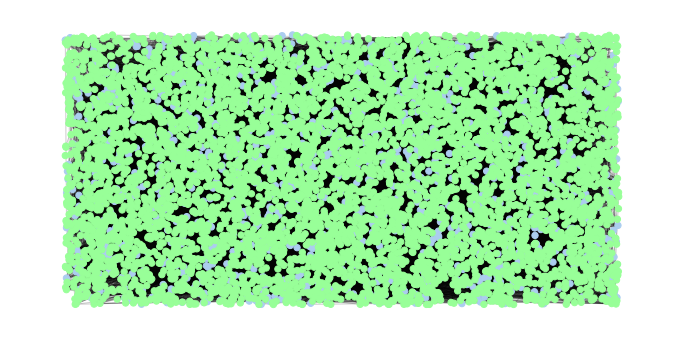

In [11]:
#input parametri simulazione:p_trans, t_rec, t_sus, t_sim, num_sim
random_simulation(25, 'musae_ENGB_edges.csv', ',', 0.07, 7, 999, 60, 1)

RANDOM SIMULATION

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: In a future version of pandas all arguments of read_csv except for the argument 'filepath_or_buffer' will be keyword-only
  if __name__ == '__main__':


Nodi Tot. Grafo:4039
Nodi Infetti Iniziali:25
:[40, 66, 206, 908, 977, 1129, 1329, 1413, 1476, 1712, 1760, 2133, 2250, 661, 848, 2724, 3027, 3116, 3343, 2041, 2262, 2483, 3468, 3693, 3768]
Nodi Tot. Grafo:4039
Nodi Infetti Iniziali:25
:[254, 1176, 1179, 1190, 1215, 1542, 1720, 1769, 1998, 525, 3456, 2666, 2844, 3030, 3171, 3387, 1966, 2019, 2277, 2306, 3466, 3719, 3793, 3918, 3988]
Nodi Tot. Grafo:4039
Nodi Infetti Iniziali:25
:[51, 206, 1003, 1386, 1606, 1693, 1763, 2283, 476, 493, 868, 2605, 2891, 3056, 3276, 3422, 2325, 1971, 2593, 3444, 3562, 3599, 3615, 3688, 3817]
Nodi Tot. Grafo:4039
Nodi Infetti Iniziali:25
:[281, 1100, 1347, 1477, 1764, 1855, 382, 444, 810, 2764, 3047, 3143, 3294, 3298, 1965, 1974, 2232, 2318, 2320, 2450, 2466, 2525, 3497, 3641, 3835]
Nodi Tot. Grafo:4039
Nodi Infetti Iniziali:25
:[40, 272, 1121, 1178, 1329, 1504, 1659, 2247, 354, 506, 590, 705, 754, 2816, 2880, 3022, 3411, 1963, 2115, 2405, 2446, 2523, 3513, 3868, 3893]
Nodi Tot. Grafo:4039
Nodi Infetti Inizi

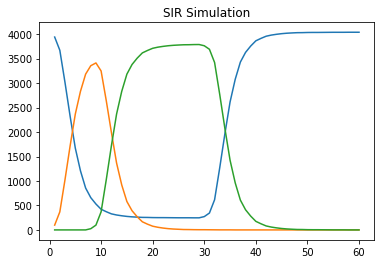

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             140 |
|      2 |   1684 |             130 |
|      3 |   3437 |             120 |
|      4 |   1912 |              88 |
|      5 |      0 |              59 |
|      6 |    686 |              32 |
|      7 |    348 |              31 |
|      8 |    414 |              28 |
|      9 |   2133 |              24 |
|     10 |   2313 |              18 |
|     11 |   2047 |              17 |
|     12 |   2266 |              16 |
|     13 |   2384 |              16 |
|     14 |   2250 |              16 |
|     15 |   1329 |              16 |
+--------+--------+-----------------+


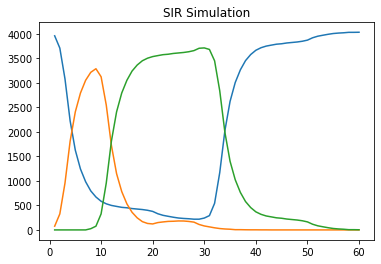

Giorno 60 :
Suscettibili: 4036
Infetti: 0
Guariti: 3
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             175 |
|      2 |   1684 |             135 |
|      3 |   3437 |             109 |
|      4 |   1912 |             106 |
|      5 |      0 |              87 |
|      6 |    414 |              33 |
|      7 |    348 |              32 |
|      8 |    686 |              22 |
|      9 |   2142 |              18 |
|     10 |   2047 |              18 |
|     11 |   1966 |              16 |
|     12 |    698 |              15 |
|     13 |   3851 |              14 |
|     14 |   2666 |              14 |
|     15 |   3980 |              14 |
+--------+--------+-----------------+


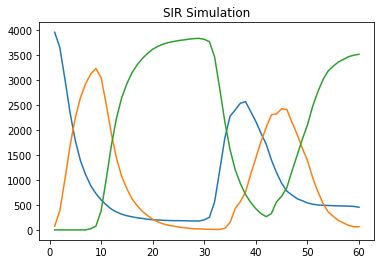

Giorno 60 :
Suscettibili: 455
Infetti: 62
Guariti: 3522
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             348 |
|      2 |   1684 |             271 |
|      3 |   3437 |             229 |
|      4 |   1912 |             201 |
|      5 |      0 |             145 |
|      6 |    348 |              76 |
|      7 |    414 |              47 |
|      8 |    483 |              41 |
|      9 |    698 |              29 |
|     10 |   1085 |              26 |
|     11 |   2283 |              26 |
|     12 |   1577 |              25 |
|     13 |    475 |              24 |
|     14 |   3830 |              23 |
|     15 |    136 |              22 |
+--------+--------+-----------------+


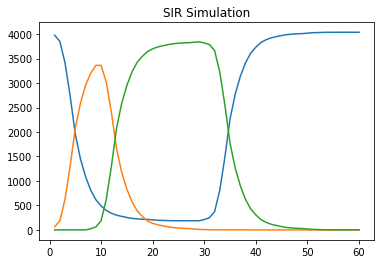

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             186 |
|      2 |   1684 |             134 |
|      3 |   3437 |             114 |
|      4 |   1912 |              93 |
|      5 |      0 |              78 |
|      6 |    414 |              31 |
|      7 |    686 |              29 |
|      8 |    348 |              18 |
|      9 |   3980 |              16 |
|     10 |   1964 |              14 |
|     11 |    483 |              14 |
|     12 |    698 |              14 |
|     13 |   2468 |              14 |
|     14 |   1277 |              13 |
|     15 |   1707 |              12 |
+--------+--------+-----------------+


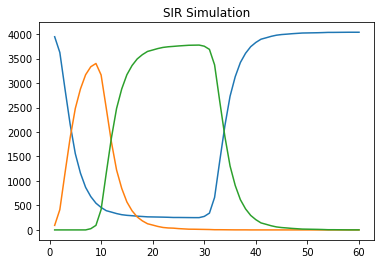

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             149 |
|      2 |   1684 |             127 |
|      3 |   3437 |             122 |
|      4 |      0 |              55 |
|      5 |   1912 |              47 |
|      6 |    348 |              41 |
|      7 |    686 |              22 |
|      8 |   2047 |              21 |
|      9 |    428 |              19 |
|     10 |    414 |              17 |
|     11 |   2247 |              16 |
|     12 |   1800 |              16 |
|     13 |   2446 |              15 |
|     14 |   1329 |              15 |
|     15 |    917 |              15 |
+--------+--------+-----------------+


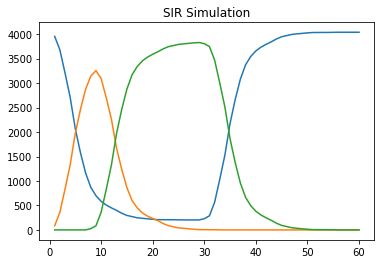

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             162 |
|      2 |   1684 |             128 |
|      3 |   3437 |             121 |
|      4 |   1912 |              91 |
|      5 |      0 |              72 |
|      6 |    414 |              38 |
|      7 |    348 |              36 |
|      8 |   2111 |              28 |
|      9 |    698 |              22 |
|     10 |   2543 |              22 |
|     11 |    686 |              16 |
|     12 |   3980 |              15 |
|     13 |    713 |              15 |
|     14 |   1199 |              14 |
|     15 |   1160 |              14 |
+--------+--------+-----------------+


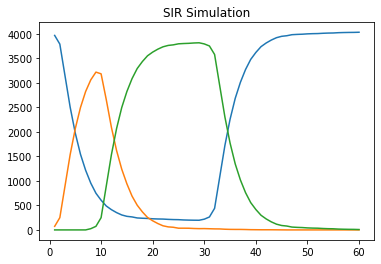

Giorno 60 :
Suscettibili: 4031
Infetti: 0
Guariti: 8
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             144 |
|      2 |   1684 |             138 |
|      3 |   3437 |             106 |
|      4 |   1912 |              80 |
|      5 |      0 |              74 |
|      6 |    348 |              38 |
|      7 |    483 |              22 |
|      8 |    686 |              19 |
|      9 |    698 |              17 |
|     10 |    953 |              16 |
|     11 |   2247 |              16 |
|     12 |   2043 |              15 |
|     13 |    430 |              13 |
|     14 |   3938 |              13 |
|     15 |   3980 |              13 |
+--------+--------+-----------------+


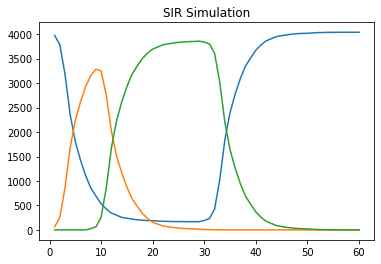

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             154 |
|      2 |   3437 |             119 |
|      3 |   1912 |              98 |
|      4 |   1684 |              90 |
|      5 |      0 |              74 |
|      6 |    348 |              36 |
|      7 |    686 |              35 |
|      8 |    414 |              26 |
|      9 |   2007 |              23 |
|     10 |   1941 |              20 |
|     11 |   1086 |              16 |
|     12 |   3980 |              16 |
|     13 |   3119 |              15 |
|     14 |    698 |              14 |
|     15 |    897 |              14 |
+--------+--------+-----------------+


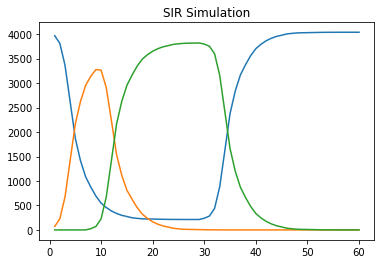

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             183 |
|      2 |   1684 |             127 |
|      3 |   3437 |             117 |
|      4 |      0 |              82 |
|      5 |   1912 |              77 |
|      6 |    348 |              37 |
|      7 |    686 |              26 |
|      8 |   2347 |              25 |
|      9 |    414 |              25 |
|     10 |    698 |              19 |
|     11 |    483 |              18 |
|     12 |   3980 |              17 |
|     13 |   2183 |              17 |
|     14 |   1211 |              13 |
|     15 |   2475 |              12 |
+--------+--------+-----------------+


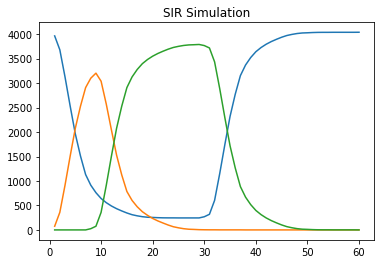

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             159 |
|      2 |   3437 |             122 |
|      3 |    107 |             105 |
|      4 |      0 |              76 |
|      5 |   1912 |              71 |
|      6 |    686 |              44 |
|      7 |    348 |              34 |
|      8 |    414 |              22 |
|      9 |   2093 |              17 |
|     10 |   1789 |              15 |
|     11 |    363 |              15 |
|     12 |    698 |              15 |
|     13 |    428 |              14 |
|     14 |   2059 |              14 |
|     15 |   2071 |              14 |
+--------+--------+-----------------+


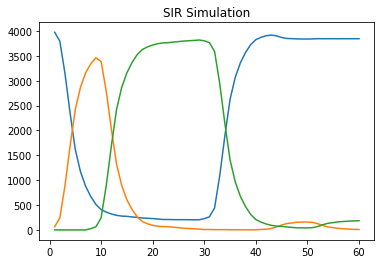

Giorno 60 :
Suscettibili: 3846
Infetti: 9
Guariti: 184
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             163 |
|      2 |   1684 |             117 |
|      3 |   3437 |             101 |
|      4 |      0 |              80 |
|      5 |   1912 |              80 |
|      6 |    686 |              48 |
|      7 |    348 |              30 |
|      8 |    698 |              28 |
|      9 |    414 |              26 |
|     10 |   1800 |              24 |
|     11 |   1984 |              21 |
|     12 |    917 |              19 |
|     13 |   3980 |              18 |
|     14 |    705 |              17 |
|     15 |   3596 |              16 |
+--------+--------+-----------------+


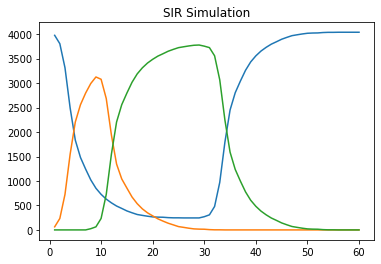

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             158 |
|      2 |   3437 |             101 |
|      3 |   1684 |              91 |
|      4 |   1912 |              85 |
|      5 |      0 |              69 |
|      6 |    348 |              38 |
|      7 |   3830 |              23 |
|      8 |   2347 |              22 |
|      9 |    686 |              21 |
|     10 |    414 |              20 |
|     11 |     25 |              16 |
|     12 |   1465 |              15 |
|     13 |   2901 |              14 |
|     14 |    366 |              14 |
|     15 |    698 |              14 |
+--------+--------+-----------------+


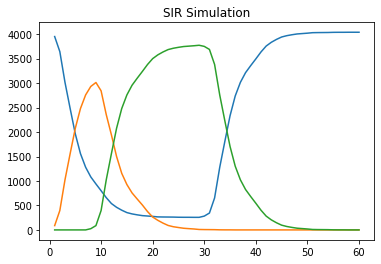

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             127 |
|      2 |   3437 |             119 |
|      3 |   1912 |             108 |
|      4 |    107 |              93 |
|      5 |      0 |              88 |
|      6 |    686 |              28 |
|      7 |    483 |              27 |
|      8 |   1199 |              26 |
|      9 |    348 |              23 |
|     10 |   2333 |              19 |
|     11 |    414 |              18 |
|     12 |   1888 |              17 |
|     13 |    698 |              16 |
|     14 |   2542 |              15 |
|     15 |   2131 |              15 |
+--------+--------+-----------------+


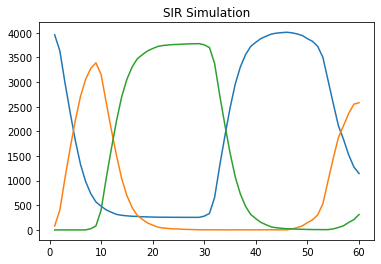

Giorno 60 :
Suscettibili: 1144
Infetti: 2583
Guariti: 312
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             378 |
|      2 |   1684 |             301 |
|      3 |      0 |             154 |
|      4 |   1912 |             150 |
|      5 |   3437 |             107 |
|      6 |    348 |              61 |
|      7 |    414 |              47 |
|      8 |    686 |              39 |
|      9 |    917 |              39 |
|     10 |    136 |              29 |
|     11 |    483 |              29 |
|     12 |   2428 |              26 |
|     13 |   1391 |              24 |
|     14 |    363 |              24 |
|     15 |   2543 |              23 |
+--------+--------+-----------------+


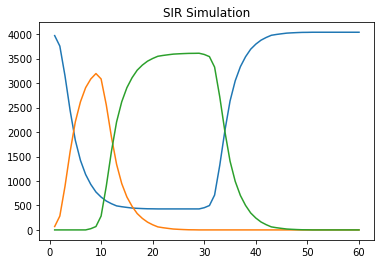

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             132 |
|      2 |   1912 |             121 |
|      3 |   3437 |              93 |
|      4 |    107 |              89 |
|      5 |      0 |              77 |
|      6 |    348 |              30 |
|      7 |   3830 |              21 |
|      8 |    484 |              20 |
|      9 |   1966 |              19 |
|     10 |    917 |              19 |
|     11 |   2404 |              18 |
|     12 |    896 |              18 |
|     13 |    277 |              16 |
|     14 |   3136 |              16 |
|     15 |    483 |              15 |
+--------+--------+-----------------+


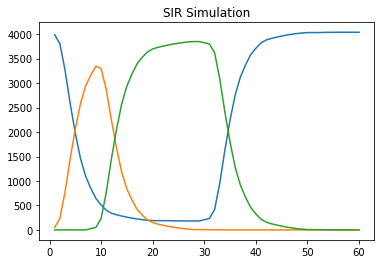

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             182 |
|      2 |   3437 |             126 |
|      3 |   1684 |             110 |
|      4 |   1912 |              92 |
|      5 |      0 |              85 |
|      6 |    348 |              44 |
|      7 |   2090 |              24 |
|      8 |   1917 |              21 |
|      9 |   3980 |              20 |
|     10 |    414 |              20 |
|     11 |    686 |              19 |
|     12 |    483 |              18 |
|     13 |   1577 |              18 |
|     14 |   1813 |              16 |
|     15 |   2007 |              15 |
+--------+--------+-----------------+


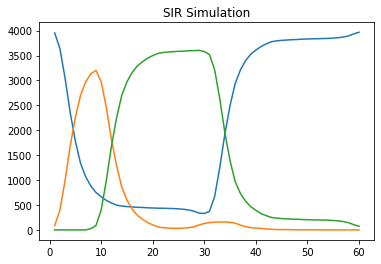

Giorno 60 :
Suscettibili: 3967
Infetti: 0
Guariti: 72
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             137 |
|      2 |   3437 |             128 |
|      3 |   1684 |             101 |
|      4 |   1912 |              72 |
|      5 |      0 |              53 |
|      6 |    348 |              27 |
|      7 |    414 |              21 |
|      8 |    686 |              21 |
|      9 |    698 |              20 |
|     10 |    376 |              17 |
|     11 |   1941 |              17 |
|     12 |   1570 |              17 |
|     13 |    483 |              16 |
|     14 |   2619 |              16 |
|     15 |   2863 |              14 |
+--------+--------+-----------------+


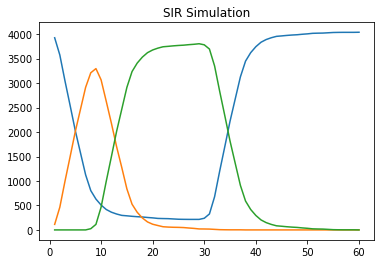

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             188 |
|      2 |   1684 |             121 |
|      3 |   3437 |             114 |
|      4 |   1912 |              85 |
|      5 |      0 |              67 |
|      6 |    414 |              28 |
|      7 |   2601 |              22 |
|      8 |    348 |              19 |
|      9 |    686 |              19 |
|     10 |    946 |              18 |
|     11 |    428 |              17 |
|     12 |    980 |              16 |
|     13 |   2543 |              16 |
|     14 |   2020 |              16 |
|     15 |    698 |              14 |
+--------+--------+-----------------+


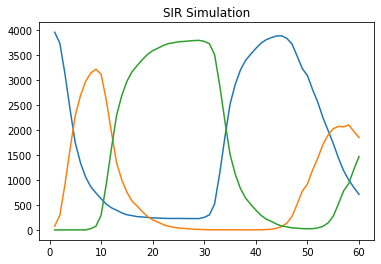

Giorno 60 :
Suscettibili: 714
Infetti: 1852
Guariti: 1473
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             297 |
|      2 |   1684 |             240 |
|      3 |   3437 |             200 |
|      4 |   1912 |             160 |
|      5 |      0 |             131 |
|      6 |    348 |              92 |
|      7 |    414 |              57 |
|      8 |    136 |              33 |
|      9 |   2543 |              30 |
|     10 |   3830 |              26 |
|     11 |   2037 |              23 |
|     12 |   2190 |              22 |
|     13 |    917 |              21 |
|     14 |   1352 |              21 |
|     15 |   2047 |              21 |
+--------+--------+-----------------+


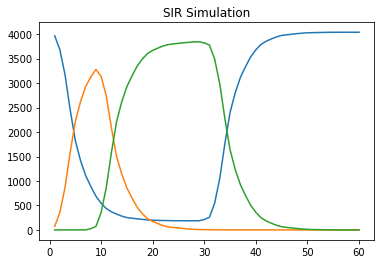

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             165 |
|      2 |   1684 |              96 |
|      3 |   3437 |              90 |
|      4 |   1912 |              84 |
|      5 |      0 |              79 |
|      6 |    686 |              32 |
|      7 |    348 |              31 |
|      8 |    414 |              26 |
|      9 |    896 |              20 |
|     10 |   2266 |              16 |
|     11 |    637 |              15 |
|     12 |   2755 |              14 |
|     13 |   3980 |              14 |
|     14 |   2047 |              14 |
|     15 |   3267 |              14 |
+--------+--------+-----------------+


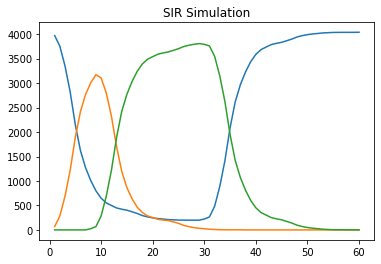

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             139 |
|      2 |   1684 |             111 |
|      3 |   3437 |             104 |
|      4 |      0 |              84 |
|      5 |   1912 |              82 |
|      6 |    483 |              49 |
|      7 |    686 |              38 |
|      8 |   2133 |              26 |
|      9 |   1086 |              25 |
|     10 |    414 |              25 |
|     11 |    348 |              24 |
|     12 |    698 |              21 |
|     13 |   1993 |              20 |
|     14 |   1941 |              19 |
|     15 |   3980 |              17 |
+--------+--------+-----------------+


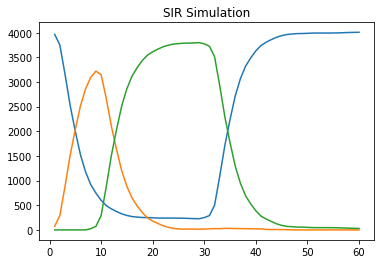

Giorno 60 :
Suscettibili: 4009
Infetti: 0
Guariti: 30
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             120 |
|      2 |   3437 |             108 |
|      3 |    107 |              91 |
|      4 |   1912 |              64 |
|      5 |      0 |              64 |
|      6 |    348 |              43 |
|      7 |    686 |              36 |
|      8 |   3851 |              19 |
|      9 |   1086 |              18 |
|     10 |    483 |              18 |
|     11 |   2602 |              16 |
|     12 |    414 |              15 |
|     13 |   1867 |              14 |
|     14 |   2329 |              13 |
|     15 |   2282 |              13 |
+--------+--------+-----------------+


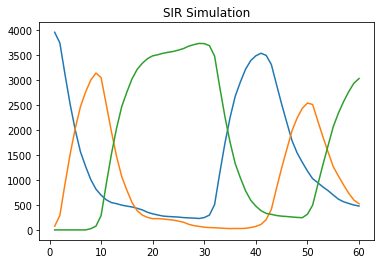

Giorno 60 :
Suscettibili: 479
Infetti: 524
Guariti: 3036
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             324 |
|      2 |   3437 |             222 |
|      3 |   1684 |             204 |
|      4 |      0 |             164 |
|      5 |   1912 |             117 |
|      6 |    686 |              39 |
|      7 |    414 |              38 |
|      8 |    376 |              34 |
|      9 |    348 |              34 |
|     10 |    563 |              30 |
|     11 |    136 |              26 |
|     12 |    483 |              25 |
|     13 |   3116 |              22 |
|     14 |   1941 |              22 |
|     15 |    484 |              22 |
+--------+--------+-----------------+


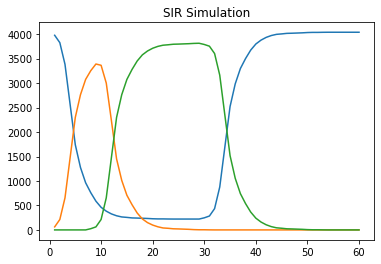

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             150 |
|      2 |      0 |              97 |
|      3 |   3437 |              92 |
|      4 |   1684 |              74 |
|      5 |    348 |              52 |
|      6 |   1912 |              44 |
|      7 |    686 |              39 |
|      8 |    414 |              23 |
|      9 |   2468 |              22 |
|     10 |   3980 |              20 |
|     11 |   1086 |              18 |
|     12 |   1926 |              17 |
|     13 |    517 |              15 |
|     14 |   2543 |              15 |
|     15 |    136 |              15 |
+--------+--------+-----------------+


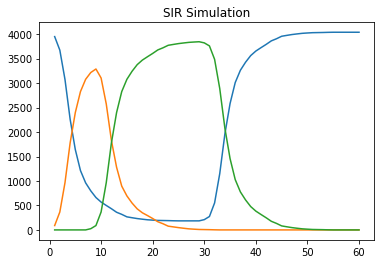

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             164 |
|      2 |   1684 |             150 |
|      3 |   3437 |             121 |
|      4 |   1912 |             111 |
|      5 |      0 |              71 |
|      6 |    348 |              25 |
|      7 |   1983 |              19 |
|      8 |    686 |              19 |
|      9 |    414 |              17 |
|     10 |   3980 |              16 |
|     11 |    698 |              16 |
|     12 |    376 |              15 |
|     13 |    946 |              15 |
|     14 |    563 |              14 |
|     15 |   1352 |              13 |
+--------+--------+-----------------+


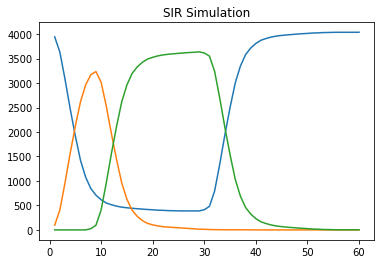

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             145 |
|      2 |   3437 |             133 |
|      3 |   1684 |             101 |
|      4 |   1912 |              74 |
|      5 |      0 |              72 |
|      6 |    348 |              31 |
|      7 |   1929 |              18 |
|      8 |   3980 |              18 |
|      9 |    484 |              17 |
|     10 |   2199 |              17 |
|     11 |   1622 |              17 |
|     12 |   2716 |              17 |
|     13 |    414 |              16 |
|     14 |   2074 |              16 |
|     15 |    428 |              15 |
+--------+--------+-----------------+


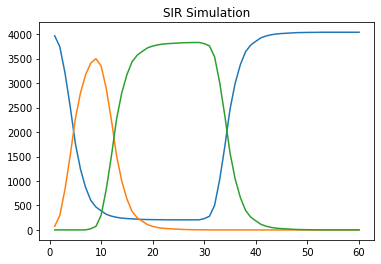

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             165 |
|      2 |   3437 |             131 |
|      3 |   1684 |             122 |
|      4 |      0 |              87 |
|      5 |   1912 |              81 |
|      6 |    686 |              26 |
|      7 |   2007 |              22 |
|      8 |    414 |              21 |
|      9 |    348 |              21 |
|     10 |   3980 |              18 |
|     11 |   1104 |              16 |
|     12 |   2127 |              14 |
|     13 |    651 |              13 |
|     14 |   2165 |              13 |
|     15 |   2218 |              12 |
+--------+--------+-----------------+


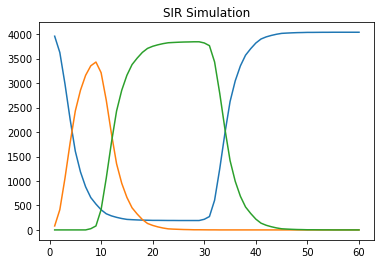

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             161 |
|      2 |    107 |             128 |
|      3 |   3437 |             124 |
|      4 |   1912 |              97 |
|      5 |      0 |              54 |
|      6 |    686 |              26 |
|      7 |    483 |              25 |
|      8 |    348 |              23 |
|      9 |    414 |              23 |
|     10 |   1222 |              21 |
|     11 |    538 |              19 |
|     12 |   3830 |              19 |
|     13 |   1962 |              19 |
|     14 |   2266 |              18 |
|     15 |    119 |              16 |
+--------+--------+-----------------+


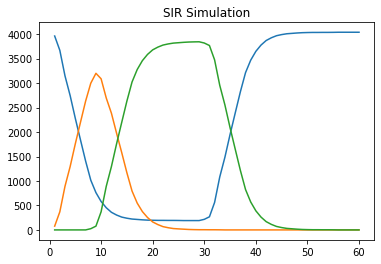

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             164 |
|      2 |   3437 |             137 |
|      3 |   1684 |             128 |
|      4 |      0 |              65 |
|      5 |   1912 |              62 |
|      6 |    348 |              28 |
|      7 |   3980 |              26 |
|      8 |   2324 |              26 |
|      9 |    414 |              23 |
|     10 |    686 |              21 |
|     11 |   1199 |              21 |
|     12 |    698 |              16 |
|     13 |   1227 |              14 |
|     14 |   2511 |              14 |
|     15 |   2292 |              14 |
+--------+--------+-----------------+


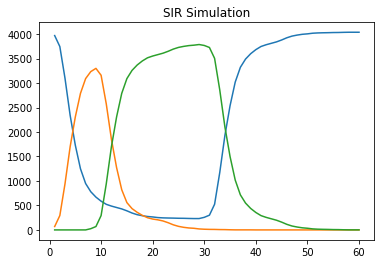

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             141 |
|      2 |   1912 |             103 |
|      3 |   3437 |             100 |
|      4 |   1684 |              98 |
|      5 |      0 |              87 |
|      6 |    686 |              38 |
|      7 |   1431 |              29 |
|      8 |    483 |              19 |
|      9 |    348 |              19 |
|     10 |   2617 |              18 |
|     11 |    414 |              17 |
|     12 |   1768 |              15 |
|     13 |   2118 |              15 |
|     14 |    376 |              14 |
|     15 |   1983 |              12 |
+--------+--------+-----------------+


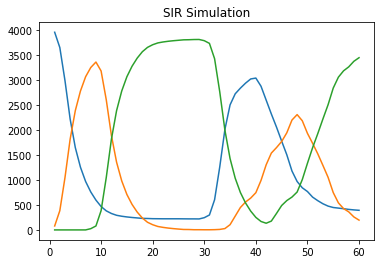

Giorno 60 :
Suscettibili: 393
Infetti: 196
Guariti: 3450
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             281 |
|      2 |   1684 |             264 |
|      3 |   3437 |             215 |
|      4 |      0 |             182 |
|      5 |   1912 |             138 |
|      6 |    348 |              63 |
|      7 |    414 |              49 |
|      8 |   2543 |              41 |
|      9 |    686 |              35 |
|     10 |    483 |              26 |
|     11 |   3830 |              25 |
|     12 |   2289 |              22 |
|     13 |   2184 |              20 |
|     14 |   3406 |              20 |
|     15 |   3980 |              19 |
+--------+--------+-----------------+


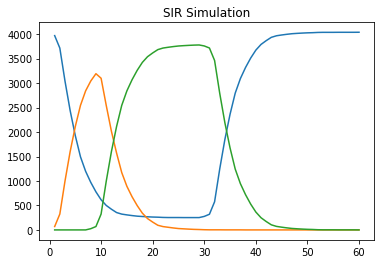

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             138 |
|      2 |   3437 |             133 |
|      3 |   1684 |             117 |
|      4 |      0 |              87 |
|      5 |   1912 |              87 |
|      6 |   2184 |              23 |
|      7 |   1399 |              21 |
|      8 |    686 |              19 |
|      9 |    960 |              19 |
|     10 |   3082 |              18 |
|     11 |   2294 |              18 |
|     12 |   1559 |              17 |
|     13 |    483 |              17 |
|     14 |   2037 |              16 |
|     15 |    414 |              15 |
+--------+--------+-----------------+


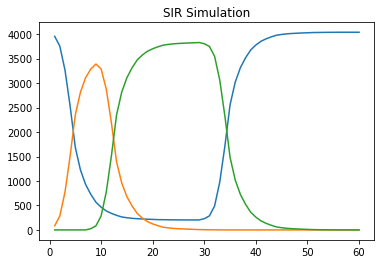

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             132 |
|      2 |    107 |             122 |
|      3 |   3437 |             118 |
|      4 |   1912 |              79 |
|      5 |      0 |              71 |
|      6 |    348 |              27 |
|      7 |    414 |              21 |
|      8 |    686 |              21 |
|      9 |    119 |              20 |
|     10 |   2542 |              18 |
|     11 |   1813 |              18 |
|     12 |    517 |              18 |
|     13 |    917 |              16 |
|     14 |   2047 |              16 |
|     15 |   3980 |              15 |
+--------+--------+-----------------+


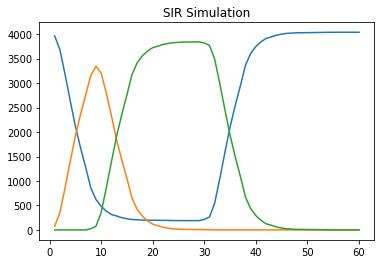

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             171 |
|      2 |   3437 |             131 |
|      3 |   1684 |              86 |
|      4 |   1912 |              72 |
|      5 |      0 |              59 |
|      6 |    348 |              40 |
|      7 |    686 |              30 |
|      8 |    414 |              25 |
|      9 |    953 |              18 |
|     10 |    698 |              18 |
|     11 |   2679 |              18 |
|     12 |    122 |              18 |
|     13 |   1577 |              15 |
|     14 |   1941 |              15 |
|     15 |   2468 |              15 |
+--------+--------+-----------------+


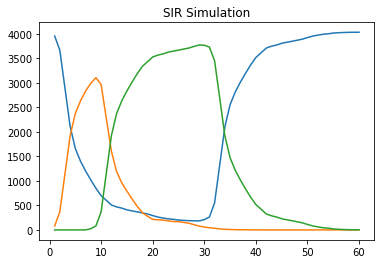

Giorno 60 :
Suscettibili: 4036
Infetti: 0
Guariti: 3
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             130 |
|      2 |   1912 |             127 |
|      3 |   3437 |             122 |
|      4 |   1684 |             103 |
|      5 |      0 |              87 |
|      6 |    348 |              30 |
|      7 |    136 |              24 |
|      8 |    428 |              24 |
|      9 |   1604 |              21 |
|     10 |    414 |              21 |
|     11 |    686 |              19 |
|     12 |   2877 |              19 |
|     13 |   3830 |              19 |
|     14 |   1783 |              18 |
|     15 |   3980 |              18 |
+--------+--------+-----------------+


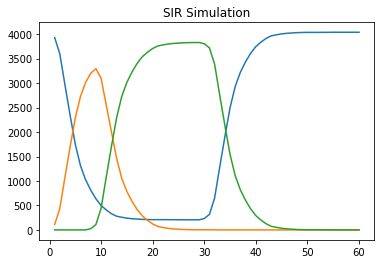

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             152 |
|      2 |   1912 |             144 |
|      3 |   1684 |             114 |
|      4 |   3437 |              80 |
|      5 |      0 |              78 |
|      6 |    686 |              30 |
|      7 |    348 |              21 |
|      8 |    698 |              20 |
|      9 |   3980 |              19 |
|     10 |   2081 |              18 |
|     11 |    414 |              17 |
|     12 |   2754 |              16 |
|     13 |   3830 |              15 |
|     14 |   1322 |              15 |
|     15 |   2578 |              15 |
+--------+--------+-----------------+


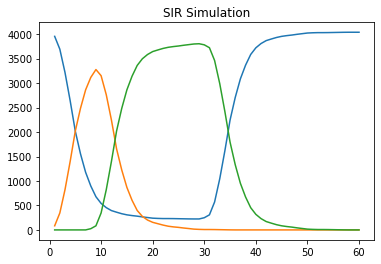

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             129 |
|      2 |   1684 |             119 |
|      3 |   3437 |             111 |
|      4 |   1912 |              71 |
|      5 |      0 |              62 |
|      6 |    348 |              41 |
|      7 |    414 |              24 |
|      8 |   1086 |              21 |
|      9 |    686 |              18 |
|     10 |   3101 |              17 |
|     11 |    698 |              17 |
|     12 |    563 |              17 |
|     13 |   3980 |              16 |
|     14 |   2590 |              15 |
|     15 |   2007 |              15 |
+--------+--------+-----------------+


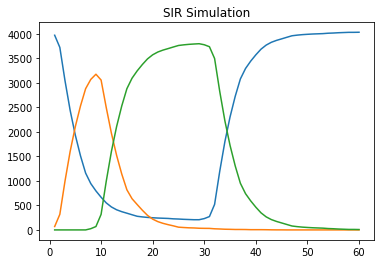

Giorno 60 :
Suscettibili: 4031
Infetti: 0
Guariti: 8
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1912 |             124 |
|      2 |    107 |             122 |
|      3 |   1684 |             100 |
|      4 |   3437 |              98 |
|      5 |      0 |              59 |
|      6 |    686 |              28 |
|      7 |    483 |              25 |
|      8 |    414 |              24 |
|      9 |    475 |              20 |
|     10 |   1399 |              19 |
|     11 |   1256 |              18 |
|     12 |   3830 |              16 |
|     13 |    957 |              16 |
|     14 |   2326 |              15 |
|     15 |   2266 |              15 |
+--------+--------+-----------------+


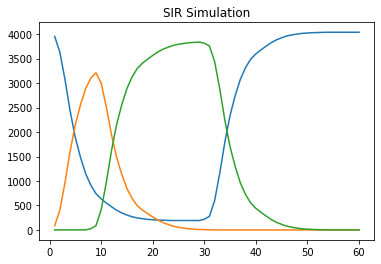

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             192 |
|      2 |   1684 |             104 |
|      3 |      0 |              98 |
|      4 |   3437 |              89 |
|      5 |   1912 |              70 |
|      6 |   2073 |              27 |
|      7 |    686 |              23 |
|      8 |    698 |              21 |
|      9 |    348 |              20 |
|     10 |   3980 |              20 |
|     11 |    414 |              19 |
|     12 |    896 |              19 |
|     13 |   2347 |              19 |
|     14 |   1376 |              18 |
|     15 |   1199 |              18 |
+--------+--------+-----------------+


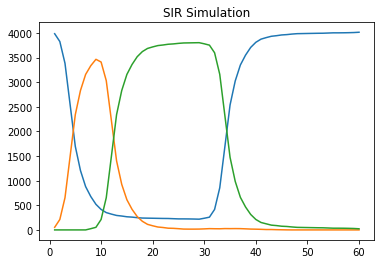

Giorno 60 :
Suscettibili: 4016
Infetti: 0
Guariti: 23
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             138 |
|      2 |    107 |             125 |
|      3 |   1912 |             120 |
|      4 |   3437 |             114 |
|      5 |      0 |              60 |
|      6 |    348 |              42 |
|      7 |    686 |              37 |
|      8 |    484 |              23 |
|      9 |    917 |              19 |
|     10 |    414 |              19 |
|     11 |    698 |              17 |
|     12 |    271 |              14 |
|     13 |   1620 |              13 |
|     14 |   1029 |              13 |
|     15 |   3363 |              13 |
+--------+--------+-----------------+


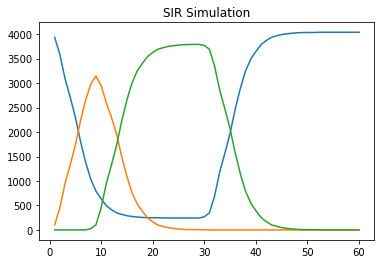

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             124 |
|      2 |    107 |             116 |
|      3 |   3437 |             110 |
|      4 |      0 |              69 |
|      5 |   1912 |              61 |
|      6 |    686 |              27 |
|      7 |   2200 |              26 |
|      8 |   1086 |              25 |
|      9 |   2266 |              24 |
|     10 |   1184 |              20 |
|     11 |    348 |              19 |
|     12 |   1964 |              18 |
|     13 |    376 |              16 |
|     14 |    414 |              14 |
|     15 |   3830 |              13 |
+--------+--------+-----------------+


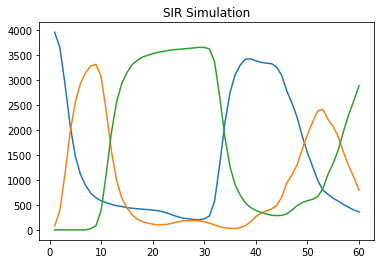

Giorno 60 :
Suscettibili: 360
Infetti: 797
Guariti: 2882
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             315 |
|      2 |   1684 |             254 |
|      3 |   3437 |             230 |
|      4 |      0 |             182 |
|      5 |   1912 |             173 |
|      6 |    348 |              54 |
|      7 |    414 |              46 |
|      8 |    686 |              39 |
|      9 |   2266 |              29 |
|     10 |    475 |              28 |
|     11 |   1017 |              26 |
|     12 |    698 |              26 |
|     13 |    483 |              23 |
|     14 |   1352 |              22 |
|     15 |   1465 |              21 |
+--------+--------+-----------------+


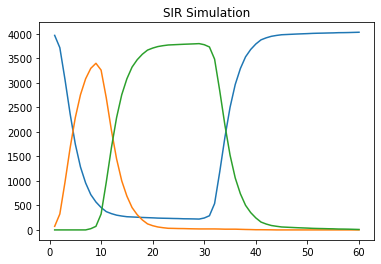

Giorno 60 :
Suscettibili: 4030
Infetti: 0
Guariti: 9
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             164 |
|      2 |    107 |             133 |
|      3 |   3437 |             131 |
|      4 |   1912 |              97 |
|      5 |      0 |              82 |
|      6 |    348 |              41 |
|      7 |    686 |              28 |
|      8 |   2543 |              25 |
|      9 |   1768 |              23 |
|     10 |   2340 |              19 |
|     11 |    483 |              18 |
|     12 |   2266 |              18 |
|     13 |    414 |              16 |
|     14 |   1985 |              15 |
|     15 |    698 |              14 |
+--------+--------+-----------------+


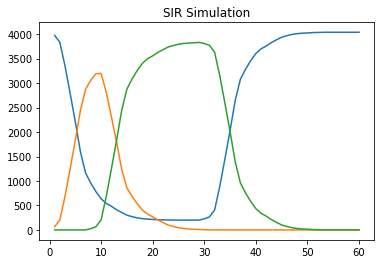

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             171 |
|      2 |   3437 |             128 |
|      3 |   1684 |             116 |
|      4 |   1912 |              75 |
|      5 |      0 |              54 |
|      6 |    348 |              40 |
|      7 |    686 |              32 |
|      8 |    414 |              27 |
|      9 |   2073 |              24 |
|     10 |   3980 |              19 |
|     11 |    483 |              17 |
|     12 |   2863 |              15 |
|     13 |   2604 |              15 |
|     14 |   3060 |              15 |
|     15 |   2140 |              13 |
+--------+--------+-----------------+


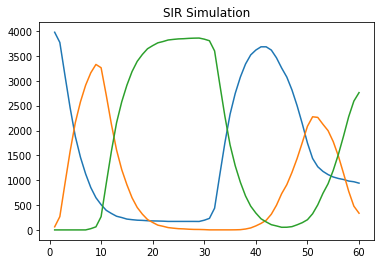

Giorno 60 :
Suscettibili: 941
Infetti: 336
Guariti: 2762
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             270 |
|      2 |    107 |             264 |
|      3 |   1912 |             176 |
|      4 |      0 |             161 |
|      5 |   3437 |             118 |
|      6 |    348 |              50 |
|      7 |    414 |              42 |
|      8 |    483 |              37 |
|      9 |    917 |              28 |
|     10 |    686 |              25 |
|     11 |     56 |              25 |
|     12 |   2133 |              24 |
|     13 |    136 |              24 |
|     14 |    376 |              23 |
|     15 |   1059 |              22 |
+--------+--------+-----------------+


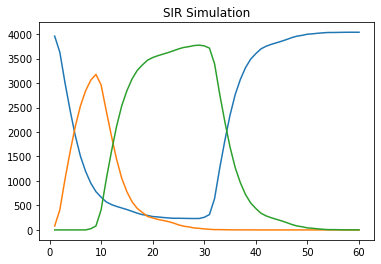

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             155 |
|      2 |   3437 |             126 |
|      3 |   1684 |             113 |
|      4 |   1912 |              84 |
|      5 |      0 |              77 |
|      6 |   2289 |              26 |
|      7 |    348 |              26 |
|      8 |    376 |              20 |
|      9 |   2347 |              19 |
|     10 |   1107 |              19 |
|     11 |    414 |              19 |
|     12 |   2299 |              18 |
|     13 |   2124 |              16 |
|     14 |    483 |              16 |
|     15 |   2282 |              15 |
+--------+--------+-----------------+


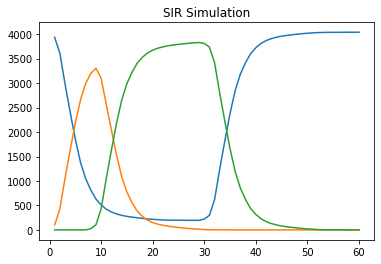

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             148 |
|      2 |   3437 |             117 |
|      3 |   1684 |             105 |
|      4 |      0 |              68 |
|      5 |   1912 |              48 |
|      6 |   2047 |              33 |
|      7 |    348 |              33 |
|      8 |    414 |              32 |
|      9 |   1431 |              28 |
|     10 |   2150 |              22 |
|     11 |   1985 |              21 |
|     12 |   1584 |              19 |
|     13 |    606 |              17 |
|     14 |    686 |              17 |
|     15 |    559 |              16 |
+--------+--------+-----------------+


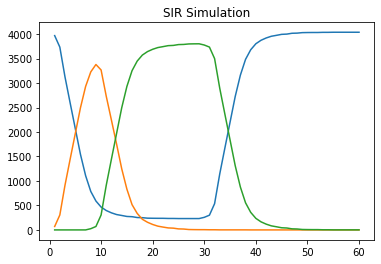

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             144 |
|      2 |   3437 |             123 |
|      3 |   1684 |              99 |
|      4 |      0 |              96 |
|      5 |   1912 |              61 |
|      6 |    348 |              35 |
|      7 |    686 |              32 |
|      8 |    925 |              27 |
|      9 |   1199 |              22 |
|     10 |    414 |              19 |
|     11 |   2543 |              18 |
|     12 |    828 |              15 |
|     13 |   2500 |              14 |
|     14 |    475 |              14 |
|     15 |   3076 |              14 |
+--------+--------+-----------------+


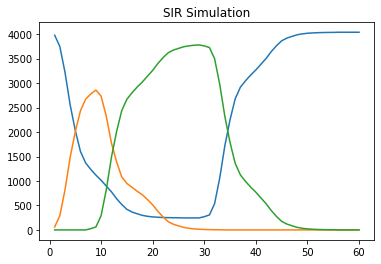

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             188 |
|      2 |   1684 |             109 |
|      3 |   3437 |             102 |
|      4 |   1912 |              88 |
|      5 |      0 |              87 |
|      6 |    348 |              28 |
|      7 |    686 |              27 |
|      8 |   2104 |              23 |
|      9 |    698 |              16 |
|     10 |   2719 |              16 |
|     11 |   1714 |              15 |
|     12 |    414 |              15 |
|     13 |    925 |              14 |
|     14 |   2064 |              13 |
|     15 |   3830 |              13 |
+--------+--------+-----------------+


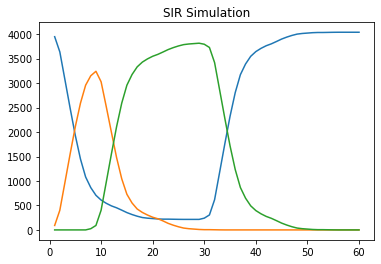

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             122 |
|      2 |    107 |             113 |
|      3 |   3437 |             107 |
|      4 |      0 |              71 |
|      5 |   1912 |              70 |
|      6 |    348 |              42 |
|      7 |    686 |              24 |
|      8 |   2543 |              18 |
|      9 |   3980 |              17 |
|     10 |   2624 |              16 |
|     11 |    947 |              16 |
|     12 |   2936 |              16 |
|     13 |   1471 |              16 |
|     14 |   1929 |              15 |
|     15 |   3233 |              14 |
+--------+--------+-----------------+


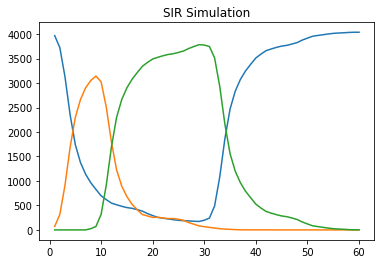

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             175 |
|      2 |   1684 |             144 |
|      3 |   3437 |              95 |
|      4 |      0 |              87 |
|      5 |   1912 |              60 |
|      6 |   1941 |              29 |
|      7 |    414 |              25 |
|      8 |    686 |              23 |
|      9 |    483 |              23 |
|     10 |   3980 |              22 |
|     11 |    698 |              17 |
|     12 |    348 |              16 |
|     13 |   1199 |              16 |
|     14 |   2478 |              16 |
|     15 |   1305 |              16 |
+--------+--------+-----------------+


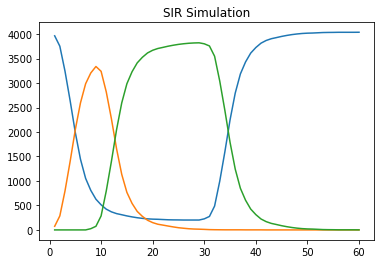

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             160 |
|      2 |   3437 |             125 |
|      3 |    107 |             116 |
|      4 |      0 |              63 |
|      5 |   1912 |              57 |
|      6 |    348 |              28 |
|      7 |   1621 |              25 |
|      8 |   1941 |              22 |
|      9 |   2323 |              22 |
|     10 |    353 |              18 |
|     11 |    414 |              18 |
|     12 |   3980 |              16 |
|     13 |    686 |              16 |
|     14 |    805 |              14 |
|     15 |   2543 |              13 |
+--------+--------+-----------------+


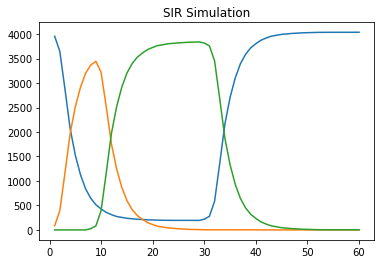

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             158 |
|      2 |   1684 |             145 |
|      3 |   3437 |             131 |
|      4 |   1912 |             101 |
|      5 |      0 |              79 |
|      6 |    348 |              32 |
|      7 |    414 |              25 |
|      8 |    917 |              21 |
|      9 |   2679 |              20 |
|     10 |   2526 |              19 |
|     11 |   3980 |              18 |
|     12 |    483 |              17 |
|     13 |   2828 |              16 |
|     14 |   2347 |              16 |
|     15 |   1361 |              16 |
+--------+--------+-----------------+


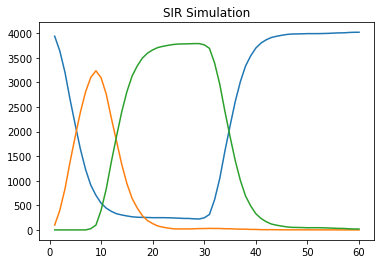

Giorno 60 :
Suscettibili: 4021
Infetti: 0
Guariti: 18
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             138 |
|      2 |   1684 |             123 |
|      3 |   3437 |             116 |
|      4 |   1912 |             103 |
|      5 |      0 |              70 |
|      6 |    348 |              39 |
|      7 |    686 |              34 |
|      8 |    483 |              22 |
|      9 |   2078 |              21 |
|     10 |   3980 |              17 |
|     11 |   2072 |              17 |
|     12 |    698 |              16 |
|     13 |   2369 |              16 |
|     14 |   2266 |              16 |
|     15 |    428 |              16 |
+--------+--------+-----------------+


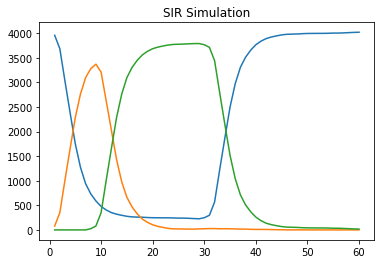

Giorno 60 :
Suscettibili: 4022
Infetti: 0
Guariti: 17
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             163 |
|      2 |   3437 |             125 |
|      3 |   1684 |             102 |
|      4 |      0 |              77 |
|      5 |   1912 |              76 |
|      6 |    348 |              32 |
|      7 |   2140 |              24 |
|      8 |    414 |              21 |
|      9 |    686 |              21 |
|     10 |   1017 |              19 |
|     11 |   3980 |              18 |
|     12 |   2906 |              17 |
|     13 |   2199 |              16 |
|     14 |   2191 |              14 |
|     15 |   2047 |              14 |
+--------+--------+-----------------+


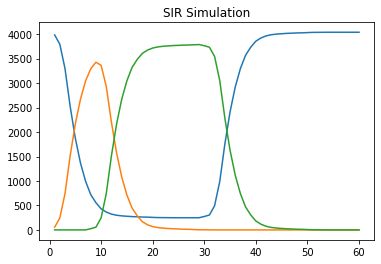

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             166 |
|      2 |   3437 |             112 |
|      3 |   1684 |              99 |
|      4 |   1912 |              80 |
|      5 |      0 |              79 |
|      6 |    348 |              39 |
|      7 |    686 |              36 |
|      8 |    414 |              28 |
|      9 |   2037 |              24 |
|     10 |   2313 |              19 |
|     11 |   2347 |              18 |
|     12 |    483 |              17 |
|     13 |   1376 |              16 |
|     14 |    856 |              15 |
|     15 |   3101 |              15 |
+--------+--------+-----------------+


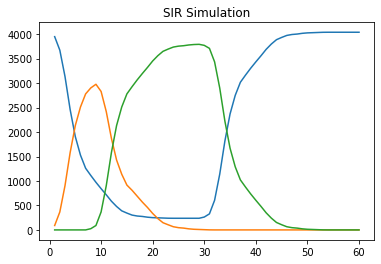

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             116 |
|      2 |   1684 |             114 |
|      3 |    107 |             111 |
|      4 |   1912 |              75 |
|      5 |      0 |              53 |
|      6 |    686 |              40 |
|      7 |    348 |              30 |
|      8 |    414 |              22 |
|      9 |   2047 |              20 |
|     10 |   1185 |              20 |
|     11 |    363 |              19 |
|     12 |    376 |              18 |
|     13 |   2123 |              17 |
|     14 |   2313 |              16 |
|     15 |   2347 |              16 |
+--------+--------+-----------------+


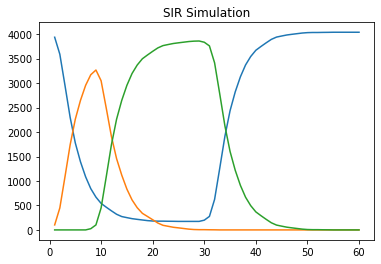

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             172 |
|      2 |   3437 |             128 |
|      3 |   1684 |             127 |
|      4 |      0 |              87 |
|      5 |   1912 |              59 |
|      6 |    348 |              31 |
|      7 |    414 |              23 |
|      8 |   2240 |              20 |
|      9 |   2598 |              19 |
|     10 |    563 |              18 |
|     11 |    136 |              18 |
|     12 |   3101 |              17 |
|     13 |   1104 |              17 |
|     14 |   3980 |              16 |
|     15 |    686 |              16 |
+--------+--------+-----------------+


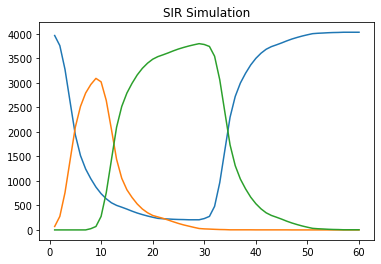

Giorno 60 :
Suscettibili: 4036
Infetti: 0
Guariti: 3
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             168 |
|      2 |   3437 |             104 |
|      3 |   1684 |              66 |
|      4 |      0 |              50 |
|      5 |   1912 |              45 |
|      6 |    348 |              37 |
|      7 |   1943 |              27 |
|      8 |    376 |              24 |
|      9 |   2384 |              23 |
|     10 |   3980 |              20 |
|     11 |    414 |              19 |
|     12 |   1979 |              16 |
|     13 |   2742 |              15 |
|     14 |   3113 |              14 |
|     15 |   1352 |              13 |
+--------+--------+-----------------+


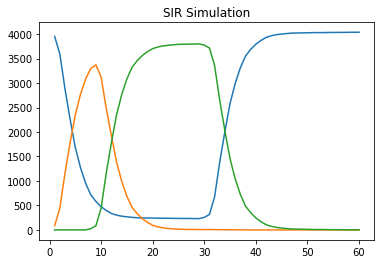

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             185 |
|      2 |   1684 |             123 |
|      3 |   3437 |             118 |
|      4 |   1912 |             109 |
|      5 |      0 |              84 |
|      6 |    414 |              35 |
|      7 |   2786 |              25 |
|      8 |    686 |              22 |
|      9 |    348 |              22 |
|     10 |   2187 |              20 |
|     11 |    698 |              15 |
|     12 |   3076 |              14 |
|     13 |    483 |              14 |
|     14 |   2604 |              13 |
|     15 |   2104 |              13 |
+--------+--------+-----------------+


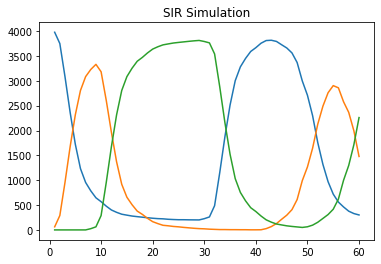

Giorno 60 :
Suscettibili: 301
Infetti: 1478
Guariti: 2260
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             366 |
|      2 |   1684 |             305 |
|      3 |   3437 |             269 |
|      4 |      0 |             179 |
|      5 |   1912 |             167 |
|      6 |    414 |              55 |
|      7 |    348 |              52 |
|      8 |   1718 |              44 |
|      9 |    686 |              43 |
|     10 |   1086 |              29 |
|     11 |    698 |              28 |
|     12 |    483 |              28 |
|     13 |   2542 |              26 |
|     14 |    917 |              23 |
|     15 |    376 |              22 |
+--------+--------+-----------------+


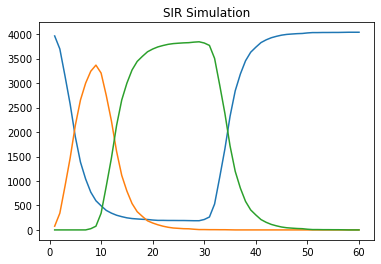

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             152 |
|      2 |    107 |             108 |
|      3 |   3437 |             101 |
|      4 |   1912 |              77 |
|      5 |      0 |              65 |
|      6 |    686 |              43 |
|      7 |    414 |              29 |
|      8 |    348 |              25 |
|      9 |   1431 |              23 |
|     10 |   1014 |              18 |
|     11 |    925 |              17 |
|     12 |   2172 |              17 |
|     13 |   2543 |              16 |
|     14 |   1416 |              15 |
|     15 |   2592 |              15 |
+--------+--------+-----------------+


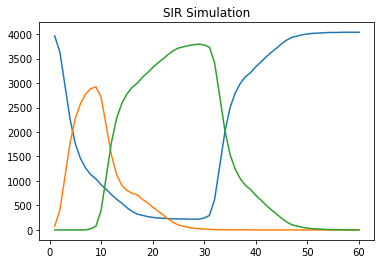

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             182 |
|      2 |   1684 |             136 |
|      3 |   3437 |             118 |
|      4 |   1912 |              80 |
|      5 |      0 |              66 |
|      6 |    348 |              29 |
|      7 |    686 |              29 |
|      8 |   2124 |              22 |
|      9 |    698 |              21 |
|     10 |    428 |              20 |
|     11 |    414 |              19 |
|     12 |    483 |              17 |
|     13 |   1577 |              17 |
|     14 |   1070 |              17 |
|     15 |   2863 |              16 |
+--------+--------+-----------------+


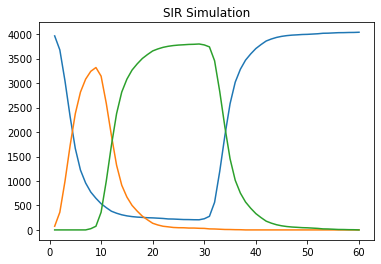

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             183 |
|      2 |   1684 |             135 |
|      3 |   1912 |              84 |
|      4 |   3437 |              82 |
|      5 |      0 |              66 |
|      6 |    348 |              28 |
|      7 |   2271 |              27 |
|      8 |    686 |              25 |
|      9 |   2047 |              20 |
|     10 |    698 |              19 |
|     11 |    414 |              16 |
|     12 |   1577 |              16 |
|     13 |   3035 |              15 |
|     14 |   1622 |              14 |
|     15 |   1983 |              13 |
+--------+--------+-----------------+


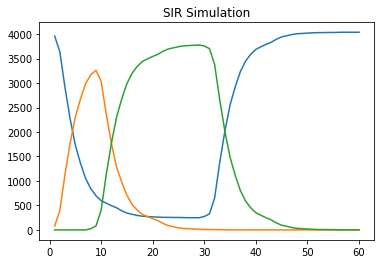

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             182 |
|      2 |   1684 |             128 |
|      3 |   3437 |             120 |
|      4 |   1912 |              76 |
|      5 |      0 |              71 |
|      6 |    348 |              33 |
|      7 |    686 |              32 |
|      8 |   2111 |              23 |
|      9 |   2073 |              21 |
|     10 |    483 |              20 |
|     11 |    414 |              20 |
|     12 |   3830 |              19 |
|     13 |   1331 |              19 |
|     14 |   2007 |              17 |
|     15 |   3387 |              17 |
+--------+--------+-----------------+


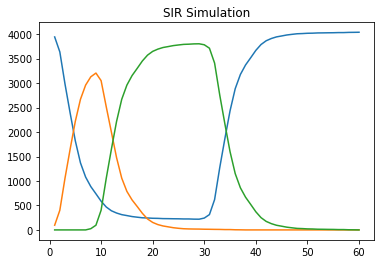

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             141 |
|      2 |   1684 |             133 |
|      3 |   3437 |             131 |
|      4 |      0 |              79 |
|      5 |   1912 |              77 |
|      6 |    348 |              32 |
|      7 |    686 |              32 |
|      8 |    414 |              28 |
|      9 |   1431 |              28 |
|     10 |   1107 |              23 |
|     11 |    483 |              21 |
|     12 |    828 |              17 |
|     13 |   2199 |              15 |
|     14 |   2408 |              15 |
|     15 |    941 |              14 |
+--------+--------+-----------------+


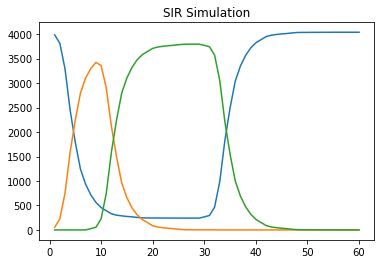

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             170 |
|      2 |   1684 |             165 |
|      3 |   1912 |             105 |
|      4 |   3437 |             105 |
|      5 |      0 |              69 |
|      6 |    348 |              41 |
|      7 |    686 |              33 |
|      8 |    483 |              30 |
|      9 |   1086 |              18 |
|     10 |    414 |              18 |
|     11 |   2005 |              17 |
|     12 |   2172 |              15 |
|     13 |    376 |              15 |
|     14 |    428 |              14 |
|     15 |    713 |              13 |
+--------+--------+-----------------+


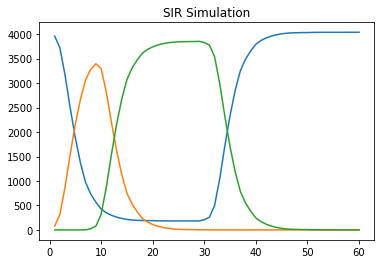

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             132 |
|      2 |   3437 |             124 |
|      3 |      0 |              92 |
|      4 |    107 |              90 |
|      5 |   1912 |              46 |
|      6 |    348 |              38 |
|      7 |    686 |              33 |
|      8 |   2266 |              28 |
|      9 |    414 |              23 |
|     10 |   3980 |              22 |
|     11 |   1613 |              22 |
|     12 |   2038 |              18 |
|     13 |    483 |              18 |
|     14 |   1267 |              17 |
|     15 |   3060 |              15 |
+--------+--------+-----------------+


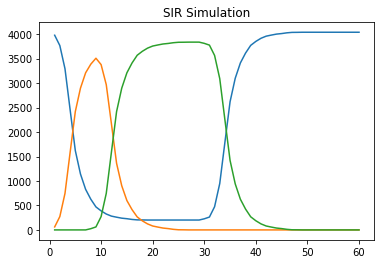

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             183 |
|      2 |   1912 |             137 |
|      3 |   1684 |             130 |
|      4 |   3437 |              98 |
|      5 |      0 |              95 |
|      6 |    348 |              42 |
|      7 |    483 |              39 |
|      8 |    686 |              29 |
|      9 |    414 |              28 |
|     10 |   1086 |              18 |
|     11 |     25 |              16 |
|     12 |   3363 |              15 |
|     13 |   3980 |              15 |
|     14 |    698 |              14 |
|     15 |   2072 |              13 |
+--------+--------+-----------------+


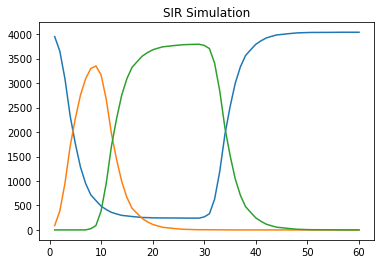

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             176 |
|      2 |   1684 |             139 |
|      3 |   3437 |             117 |
|      4 |   1912 |              90 |
|      5 |      0 |              75 |
|      6 |    686 |              39 |
|      7 |    348 |              25 |
|      8 |    917 |              24 |
|      9 |   2543 |              23 |
|     10 |   2347 |              22 |
|     11 |    414 |              20 |
|     12 |   2604 |              16 |
|     13 |   2289 |              15 |
|     14 |   1352 |              14 |
|     15 |    374 |              13 |
+--------+--------+-----------------+


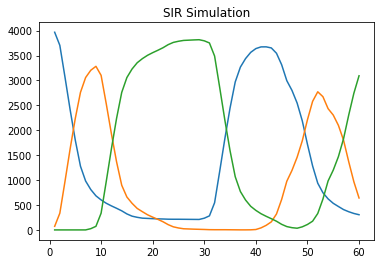

Giorno 60 :
Suscettibili: 305
Infetti: 641
Guariti: 3093
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             303 |
|      2 |   1684 |             264 |
|      3 |   3437 |             254 |
|      4 |   1912 |             180 |
|      5 |      0 |             157 |
|      6 |    348 |              75 |
|      7 |    686 |              50 |
|      8 |    483 |              45 |
|      9 |    414 |              39 |
|     10 |    698 |              33 |
|     11 |   1086 |              26 |
|     12 |   1577 |              25 |
|     13 |   1126 |              24 |
|     14 |   1153 |              21 |
|     15 |    363 |              21 |
+--------+--------+-----------------+


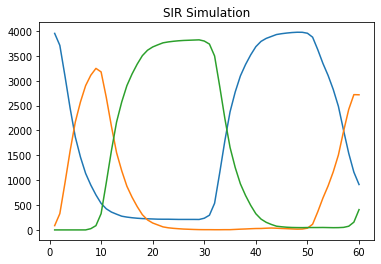

Giorno 60 :
Suscettibili: 913
Infetti: 2718
Guariti: 408
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             235 |
|      2 |    107 |             229 |
|      3 |   3437 |             221 |
|      4 |   1912 |             130 |
|      5 |      0 |             117 |
|      6 |    348 |              55 |
|      7 |    414 |              39 |
|      8 |    483 |              34 |
|      9 |   2007 |              33 |
|     10 |    563 |              32 |
|     11 |   1718 |              27 |
|     12 |    136 |              25 |
|     13 |   1078 |              24 |
|     14 |    475 |              23 |
|     15 |   1917 |              22 |
+--------+--------+-----------------+


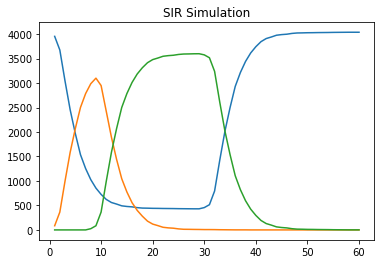

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             113 |
|      2 |   1684 |             107 |
|      3 |    107 |              97 |
|      4 |      0 |              91 |
|      5 |    348 |              52 |
|      6 |   1912 |              50 |
|      7 |   2104 |              20 |
|      8 |   1833 |              20 |
|      9 |    483 |              19 |
|     10 |    414 |              19 |
|     11 |    917 |              19 |
|     12 |   2543 |              18 |
|     13 |   2007 |              16 |
|     14 |   2951 |              16 |
|     15 |   1985 |              16 |
+--------+--------+-----------------+


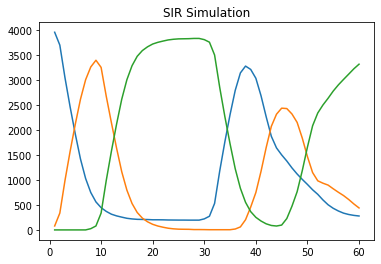

Giorno 60 :
Suscettibili: 279
Infetti: 440
Guariti: 3320
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             318 |
|      2 |   1684 |             296 |
|      3 |   3437 |             225 |
|      4 |   1912 |             159 |
|      5 |      0 |             153 |
|      6 |    414 |              55 |
|      7 |    686 |              53 |
|      8 |    348 |              47 |
|      9 |    698 |              41 |
|     10 |   3830 |              36 |
|     11 |    483 |              34 |
|     12 |   1577 |              28 |
|     13 |   1985 |              25 |
|     14 |    428 |              24 |
|     15 |   1199 |              23 |
+--------+--------+-----------------+


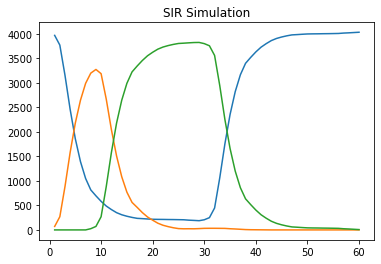

Giorno 60 :
Suscettibili: 4032
Infetti: 0
Guariti: 7
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             132 |
|      2 |   1684 |             108 |
|      3 |   3437 |             103 |
|      4 |      0 |              90 |
|      5 |   1912 |              76 |
|      6 |   2543 |              33 |
|      7 |    414 |              24 |
|      8 |    136 |              21 |
|      9 |    376 |              21 |
|     10 |    348 |              21 |
|     11 |    698 |              20 |
|     12 |    686 |              19 |
|     13 |    366 |              17 |
|     14 |   3051 |              17 |
|     15 |   2131 |              17 |
+--------+--------+-----------------+


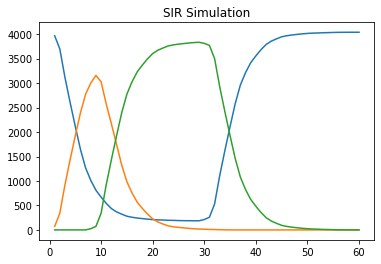

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             151 |
|      2 |   1684 |             134 |
|      3 |   1912 |             111 |
|      4 |   3437 |             101 |
|      5 |      0 |              96 |
|      6 |   2118 |              30 |
|      7 |    686 |              28 |
|      8 |    348 |              26 |
|      9 |    414 |              18 |
|     10 |    698 |              17 |
|     11 |   3830 |              17 |
|     12 |   1839 |              16 |
|     13 |   1377 |              16 |
|     14 |   3633 |              16 |
|     15 |   3980 |              14 |
+--------+--------+-----------------+


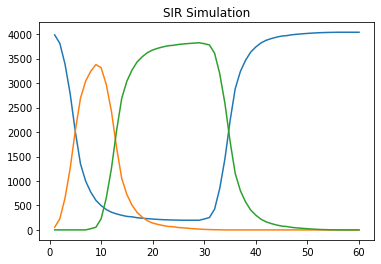

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             170 |
|      2 |   1684 |             124 |
|      3 |   1912 |             124 |
|      4 |   3437 |              80 |
|      5 |      0 |              63 |
|      6 |    686 |              42 |
|      7 |    348 |              37 |
|      8 |    414 |              22 |
|      9 |   3980 |              15 |
|     10 |    896 |              15 |
|     11 |   2150 |              15 |
|     12 |   1126 |              15 |
|     13 |   2676 |              15 |
|     14 |   1584 |              15 |
|     15 |   2139 |              14 |
+--------+--------+-----------------+


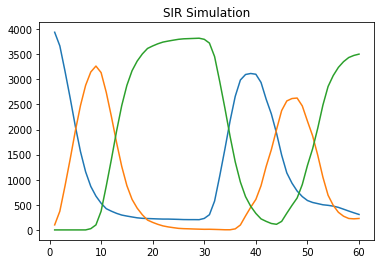

Giorno 60 :
Suscettibili: 308
Infetti: 228
Guariti: 3503
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             331 |
|      2 |   3437 |             253 |
|      3 |   1684 |             223 |
|      4 |   1912 |             188 |
|      5 |      0 |             170 |
|      6 |    348 |              52 |
|      7 |    414 |              52 |
|      8 |    698 |              44 |
|      9 |    686 |              39 |
|     10 |    483 |              38 |
|     11 |   3830 |              35 |
|     12 |   3980 |              30 |
|     13 |   1718 |              25 |
|     14 |   1086 |              25 |
|     15 |    376 |              23 |
+--------+--------+-----------------+


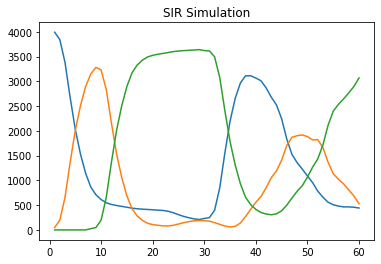

Giorno 60 :
Suscettibili: 442
Infetti: 528
Guariti: 3069
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             303 |
|      2 |   1684 |             263 |
|      3 |   3437 |             242 |
|      4 |      0 |             155 |
|      5 |   1912 |             149 |
|      6 |    348 |              55 |
|      7 |    414 |              40 |
|      8 |    686 |              29 |
|      9 |   1352 |              28 |
|     10 |   2543 |              28 |
|     11 |    428 |              26 |
|     12 |    376 |              26 |
|     13 |   1941 |              26 |
|     14 |   1505 |              24 |
|     15 |   2117 |              23 |
+--------+--------+-----------------+


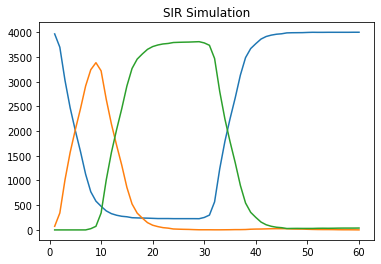

Giorno 60 :
Suscettibili: 4000
Infetti: 1
Guariti: 38
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             174 |
|      2 |    107 |             139 |
|      3 |   3437 |             126 |
|      4 |   1912 |              74 |
|      5 |      0 |              70 |
|      6 |    348 |              42 |
|      7 |    686 |              25 |
|      8 |    414 |              23 |
|      9 |    483 |              22 |
|     10 |    698 |              21 |
|     11 |    353 |              21 |
|     12 |   2631 |              17 |
|     13 |   1341 |              17 |
|     14 |    925 |              16 |
|     15 |   1577 |              14 |
+--------+--------+-----------------+


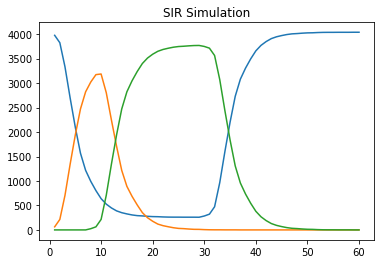

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             126 |
|      2 |   3437 |             121 |
|      3 |   1684 |             108 |
|      4 |   1912 |              84 |
|      5 |      0 |              66 |
|      6 |    483 |              33 |
|      7 |    686 |              23 |
|      8 |    414 |              21 |
|      9 |   1941 |              18 |
|     10 |    348 |              17 |
|     11 |    745 |              15 |
|     12 |   1086 |              15 |
|     13 |   3179 |              15 |
|     14 |   2347 |              14 |
|     15 |   1447 |              13 |
+--------+--------+-----------------+


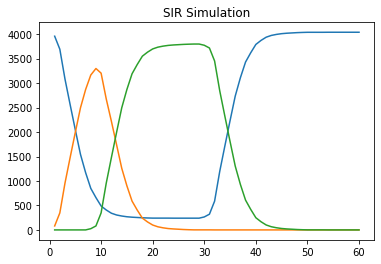

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             144 |
|      2 |   1684 |             125 |
|      3 |   3437 |             106 |
|      4 |      0 |              85 |
|      5 |   1912 |              81 |
|      6 |    686 |              31 |
|      7 |   2347 |              25 |
|      8 |    414 |              21 |
|      9 |    348 |              20 |
|     10 |   1663 |              20 |
|     11 |   2543 |              20 |
|     12 |   2511 |              20 |
|     13 |   2200 |              17 |
|     14 |   2237 |              15 |
|     15 |    566 |              14 |
+--------+--------+-----------------+


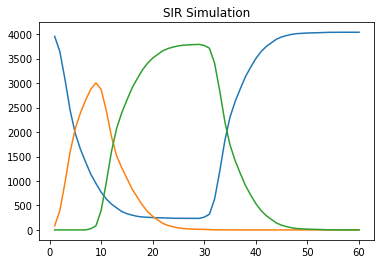

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             150 |
|      2 |   3437 |             116 |
|      3 |   1912 |             108 |
|      4 |   1684 |             103 |
|      5 |      0 |              80 |
|      6 |    348 |              47 |
|      7 |    414 |              36 |
|      8 |    686 |              33 |
|      9 |   1986 |              19 |
|     10 |   2200 |              19 |
|     11 |   2542 |              18 |
|     12 |     56 |              18 |
|     13 |   1377 |              17 |
|     14 |    606 |              16 |
|     15 |    698 |              16 |
+--------+--------+-----------------+


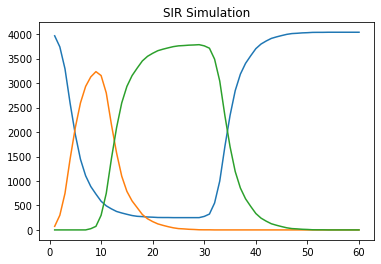

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             129 |
|      2 |    107 |             102 |
|      3 |   1912 |              98 |
|      4 |   3437 |              77 |
|      5 |      0 |              77 |
|      6 |    348 |              30 |
|      7 |   1390 |              24 |
|      8 |    414 |              22 |
|      9 |    686 |              22 |
|     10 |   3830 |              17 |
|     11 |   2395 |              15 |
|     12 |    428 |              14 |
|     13 |   1086 |              14 |
|     14 |    119 |              13 |
|     15 |   2376 |              13 |
+--------+--------+-----------------+


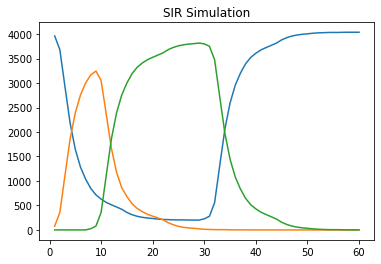

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             140 |
|      2 |    107 |             126 |
|      3 |   3437 |             124 |
|      4 |   1912 |             106 |
|      5 |      0 |              84 |
|      6 |    348 |              37 |
|      7 |    916 |              29 |
|      8 |    686 |              23 |
|      9 |   2347 |              22 |
|     10 |    483 |              20 |
|     11 |   1730 |              20 |
|     12 |    414 |              20 |
|     13 |   3980 |              17 |
|     14 |   3877 |              16 |
|     15 |   1086 |              16 |
+--------+--------+-----------------+


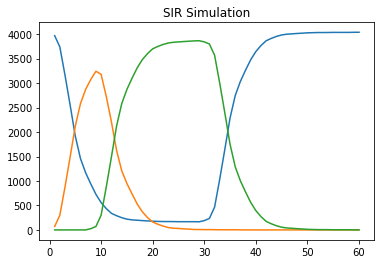

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             153 |
|      2 |   1912 |             117 |
|      3 |   1684 |             106 |
|      4 |   3437 |             100 |
|      5 |      0 |              91 |
|      6 |    686 |              33 |
|      7 |   1984 |              27 |
|      8 |    348 |              27 |
|      9 |    376 |              26 |
|     10 |    414 |              25 |
|     11 |   3980 |              18 |
|     12 |   3201 |              15 |
|     13 |   1827 |              14 |
|     14 |    483 |              13 |
|     15 |   1086 |              13 |
+--------+--------+-----------------+


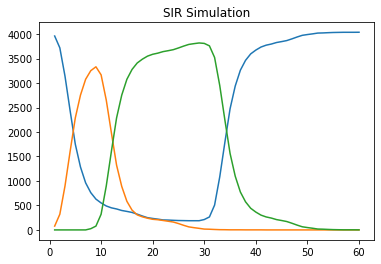

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             165 |
|      2 |   3437 |             129 |
|      3 |   1684 |             116 |
|      4 |      0 |             102 |
|      5 |   1912 |              72 |
|      6 |    414 |              34 |
|      7 |    348 |              27 |
|      8 |    698 |              19 |
|      9 |    400 |              19 |
|     10 |   2381 |              18 |
|     11 |    686 |              18 |
|     12 |   1718 |              17 |
|     13 |   1926 |              17 |
|     14 |   3980 |              15 |
|     15 |    373 |              13 |
+--------+--------+-----------------+


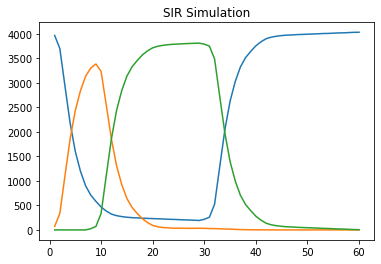

Giorno 60 :
Suscettibili: 4034
Infetti: 0
Guariti: 5
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             160 |
|      2 |   1684 |             117 |
|      3 |   3437 |             102 |
|      4 |   1912 |              93 |
|      5 |      0 |              89 |
|      6 |    348 |              33 |
|      7 |    686 |              27 |
|      8 |    414 |              22 |
|      9 |   3830 |              19 |
|     10 |   1813 |              18 |
|     11 |   2069 |              18 |
|     12 |    526 |              16 |
|     13 |    483 |              15 |
|     14 |   1329 |              14 |
|     15 |   2324 |              14 |
+--------+--------+-----------------+


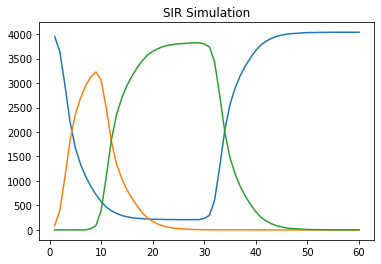

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             172 |
|      2 |   3437 |             109 |
|      3 |   1684 |             104 |
|      4 |      0 |              64 |
|      5 |   1912 |              60 |
|      6 |    348 |              28 |
|      7 |    686 |              20 |
|      8 |    414 |              18 |
|      9 |   2059 |              18 |
|     10 |   2084 |              17 |
|     11 |   1199 |              15 |
|     12 |   2266 |              15 |
|     13 |   1707 |              14 |
|     14 |    475 |              14 |
|     15 |   2689 |              14 |
+--------+--------+-----------------+


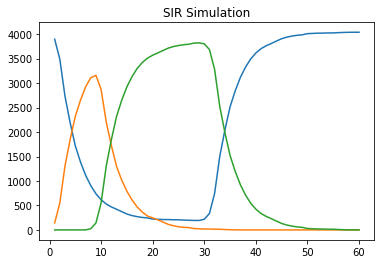

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             181 |
|      2 |   3437 |             128 |
|      3 |   1684 |             116 |
|      4 |      0 |              73 |
|      5 |   1912 |              64 |
|      6 |    348 |              29 |
|      7 |   2347 |              28 |
|      8 |    686 |              23 |
|      9 |   1804 |              21 |
|     10 |    698 |              18 |
|     11 |    414 |              18 |
|     12 |   2602 |              17 |
|     13 |   3038 |              17 |
|     14 |    925 |              17 |
|     15 |    475 |              17 |
+--------+--------+-----------------+


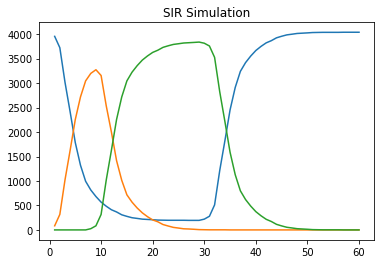

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             140 |
|      2 |    107 |             132 |
|      3 |   3437 |             105 |
|      4 |      0 |              87 |
|      5 |   1912 |              75 |
|      6 |    348 |              30 |
|      7 |    483 |              25 |
|      8 |    946 |              20 |
|      9 |    376 |              20 |
|     10 |    686 |              19 |
|     11 |    414 |              19 |
|     12 |    698 |              18 |
|     13 |   2409 |              17 |
|     14 |   1984 |              15 |
|     15 |   3830 |              14 |
+--------+--------+-----------------+


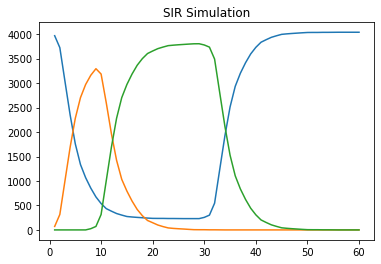

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             141 |
|      2 |   1684 |             134 |
|      3 |   3437 |             100 |
|      4 |      0 |              88 |
|      5 |   1912 |              78 |
|      6 |    483 |              41 |
|      7 |    414 |              28 |
|      8 |    686 |              27 |
|      9 |   1663 |              26 |
|     10 |   1941 |              26 |
|     11 |    348 |              22 |
|     12 |   2683 |              17 |
|     13 |   3426 |              15 |
|     14 |   1331 |              14 |
|     15 |    363 |              14 |
+--------+--------+-----------------+


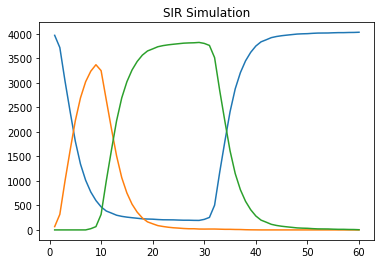

Giorno 60 :
Suscettibili: 4035
Infetti: 0
Guariti: 4
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             160 |
|      2 |   1684 |             134 |
|      3 |   3437 |             128 |
|      4 |      0 |              75 |
|      5 |   1912 |              57 |
|      6 |    686 |              35 |
|      7 |    414 |              20 |
|      8 |   1997 |              19 |
|      9 |   2543 |              16 |
|     10 |    348 |              16 |
|     11 |    136 |              16 |
|     12 |   1604 |              16 |
|     13 |   1472 |              16 |
|     14 |   1191 |              15 |
|     15 |    376 |              15 |
+--------+--------+-----------------+


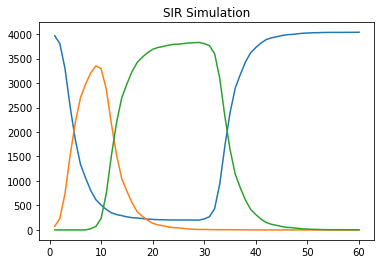

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             137 |
|      2 |   1684 |             112 |
|      3 |   3437 |              96 |
|      4 |   1912 |              84 |
|      5 |      0 |              48 |
|      6 |    483 |              30 |
|      7 |    348 |              25 |
|      8 |    686 |              24 |
|      9 |    414 |              19 |
|     10 |    277 |              19 |
|     11 |   1330 |              18 |
|     12 |   2347 |              18 |
|     13 |    428 |              17 |
|     14 |    917 |              16 |
|     15 |   1604 |              16 |
+--------+--------+-----------------+


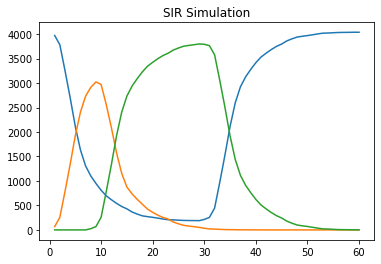

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             135 |
|      2 |   1684 |             133 |
|      3 |   3437 |             108 |
|      4 |      0 |              63 |
|      5 |   1912 |              53 |
|      6 |    414 |              25 |
|      7 |    686 |              22 |
|      8 |   3980 |              22 |
|      9 |    348 |              20 |
|     10 |   2951 |              19 |
|     11 |   2347 |              19 |
|     12 |   2543 |              18 |
|     13 |    698 |              17 |
|     14 |    412 |              17 |
|     15 |   2133 |              15 |
+--------+--------+-----------------+


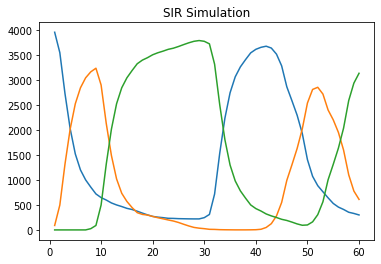

Giorno 60 :
Suscettibili: 299
Infetti: 610
Guariti: 3130
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             353 |
|      2 |   1684 |             268 |
|      3 |   3437 |             247 |
|      4 |   1912 |             181 |
|      5 |      0 |             112 |
|      6 |    348 |              73 |
|      7 |    686 |              67 |
|      8 |    414 |              41 |
|      9 |    698 |              36 |
|     10 |    483 |              35 |
|     11 |   3980 |              32 |
|     12 |   1984 |              25 |
|     13 |   1718 |              24 |
|     14 |     56 |              20 |
|     15 |    136 |              20 |
+--------+--------+-----------------+


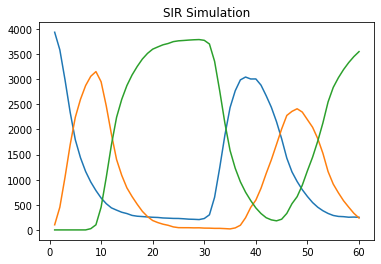

Giorno 60 :
Suscettibili: 251
Infetti: 237
Guariti: 3551
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             343 |
|      2 |   1684 |             235 |
|      3 |   3437 |             207 |
|      4 |   1912 |             174 |
|      5 |      0 |             166 |
|      6 |    414 |              69 |
|      7 |    348 |              58 |
|      8 |    686 |              47 |
|      9 |    698 |              35 |
|     10 |   2347 |              28 |
|     11 |    483 |              28 |
|     12 |   3830 |              27 |
|     13 |   1718 |              26 |
|     14 |   2309 |              26 |
|     15 |    136 |              26 |
+--------+--------+-----------------+


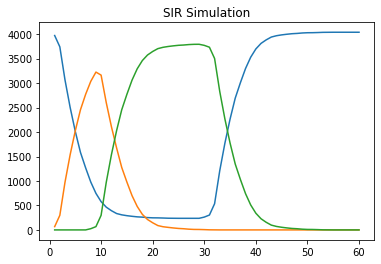

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             150 |
|      2 |   3437 |             135 |
|      3 |   1684 |             131 |
|      4 |   1912 |             103 |
|      5 |      0 |              79 |
|      6 |    348 |              39 |
|      7 |   3830 |              24 |
|      8 |    414 |              20 |
|      9 |   2068 |              18 |
|     10 |    698 |              16 |
|     11 |   1941 |              15 |
|     12 |   2220 |              15 |
|     13 |    483 |              14 |
|     14 |   2539 |              14 |
|     15 |   1845 |              14 |
+--------+--------+-----------------+


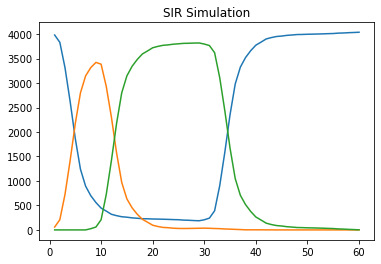

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             150 |
|      2 |   3437 |             120 |
|      3 |   1684 |             107 |
|      4 |   1912 |             101 |
|      5 |      0 |              73 |
|      6 |    686 |              25 |
|      7 |    348 |              24 |
|      8 |   1964 |              19 |
|      9 |    414 |              19 |
|     10 |   1620 |              18 |
|     11 |   3980 |              17 |
|     12 |    997 |              16 |
|     13 |    538 |              15 |
|     14 |   3397 |              14 |
|     15 |   2347 |              13 |
+--------+--------+-----------------+


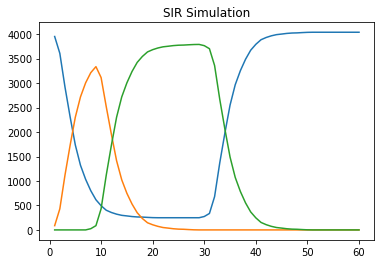

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             176 |
|      2 |   1684 |             133 |
|      3 |   3437 |             121 |
|      4 |   1912 |              77 |
|      5 |      0 |              74 |
|      6 |    348 |              34 |
|      7 |    686 |              26 |
|      8 |    414 |              21 |
|      9 |    483 |              18 |
|     10 |   2039 |              18 |
|     11 |   2369 |              15 |
|     12 |   1799 |              15 |
|     13 |   1124 |              15 |
|     14 |   2669 |              14 |
|     15 |   2340 |              13 |
+--------+--------+-----------------+


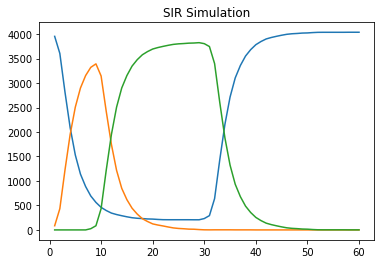

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             169 |
|      2 |   1684 |             161 |
|      3 |   3437 |             119 |
|      4 |   1912 |              82 |
|      5 |      0 |              77 |
|      6 |    348 |              32 |
|      7 |    686 |              27 |
|      8 |   1577 |              27 |
|      9 |   2123 |              23 |
|     10 |    698 |              21 |
|     11 |   3280 |              16 |
|     12 |     67 |              16 |
|     13 |    517 |              14 |
|     14 |    373 |              14 |
|     15 |   3980 |              14 |
+--------+--------+-----------------+


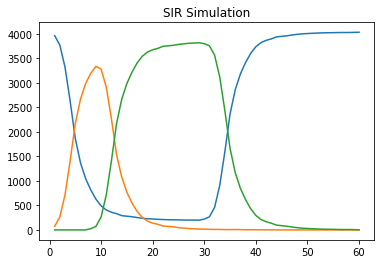

Giorno 60 :
Suscettibili: 4036
Infetti: 0
Guariti: 3
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             143 |
|      2 |    107 |             124 |
|      3 |   3437 |             123 |
|      4 |      0 |              94 |
|      5 |   1912 |              91 |
|      6 |    686 |              25 |
|      7 |    348 |              20 |
|      8 |    414 |              20 |
|      9 |    353 |              19 |
|     10 |    475 |              18 |
|     11 |   2331 |              17 |
|     12 |   1017 |              16 |
|     13 |    428 |              16 |
|     14 |   3684 |              15 |
|     15 |   2468 |              14 |
+--------+--------+-----------------+


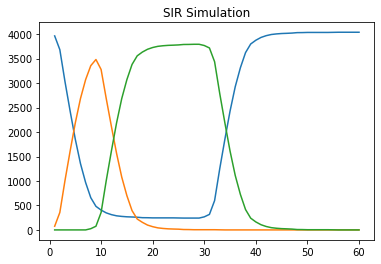

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             158 |
|      2 |   3437 |             139 |
|      3 |   1684 |             136 |
|      4 |      0 |              90 |
|      5 |   1912 |              73 |
|      6 |    348 |              40 |
|      7 |    686 |              38 |
|      8 |   1352 |              24 |
|      9 |    414 |              18 |
|     10 |   1925 |              17 |
|     11 |    475 |              15 |
|     12 |    428 |              15 |
|     13 |   1026 |              14 |
|     14 |   2338 |              14 |
|     15 |   2020 |              14 |
+--------+--------+-----------------+


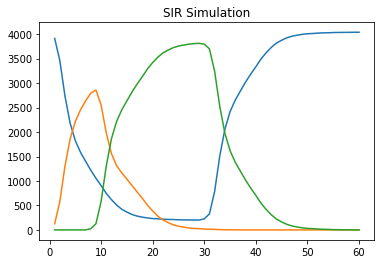

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             155 |
|      2 |   1684 |             110 |
|      3 |   3437 |              92 |
|      4 |      0 |              89 |
|      5 |    348 |              47 |
|      6 |   1912 |              40 |
|      7 |    686 |              32 |
|      8 |   2047 |              22 |
|      9 |   3830 |              22 |
|     10 |   1211 |              21 |
|     11 |   2007 |              20 |
|     12 |   2266 |              19 |
|     13 |   2464 |              19 |
|     14 |    414 |              17 |
|     15 |   3252 |              16 |
+--------+--------+-----------------+


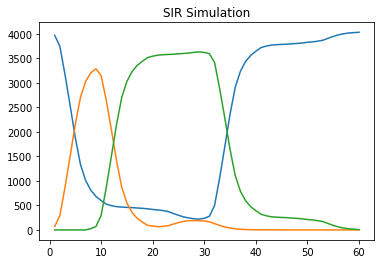

Giorno 60 :
Suscettibili: 4032
Infetti: 0
Guariti: 7
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             119 |
|      2 |    107 |             109 |
|      3 |   1684 |              99 |
|      4 |      0 |              93 |
|      5 |   1912 |              93 |
|      6 |    348 |              34 |
|      7 |    414 |              25 |
|      8 |   1917 |              22 |
|      9 |    686 |              20 |
|     10 |    925 |              19 |
|     11 |    483 |              19 |
|     12 |    698 |              18 |
|     13 |   1620 |              17 |
|     14 |   3980 |              17 |
|     15 |   1078 |              17 |
+--------+--------+-----------------+


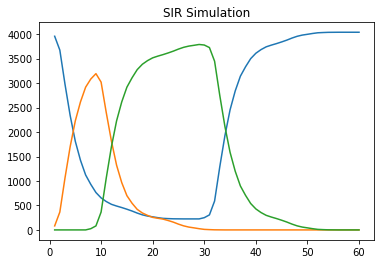

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             146 |
|      2 |   1684 |             104 |
|      3 |   3437 |              99 |
|      4 |   1912 |              97 |
|      5 |      0 |              63 |
|      6 |    686 |              36 |
|      7 |    414 |              27 |
|      8 |    348 |              26 |
|      9 |   1431 |              24 |
|     10 |   3830 |              16 |
|     11 |   1946 |              16 |
|     12 |    428 |              16 |
|     13 |    483 |              15 |
|     14 |    698 |              15 |
|     15 |    475 |              14 |
+--------+--------+-----------------+


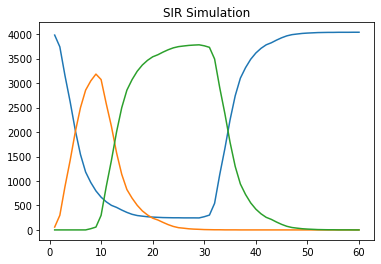

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             146 |
|      2 |   1912 |             114 |
|      3 |    107 |             103 |
|      4 |   3437 |              96 |
|      5 |      0 |              69 |
|      6 |   1352 |              29 |
|      7 |    686 |              24 |
|      8 |    698 |              21 |
|      9 |   2543 |              21 |
|     10 |   1598 |              20 |
|     11 |   1604 |              18 |
|     12 |   2340 |              18 |
|     13 |    414 |              15 |
|     14 |   2138 |              15 |
|     15 |    363 |              14 |
+--------+--------+-----------------+


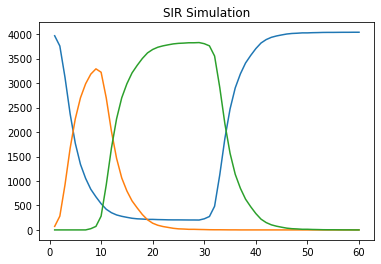

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             139 |
|      2 |   3437 |             116 |
|      3 |   1684 |              87 |
|      4 |      0 |              78 |
|      5 |   1912 |              60 |
|      6 |    348 |              38 |
|      7 |    414 |              24 |
|      8 |   3980 |              20 |
|      9 |   2863 |              18 |
|     10 |   3830 |              17 |
|     11 |   1929 |              17 |
|     12 |   1946 |              16 |
|     13 |   2194 |              15 |
|     14 |    698 |              15 |
|     15 |    353 |              15 |
+--------+--------+-----------------+


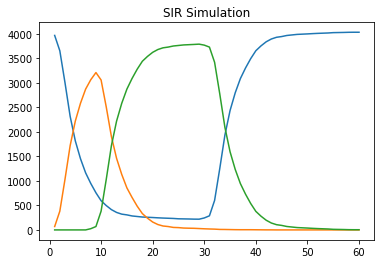

Giorno 60 :
Suscettibili: 4035
Infetti: 0
Guariti: 4
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             166 |
|      2 |   1684 |             134 |
|      3 |   3437 |             115 |
|      4 |   1912 |             112 |
|      5 |      0 |              78 |
|      6 |    686 |              34 |
|      7 |    348 |              24 |
|      8 |   1929 |              19 |
|      9 |    698 |              17 |
|     10 |    414 |              16 |
|     11 |   1447 |              15 |
|     12 |   2172 |              14 |
|     13 |   2839 |              14 |
|     14 |   2117 |              13 |
|     15 |   1085 |              13 |
+--------+--------+-----------------+


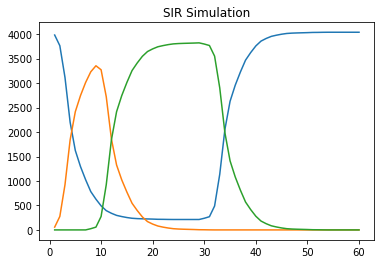

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             189 |
|      2 |   1684 |             131 |
|      3 |   1912 |             108 |
|      4 |   3437 |              98 |
|      5 |      0 |              76 |
|      6 |    348 |              34 |
|      7 |    414 |              26 |
|      8 |    686 |              20 |
|      9 |   3980 |              20 |
|     10 |    483 |              18 |
|     11 |   3830 |              16 |
|     12 |   3584 |              15 |
|     13 |   1078 |              14 |
|     14 |    698 |              13 |
|     15 |   1345 |              13 |
+--------+--------+-----------------+


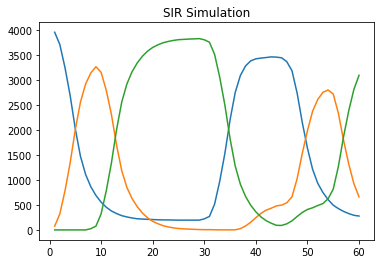

Giorno 60 :
Suscettibili: 278
Infetti: 661
Guariti: 3100
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             303 |
|      2 |   3437 |             254 |
|      3 |   1684 |             221 |
|      4 |      0 |             147 |
|      5 |   1912 |             139 |
|      6 |    348 |              59 |
|      7 |    686 |              43 |
|      8 |    414 |              41 |
|      9 |    698 |              34 |
|     10 |   3980 |              30 |
|     11 |   1718 |              30 |
|     12 |   1983 |              28 |
|     13 |   2047 |              28 |
|     14 |    475 |              26 |
|     15 |   2542 |              23 |
+--------+--------+-----------------+


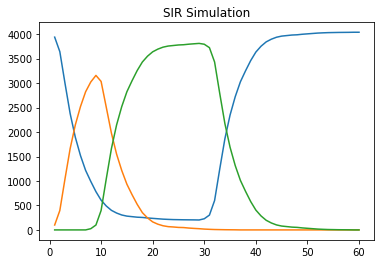

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             129 |
|      2 |   1912 |              91 |
|      3 |   1684 |              83 |
|      4 |    107 |              77 |
|      5 |      0 |              64 |
|      6 |   2324 |              25 |
|      7 |    348 |              24 |
|      8 |    686 |              22 |
|      9 |   3980 |              19 |
|     10 |    483 |              18 |
|     11 |    563 |              17 |
|     12 |   1799 |              17 |
|     13 |    414 |              16 |
|     14 |   2542 |              16 |
|     15 |   2800 |              15 |
+--------+--------+-----------------+


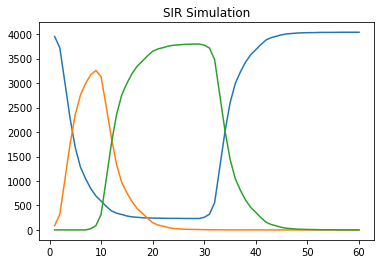

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             150 |
|      2 |   3437 |             122 |
|      3 |   1912 |              88 |
|      4 |   1684 |              87 |
|      5 |      0 |              80 |
|      6 |    348 |              37 |
|      7 |   2266 |              35 |
|      8 |    686 |              27 |
|      9 |    483 |              20 |
|     10 |    414 |              20 |
|     11 |    698 |              19 |
|     12 |   2679 |              17 |
|     13 |    713 |              16 |
|     14 |   1329 |              16 |
|     15 |   1487 |              15 |
+--------+--------+-----------------+


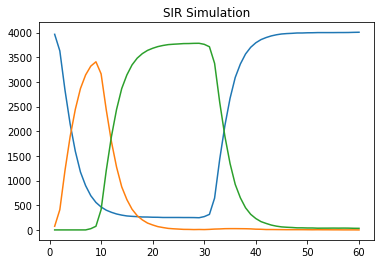

Giorno 60 :
Suscettibili: 4007
Infetti: 0
Guariti: 32
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             158 |
|      2 |    107 |             151 |
|      3 |   1912 |             110 |
|      4 |   3437 |             107 |
|      5 |      0 |              86 |
|      6 |    414 |              24 |
|      7 |    348 |              20 |
|      8 |   2138 |              20 |
|      9 |    698 |              19 |
|     10 |   1610 |              18 |
|     11 |    993 |              15 |
|     12 |   3101 |              14 |
|     13 |   3830 |              14 |
|     14 |    483 |              13 |
|     15 |   1303 |              13 |
+--------+--------+-----------------+


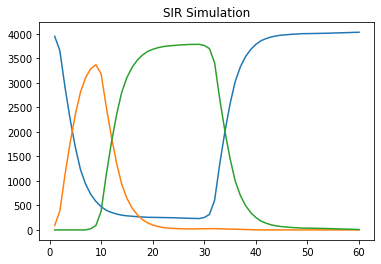

Giorno 60 :
Suscettibili: 4031
Infetti: 0
Guariti: 8
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             132 |
|      2 |   3437 |             114 |
|      3 |   1684 |              90 |
|      4 |   1912 |              76 |
|      5 |      0 |              69 |
|      6 |    686 |              29 |
|      7 |    348 |              29 |
|      8 |    980 |              23 |
|      9 |   2890 |              22 |
|     10 |   1939 |              19 |
|     11 |   2602 |              19 |
|     12 |   3830 |              17 |
|     13 |   2240 |              17 |
|     14 |    428 |              16 |
|     15 |    563 |              16 |
+--------+--------+-----------------+


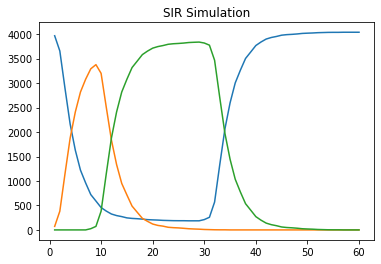

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             176 |
|      2 |   1684 |             140 |
|      3 |   3437 |             109 |
|      4 |   1912 |             104 |
|      5 |      0 |              73 |
|      6 |    348 |              45 |
|      7 |    686 |              24 |
|      8 |    414 |              22 |
|      9 |   1589 |              17 |
|     10 |   2340 |              17 |
|     11 |    484 |              16 |
|     12 |   1993 |              16 |
|     13 |   3830 |              16 |
|     14 |   3082 |              15 |
|     15 |   2742 |              14 |
+--------+--------+-----------------+


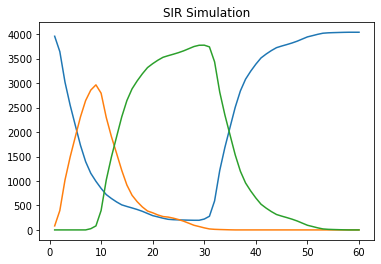

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             137 |
|      2 |   1684 |             132 |
|      3 |   1912 |             111 |
|      4 |   3437 |              88 |
|      5 |      0 |              73 |
|      6 |    686 |              41 |
|      7 |    348 |              35 |
|      8 |    483 |              29 |
|      9 |   1352 |              23 |
|     10 |   3980 |              22 |
|     11 |    414 |              19 |
|     12 |    698 |              17 |
|     13 |   2290 |              17 |
|     14 |   2039 |              14 |
|     15 |   3577 |              13 |
+--------+--------+-----------------+


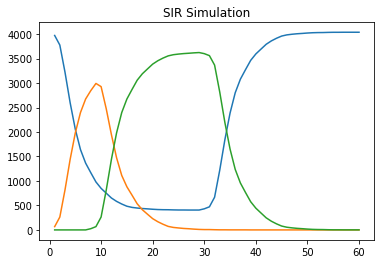

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             151 |
|      2 |   1684 |             127 |
|      3 |   3437 |              93 |
|      4 |      0 |              87 |
|      5 |   1912 |              85 |
|      6 |    483 |              29 |
|      7 |    348 |              28 |
|      8 |   2131 |              25 |
|      9 |    414 |              24 |
|     10 |   3830 |              22 |
|     11 |   2103 |              19 |
|     12 |   1979 |              18 |
|     13 |   2047 |              18 |
|     14 |   1302 |              15 |
|     15 |   1926 |              14 |
+--------+--------+-----------------+


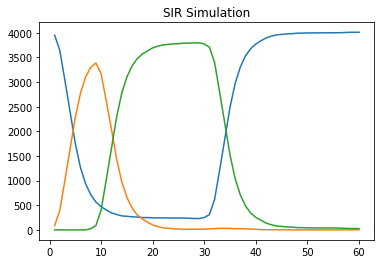

Giorno 60 :
Suscettibili: 4010
Infetti: 4
Guariti: 25
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             181 |
|      2 |   1684 |             138 |
|      3 |   3437 |             117 |
|      4 |      0 |              88 |
|      5 |   1912 |              84 |
|      6 |    686 |              31 |
|      7 |    414 |              24 |
|      8 |    475 |              21 |
|      9 |    348 |              21 |
|     10 |   3980 |              21 |
|     11 |   2142 |              19 |
|     12 |    428 |              17 |
|     13 |   1128 |              17 |
|     14 |   2328 |              14 |
|     15 |   3096 |              13 |
+--------+--------+-----------------+


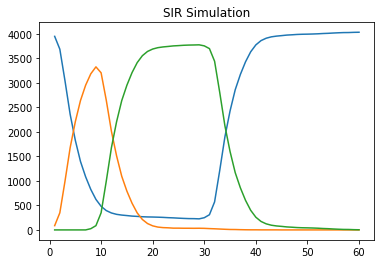

Giorno 60 :
Suscettibili: 4036
Infetti: 0
Guariti: 3
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             123 |
|      2 |    107 |             110 |
|      3 |   1684 |              86 |
|      4 |      0 |              81 |
|      5 |   1912 |              60 |
|      6 |    348 |              31 |
|      7 |    414 |              28 |
|      8 |    686 |              27 |
|      9 |    483 |              24 |
|     10 |   3980 |              19 |
|     11 |    136 |              18 |
|     12 |   3263 |              16 |
|     13 |   3362 |              15 |
|     14 |   2020 |              14 |
|     15 |    376 |              14 |
+--------+--------+-----------------+


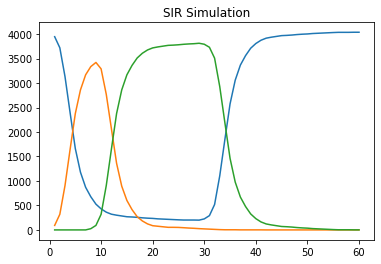

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             147 |
|      2 |   1684 |             133 |
|      3 |   1912 |             113 |
|      4 |      0 |             100 |
|      5 |   3437 |              99 |
|      6 |    348 |              48 |
|      7 |    414 |              23 |
|      8 |    686 |              20 |
|      9 |   1966 |              17 |
|     10 |   3980 |              16 |
|     11 |   2073 |              16 |
|     12 |   3263 |              15 |
|     13 |   2266 |              14 |
|     14 |   1361 |              14 |
|     15 |    483 |              14 |
+--------+--------+-----------------+


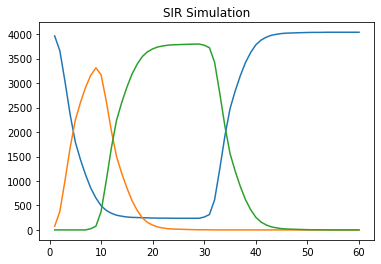

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             140 |
|      2 |    107 |             119 |
|      3 |   3437 |             118 |
|      4 |   1912 |             103 |
|      5 |      0 |              86 |
|      6 |    414 |              24 |
|      7 |    348 |              24 |
|      8 |    686 |              21 |
|      9 |   3830 |              21 |
|     10 |   1352 |              19 |
|     11 |   1059 |              18 |
|     12 |   3082 |              17 |
|     13 |   1783 |              16 |
|     14 |   2459 |              14 |
|     15 |   2078 |              14 |
+--------+--------+-----------------+


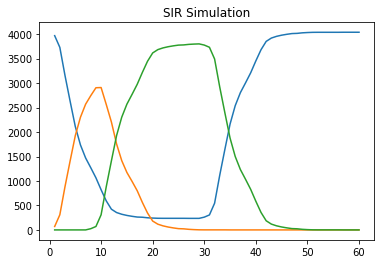

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             128 |
|      2 |   1684 |             115 |
|      3 |   3437 |             110 |
|      4 |   1912 |             104 |
|      5 |      0 |              66 |
|      6 |    686 |              30 |
|      7 |    348 |              27 |
|      8 |    376 |              25 |
|      9 |    414 |              24 |
|     10 |   2037 |              22 |
|     11 |   3101 |              21 |
|     12 |   1577 |              15 |
|     13 |   3596 |              14 |
|     14 |   2244 |              13 |
|     15 |   1104 |              13 |
+--------+--------+-----------------+


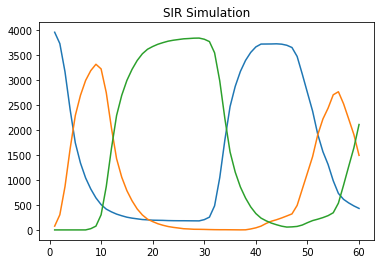

Giorno 60 :
Suscettibili: 431
Infetti: 1495
Guariti: 2113
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             312 |
|      2 |   1684 |             283 |
|      3 |   3437 |             230 |
|      4 |   1912 |             179 |
|      5 |      0 |             171 |
|      6 |    348 |              69 |
|      7 |    414 |              52 |
|      8 |    136 |              44 |
|      9 |    686 |              31 |
|     10 |   1800 |              29 |
|     11 |   2313 |              28 |
|     12 |    917 |              26 |
|     13 |   1941 |              23 |
|     14 |    483 |              23 |
|     15 |    376 |              22 |
+--------+--------+-----------------+


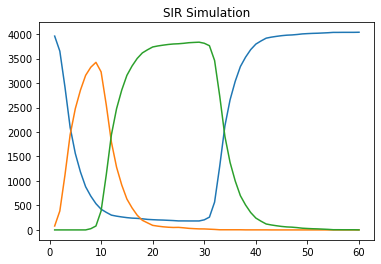

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             198 |
|      2 |   1684 |             129 |
|      3 |   3437 |             129 |
|      4 |   1912 |              69 |
|      5 |      0 |              53 |
|      6 |    348 |              35 |
|      7 |    414 |              26 |
|      8 |    686 |              26 |
|      9 |    483 |              25 |
|     10 |   2629 |              21 |
|     11 |   2278 |              21 |
|     12 |   2289 |              19 |
|     13 |   3980 |              19 |
|     14 |    917 |              14 |
|     15 |   3830 |              13 |
+--------+--------+-----------------+


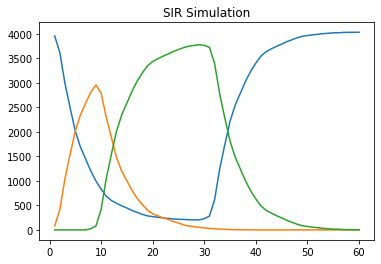

Giorno 60 :
Suscettibili: 4036
Infetti: 0
Guariti: 3
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             173 |
|      2 |   3437 |             110 |
|      3 |   1684 |              87 |
|      4 |   1912 |              71 |
|      5 |      0 |              68 |
|      6 |    686 |              33 |
|      7 |    348 |              27 |
|      8 |   2133 |              25 |
|      9 |    414 |              23 |
|     10 |    483 |              16 |
|     11 |   2081 |              16 |
|     12 |   1953 |              15 |
|     13 |     56 |              15 |
|     14 |   2047 |              15 |
|     15 |    698 |              15 |
+--------+--------+-----------------+


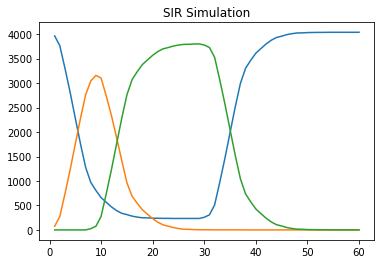

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             129 |
|      2 |    107 |             126 |
|      3 |   3437 |             115 |
|      4 |   1912 |              96 |
|      5 |      0 |              57 |
|      6 |    686 |              35 |
|      7 |    348 |              24 |
|      8 |    698 |              23 |
|      9 |   1211 |              18 |
|     10 |    414 |              18 |
|     11 |    484 |              17 |
|     12 |   1577 |              16 |
|     13 |    483 |              15 |
|     14 |   1800 |              15 |
|     15 |   1783 |              15 |
+--------+--------+-----------------+


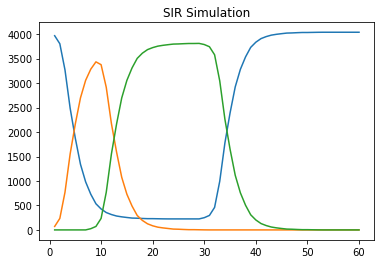

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             164 |
|      2 |   1912 |             107 |
|      3 |   3437 |             106 |
|      4 |   1684 |             105 |
|      5 |      0 |              59 |
|      6 |    348 |              35 |
|      7 |    686 |              25 |
|      8 |   1352 |              23 |
|      9 |    414 |              21 |
|     10 |   3082 |              19 |
|     11 |   2347 |              18 |
|     12 |    483 |              18 |
|     13 |    947 |              15 |
|     14 |   2133 |              14 |
|     15 |   1941 |              13 |
+--------+--------+-----------------+


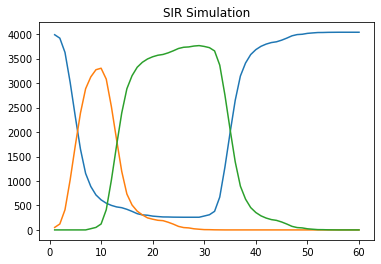

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             146 |
|      2 |   3437 |             117 |
|      3 |    107 |             103 |
|      4 |      0 |              93 |
|      5 |   1912 |              77 |
|      6 |    686 |              31 |
|      7 |    348 |              29 |
|      8 |   2543 |              23 |
|      9 |    566 |              19 |
|     10 |   2468 |              16 |
|     11 |   2772 |              16 |
|     12 |   1746 |              15 |
|     13 |   1465 |              15 |
|     14 |    698 |              14 |
|     15 |    484 |              14 |
+--------+--------+-----------------+


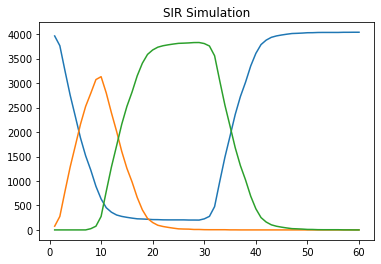

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             122 |
|      2 |    107 |             116 |
|      3 |   3437 |             109 |
|      4 |      0 |              94 |
|      5 |   1912 |              67 |
|      6 |    348 |              28 |
|      7 |    414 |              26 |
|      8 |    686 |              25 |
|      9 |   2347 |              23 |
|     10 |   2289 |              20 |
|     11 |   2543 |              20 |
|     12 |   3684 |              17 |
|     13 |   2279 |              17 |
|     14 |   1617 |              16 |
|     15 |   3980 |              15 |
+--------+--------+-----------------+


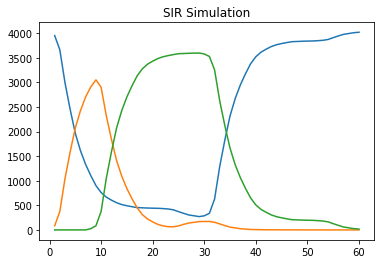

Giorno 60 :
Suscettibili: 4022
Infetti: 0
Guariti: 17
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             144 |
|      2 |    107 |             130 |
|      3 |   3437 |             105 |
|      4 |      0 |              64 |
|      5 |   1912 |              61 |
|      6 |    686 |              33 |
|      7 |    136 |              31 |
|      8 |   2131 |              25 |
|      9 |    414 |              20 |
|     10 |   2928 |              19 |
|     11 |   2240 |              19 |
|     12 |    698 |              18 |
|     13 |    483 |              16 |
|     14 |   1420 |              16 |
|     15 |    500 |              16 |
+--------+--------+-----------------+


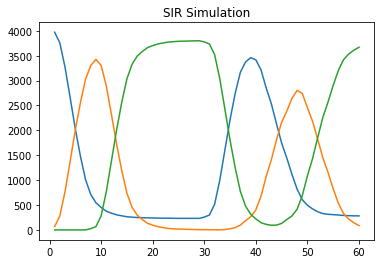

Giorno 60 :
Suscettibili: 282
Infetti: 87
Guariti: 3670
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             310 |
|      2 |   3437 |             235 |
|      3 |   1684 |             224 |
|      4 |   1912 |             189 |
|      5 |      0 |             155 |
|      6 |    348 |              64 |
|      7 |    686 |              54 |
|      8 |    414 |              47 |
|      9 |    698 |              40 |
|     10 |   2839 |              24 |
|     11 |    563 |              24 |
|     12 |   1085 |              21 |
|     13 |    483 |              21 |
|     14 |    136 |              21 |
|     15 |   2742 |              21 |
+--------+--------+-----------------+


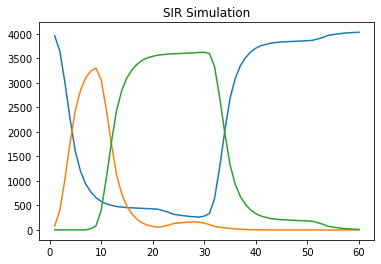

Giorno 60 :
Suscettibili: 4029
Infetti: 0
Guariti: 10
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             168 |
|      2 |   3437 |             126 |
|      3 |   1684 |             115 |
|      4 |   1912 |              92 |
|      5 |      0 |              64 |
|      6 |    686 |              40 |
|      7 |    348 |              30 |
|      8 |    414 |              23 |
|      9 |   2095 |              19 |
|     10 |   3101 |              18 |
|     11 |    953 |              18 |
|     12 |   2384 |              17 |
|     13 |    719 |              16 |
|     14 |   3397 |              15 |
|     15 |    698 |              15 |
+--------+--------+-----------------+


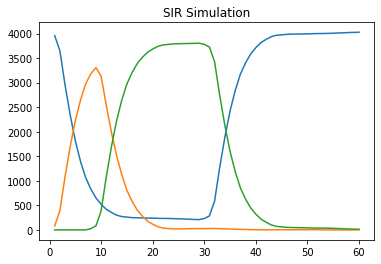

Giorno 60 :
Suscettibili: 4026
Infetti: 0
Guariti: 13
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             175 |
|      2 |   1684 |             124 |
|      3 |   3437 |              91 |
|      4 |      0 |              76 |
|      5 |   1912 |              74 |
|      6 |   2543 |              39 |
|      7 |   1589 |              30 |
|      8 |    414 |              30 |
|      9 |    348 |              27 |
|     10 |    686 |              22 |
|     11 |   3830 |              20 |
|     12 |   1204 |              17 |
|     13 |   2054 |              16 |
|     14 |   1938 |              15 |
|     15 |    475 |              15 |
+--------+--------+-----------------+


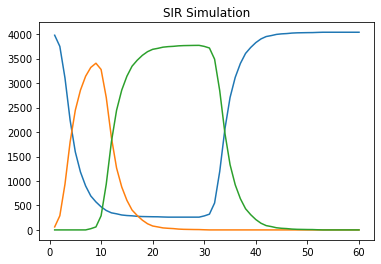

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             182 |
|      2 |   1684 |             136 |
|      3 |   3437 |             118 |
|      4 |   1912 |              85 |
|      5 |      0 |              64 |
|      6 |    483 |              34 |
|      7 |    414 |              33 |
|      8 |    348 |              26 |
|      9 |    686 |              24 |
|     10 |   2103 |              19 |
|     11 |   2171 |              16 |
|     12 |   3291 |              15 |
|     13 |   3830 |              15 |
|     14 |   2056 |              14 |
|     15 |    475 |              14 |
+--------+--------+-----------------+


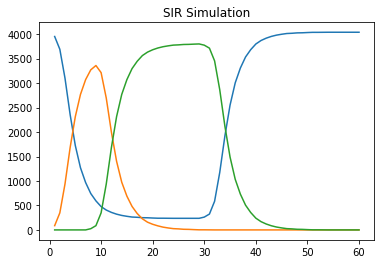

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             112 |
|      2 |   1684 |             104 |
|      3 |    107 |              86 |
|      4 |   1912 |              85 |
|      5 |      0 |              83 |
|      6 |    414 |              30 |
|      7 |    348 |              29 |
|      8 |   2324 |              20 |
|      9 |   2040 |              20 |
|     10 |   2117 |              18 |
|     11 |    428 |              18 |
|     12 |    946 |              16 |
|     13 |    686 |              15 |
|     14 |    475 |              14 |
|     15 |   1352 |              13 |
+--------+--------+-----------------+


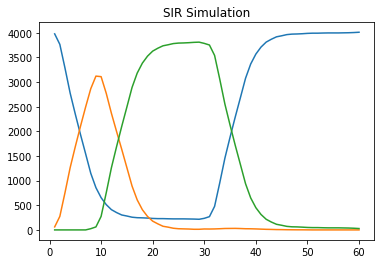

Giorno 60 :
Suscettibili: 4011
Infetti: 0
Guariti: 28
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             188 |
|      2 |   3437 |             122 |
|      3 |   1684 |             120 |
|      4 |      0 |              72 |
|      5 |   1912 |              66 |
|      6 |    686 |              38 |
|      7 |    348 |              27 |
|      8 |   3980 |              23 |
|      9 |    414 |              22 |
|     10 |    483 |              18 |
|     11 |   2059 |              16 |
|     12 |   2543 |              15 |
|     13 |   1844 |              14 |
|     14 |    698 |              14 |
|     15 |   2630 |              14 |
+--------+--------+-----------------+


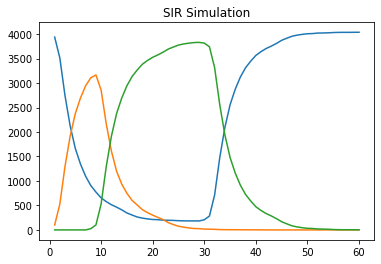

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             155 |
|      2 |   1684 |             141 |
|      3 |   3437 |             139 |
|      4 |      0 |              82 |
|      5 |   1912 |              42 |
|      6 |    686 |              30 |
|      7 |   1663 |              22 |
|      8 |    414 |              22 |
|      9 |    348 |              21 |
|     10 |   1126 |              21 |
|     11 |   3980 |              21 |
|     12 |    517 |              16 |
|     13 |    698 |              15 |
|     14 |   3104 |              13 |
|     15 |   2306 |              13 |
+--------+--------+-----------------+


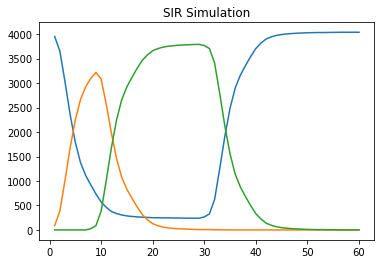

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             164 |
|      2 |   1684 |             147 |
|      3 |   1912 |              93 |
|      4 |   3437 |              88 |
|      5 |      0 |              78 |
|      6 |   2543 |              31 |
|      7 |    686 |              30 |
|      8 |    348 |              25 |
|      9 |    414 |              23 |
|     10 |   2347 |              20 |
|     11 |   2133 |              16 |
|     12 |   1718 |              16 |
|     13 |   2118 |              14 |
|     14 |   2111 |              14 |
|     15 |   3577 |              14 |
+--------+--------+-----------------+


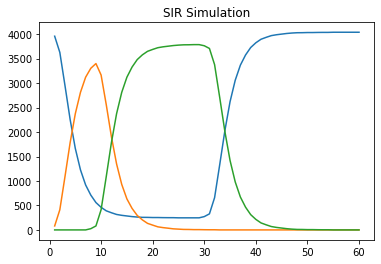

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             154 |
|      2 |   3437 |             121 |
|      3 |   1684 |             112 |
|      4 |   1912 |              92 |
|      5 |      0 |              76 |
|      6 |   2642 |              24 |
|      7 |    686 |              23 |
|      8 |    414 |              20 |
|      9 |    483 |              20 |
|     10 |    348 |              18 |
|     11 |   2543 |              18 |
|     12 |   2520 |              16 |
|     13 |   2730 |              16 |
|     14 |   1416 |              16 |
|     15 |   1918 |              14 |
+--------+--------+-----------------+


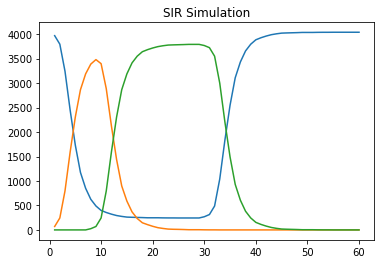

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             142 |
|      2 |    107 |             134 |
|      3 |   3437 |             101 |
|      4 |      0 |              94 |
|      5 |   1912 |              93 |
|      6 |    483 |              43 |
|      7 |    348 |              36 |
|      8 |    686 |              35 |
|      9 |   2347 |              25 |
|     10 |    414 |              21 |
|     11 |   3830 |              19 |
|     12 |    980 |              18 |
|     13 |    376 |              15 |
|     14 |   1945 |              15 |
|     15 |   1185 |              13 |
+--------+--------+-----------------+


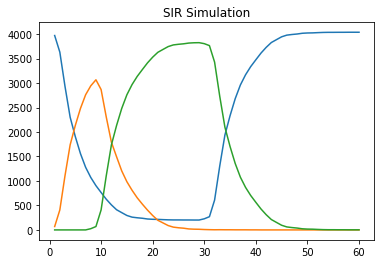

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             172 |
|      2 |   1684 |             140 |
|      3 |   3437 |             132 |
|      4 |   1912 |             123 |
|      5 |      0 |              78 |
|      6 |    348 |              39 |
|      7 |    686 |              30 |
|      8 |   1622 |              22 |
|      9 |    414 |              18 |
|     10 |    484 |              18 |
|     11 |    705 |              15 |
|     12 |   3830 |              15 |
|     13 |   2090 |              15 |
|     14 |   1966 |              14 |
|     15 |   1663 |              14 |
+--------+--------+-----------------+


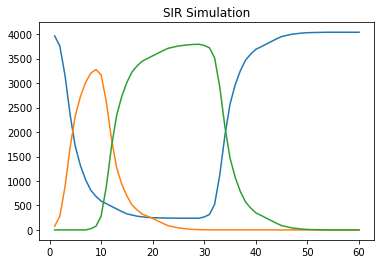

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             128 |
|      2 |   3437 |             124 |
|      3 |   1684 |             113 |
|      4 |   1912 |              86 |
|      5 |      0 |              81 |
|      6 |    686 |              28 |
|      7 |    348 |              28 |
|      8 |    414 |              24 |
|      9 |    475 |              23 |
|     10 |    698 |              19 |
|     11 |   2694 |              16 |
|     12 |   1918 |              16 |
|     13 |   1962 |              15 |
|     14 |    428 |              14 |
|     15 |    376 |              14 |
+--------+--------+-----------------+


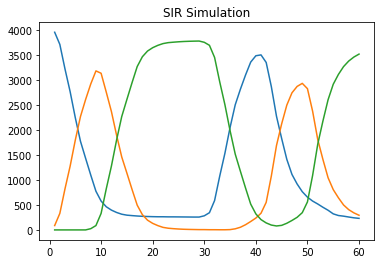

Giorno 60 :
Suscettibili: 231
Infetti: 293
Guariti: 3515
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             298 |
|      2 |    107 |             276 |
|      3 |   1912 |             195 |
|      4 |   3437 |             188 |
|      5 |      0 |             153 |
|      6 |    348 |              58 |
|      7 |    686 |              57 |
|      8 |    414 |              53 |
|      9 |    483 |              42 |
|     10 |    698 |              31 |
|     11 |   1352 |              30 |
|     12 |    136 |              26 |
|     13 |    563 |              25 |
|     14 |    428 |              25 |
|     15 |   1505 |              22 |
+--------+--------+-----------------+


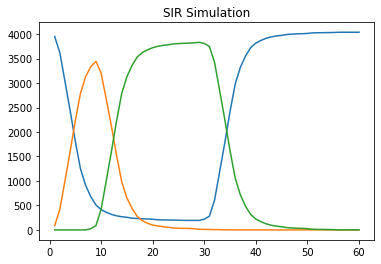

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             137 |
|      2 |    107 |             130 |
|      3 |   1684 |             101 |
|      4 |      0 |              75 |
|      5 |   1912 |              59 |
|      6 |    686 |              47 |
|      7 |    348 |              25 |
|      8 |    414 |              24 |
|      9 |   1603 |              22 |
|     10 |   1391 |              19 |
|     11 |   1622 |              17 |
|     12 |    483 |              17 |
|     13 |   1966 |              15 |
|     14 |   3830 |              14 |
|     15 |   2028 |              14 |
+--------+--------+-----------------+


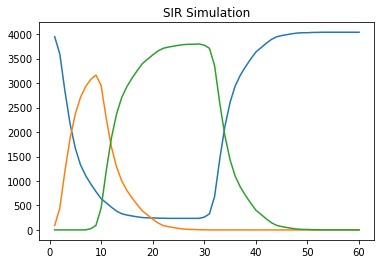

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             147 |
|      2 |   1684 |             146 |
|      3 |   3437 |             108 |
|      4 |      0 |              72 |
|      5 |   1912 |              64 |
|      6 |    348 |              43 |
|      7 |   1943 |              27 |
|      8 |   1126 |              21 |
|      9 |    698 |              20 |
|     10 |   2127 |              20 |
|     11 |    686 |              19 |
|     12 |    414 |              18 |
|     13 |    637 |              17 |
|     14 |   2138 |              15 |
|     15 |   3830 |              15 |
+--------+--------+-----------------+


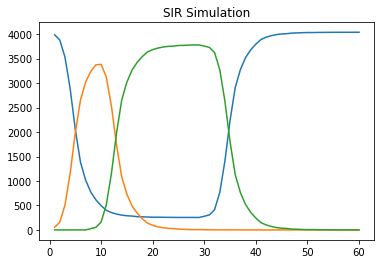

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             144 |
|      2 |   1684 |             136 |
|      3 |   3437 |             116 |
|      4 |   1912 |              93 |
|      5 |      0 |              74 |
|      6 |    686 |              39 |
|      7 |    414 |              25 |
|      8 |    348 |              22 |
|      9 |    376 |              20 |
|     10 |    363 |              17 |
|     11 |    483 |              17 |
|     12 |   2593 |              16 |
|     13 |   2206 |              15 |
|     14 |    136 |              14 |
|     15 |    563 |              14 |
+--------+--------+-----------------+


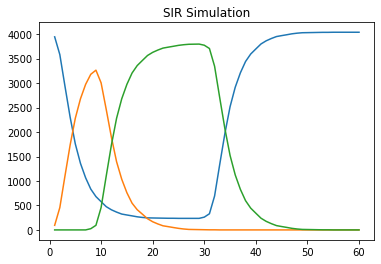

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             145 |
|      2 |    107 |             130 |
|      3 |   3437 |             125 |
|      4 |   1912 |             117 |
|      5 |      0 |              78 |
|      6 |    686 |              31 |
|      7 |    483 |              28 |
|      8 |    348 |              22 |
|      9 |   1059 |              20 |
|     10 |    414 |              17 |
|     11 |   3830 |              17 |
|     12 |   1861 |              16 |
|     13 |   2290 |              15 |
|     14 |   2078 |              15 |
|     15 |   1104 |              14 |
+--------+--------+-----------------+


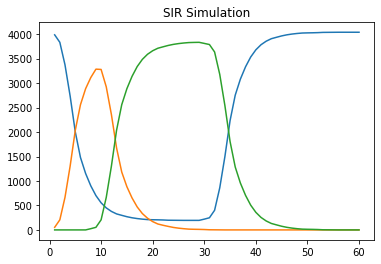

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             152 |
|      2 |   3437 |             130 |
|      3 |   1684 |              87 |
|      4 |      0 |              86 |
|      5 |   1912 |              76 |
|      6 |    348 |              45 |
|      7 |    686 |              22 |
|      8 |   3980 |              22 |
|      9 |   2543 |              20 |
|     10 |    414 |              19 |
|     11 |   2289 |              18 |
|     12 |   1750 |              17 |
|     13 |    917 |              16 |
|     14 |   1985 |              15 |
|     15 |   1813 |              14 |
+--------+--------+-----------------+


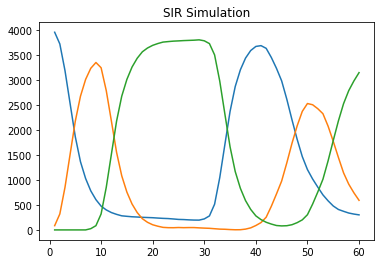

Giorno 60 :
Suscettibili: 301
Infetti: 592
Guariti: 3146
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             294 |
|      2 |    107 |             266 |
|      3 |   3437 |             251 |
|      4 |   1912 |             173 |
|      5 |      0 |             131 |
|      6 |    348 |              64 |
|      7 |    686 |              52 |
|      8 |    414 |              46 |
|      9 |    136 |              32 |
|     10 |    698 |              29 |
|     11 |   2081 |              28 |
|     12 |   2111 |              26 |
|     13 |    376 |              25 |
|     14 |   2543 |              25 |
|     15 |   2102 |              24 |
+--------+--------+-----------------+


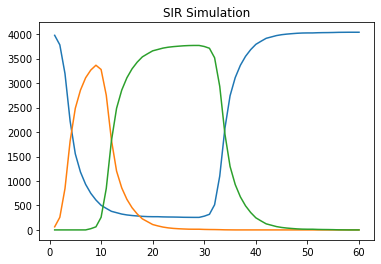

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             170 |
|      2 |   1684 |             149 |
|      3 |   3437 |             130 |
|      4 |   1912 |              90 |
|      5 |      0 |              82 |
|      6 |    348 |              35 |
|      7 |    428 |              22 |
|      8 |   2206 |              21 |
|      9 |   1730 |              20 |
|     10 |    414 |              19 |
|     11 |   2189 |              16 |
|     12 |   2429 |              15 |
|     13 |    497 |              15 |
|     14 |   1467 |              15 |
|     15 |    376 |              14 |
+--------+--------+-----------------+


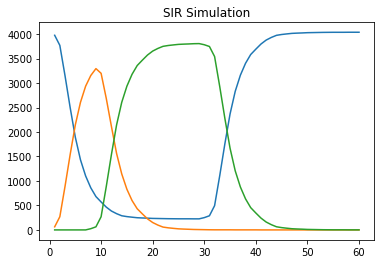

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             146 |
|      2 |   3437 |             132 |
|      3 |   1684 |             123 |
|      4 |   1912 |              83 |
|      5 |      0 |              82 |
|      6 |    686 |              32 |
|      7 |    348 |              27 |
|      8 |    414 |              22 |
|      9 |   1377 |              22 |
|     10 |    483 |              20 |
|     11 |   1938 |              19 |
|     12 |   2045 |              18 |
|     13 |   1926 |              17 |
|     14 |    698 |              17 |
|     15 |   1014 |              16 |
+--------+--------+-----------------+


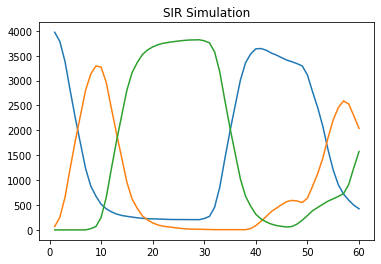

Giorno 60 :
Suscettibili: 424
Infetti: 2040
Guariti: 1575
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             272 |
|      2 |    107 |             261 |
|      3 |   1684 |             249 |
|      4 |   1912 |             163 |
|      5 |      0 |             124 |
|      6 |    348 |              65 |
|      7 |    414 |              63 |
|      8 |    686 |              54 |
|      9 |    483 |              40 |
|     10 |   1941 |              38 |
|     11 |    917 |              25 |
|     12 |   1376 |              23 |
|     13 |    698 |              23 |
|     14 |   3830 |              22 |
|     15 |   1577 |              21 |
+--------+--------+-----------------+


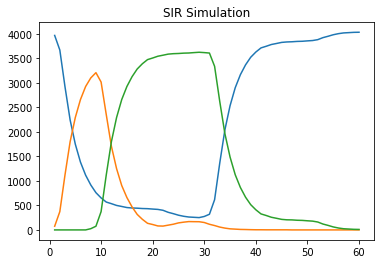

Giorno 60 :
Suscettibili: 4029
Infetti: 0
Guariti: 10
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             161 |
|      2 |   1684 |             152 |
|      3 |   3437 |             127 |
|      4 |      0 |              82 |
|      5 |   1912 |              75 |
|      6 |    348 |              31 |
|      7 |    698 |              20 |
|      8 |    414 |              19 |
|      9 |   1800 |              18 |
|     10 |   2521 |              17 |
|     11 |    526 |              14 |
|     12 |    376 |              13 |
|     13 |    686 |              13 |
|     14 |   1530 |              13 |
|     15 |   2111 |              13 |
+--------+--------+-----------------+


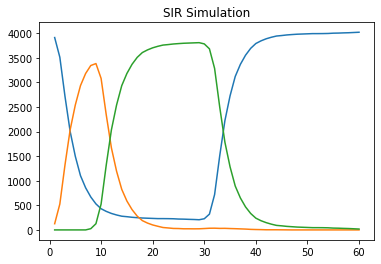

Giorno 60 :
Suscettibili: 4021
Infetti: 0
Guariti: 18
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             193 |
|      2 |   3437 |             134 |
|      3 |   1684 |             109 |
|      4 |      0 |              91 |
|      5 |   1912 |              82 |
|      6 |    414 |              28 |
|      7 |    686 |              21 |
|      8 |   2087 |              19 |
|      9 |   3980 |              16 |
|     10 |   2112 |              16 |
|     11 |    374 |              15 |
|     12 |    925 |              15 |
|     13 |   1126 |              15 |
|     14 |   3830 |              14 |
|     15 |    348 |              13 |
+--------+--------+-----------------+


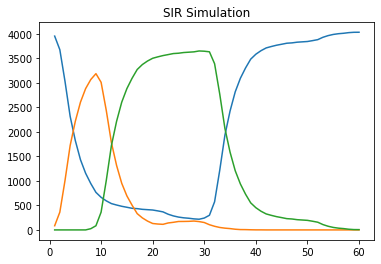

Giorno 60 :
Suscettibili: 4033
Infetti: 0
Guariti: 6
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             190 |
|      2 |   1684 |             128 |
|      3 |   3437 |             103 |
|      4 |      0 |              81 |
|      5 |   1912 |              67 |
|      6 |    414 |              26 |
|      7 |    686 |              26 |
|      8 |    348 |              21 |
|      9 |   3980 |              21 |
|     10 |   2233 |              20 |
|     11 |    698 |              17 |
|     12 |   2543 |              17 |
|     13 |   1269 |              16 |
|     14 |    483 |              16 |
|     15 |   1718 |              15 |
+--------+--------+-----------------+


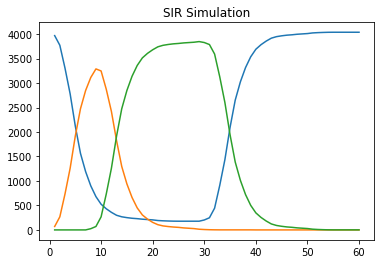

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             141 |
|      2 |   3437 |             129 |
|      3 |    107 |             129 |
|      4 |      0 |              84 |
|      5 |   1912 |              47 |
|      6 |    348 |              38 |
|      7 |    414 |              22 |
|      8 |    686 |              18 |
|      9 |    483 |              18 |
|     10 |   3101 |              18 |
|     11 |   1352 |              17 |
|     12 |   3980 |              17 |
|     13 |   2093 |              16 |
|     14 |    484 |              16 |
|     15 |   1589 |              15 |
+--------+--------+-----------------+


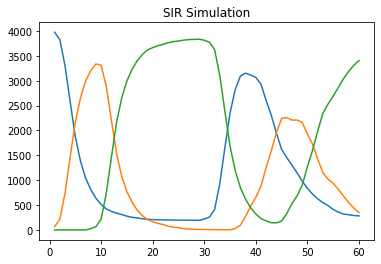

Giorno 60 :
Suscettibili: 282
Infetti: 349
Guariti: 3408
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             281 |
|      2 |    107 |             275 |
|      3 |   3437 |             228 |
|      4 |   1912 |             148 |
|      5 |      0 |             137 |
|      6 |    686 |              70 |
|      7 |    348 |              67 |
|      8 |    414 |              52 |
|      9 |   2543 |              51 |
|     10 |    483 |              43 |
|     11 |    917 |              29 |
|     12 |   1941 |              27 |
|     13 |   3980 |              23 |
|     14 |   1085 |              21 |
|     15 |    698 |              20 |
+--------+--------+-----------------+


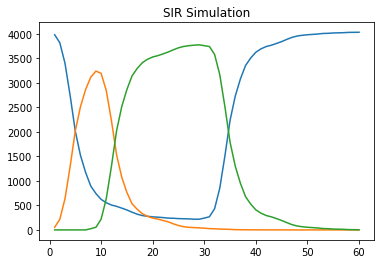

Giorno 60 :
Suscettibili: 4036
Infetti: 0
Guariti: 3
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             154 |
|      2 |   1684 |             141 |
|      3 |   3437 |             137 |
|      4 |   1912 |              91 |
|      5 |      0 |              82 |
|      6 |    348 |              35 |
|      7 |   2384 |              31 |
|      8 |   1584 |              25 |
|      9 |    686 |              24 |
|     10 |   2543 |              20 |
|     11 |    698 |              17 |
|     12 |    414 |              15 |
|     13 |   3980 |              15 |
|     14 |    376 |              13 |
|     15 |     67 |              12 |
+--------+--------+-----------------+


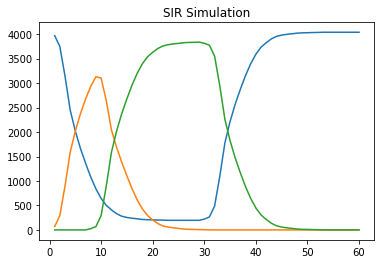

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             141 |
|      2 |   3437 |             127 |
|      3 |   1684 |             115 |
|      4 |   1912 |             104 |
|      5 |      0 |              77 |
|      6 |    686 |              44 |
|      7 |    414 |              30 |
|      8 |    348 |              30 |
|      9 |   1377 |              21 |
|     10 |    698 |              20 |
|     11 |    563 |              19 |
|     12 |    483 |              19 |
|     13 |   2220 |              19 |
|     14 |   1238 |              17 |
|     15 |    136 |              17 |
+--------+--------+-----------------+


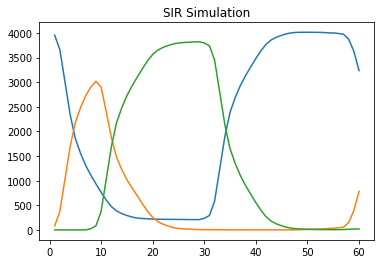

Giorno 60 :
Suscettibili: 3237
Infetti: 782
Guariti: 20
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             275 |
|      2 |   1684 |             143 |
|      3 |   3437 |             120 |
|      4 |      0 |              79 |
|      5 |   1912 |              65 |
|      6 |   3980 |              43 |
|      7 |    686 |              42 |
|      8 |    348 |              38 |
|      9 |    428 |              33 |
|     10 |    414 |              32 |
|     11 |   2542 |              24 |
|     12 |    483 |              20 |
|     13 |    917 |              19 |
|     14 |    376 |              19 |
|     15 |    698 |              19 |
+--------+--------+-----------------+


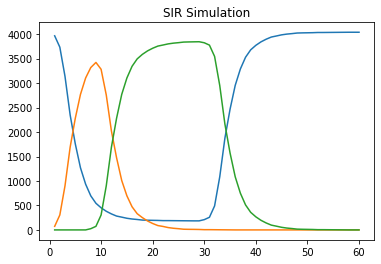

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             168 |
|      2 |   1684 |             128 |
|      3 |   3437 |             113 |
|      4 |   1912 |             101 |
|      5 |      0 |              91 |
|      6 |    686 |              43 |
|      7 |    348 |              31 |
|      8 |   1059 |              27 |
|      9 |   3980 |              25 |
|     10 |   2863 |              17 |
|     11 |   2088 |              16 |
|     12 |    475 |              15 |
|     13 |   2333 |              15 |
|     14 |   2468 |              15 |
|     15 |    483 |              12 |
+--------+--------+-----------------+


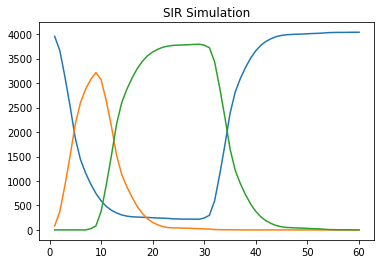

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             139 |
|      2 |   3437 |             111 |
|      3 |    107 |              93 |
|      4 |   1912 |              83 |
|      5 |      0 |              76 |
|      6 |    414 |              31 |
|      7 |    348 |              28 |
|      8 |   2032 |              22 |
|      9 |   2755 |              19 |
|     10 |   2206 |              18 |
|     11 |    698 |              17 |
|     12 |    366 |              17 |
|     13 |   3633 |              16 |
|     14 |   1104 |              16 |
|     15 |    686 |              16 |
+--------+--------+-----------------+


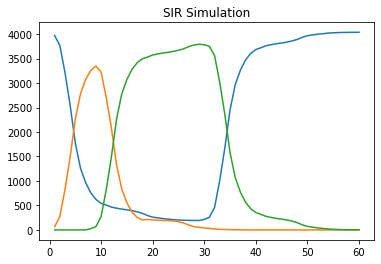

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             167 |
|      2 |    107 |             131 |
|      3 |   3437 |             123 |
|      4 |      0 |              92 |
|      5 |   1912 |              74 |
|      6 |    414 |              36 |
|      7 |    348 |              33 |
|      8 |   2384 |              29 |
|      9 |   1199 |              24 |
|     10 |    698 |              20 |
|     11 |    428 |              19 |
|     12 |   2081 |              19 |
|     13 |   1124 |              18 |
|     14 |   2347 |              18 |
|     15 |    686 |              17 |
+--------+--------+-----------------+


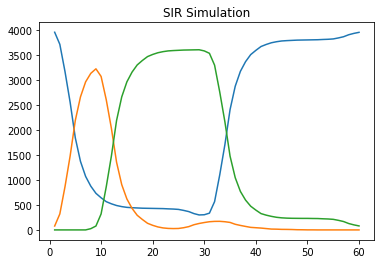

Giorno 60 :
Suscettibili: 3959
Infetti: 0
Guariti: 80
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             159 |
|      2 |   1912 |             118 |
|      3 |   3437 |             111 |
|      4 |   1684 |              96 |
|      5 |      0 |              63 |
|      6 |    348 |              48 |
|      7 |    686 |              27 |
|      8 |    483 |              24 |
|      9 |   3324 |              20 |
|     10 |    698 |              20 |
|     11 |    363 |              16 |
|     12 |   1132 |              15 |
|     13 |    414 |              15 |
|     14 |   1331 |              15 |
|     15 |   3980 |              15 |
+--------+--------+-----------------+


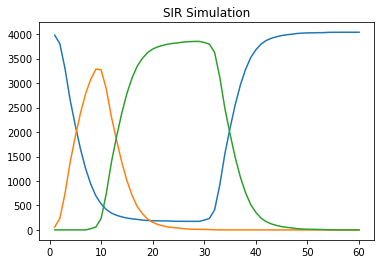

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             127 |
|      2 |   1912 |             113 |
|      3 |   3437 |             106 |
|      4 |   1684 |              93 |
|      5 |      0 |              92 |
|      6 |    348 |              40 |
|      7 |    686 |              24 |
|      8 |    414 |              22 |
|      9 |   2142 |              22 |
|     10 |   3342 |              18 |
|     11 |   3980 |              17 |
|     12 |    483 |              16 |
|     13 |    978 |              16 |
|     14 |    698 |              14 |
|     15 |   2117 |              13 |
+--------+--------+-----------------+


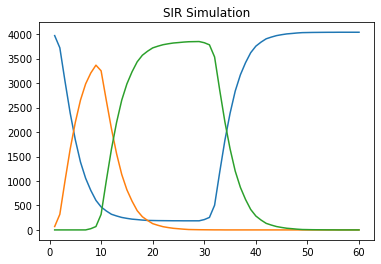

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             142 |
|      2 |    107 |             136 |
|      3 |   3437 |             123 |
|      4 |   1912 |             103 |
|      5 |      0 |              70 |
|      6 |    686 |              46 |
|      7 |    348 |              39 |
|      8 |    414 |              23 |
|      9 |   1584 |              20 |
|     10 |   2142 |              16 |
|     11 |   1920 |              16 |
|     12 |   2384 |              16 |
|     13 |   2043 |              15 |
|     14 |   2986 |              15 |
|     15 |    637 |              15 |
+--------+--------+-----------------+


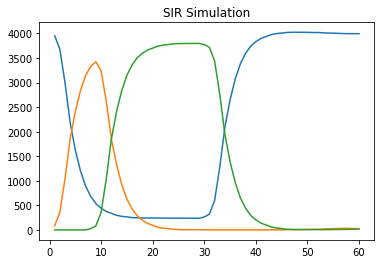

Giorno 60 :
Suscettibili: 3995
Infetti: 27
Guariti: 17
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             148 |
|      2 |   3437 |             124 |
|      3 |   1912 |             109 |
|      4 |    107 |             100 |
|      5 |      0 |              79 |
|      6 |    348 |              30 |
|      7 |    414 |              26 |
|      8 |    686 |              26 |
|      9 |    483 |              21 |
|     10 |   2289 |              17 |
|     11 |   3980 |              15 |
|     12 |    916 |              14 |
|     13 |   1926 |              14 |
|     14 |    805 |              13 |
|     15 |   2268 |              13 |
+--------+--------+-----------------+


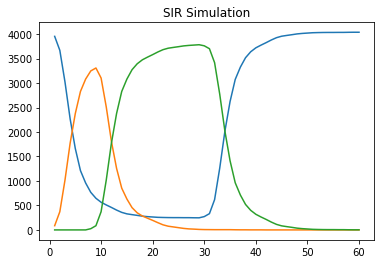

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             153 |
|      2 |    107 |             131 |
|      3 |   3437 |             124 |
|      4 |   1912 |              73 |
|      5 |      0 |              54 |
|      6 |    348 |              29 |
|      7 |    414 |              27 |
|      8 |    686 |              21 |
|      9 |   2150 |              20 |
|     10 |   2542 |              19 |
|     11 |    637 |              16 |
|     12 |   2183 |              14 |
|     13 |   2081 |              14 |
|     14 |    252 |              14 |
|     15 |    136 |              13 |
+--------+--------+-----------------+


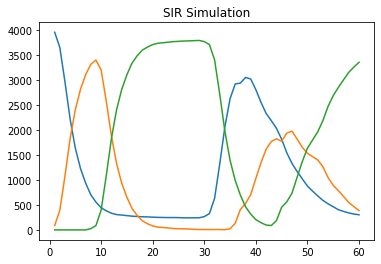

Giorno 60 :
Suscettibili: 303
Infetti: 384
Guariti: 3352
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             359 |
|      2 |   1684 |             258 |
|      3 |   3437 |             237 |
|      4 |   1912 |             183 |
|      5 |      0 |             149 |
|      6 |    348 |              68 |
|      7 |    414 |              54 |
|      8 |    686 |              53 |
|      9 |    483 |              30 |
|     10 |    563 |              29 |
|     11 |    698 |              27 |
|     12 |    376 |              25 |
|     13 |    119 |              20 |
|     14 |   1718 |              20 |
|     15 |   1352 |              19 |
+--------+--------+-----------------+


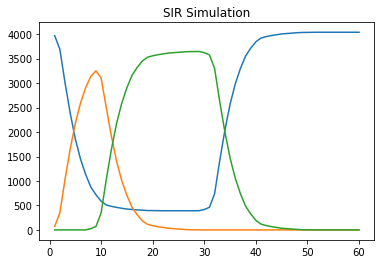

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             170 |
|      2 |   3437 |             113 |
|      3 |   1684 |              90 |
|      4 |   1912 |              82 |
|      5 |      0 |              78 |
|      6 |    414 |              33 |
|      7 |    348 |              24 |
|      8 |   1946 |              23 |
|      9 |   2047 |              23 |
|     10 |   3980 |              19 |
|     11 |   2172 |              17 |
|     12 |   1622 |              16 |
|     13 |   3830 |              16 |
|     14 |   1867 |              15 |
|     15 |   2951 |              15 |
+--------+--------+-----------------+


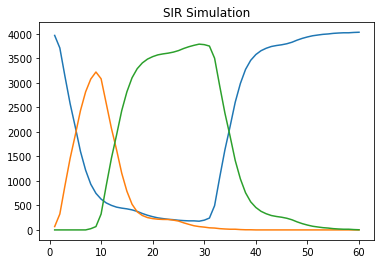

Giorno 60 :
Suscettibili: 4036
Infetti: 0
Guariti: 3
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             162 |
|      2 |   3437 |             133 |
|      3 |   1684 |             120 |
|      4 |   1912 |              94 |
|      5 |      0 |              86 |
|      6 |    348 |              28 |
|      7 |    686 |              27 |
|      8 |   3980 |              26 |
|      9 |    414 |              26 |
|     10 |   2093 |              22 |
|     11 |    993 |              22 |
|     12 |   2491 |              17 |
|     13 |   2047 |              16 |
|     14 |    428 |              16 |
|     15 |   3830 |              14 |
+--------+--------+-----------------+


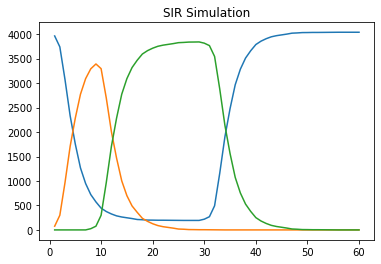

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             148 |
|      2 |   3437 |             120 |
|      3 |   1684 |             108 |
|      4 |      0 |              70 |
|      5 |   1912 |              54 |
|      6 |    348 |              51 |
|      7 |    686 |              26 |
|      8 |    414 |              26 |
|      9 |   2543 |              24 |
|     10 |   1277 |              22 |
|     11 |    483 |              20 |
|     12 |   2047 |              19 |
|     13 |   1943 |              17 |
|     14 |   2750 |              16 |
|     15 |   1431 |              16 |
+--------+--------+-----------------+


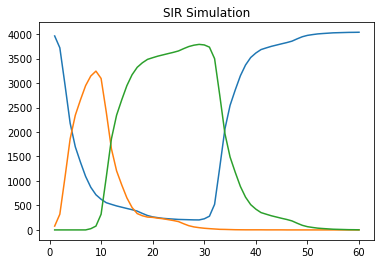

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             133 |
|      2 |    107 |             127 |
|      3 |   1684 |             111 |
|      4 |   1912 |              96 |
|      5 |      0 |              77 |
|      6 |    348 |              32 |
|      7 |    483 |              29 |
|      8 |    686 |              26 |
|      9 |    414 |              24 |
|     10 |   3980 |              22 |
|     11 |   2206 |              20 |
|     12 |   1399 |              18 |
|     13 |    698 |              18 |
|     14 |   3830 |              17 |
|     15 |   3201 |              17 |
+--------+--------+-----------------+


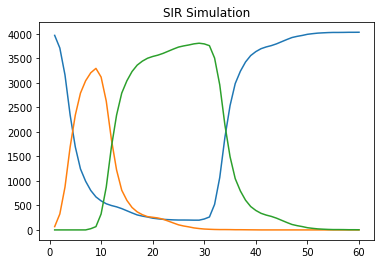

Giorno 60 :
Suscettibili: 4036
Infetti: 0
Guariti: 3
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             186 |
|      2 |   3437 |             126 |
|      3 |   1912 |             103 |
|      4 |   1684 |             102 |
|      5 |      0 |              88 |
|      6 |    348 |              49 |
|      7 |    686 |              35 |
|      8 |    414 |              24 |
|      9 |    483 |              23 |
|     10 |   1146 |              17 |
|     11 |   3980 |              16 |
|     12 |   3320 |              15 |
|     13 |   1185 |              15 |
|     14 |   2551 |              15 |
|     15 |   1786 |              14 |
+--------+--------+-----------------+


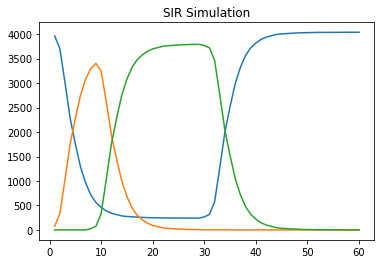

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             136 |
|      2 |    107 |             130 |
|      3 |   1912 |             115 |
|      4 |   1684 |              84 |
|      5 |      0 |              77 |
|      6 |    686 |              37 |
|      7 |    348 |              31 |
|      8 |    414 |              18 |
|      9 |   2839 |              18 |
|     10 |   2966 |              18 |
|     11 |   1941 |              17 |
|     12 |   2081 |              17 |
|     13 |   2174 |              17 |
|     14 |   1835 |              16 |
|     15 |   3596 |              16 |
+--------+--------+-----------------+


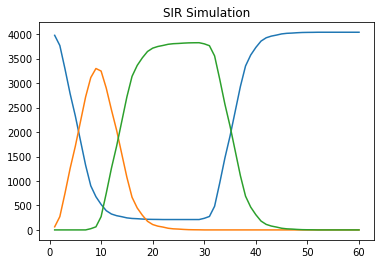

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             154 |
|      2 |    107 |             115 |
|      3 |   3437 |             109 |
|      4 |      0 |              80 |
|      5 |   1912 |              78 |
|      6 |    686 |              24 |
|      7 |   1577 |              23 |
|      8 |   1078 |              23 |
|      9 |    414 |              21 |
|     10 |    606 |              21 |
|     11 |    348 |              21 |
|     12 |    896 |              20 |
|     13 |   2468 |              19 |
|     14 |   3980 |              18 |
|     15 |   2133 |              16 |
+--------+--------+-----------------+


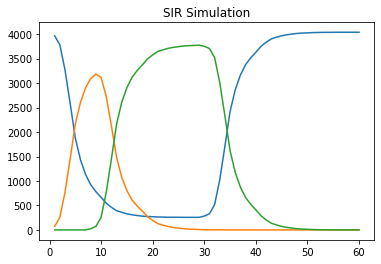

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             144 |
|      2 |   3437 |             127 |
|      3 |   1912 |              81 |
|      4 |   1684 |              78 |
|      5 |      0 |              56 |
|      6 |    348 |              28 |
|      7 |    414 |              28 |
|      8 |    136 |              23 |
|      9 |    686 |              21 |
|     10 |   2510 |              20 |
|     11 |    483 |              19 |
|     12 |   1718 |              17 |
|     13 |     67 |              16 |
|     14 |   1522 |              15 |
|     15 |   2793 |              14 |
+--------+--------+-----------------+


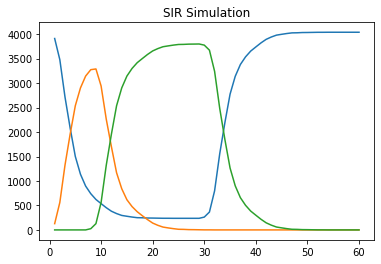

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             149 |
|      2 |   1684 |             136 |
|      3 |   3437 |             130 |
|      4 |      0 |              65 |
|      5 |   1912 |              65 |
|      6 |    348 |              50 |
|      7 |    686 |              28 |
|      8 |   1577 |              26 |
|      9 |    363 |              20 |
|     10 |    483 |              17 |
|     11 |   2033 |              17 |
|     12 |   1600 |              16 |
|     13 |   2370 |              16 |
|     14 |   2153 |              16 |
|     15 |    698 |              15 |
+--------+--------+-----------------+


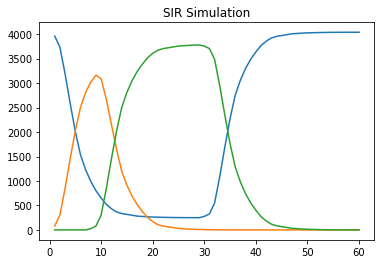

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             145 |
|      2 |    107 |             138 |
|      3 |   3437 |             128 |
|      4 |   1912 |              85 |
|      5 |      0 |              85 |
|      6 |    686 |              31 |
|      7 |   1431 |              30 |
|      8 |    348 |              26 |
|      9 |    483 |              18 |
|     10 |    414 |              18 |
|     11 |   2133 |              17 |
|     12 |    698 |              15 |
|     13 |   1946 |              15 |
|     14 |   2877 |              14 |
|     15 |   1086 |              14 |
+--------+--------+-----------------+


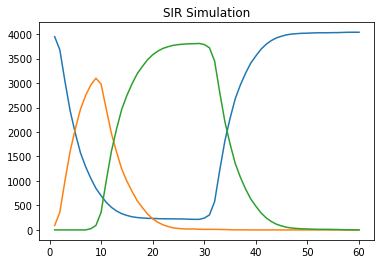

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             119 |
|      2 |    107 |             104 |
|      3 |   1684 |              96 |
|      4 |   1912 |              60 |
|      5 |      0 |              55 |
|      6 |    348 |              30 |
|      7 |    686 |              25 |
|      8 |   2102 |              22 |
|      9 |   2199 |              20 |
|     10 |   2347 |              18 |
|     11 |    414 |              18 |
|     12 |   1926 |              17 |
|     13 |   2542 |              17 |
|     14 |     56 |              16 |
|     15 |   3051 |              16 |
+--------+--------+-----------------+


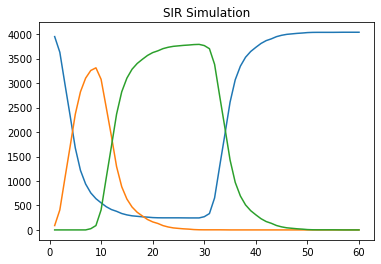

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             144 |
|      2 |   1684 |             125 |
|      3 |   3437 |             120 |
|      4 |      0 |              85 |
|      5 |   1912 |              41 |
|      6 |    348 |              33 |
|      7 |    686 |              22 |
|      8 |   2347 |              19 |
|      9 |   2309 |              19 |
|     10 |    483 |              19 |
|     11 |    698 |              18 |
|     12 |    414 |              17 |
|     13 |   1551 |              17 |
|     14 |    438 |              16 |
|     15 |   2511 |              16 |
+--------+--------+-----------------+


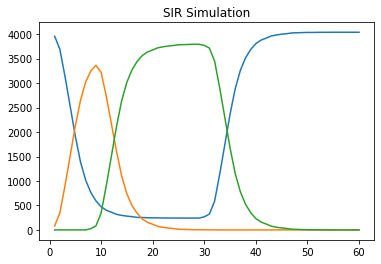

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             133 |
|      2 |    107 |             130 |
|      3 |   1684 |             110 |
|      4 |   1912 |              89 |
|      5 |      0 |              82 |
|      6 |    348 |              39 |
|      7 |    414 |              32 |
|      8 |    686 |              27 |
|      9 |   1888 |              26 |
|     10 |   2553 |              17 |
|     11 |    698 |              16 |
|     12 |   3267 |              15 |
|     13 |   2543 |              14 |
|     14 |   1746 |              14 |
|     15 |    423 |              13 |
+--------+--------+-----------------+


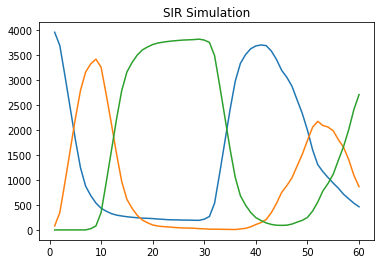

Giorno 60 :
Suscettibili: 463
Infetti: 866
Guariti: 2710
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             294 |
|      2 |    107 |             270 |
|      3 |   3437 |             219 |
|      4 |   1912 |             172 |
|      5 |      0 |             140 |
|      6 |    348 |              82 |
|      7 |    686 |              52 |
|      8 |   3980 |              41 |
|      9 |    414 |              40 |
|     10 |   2266 |              36 |
|     11 |   2543 |              28 |
|     12 |   2047 |              26 |
|     13 |   1800 |              23 |
|     14 |   1017 |              22 |
|     15 |   1126 |              21 |
+--------+--------+-----------------+


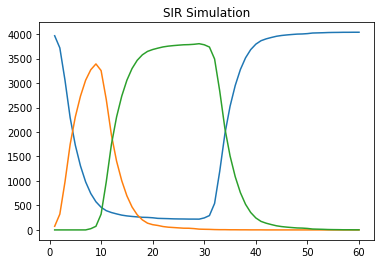

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             130 |
|      2 |   1684 |             128 |
|      3 |    107 |             114 |
|      4 |   1912 |             105 |
|      5 |      0 |              75 |
|      6 |    348 |              36 |
|      7 |    414 |              32 |
|      8 |    686 |              31 |
|      9 |    483 |              25 |
|     10 |   1199 |              19 |
|     11 |   2313 |              19 |
|     12 |    136 |              19 |
|     13 |   3980 |              17 |
|     14 |   1070 |              16 |
|     15 |   2966 |              16 |
+--------+--------+-----------------+


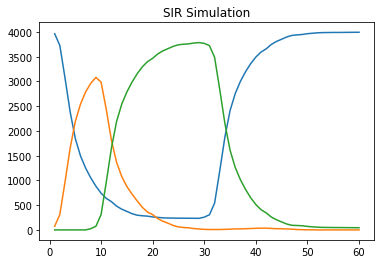

Giorno 60 :
Suscettibili: 3995
Infetti: 0
Guariti: 44
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             121 |
|      2 |   1684 |             121 |
|      3 |   1912 |             113 |
|      4 |    107 |             109 |
|      5 |      0 |              61 |
|      6 |    348 |              33 |
|      7 |    414 |              30 |
|      8 |   1946 |              21 |
|      9 |   3980 |              21 |
|     10 |   1256 |              20 |
|     11 |    686 |              19 |
|     12 |   1431 |              19 |
|     13 |   2323 |              18 |
|     14 |   2054 |              16 |
|     15 |    698 |              15 |
+--------+--------+-----------------+


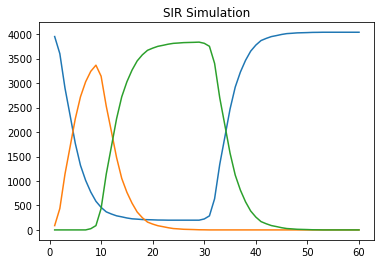

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             182 |
|      2 |   3437 |             142 |
|      3 |   1684 |             134 |
|      4 |      0 |              84 |
|      5 |   1912 |              71 |
|      6 |    348 |              26 |
|      7 |    686 |              26 |
|      8 |    414 |              22 |
|      9 |   2268 |              20 |
|     10 |   1612 |              19 |
|     11 |    698 |              19 |
|     12 |   1993 |              18 |
|     13 |   2037 |              17 |
|     14 |    713 |              16 |
|     15 |   2038 |              15 |
+--------+--------+-----------------+


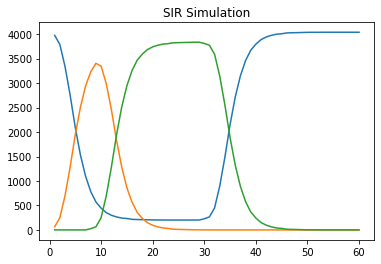

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             150 |
|      2 |   3437 |             139 |
|      3 |   1684 |             123 |
|      4 |   1912 |              90 |
|      5 |      0 |              69 |
|      6 |    686 |              44 |
|      7 |    348 |              43 |
|      8 |    414 |              31 |
|      9 |   2543 |              24 |
|     10 |   1577 |              19 |
|     11 |    563 |              19 |
|     12 |     67 |              17 |
|     13 |   3980 |              17 |
|     14 |   1352 |              16 |
|     15 |   1663 |              15 |
+--------+--------+-----------------+


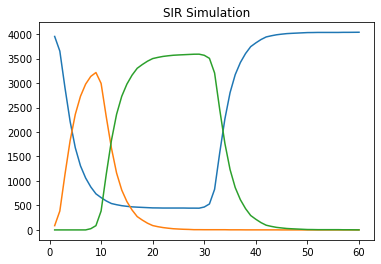

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             133 |
|      2 |    107 |             126 |
|      3 |   3437 |             112 |
|      4 |   1912 |              68 |
|      5 |      0 |              53 |
|      6 |    348 |              29 |
|      7 |   2593 |              20 |
|      8 |   1126 |              20 |
|      9 |   1269 |              19 |
|     10 |    353 |              18 |
|     11 |   1322 |              16 |
|     12 |   2669 |              16 |
|     13 |   1211 |              16 |
|     14 |   2333 |              15 |
|     15 |   2020 |              15 |
+--------+--------+-----------------+


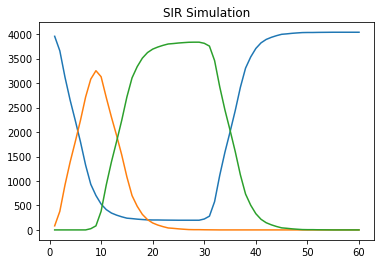

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             156 |
|      2 |   3437 |             115 |
|      3 |    107 |              90 |
|      4 |   1912 |              74 |
|      5 |      0 |              69 |
|      6 |    348 |              35 |
|      7 |   1199 |              23 |
|      8 |    483 |              20 |
|      9 |    686 |              20 |
|     10 |   2492 |              18 |
|     11 |    917 |              18 |
|     12 |   3980 |              17 |
|     13 |   2271 |              14 |
|     14 |    500 |              13 |
|     15 |    353 |              13 |
+--------+--------+-----------------+


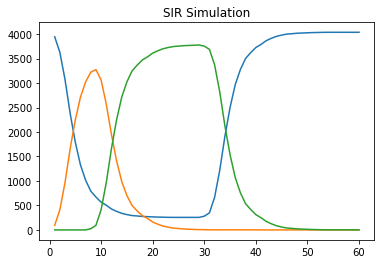

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             148 |
|      2 |   3437 |             127 |
|      3 |   1684 |             108 |
|      4 |   1912 |              98 |
|      5 |      0 |              84 |
|      6 |    348 |              30 |
|      7 |    686 |              27 |
|      8 |    414 |              25 |
|      9 |    483 |              20 |
|     10 |   1211 |              18 |
|     11 |    698 |              17 |
|     12 |   2183 |              17 |
|     13 |   2309 |              16 |
|     14 |   1256 |              15 |
|     15 |   2754 |              14 |
+--------+--------+-----------------+


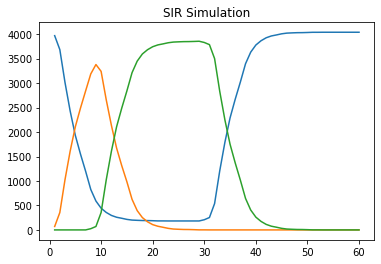

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             170 |
|      2 |   1684 |             156 |
|      3 |   3437 |             119 |
|      4 |      0 |              79 |
|      5 |   1912 |              75 |
|      6 |    348 |              39 |
|      7 |    376 |              26 |
|      8 |    414 |              26 |
|      9 |   1146 |              23 |
|     10 |    686 |              23 |
|     11 |   3980 |              22 |
|     12 |   1730 |              20 |
|     13 |   2347 |              20 |
|     14 |    483 |              18 |
|     15 |   2333 |              18 |
+--------+--------+-----------------+


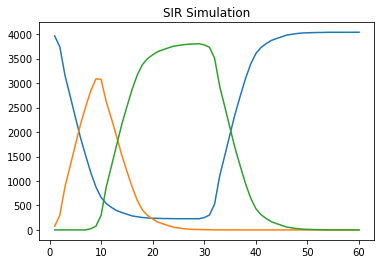

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             140 |
|      2 |    107 |             138 |
|      3 |   1684 |             120 |
|      4 |      0 |              75 |
|      5 |   1912 |              71 |
|      6 |    348 |              32 |
|      7 |    414 |              25 |
|      8 |   1250 |              19 |
|      9 |   1199 |              18 |
|     10 |   2719 |              16 |
|     11 |    475 |              16 |
|     12 |   2142 |              15 |
|     13 |   2218 |              15 |
|     14 |   1078 |              15 |
|     15 |   2071 |              14 |
+--------+--------+-----------------+


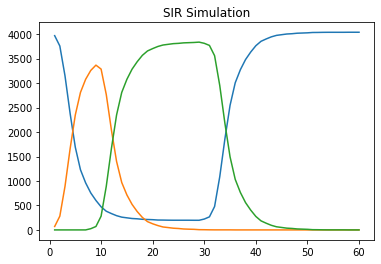

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             151 |
|      2 |   1684 |             111 |
|      3 |   3437 |              92 |
|      4 |   1912 |              89 |
|      5 |      0 |              83 |
|      6 |    348 |              25 |
|      7 |   1361 |              20 |
|      8 |   2078 |              20 |
|      9 |   3980 |              20 |
|     10 |   2117 |              19 |
|     11 |   2863 |              19 |
|     12 |    414 |              19 |
|     13 |    376 |              19 |
|     14 |   2188 |              16 |
|     15 |   1465 |              16 |
+--------+--------+-----------------+


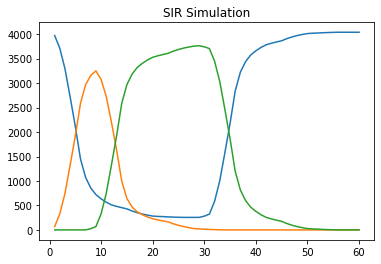

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             150 |
|      2 |    107 |             131 |
|      3 |   3437 |             126 |
|      4 |   1912 |              91 |
|      5 |      0 |              85 |
|      6 |    686 |              28 |
|      7 |    414 |              23 |
|      8 |    348 |              21 |
|      9 |   2201 |              18 |
|     10 |    538 |              17 |
|     11 |   1918 |              17 |
|     12 |    698 |              17 |
|     13 |   2543 |              16 |
|     14 |    896 |              14 |
|     15 |   1962 |              14 |
+--------+--------+-----------------+


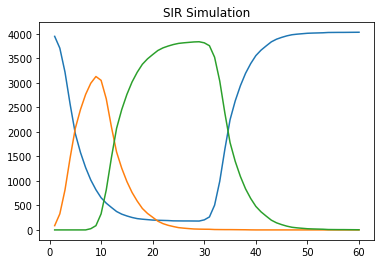

Giorno 60 :
Suscettibili: 4036
Infetti: 0
Guariti: 3
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             145 |
|      2 |    107 |             143 |
|      3 |   1684 |             103 |
|      4 |      0 |              95 |
|      5 |   1912 |              43 |
|      6 |    348 |              31 |
|      7 |    686 |              26 |
|      8 |    428 |              25 |
|      9 |    414 |              23 |
|     10 |   1584 |              22 |
|     11 |   2074 |              21 |
|     12 |   3980 |              20 |
|     13 |    698 |              19 |
|     14 |   1227 |              17 |
|     15 |    483 |              14 |
+--------+--------+-----------------+


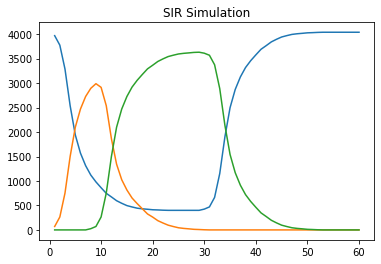

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             162 |
|      2 |   3437 |             106 |
|      3 |   1912 |              91 |
|      4 |      0 |              89 |
|      5 |   1684 |              83 |
|      6 |    348 |              29 |
|      7 |   3980 |              20 |
|      8 |    475 |              19 |
|      9 |   2081 |              18 |
|     10 |    366 |              16 |
|     11 |    414 |              15 |
|     12 |   1962 |              15 |
|     13 |   2464 |              14 |
|     14 |   1059 |              13 |
|     15 |   1172 |              13 |
+--------+--------+-----------------+


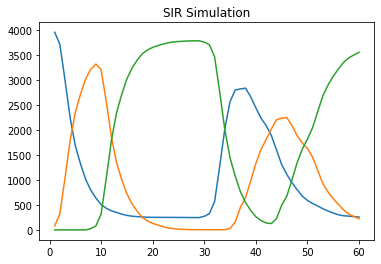

Giorno 60 :
Suscettibili: 258
Infetti: 224
Guariti: 3557
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             321 |
|      2 |    107 |             267 |
|      3 |   3437 |             233 |
|      4 |   1912 |             219 |
|      5 |      0 |             149 |
|      6 |    348 |              55 |
|      7 |    686 |              51 |
|      8 |    414 |              49 |
|      9 |    563 |              31 |
|     10 |    376 |              30 |
|     11 |    475 |              30 |
|     12 |   2047 |              29 |
|     13 |    698 |              28 |
|     14 |   1149 |              24 |
|     15 |   1718 |              22 |
+--------+--------+-----------------+


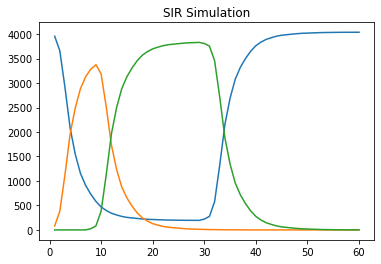

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             161 |
|      2 |   1684 |             153 |
|      3 |   3437 |             127 |
|      4 |   1912 |              93 |
|      5 |      0 |              62 |
|      6 |    686 |              40 |
|      7 |    348 |              26 |
|      8 |   2347 |              23 |
|      9 |    414 |              20 |
|     10 |   3146 |              18 |
|     11 |    483 |              17 |
|     12 |   2333 |              15 |
|     13 |   3980 |              15 |
|     14 |   2068 |              15 |
|     15 |   1107 |              13 |
+--------+--------+-----------------+


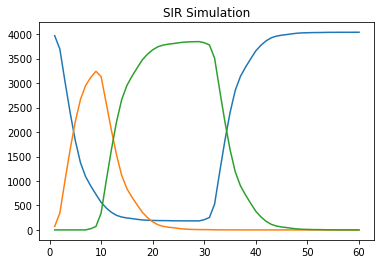

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             164 |
|      2 |    107 |             151 |
|      3 |   3437 |             107 |
|      4 |   1912 |              79 |
|      5 |      0 |              76 |
|      6 |    686 |              42 |
|      7 |    348 |              31 |
|      8 |   1800 |              23 |
|      9 |   3830 |              22 |
|     10 |   2127 |              19 |
|     11 |    483 |              18 |
|     12 |   1352 |              17 |
|     13 |   3980 |              17 |
|     14 |   1409 |              17 |
|     15 |   3604 |              15 |
+--------+--------+-----------------+


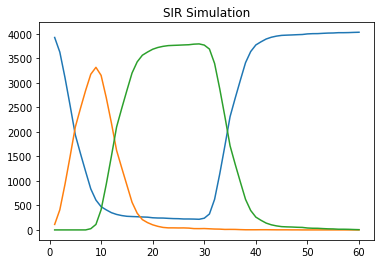

Giorno 60 :
Suscettibili: 4034
Infetti: 0
Guariti: 5
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             178 |
|      2 |   1684 |             101 |
|      3 |      0 |              92 |
|      4 |   3437 |              86 |
|      5 |   1912 |              79 |
|      6 |    686 |              40 |
|      7 |    348 |              35 |
|      8 |    414 |              29 |
|      9 |   1399 |              17 |
|     10 |   2468 |              17 |
|     11 |   2347 |              17 |
|     12 |   3980 |              17 |
|     13 |   1941 |              14 |
|     14 |   2111 |              14 |
|     15 |   2241 |              13 |
+--------+--------+-----------------+


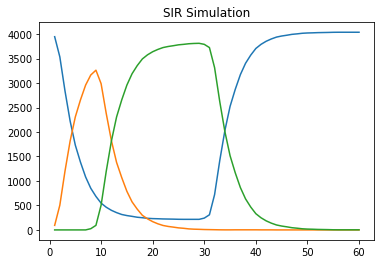

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             163 |
|      2 |   1912 |             112 |
|      3 |   1684 |             105 |
|      4 |   3437 |             104 |
|      5 |      0 |              65 |
|      6 |   2081 |              26 |
|      7 |    348 |              25 |
|      8 |    414 |              24 |
|      9 |    686 |              21 |
|     10 |    475 |              20 |
|     11 |   2543 |              19 |
|     12 |    136 |              16 |
|     13 |    698 |              16 |
|     14 |    896 |              15 |
|     15 |   2329 |              15 |
+--------+--------+-----------------+


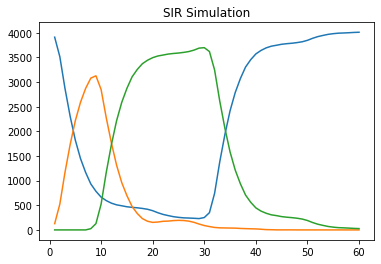

Giorno 60 :
Suscettibili: 4012
Infetti: 0
Guariti: 27
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             173 |
|      2 |   1684 |             131 |
|      3 |   1912 |             100 |
|      4 |      0 |              81 |
|      5 |   3437 |              79 |
|      6 |    686 |              30 |
|      7 |   2047 |              26 |
|      8 |    348 |              24 |
|      9 |   2347 |              20 |
|     10 |    698 |              18 |
|     11 |    414 |              18 |
|     12 |   2551 |              15 |
|     13 |   3980 |              13 |
|     14 |   2781 |              13 |
|     15 |   1491 |              13 |
+--------+--------+-----------------+


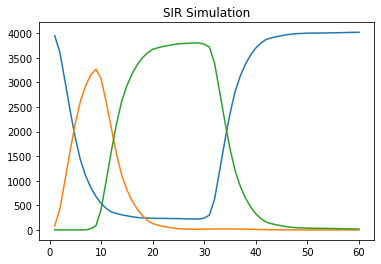

Giorno 60 :
Suscettibili: 4022
Infetti: 0
Guariti: 17
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             165 |
|      2 |   1684 |             129 |
|      3 |   3437 |             129 |
|      4 |   1912 |             101 |
|      5 |      0 |              77 |
|      6 |    686 |              43 |
|      7 |    348 |              32 |
|      8 |    993 |              28 |
|      9 |    414 |              25 |
|     10 |   2275 |              19 |
|     11 |   1104 |              18 |
|     12 |   2347 |              18 |
|     13 |     67 |              15 |
|     14 |   2556 |              14 |
|     15 |    483 |              14 |
+--------+--------+-----------------+


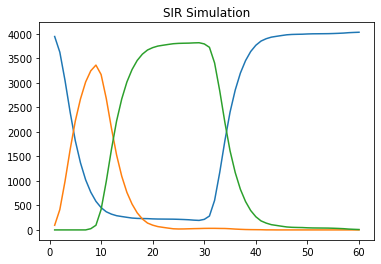

Giorno 60 :
Suscettibili: 4031
Infetti: 0
Guariti: 8
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             173 |
|      2 |   3437 |             123 |
|      3 |   1684 |              96 |
|      4 |   1912 |              95 |
|      5 |      0 |              75 |
|      6 |    348 |              36 |
|      7 |    414 |              26 |
|      8 |    686 |              20 |
|      9 |   2088 |              19 |
|     10 |   2047 |              18 |
|     11 |   2351 |              16 |
|     12 |   1076 |              16 |
|     13 |   2068 |              14 |
|     14 |   1086 |              14 |
|     15 |   2719 |              14 |
+--------+--------+-----------------+


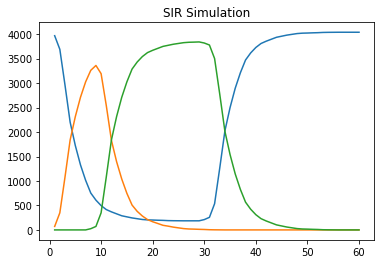

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             133 |
|      2 |   3437 |             125 |
|      3 |   1912 |             111 |
|      4 |    107 |              81 |
|      5 |      0 |              57 |
|      6 |    686 |              25 |
|      7 |    483 |              25 |
|      8 |    414 |              22 |
|      9 |    348 |              21 |
|     10 |   2183 |              17 |
|     11 |   1827 |              17 |
|     12 |   3830 |              15 |
|     13 |    698 |              15 |
|     14 |    412 |              15 |
|     15 |    563 |              15 |
+--------+--------+-----------------+


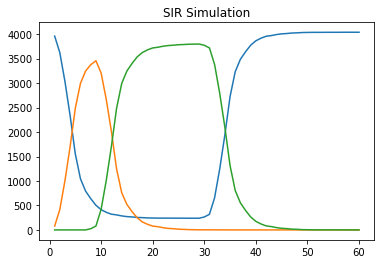

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             156 |
|      2 |   1684 |             140 |
|      3 |   3437 |             131 |
|      4 |   1912 |             107 |
|      5 |      0 |              85 |
|      6 |    686 |              37 |
|      7 |    414 |              26 |
|      8 |   2543 |              23 |
|      9 |   2047 |              21 |
|     10 |   2068 |              21 |
|     11 |    348 |              19 |
|     12 |    484 |              16 |
|     13 |   2309 |              16 |
|     14 |   2069 |              15 |
|     15 |    637 |              15 |
+--------+--------+-----------------+


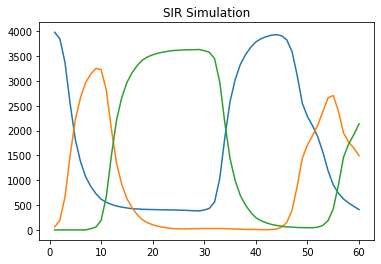

Giorno 60 :
Suscettibili: 410
Infetti: 1494
Guariti: 2135
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             314 |
|      2 |   1684 |             264 |
|      3 |   3437 |             261 |
|      4 |   1912 |             223 |
|      5 |      0 |             139 |
|      6 |    348 |              65 |
|      7 |    414 |              53 |
|      8 |    428 |              32 |
|      9 |    483 |              32 |
|     10 |   1985 |              29 |
|     11 |   2839 |              21 |
|     12 |    376 |              21 |
|     13 |   3830 |              20 |
|     14 |   1945 |              20 |
|     15 |   1288 |              20 |
+--------+--------+-----------------+


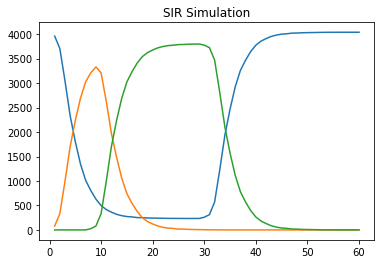

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             150 |
|      2 |   3437 |             131 |
|      3 |    107 |             130 |
|      4 |      0 |              79 |
|      5 |   1912 |              51 |
|      6 |    483 |              30 |
|      7 |    414 |              27 |
|      8 |   2347 |              26 |
|      9 |   3830 |              22 |
|     10 |    686 |              19 |
|     11 |   1669 |              19 |
|     12 |   2038 |              17 |
|     13 |    348 |              15 |
|     14 |   3335 |              14 |
|     15 |   1954 |              14 |
+--------+--------+-----------------+


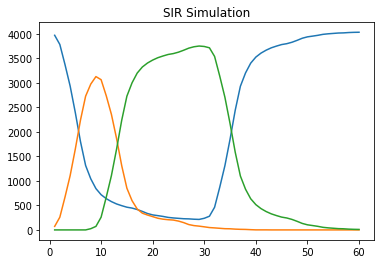

Giorno 60 :
Suscettibili: 4029
Infetti: 0
Guariti: 10
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             132 |
|      2 |   3437 |             122 |
|      3 |   1684 |              80 |
|      4 |      0 |              63 |
|      5 |   1912 |              60 |
|      6 |   1577 |              31 |
|      7 |    348 |              30 |
|      8 |    686 |              23 |
|      9 |    414 |              23 |
|     10 |    698 |              22 |
|     11 |   1941 |              19 |
|     12 |   2309 |              18 |
|     13 |   3980 |              16 |
|     14 |   1604 |              16 |
|     15 |   1017 |              16 |
+--------+--------+-----------------+


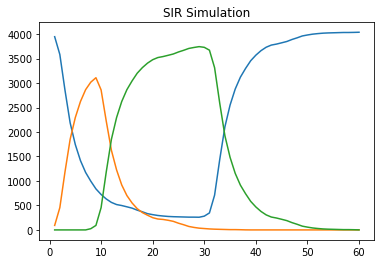

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             164 |
|      2 |   1684 |             102 |
|      3 |   3437 |              97 |
|      4 |   1912 |              82 |
|      5 |      0 |              67 |
|      6 |   2560 |              29 |
|      7 |    348 |              28 |
|      8 |    686 |              27 |
|      9 |    414 |              18 |
|     10 |   1864 |              17 |
|     11 |   2117 |              17 |
|     12 |   2716 |              15 |
|     13 |     67 |              15 |
|     14 |    698 |              14 |
|     15 |   1376 |              14 |
+--------+--------+-----------------+


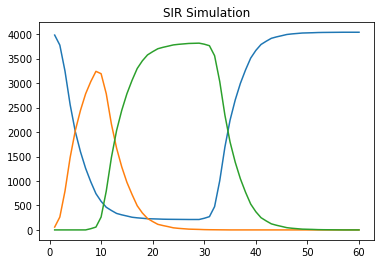

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             164 |
|      2 |   3437 |             122 |
|      3 |    107 |              96 |
|      4 |   1912 |              85 |
|      5 |      0 |              72 |
|      6 |    686 |              28 |
|      7 |    348 |              28 |
|      8 |    414 |              21 |
|      9 |   2078 |              19 |
|     10 |   3980 |              18 |
|     11 |   1199 |              17 |
|     12 |    376 |              16 |
|     13 |    483 |              16 |
|     14 |   1941 |              16 |
|     15 |    698 |              15 |
+--------+--------+-----------------+


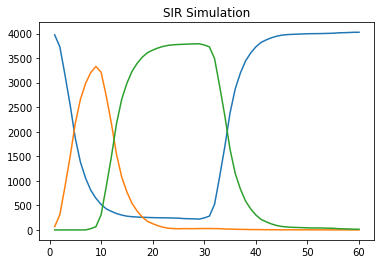

Giorno 60 :
Suscettibili: 4026
Infetti: 0
Guariti: 13
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             180 |
|      2 |   3437 |              97 |
|      3 |   1912 |              92 |
|      4 |   1684 |              83 |
|      5 |      0 |              70 |
|      6 |    348 |              44 |
|      7 |    483 |              23 |
|      8 |    414 |              22 |
|      9 |   1335 |              20 |
|     10 |    563 |              19 |
|     11 |    686 |              19 |
|     12 |   1622 |              16 |
|     13 |   1983 |              15 |
|     14 |   3366 |              15 |
|     15 |   3980 |              15 |
+--------+--------+-----------------+


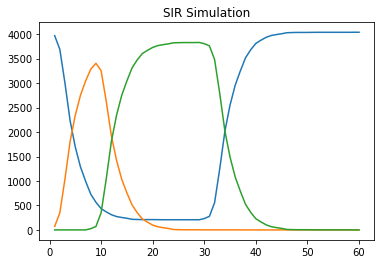

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             134 |
|      2 |   1912 |             111 |
|      3 |    107 |             102 |
|      4 |   3437 |              94 |
|      5 |      0 |              66 |
|      6 |    686 |              42 |
|      7 |    414 |              24 |
|      8 |    348 |              23 |
|      9 |   2257 |              20 |
|     10 |     25 |              18 |
|     11 |    483 |              17 |
|     12 |   2669 |              15 |
|     13 |   2336 |              15 |
|     14 |   1557 |              14 |
|     15 |   1006 |              14 |
+--------+--------+-----------------+


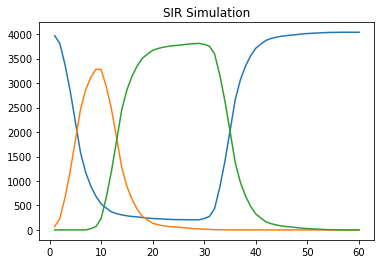

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             137 |
|      2 |   3437 |             133 |
|      3 |   1912 |             122 |
|      4 |    107 |             114 |
|      5 |      0 |              78 |
|      6 |    348 |              33 |
|      7 |    483 |              30 |
|      8 |    686 |              25 |
|      9 |   1199 |              21 |
|     10 |    414 |              19 |
|     11 |    475 |              18 |
|     12 |    376 |              18 |
|     13 |   3980 |              17 |
|     14 |   1447 |              16 |
|     15 |   1584 |              13 |
+--------+--------+-----------------+


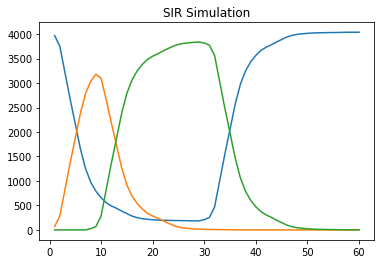

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             158 |
|      2 |   3437 |             129 |
|      3 |    107 |             117 |
|      4 |      0 |              84 |
|      5 |   1912 |              45 |
|      6 |    348 |              41 |
|      7 |    414 |              33 |
|      8 |    686 |              29 |
|      9 |    925 |              23 |
|     10 |   2201 |              22 |
|     11 |    483 |              18 |
|     12 |   1192 |              18 |
|     13 |   2007 |              17 |
|     14 |   2200 |              15 |
|     15 |    698 |              15 |
+--------+--------+-----------------+


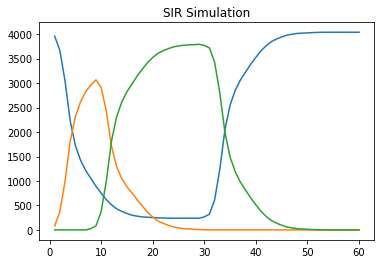

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             146 |
|      2 |   1684 |             145 |
|      3 |   3437 |              99 |
|      4 |      0 |              73 |
|      5 |   1912 |              65 |
|      6 |   2347 |              36 |
|      7 |    414 |              28 |
|      8 |   2543 |              24 |
|      9 |   1888 |              24 |
|     10 |    348 |              22 |
|     11 |    698 |              21 |
|     12 |    483 |              17 |
|     13 |    896 |              15 |
|     14 |    484 |              14 |
|     15 |   1432 |              14 |
+--------+--------+-----------------+


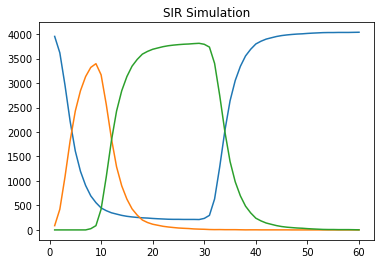

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             145 |
|      2 |    107 |             131 |
|      3 |   3437 |             122 |
|      4 |   1912 |              95 |
|      5 |      0 |              78 |
|      6 |    348 |              29 |
|      7 |   2719 |              25 |
|      8 |   2124 |              22 |
|      9 |   2347 |              19 |
|     10 |    686 |              19 |
|     11 |    414 |              19 |
|     12 |   3980 |              17 |
|     13 |   1175 |              15 |
|     14 |   2642 |              15 |
|     15 |   2629 |              15 |
+--------+--------+-----------------+


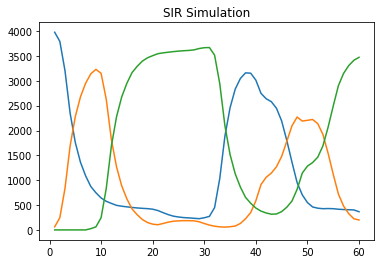

Giorno 60 :
Suscettibili: 366
Infetti: 200
Guariti: 3473
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             261 |
|      2 |   1684 |             254 |
|      3 |   3437 |             219 |
|      4 |   1912 |             153 |
|      5 |      0 |             133 |
|      6 |    348 |              76 |
|      7 |    686 |              53 |
|      8 |    414 |              42 |
|      9 |   2543 |              40 |
|     10 |   1718 |              32 |
|     11 |   2047 |              30 |
|     12 |    376 |              28 |
|     13 |    483 |              28 |
|     14 |   2081 |              26 |
|     15 |   1086 |              26 |
+--------+--------+-----------------+


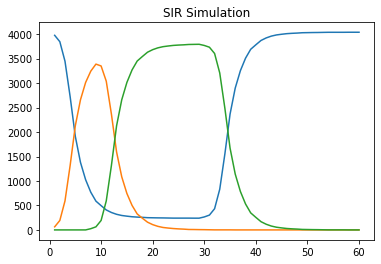

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             158 |
|      2 |   3437 |             124 |
|      3 |   1684 |             120 |
|      4 |      0 |              77 |
|      5 |   1912 |              65 |
|      6 |    686 |              32 |
|      7 |   2543 |              25 |
|      8 |    917 |              20 |
|      9 |    348 |              19 |
|     10 |    483 |              18 |
|     11 |    497 |              17 |
|     12 |   1945 |              16 |
|     13 |   2279 |              14 |
|     14 |   1998 |              14 |
|     15 |    698 |              14 |
+--------+--------+-----------------+


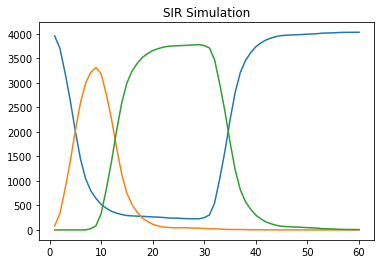

Giorno 60 :
Suscettibili: 4032
Infetti: 0
Guariti: 7
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             126 |
|      2 |   3437 |             120 |
|      3 |   1912 |             101 |
|      4 |    107 |              90 |
|      5 |      0 |              51 |
|      6 |    348 |              47 |
|      7 |    483 |              26 |
|      8 |    686 |              24 |
|      9 |    414 |              22 |
|     10 |    917 |              18 |
|     11 |    993 |              18 |
|     12 |    745 |              17 |
|     13 |   2543 |              17 |
|     14 |   3980 |              16 |
|     15 |   2410 |              16 |
+--------+--------+-----------------+


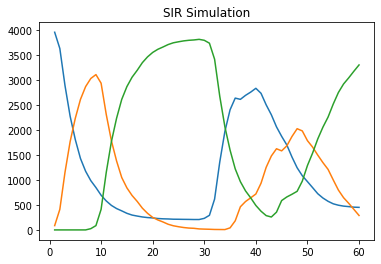

Giorno 60 :
Suscettibili: 451
Infetti: 289
Guariti: 3299
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             298 |
|      2 |    107 |             277 |
|      3 |   1912 |             227 |
|      4 |   3437 |             221 |
|      5 |      0 |             172 |
|      6 |    414 |              57 |
|      7 |    348 |              50 |
|      8 |    686 |              37 |
|      9 |    563 |              30 |
|     10 |    483 |              30 |
|     11 |   2007 |              28 |
|     12 |    363 |              27 |
|     13 |    136 |              21 |
|     14 |    376 |              20 |
|     15 |    925 |              19 |
+--------+--------+-----------------+


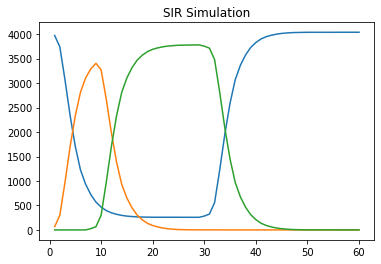

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             146 |
|      2 |   3437 |             132 |
|      3 |   1684 |             127 |
|      4 |   1912 |             106 |
|      5 |      0 |              86 |
|      6 |    414 |              25 |
|      7 |    686 |              25 |
|      8 |   1985 |              21 |
|      9 |    348 |              21 |
|     10 |    483 |              18 |
|     11 |    925 |              18 |
|     12 |   1714 |              17 |
|     13 |   2007 |              16 |
|     14 |   1331 |              15 |
|     15 |    376 |              15 |
+--------+--------+-----------------+


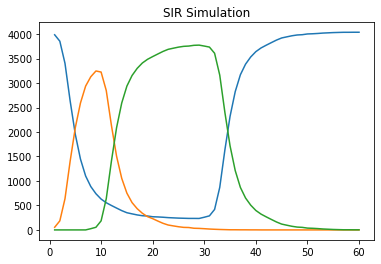

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             189 |
|      2 |   3437 |             130 |
|      3 |   1684 |             121 |
|      4 |   1912 |              62 |
|      5 |      0 |              49 |
|      6 |    348 |              39 |
|      7 |    414 |              21 |
|      8 |    698 |              18 |
|      9 |   2104 |              17 |
|     10 |   1377 |              16 |
|     11 |   2461 |              16 |
|     12 |   2347 |              15 |
|     13 |    376 |              15 |
|     14 |   1985 |              15 |
|     15 |   3324 |              14 |
+--------+--------+-----------------+


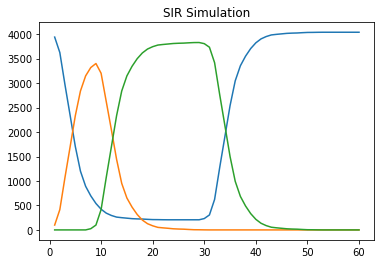

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             162 |
|      2 |    107 |             154 |
|      3 |   3437 |             121 |
|      4 |      0 |              80 |
|      5 |   1912 |              73 |
|      6 |    348 |              48 |
|      7 |    686 |              28 |
|      8 |    414 |              22 |
|      9 |   2347 |              21 |
|     10 |   1804 |              17 |
|     11 |   1718 |              16 |
|     12 |   2046 |              16 |
|     13 |   1086 |              15 |
|     14 |   2313 |              15 |
|     15 |   1079 |              14 |
+--------+--------+-----------------+


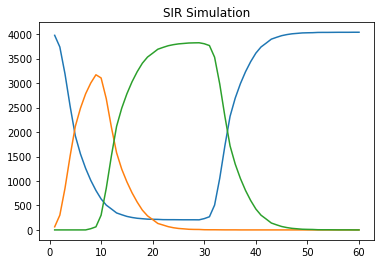

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             201 |
|      2 |   3437 |             117 |
|      3 |   1912 |             101 |
|      4 |      0 |              86 |
|      5 |   1684 |              73 |
|      6 |    686 |              39 |
|      7 |    414 |              22 |
|      8 |   3830 |              20 |
|      9 |   2037 |              19 |
|     10 |    348 |              19 |
|     11 |    366 |              18 |
|     12 |   3366 |              14 |
|     13 |   2054 |              14 |
|     14 |   1172 |              14 |
|     15 |   2782 |              13 |
+--------+--------+-----------------+


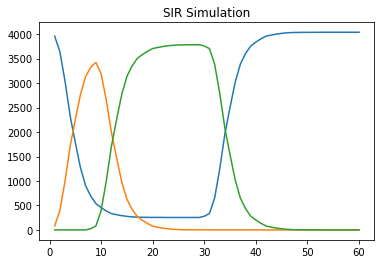

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             187 |
|      2 |   1684 |             144 |
|      3 |   3437 |             109 |
|      4 |   1912 |              74 |
|      5 |      0 |              58 |
|      6 |    348 |              22 |
|      7 |   2598 |              19 |
|      8 |    414 |              19 |
|      9 |   2184 |              19 |
|     10 |    686 |              18 |
|     11 |   2047 |              18 |
|     12 |    483 |              17 |
|     13 |   2266 |              16 |
|     14 |    376 |              15 |
|     15 |    538 |              14 |
+--------+--------+-----------------+


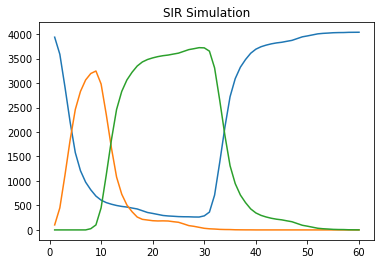

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             133 |
|      2 |   3437 |             119 |
|      3 |   1684 |              90 |
|      4 |   1912 |              82 |
|      5 |      0 |              76 |
|      6 |    483 |              25 |
|      7 |    686 |              23 |
|      8 |    414 |              23 |
|      9 |    348 |              21 |
|     10 |   1126 |              21 |
|     11 |   2607 |              19 |
|     12 |    136 |              18 |
|     13 |    946 |              18 |
|     14 |   1472 |              18 |
|     15 |   1255 |              17 |
+--------+--------+-----------------+


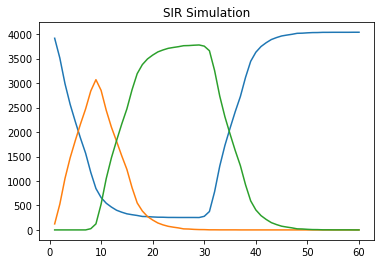

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             160 |
|      2 |   1684 |             150 |
|      3 |   3437 |             103 |
|      4 |   1912 |              99 |
|      5 |      0 |              60 |
|      6 |    414 |              27 |
|      7 |   2347 |              26 |
|      8 |    686 |              19 |
|      9 |   1879 |              16 |
|     10 |   1017 |              15 |
|     11 |   2550 |              15 |
|     12 |    348 |              15 |
|     13 |    376 |              14 |
|     14 |    828 |              14 |
|     15 |   2323 |              13 |
+--------+--------+-----------------+


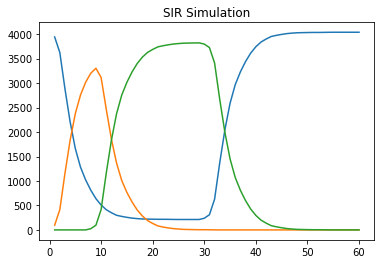

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             121 |
|      2 |   1684 |              92 |
|      3 |   3437 |              89 |
|      4 |      0 |              79 |
|      5 |   1912 |              78 |
|      6 |    686 |              25 |
|      7 |    348 |              23 |
|      8 |    483 |              22 |
|      9 |    966 |              22 |
|     10 |    517 |              22 |
|     11 |   2623 |              21 |
|     12 |    414 |              20 |
|     13 |   2543 |              20 |
|     14 |   3017 |              19 |
|     15 |   2266 |              18 |
+--------+--------+-----------------+


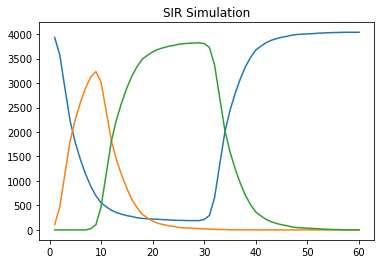

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             149 |
|      2 |   3437 |             133 |
|      3 |   1684 |             114 |
|      4 |   1912 |              91 |
|      5 |      0 |              65 |
|      6 |    483 |              34 |
|      7 |    686 |              27 |
|      8 |    348 |              23 |
|      9 |   2078 |              22 |
|     10 |   1352 |              21 |
|     11 |    428 |              20 |
|     12 |   2839 |              20 |
|     13 |   2828 |              19 |
|     14 |   3980 |              18 |
|     15 |   2081 |              14 |
+--------+--------+-----------------+


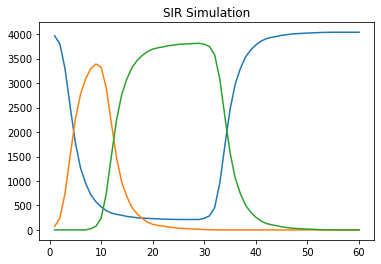

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             151 |
|      2 |   1684 |             116 |
|      3 |   3437 |             111 |
|      4 |   1912 |              75 |
|      5 |      0 |              66 |
|      6 |    348 |              32 |
|      7 |    686 |              26 |
|      8 |    483 |              25 |
|      9 |    376 |              23 |
|     10 |    414 |              23 |
|     11 |   2282 |              19 |
|     12 |   2951 |              18 |
|     13 |    698 |              16 |
|     14 |   1941 |              14 |
|     15 |   3545 |              14 |
+--------+--------+-----------------+


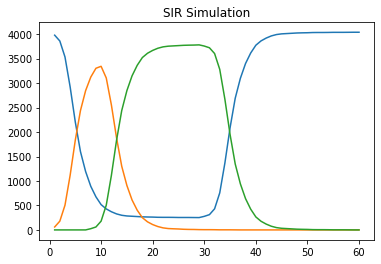

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             166 |
|      2 |   1684 |             119 |
|      3 |   3437 |             112 |
|      4 |   1912 |              90 |
|      5 |      0 |              77 |
|      6 |    686 |              27 |
|      7 |    414 |              22 |
|      8 |   2347 |              16 |
|      9 |    483 |              16 |
|     10 |    563 |              16 |
|     11 |   1941 |              16 |
|     12 |   2127 |              15 |
|     13 |   1636 |              15 |
|     14 |   2730 |              14 |
|     15 |   2944 |              13 |
+--------+--------+-----------------+


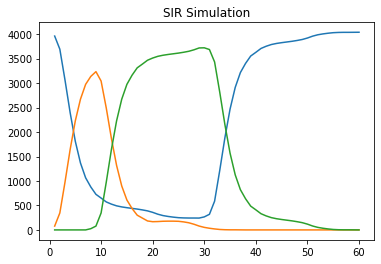

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             131 |
|      2 |    107 |             131 |
|      3 |   1912 |              99 |
|      4 |   1684 |              79 |
|      5 |      0 |              73 |
|      6 |    686 |              35 |
|      7 |   1352 |              30 |
|      8 |    414 |              27 |
|      9 |   2150 |              20 |
|     10 |    348 |              20 |
|     11 |   2233 |              19 |
|     12 |    698 |              19 |
|     13 |    483 |              17 |
|     14 |   1917 |              16 |
|     15 |   2347 |              16 |
+--------+--------+-----------------+


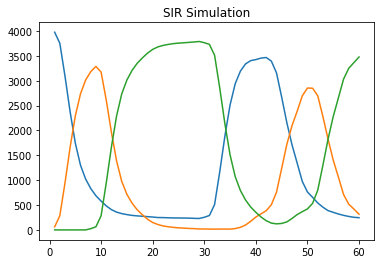

Giorno 60 :
Suscettibili: 246
Infetti: 315
Guariti: 3478
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             342 |
|      2 |   1684 |             324 |
|      3 |   3437 |             252 |
|      4 |   1912 |             190 |
|      5 |      0 |             138 |
|      6 |    414 |              51 |
|      7 |    686 |              48 |
|      8 |    483 |              46 |
|      9 |    348 |              45 |
|     10 |    698 |              36 |
|     11 |    376 |              29 |
|     12 |   2543 |              29 |
|     13 |   1971 |              24 |
|     14 |    136 |              22 |
|     15 |   1390 |              21 |
+--------+--------+-----------------+


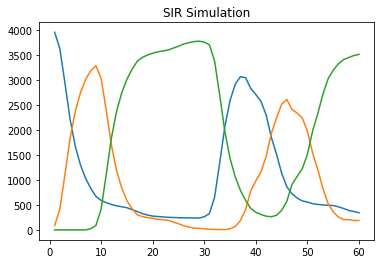

Giorno 60 :
Suscettibili: 343
Infetti: 188
Guariti: 3508
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             316 |
|      2 |   3437 |             256 |
|      3 |   1684 |             243 |
|      4 |   1912 |             196 |
|      5 |      0 |             157 |
|      6 |    348 |              59 |
|      7 |    686 |              53 |
|      8 |    414 |              47 |
|      9 |   2347 |              36 |
|     10 |    698 |              34 |
|     11 |   2694 |              29 |
|     12 |   2103 |              22 |
|     13 |   1124 |              20 |
|     14 |    637 |              20 |
|     15 |   1718 |              18 |
+--------+--------+-----------------+


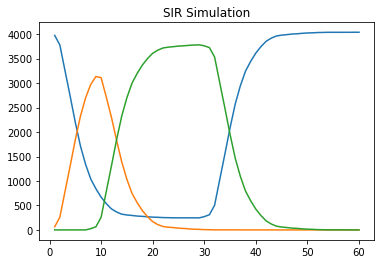

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             139 |
|      2 |   3437 |             110 |
|      3 |   1684 |              85 |
|      4 |      0 |              80 |
|      5 |   1912 |              73 |
|      6 |    686 |              39 |
|      7 |    348 |              30 |
|      8 |   2604 |              20 |
|      9 |   1409 |              19 |
|     10 |   3082 |              18 |
|     11 |   1584 |              17 |
|     12 |    414 |              15 |
|     13 |    483 |              14 |
|     14 |    376 |              13 |
|     15 |   3633 |              13 |
+--------+--------+-----------------+


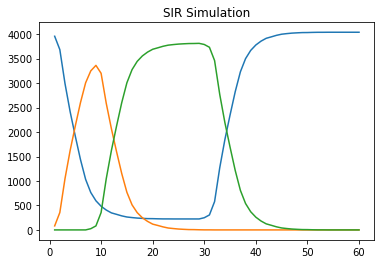

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             136 |
|      2 |   3437 |             131 |
|      3 |   1684 |             125 |
|      4 |   1912 |             110 |
|      5 |      0 |              78 |
|      6 |    483 |              34 |
|      7 |    348 |              19 |
|      8 |    686 |              19 |
|      9 |   2477 |              18 |
|     10 |    414 |              15 |
|     11 |   1584 |              14 |
|     12 |   1222 |              12 |
|     13 |    698 |              12 |
|     14 |    376 |              11 |
|     15 |   1643 |              11 |
+--------+--------+-----------------+


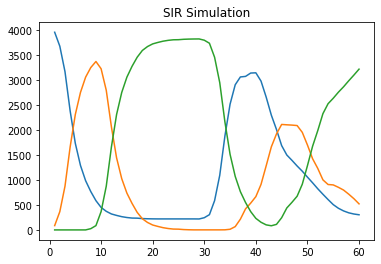

Giorno 60 :
Suscettibili: 303
Infetti: 521
Guariti: 3215
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             318 |
|      2 |   1684 |             265 |
|      3 |   3437 |             246 |
|      4 |   1912 |             207 |
|      5 |      0 |             169 |
|      6 |    348 |              73 |
|      7 |    686 |              58 |
|      8 |    414 |              57 |
|      9 |   1577 |              31 |
|     10 |   1059 |              28 |
|     11 |    698 |              27 |
|     12 |    483 |              26 |
|     13 |   1086 |              24 |
|     14 |   2730 |              22 |
|     15 |   1399 |              20 |
+--------+--------+-----------------+


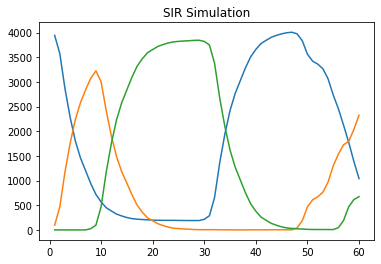

Giorno 60 :
Suscettibili: 1040
Infetti: 2324
Guariti: 675
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             267 |
|      2 |   1684 |             262 |
|      3 |   3437 |             217 |
|      4 |   1912 |             215 |
|      5 |      0 |             110 |
|      6 |    686 |              40 |
|      7 |    414 |              36 |
|      8 |    348 |              32 |
|      9 |    483 |              31 |
|     10 |   1431 |              30 |
|     11 |   1663 |              25 |
|     12 |    563 |              25 |
|     13 |   2047 |              22 |
|     14 |    428 |              21 |
|     15 |   3104 |              19 |
+--------+--------+-----------------+


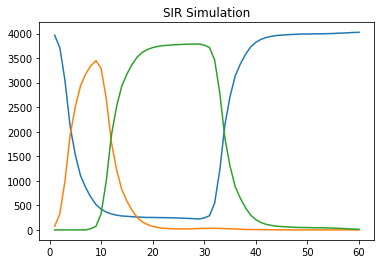

Giorno 60 :
Suscettibili: 4027
Infetti: 0
Guariti: 12
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             155 |
|      2 |    107 |             134 |
|      3 |   3437 |             114 |
|      4 |   1912 |             107 |
|      5 |      0 |              86 |
|      6 |    686 |              36 |
|      7 |    348 |              33 |
|      8 |   1589 |              23 |
|      9 |   2336 |              19 |
|     10 |   3830 |              17 |
|     11 |    414 |              16 |
|     12 |   1334 |              15 |
|     13 |    698 |              14 |
|     14 |    363 |              14 |
|     15 |   1577 |              14 |
+--------+--------+-----------------+


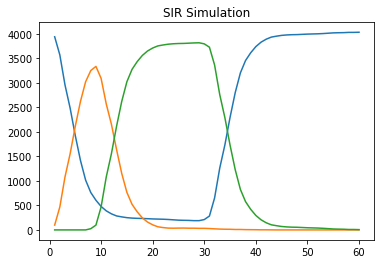

Giorno 60 :
Suscettibili: 4033
Infetti: 0
Guariti: 6
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             149 |
|      2 |   3437 |             144 |
|      3 |   1684 |             128 |
|      4 |   1912 |              90 |
|      5 |      0 |              77 |
|      6 |    348 |              27 |
|      7 |    686 |              26 |
|      8 |    917 |              20 |
|      9 |    538 |              20 |
|     10 |   3980 |              18 |
|     11 |    414 |              18 |
|     12 |   2339 |              18 |
|     13 |   1330 |              17 |
|     14 |   1235 |              16 |
|     15 |   2040 |              16 |
+--------+--------+-----------------+


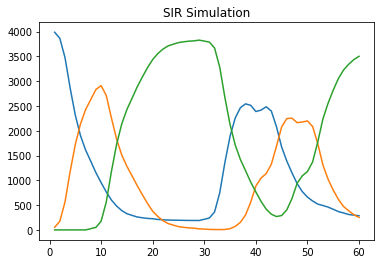

Giorno 60 :
Suscettibili: 286
Infetti: 251
Guariti: 3502
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             283 |
|      2 |   3437 |             271 |
|      3 |    107 |             259 |
|      4 |      0 |             157 |
|      5 |   1912 |             144 |
|      6 |    348 |              75 |
|      7 |   2347 |              44 |
|      8 |   2543 |              36 |
|      9 |    686 |              34 |
|     10 |    414 |              34 |
|     11 |    475 |              32 |
|     12 |    698 |              31 |
|     13 |   1577 |              30 |
|     14 |    483 |              29 |
|     15 |   1199 |              23 |
+--------+--------+-----------------+


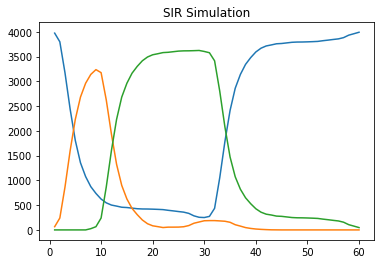

Giorno 60 :
Suscettibili: 3992
Infetti: 0
Guariti: 47
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             145 |
|      2 |   3437 |             133 |
|      3 |   1684 |             106 |
|      4 |      0 |              87 |
|      5 |   1912 |              82 |
|      6 |    348 |              24 |
|      7 |    414 |              24 |
|      8 |    698 |              22 |
|      9 |    686 |              22 |
|     10 |   1589 |              17 |
|     11 |   1584 |              16 |
|     12 |    896 |              14 |
|     13 |   1227 |              14 |
|     14 |   2351 |              13 |
|     15 |    580 |              12 |
+--------+--------+-----------------+


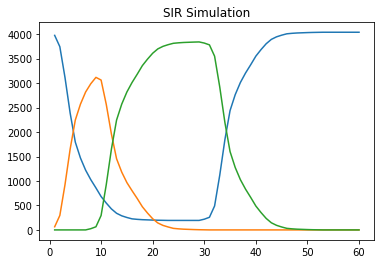

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             140 |
|      2 |   3437 |             133 |
|      3 |   1684 |             129 |
|      4 |      0 |              84 |
|      5 |   1912 |              83 |
|      6 |    348 |              31 |
|      7 |    686 |              30 |
|      8 |   1086 |              27 |
|      9 |    414 |              26 |
|     10 |   1192 |              20 |
|     11 |   2333 |              19 |
|     12 |    483 |              18 |
|     13 |    896 |              18 |
|     14 |   2906 |              15 |
|     15 |   1926 |              15 |
+--------+--------+-----------------+


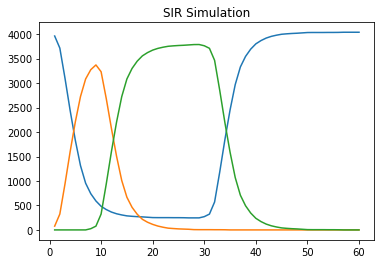

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             168 |
|      2 |   3437 |             103 |
|      3 |   1684 |             100 |
|      4 |   1912 |              89 |
|      5 |      0 |              70 |
|      6 |    348 |              26 |
|      7 |    686 |              24 |
|      8 |    414 |              21 |
|      9 |   2081 |              19 |
|     10 |   2309 |              19 |
|     11 |   1600 |              16 |
|     12 |   1377 |              15 |
|     13 |     67 |              15 |
|     14 |   2047 |              15 |
|     15 |    428 |              14 |
+--------+--------+-----------------+


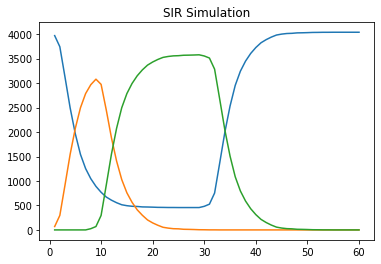

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             143 |
|      2 |    107 |             132 |
|      3 |   1912 |             112 |
|      4 |   3437 |             102 |
|      5 |      0 |              77 |
|      6 |   1746 |              30 |
|      7 |    348 |              26 |
|      8 |    414 |              25 |
|      9 |   2543 |              15 |
|     10 |   1462 |              14 |
|     11 |   1962 |              14 |
|     12 |   2122 |              13 |
|     13 |   2063 |              13 |
|     14 |   2047 |              12 |
|     15 |   2874 |              12 |
+--------+--------+-----------------+


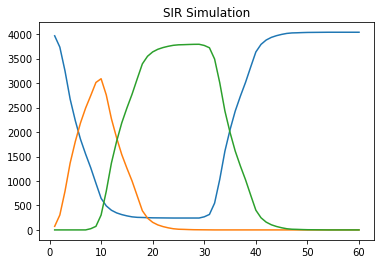

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             165 |
|      2 |    107 |             139 |
|      3 |   3437 |              90 |
|      4 |   1912 |              79 |
|      5 |      0 |              72 |
|      6 |    348 |              25 |
|      7 |   1471 |              22 |
|      8 |    686 |              20 |
|      9 |    414 |              18 |
|     10 |   2326 |              17 |
|     11 |   3756 |              15 |
|     12 |   1059 |              15 |
|     13 |    373 |              14 |
|     14 |   2045 |              13 |
|     15 |    563 |              13 |
+--------+--------+-----------------+


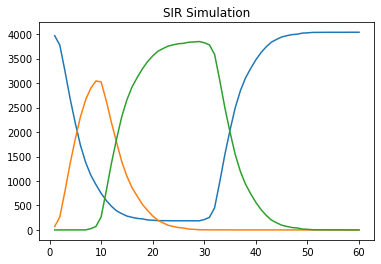

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             141 |
|      2 |   3437 |             100 |
|      3 |    107 |              93 |
|      4 |   1912 |              93 |
|      5 |      0 |              73 |
|      6 |    686 |              30 |
|      7 |    414 |              29 |
|      8 |    348 |              25 |
|      9 |    896 |              19 |
|     10 |   2750 |              17 |
|     11 |   2410 |              17 |
|     12 |   1420 |              17 |
|     13 |   1126 |              16 |
|     14 |   1014 |              16 |
|     15 |   2384 |              16 |
+--------+--------+-----------------+


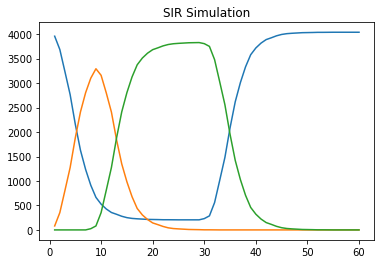

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             151 |
|      2 |   1684 |             140 |
|      3 |   3437 |             110 |
|      4 |      0 |              67 |
|      5 |   1912 |              55 |
|      6 |    348 |              47 |
|      7 |    414 |              30 |
|      8 |    686 |              28 |
|      9 |   2384 |              24 |
|     10 |   3980 |              21 |
|     11 |    925 |              17 |
|     12 |   2063 |              17 |
|     13 |   1663 |              16 |
|     14 |   1827 |              15 |
|     15 |    136 |              15 |
+--------+--------+-----------------+


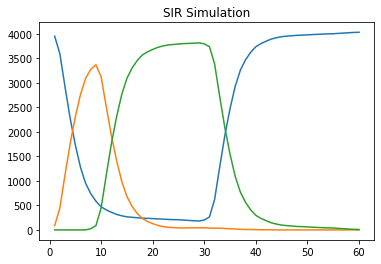

Giorno 60 :
Suscettibili: 4031
Infetti: 0
Guariti: 8
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             127 |
|      2 |   1684 |             126 |
|      3 |   3437 |             125 |
|      4 |   1912 |             100 |
|      5 |      0 |              63 |
|      6 |    348 |              40 |
|      7 |    686 |              39 |
|      8 |   1431 |              20 |
|      9 |    917 |              19 |
|     10 |   2485 |              19 |
|     11 |   3397 |              19 |
|     12 |    414 |              18 |
|     13 |   1367 |              16 |
|     14 |   1665 |              15 |
|     15 |   3320 |              14 |
+--------+--------+-----------------+


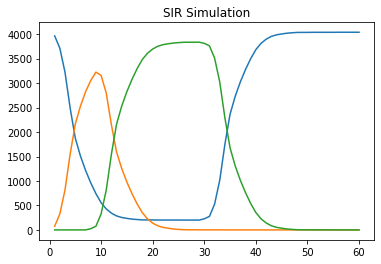

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             152 |
|      2 |    107 |              97 |
|      3 |   3437 |              92 |
|      4 |      0 |              74 |
|      5 |   1912 |              63 |
|      6 |    348 |              42 |
|      7 |    414 |              21 |
|      8 |    686 |              19 |
|      9 |   3201 |              19 |
|     10 |   2047 |              18 |
|     11 |   2369 |              18 |
|     12 |   3980 |              16 |
|     13 |   2543 |              15 |
|     14 |    136 |              15 |
|     15 |   1783 |              14 |
+--------+--------+-----------------+


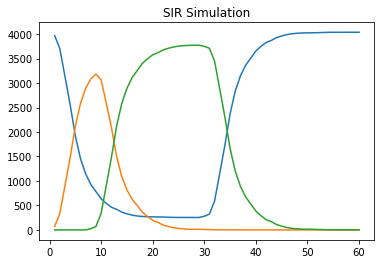

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             152 |
|      2 |   1684 |             127 |
|      3 |   3437 |              96 |
|      4 |   1912 |              79 |
|      5 |      0 |              68 |
|      6 |    348 |              42 |
|      7 |   1086 |              33 |
|      8 |    686 |              29 |
|      9 |    483 |              24 |
|     10 |    414 |              22 |
|     11 |    698 |              20 |
|     12 |    136 |              17 |
|     13 |   2007 |              15 |
|     14 |    606 |              15 |
|     15 |   2602 |              14 |
+--------+--------+-----------------+


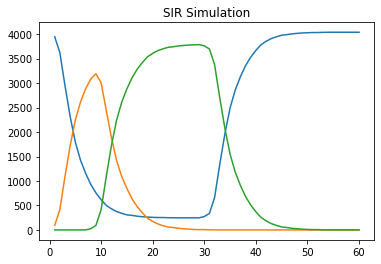

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             141 |
|      2 |   1684 |             139 |
|      3 |      0 |              94 |
|      4 |   3437 |              91 |
|      5 |   1912 |              86 |
|      6 |    414 |              28 |
|      7 |    348 |              23 |
|      8 |    580 |              21 |
|      9 |   1377 |              20 |
|     10 |    686 |              19 |
|     11 |   2046 |              19 |
|     12 |    993 |              17 |
|     13 |   1938 |              15 |
|     14 |    946 |              15 |
|     15 |   2037 |              14 |
+--------+--------+-----------------+


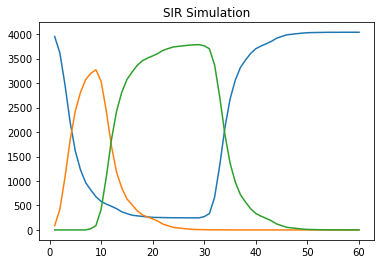

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             174 |
|      2 |   3437 |             112 |
|      3 |   1684 |             111 |
|      4 |   1912 |              92 |
|      5 |      0 |              54 |
|      6 |    414 |              33 |
|      7 |   2220 |              25 |
|      8 |    686 |              25 |
|      9 |   2247 |              17 |
|     10 |    698 |              16 |
|     11 |    348 |              16 |
|     12 |   1827 |              15 |
|     13 |   1277 |              14 |
|     14 |   2042 |              13 |
|     15 |    947 |              13 |
+--------+--------+-----------------+


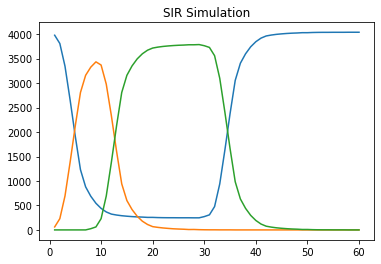

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             175 |
|      2 |   3437 |             146 |
|      3 |   1912 |             130 |
|      4 |      0 |              90 |
|      5 |   1684 |              63 |
|      6 |    348 |              42 |
|      7 |    414 |              27 |
|      8 |   2047 |              25 |
|      9 |    686 |              25 |
|     10 |   1235 |              13 |
|     11 |   3132 |              13 |
|     12 |    932 |              13 |
|     13 |    698 |              12 |
|     14 |   1078 |              12 |
|     15 |    705 |              11 |
+--------+--------+-----------------+


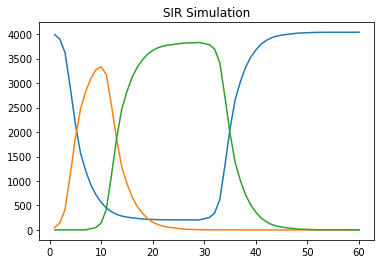

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             142 |
|      2 |   3437 |             108 |
|      3 |   1912 |              87 |
|      4 |      0 |              86 |
|      5 |    107 |              83 |
|      6 |    686 |              40 |
|      7 |    348 |              32 |
|      8 |    414 |              21 |
|      9 |   2347 |              21 |
|     10 |   1184 |              18 |
|     11 |   2313 |              17 |
|     12 |   1390 |              15 |
|     13 |   3980 |              15 |
|     14 |   1522 |              14 |
|     15 |   1663 |              14 |
+--------+--------+-----------------+


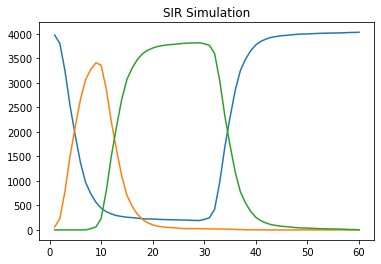

Giorno 60 :
Suscettibili: 4036
Infetti: 0
Guariti: 3
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             143 |
|      2 |   1684 |             113 |
|      3 |   3437 |             103 |
|      4 |      0 |              88 |
|      5 |   1912 |              70 |
|      6 |    686 |              37 |
|      7 |    348 |              37 |
|      8 |   2111 |              21 |
|      9 |   2007 |              21 |
|     10 |   3980 |              18 |
|     11 |   2220 |              18 |
|     12 |   2724 |              18 |
|     13 |    414 |              17 |
|     14 |    698 |              17 |
|     15 |   2266 |              16 |
+--------+--------+-----------------+


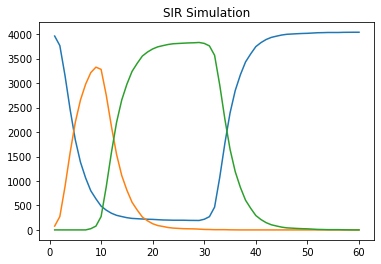

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             138 |
|      2 |   3437 |              97 |
|      3 |   1684 |              96 |
|      4 |   1912 |              86 |
|      5 |      0 |              75 |
|      6 |    686 |              41 |
|      7 |    348 |              31 |
|      8 |   1376 |              25 |
|      9 |    414 |              25 |
|     10 |   1577 |              19 |
|     11 |   1059 |              17 |
|     12 |   3980 |              17 |
|     13 |   2123 |              17 |
|     14 |   2543 |              16 |
|     15 |   1610 |              14 |
+--------+--------+-----------------+


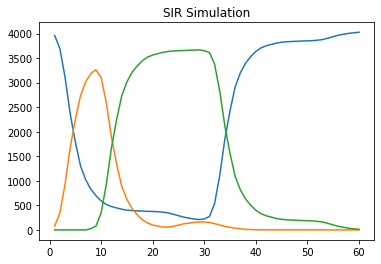

Giorno 60 :
Suscettibili: 4027
Infetti: 0
Guariti: 12
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             154 |
|      2 |    107 |             109 |
|      3 |   3437 |             102 |
|      4 |   1912 |              82 |
|      5 |      0 |              69 |
|      6 |    348 |              29 |
|      7 |    414 |              28 |
|      8 |   2266 |              26 |
|      9 |    698 |              24 |
|     10 |   3980 |              22 |
|     11 |   2292 |              18 |
|     12 |   1175 |              18 |
|     13 |   2040 |              15 |
|     14 |   3291 |              15 |
|     15 |   3378 |              14 |
+--------+--------+-----------------+


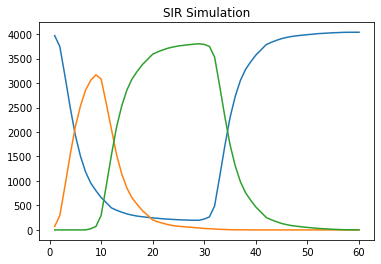

Giorno 60 :
Suscettibili: 4037
Infetti: 0
Guariti: 2
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             133 |
|      2 |   3437 |             123 |
|      3 |   1684 |             115 |
|      4 |      0 |              69 |
|      5 |   1912 |              58 |
|      6 |    348 |              29 |
|      7 |    414 |              27 |
|      8 |    686 |              24 |
|      9 |   2283 |              21 |
|     10 |   1124 |              20 |
|     11 |   3980 |              18 |
|     12 |    412 |              18 |
|     13 |   1006 |              17 |
|     14 |   1986 |              16 |
|     15 |    483 |              16 |
+--------+--------+-----------------+


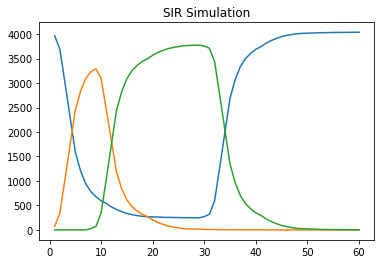

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             160 |
|      2 |   1684 |             151 |
|      3 |   3437 |             123 |
|      4 |   1912 |              93 |
|      5 |      0 |              72 |
|      6 |    686 |              29 |
|      7 |    414 |              25 |
|      8 |    483 |              21 |
|      9 |    376 |              21 |
|     10 |   1926 |              19 |
|     11 |    348 |              17 |
|     12 |    428 |              17 |
|     13 |   2077 |              17 |
|     14 |    698 |              16 |
|     15 |    651 |              14 |
+--------+--------+-----------------+


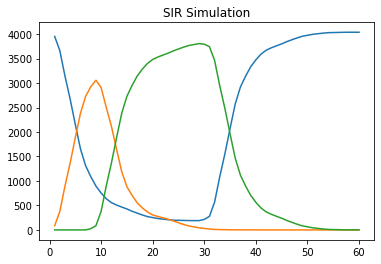

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             131 |
|      2 |   1684 |             117 |
|      3 |   3437 |             104 |
|      4 |   1912 |              70 |
|      5 |      0 |              68 |
|      6 |    686 |              25 |
|      7 |    348 |              24 |
|      8 |   1613 |              21 |
|      9 |   2201 |              20 |
|     10 |    698 |              18 |
|     11 |   2088 |              18 |
|     12 |    414 |              17 |
|     13 |   1420 |              17 |
|     14 |   1993 |              16 |
|     15 |   2683 |              16 |
+--------+--------+-----------------+


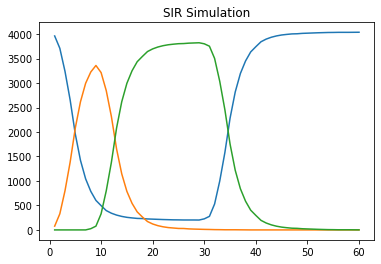

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             123 |
|      2 |    107 |             120 |
|      3 |   3437 |             115 |
|      4 |      0 |              88 |
|      5 |   1912 |              68 |
|      6 |    348 |              31 |
|      7 |    686 |              28 |
|      8 |    483 |              26 |
|      9 |    414 |              23 |
|     10 |   1920 |              18 |
|     11 |   1017 |              18 |
|     12 |   3830 |              18 |
|     13 |   2347 |              17 |
|     14 |    698 |              16 |
|     15 |   1730 |              16 |
+--------+--------+-----------------+


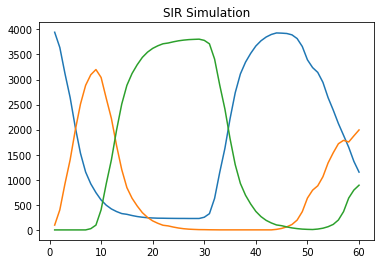

Giorno 60 :
Suscettibili: 1153
Infetti: 1994
Guariti: 892
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             270 |
|      2 |   1684 |             247 |
|      3 |      0 |             151 |
|      4 |   1912 |             145 |
|      5 |   3437 |             137 |
|      6 |    348 |              58 |
|      7 |    414 |              41 |
|      8 |   1126 |              33 |
|      9 |    686 |              33 |
|     10 |   2347 |              31 |
|     11 |    637 |              27 |
|     12 |    136 |              26 |
|     13 |   2313 |              23 |
|     14 |   2730 |              22 |
|     15 |   2007 |              22 |
+--------+--------+-----------------+


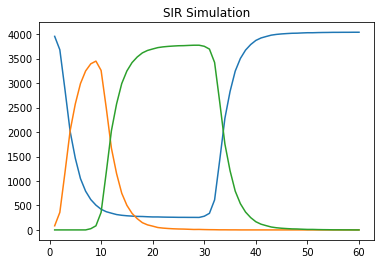

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             124 |
|      2 |   3437 |             122 |
|      3 |   1684 |             116 |
|      4 |   1912 |              89 |
|      5 |      0 |              58 |
|      6 |    348 |              42 |
|      7 |    686 |              32 |
|      8 |    414 |              26 |
|      9 |   2468 |              19 |
|     10 |   2890 |              19 |
|     11 |   2324 |              18 |
|     12 |   2081 |              18 |
|     13 |   2054 |              14 |
|     14 |   3411 |              14 |
|     15 |   1017 |              14 |
+--------+--------+-----------------+


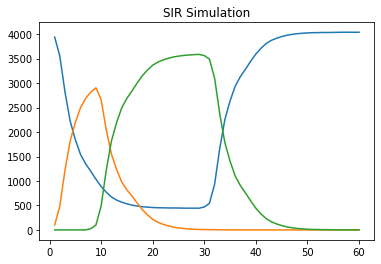

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             169 |
|      2 |   1684 |             135 |
|      3 |   3437 |             106 |
|      4 |      0 |              86 |
|      5 |   1912 |              64 |
|      6 |    348 |              24 |
|      7 |    428 |              19 |
|      8 |    414 |              19 |
|      9 |   3830 |              19 |
|     10 |   1256 |              16 |
|     11 |   2187 |              16 |
|     12 |   3302 |              16 |
|     13 |   2047 |              16 |
|     14 |   2299 |              15 |
|     15 |   2172 |              15 |
+--------+--------+-----------------+


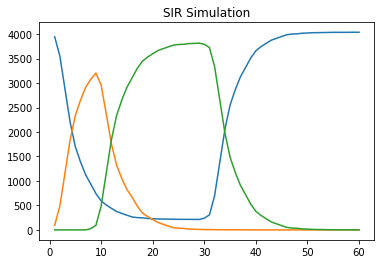

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             139 |
|      2 |   1684 |             131 |
|      3 |   3437 |             128 |
|      4 |   1912 |              86 |
|      5 |      0 |              66 |
|      6 |    483 |              32 |
|      7 |    686 |              32 |
|      8 |   1352 |              31 |
|      9 |    414 |              29 |
|     10 |   2108 |              22 |
|     11 |    348 |              21 |
|     12 |   2037 |              18 |
|     13 |   3980 |              17 |
|     14 |   2966 |              14 |
|     15 |   2086 |              13 |
+--------+--------+-----------------+


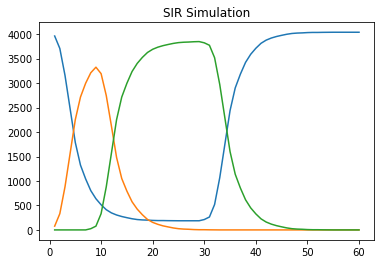

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             122 |
|      2 |   3437 |             114 |
|      3 |   1684 |              93 |
|      4 |   1912 |              71 |
|      5 |      0 |              51 |
|      6 |    483 |              34 |
|      7 |    686 |              33 |
|      8 |    414 |              29 |
|      9 |    348 |              26 |
|     10 |   1086 |              23 |
|     11 |   3830 |              19 |
|     12 |   3980 |              19 |
|     13 |   1951 |              17 |
|     14 |    376 |              16 |
|     15 |   2131 |              16 |
+--------+--------+-----------------+


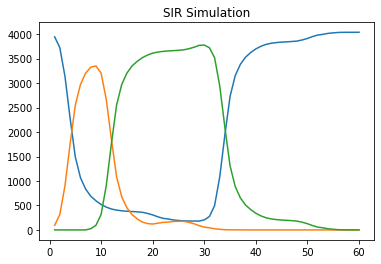

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             145 |
|      2 |   1684 |             139 |
|      3 |   3437 |             126 |
|      4 |   1912 |              91 |
|      5 |      0 |              77 |
|      6 |    348 |              44 |
|      7 |   2047 |              29 |
|      8 |    896 |              27 |
|      9 |    414 |              22 |
|     10 |   3980 |              22 |
|     11 |   1584 |              21 |
|     12 |    698 |              19 |
|     13 |    686 |              18 |
|     14 |   1589 |              17 |
|     15 |    563 |              14 |
+--------+--------+-----------------+


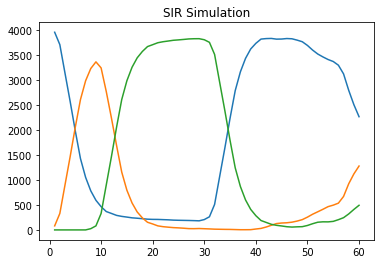

Giorno 60 :
Suscettibili: 2267
Infetti: 1279
Guariti: 493
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             313 |
|      2 |   3437 |             223 |
|      3 |   1684 |             143 |
|      4 |   1912 |              80 |
|      5 |      0 |              80 |
|      6 |    686 |              55 |
|      7 |    348 |              48 |
|      8 |    414 |              31 |
|      9 |    698 |              29 |
|     10 |    376 |              29 |
|     11 |    483 |              25 |
|     12 |   1086 |              25 |
|     13 |   2553 |              22 |
|     14 |    713 |              21 |
|     15 |   2090 |              19 |
+--------+--------+-----------------+


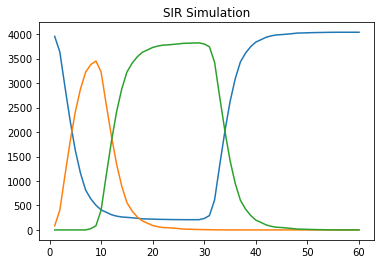

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             127 |
|      2 |    107 |             124 |
|      3 |   1684 |              84 |
|      4 |   1912 |              64 |
|      5 |      0 |              61 |
|      6 |    686 |              33 |
|      7 |    414 |              32 |
|      8 |    348 |              31 |
|      9 |   2073 |              24 |
|     10 |   1665 |              22 |
|     11 |   2038 |              21 |
|     12 |    483 |              21 |
|     13 |   2206 |              15 |
|     14 |   1584 |              14 |
|     15 |   3830 |              14 |
+--------+--------+-----------------+


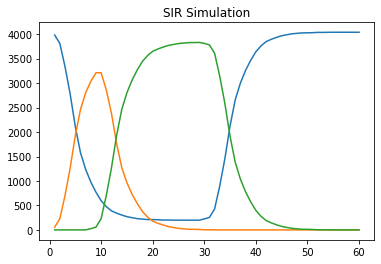

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             141 |
|      2 |    107 |             134 |
|      3 |   3437 |             131 |
|      4 |   1912 |              93 |
|      5 |      0 |              82 |
|      6 |    686 |              27 |
|      7 |    348 |              26 |
|      8 |   2187 |              22 |
|      9 |    414 |              21 |
|     10 |   1946 |              20 |
|     11 |   2328 |              17 |
|     12 |    428 |              16 |
|     13 |    698 |              16 |
|     14 |   3980 |              15 |
|     15 |   2073 |              14 |
+--------+--------+-----------------+


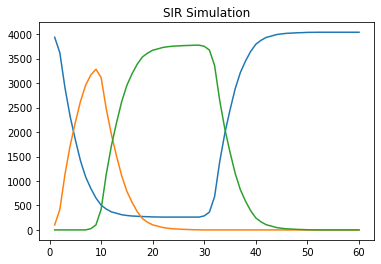

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             191 |
|      2 |   3437 |             127 |
|      3 |   1684 |             112 |
|      4 |      0 |              75 |
|      5 |   1912 |              72 |
|      6 |    686 |              26 |
|      7 |    376 |              22 |
|      8 |    348 |              21 |
|      9 |    896 |              20 |
|     10 |    414 |              19 |
|     11 |   2877 |              19 |
|     12 |   2103 |              16 |
|     13 |    993 |              16 |
|     14 |   2253 |              14 |
|     15 |   2087 |              14 |
+--------+--------+-----------------+


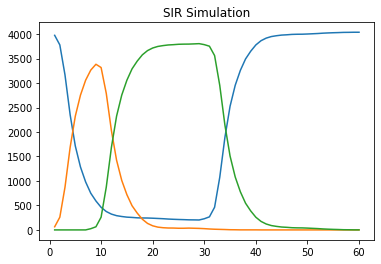

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             172 |
|      2 |   1684 |             143 |
|      3 |   3437 |             106 |
|      4 |   1912 |              99 |
|      5 |      0 |              70 |
|      6 |    348 |              34 |
|      7 |   3980 |              19 |
|      8 |   2138 |              19 |
|      9 |    483 |              18 |
|     10 |    136 |              17 |
|     11 |    475 |              17 |
|     12 |    698 |              17 |
|     13 |   1117 |              16 |
|     14 |   2313 |              15 |
|     15 |   3830 |              15 |
+--------+--------+-----------------+


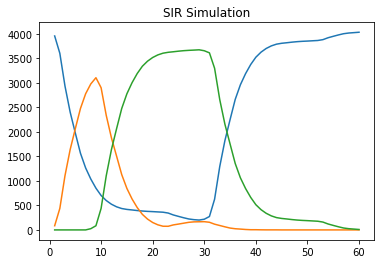

Giorno 60 :
Suscettibili: 4030
Infetti: 0
Guariti: 9
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             134 |
|      2 |   1684 |             133 |
|      3 |    107 |             128 |
|      4 |   1912 |             101 |
|      5 |      0 |              65 |
|      6 |    348 |              42 |
|      7 |    686 |              30 |
|      8 |    414 |              25 |
|      9 |   2117 |              19 |
|     10 |    698 |              19 |
|     11 |   2336 |              18 |
|     12 |   2719 |              16 |
|     13 |   2206 |              16 |
|     14 |    517 |              16 |
|     15 |   1993 |              15 |
+--------+--------+-----------------+


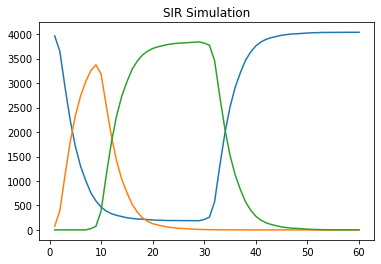

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             143 |
|      2 |    107 |             138 |
|      3 |   3437 |             117 |
|      4 |   1912 |              90 |
|      5 |      0 |              88 |
|      6 |    686 |              36 |
|      7 |    348 |              35 |
|      8 |    414 |              27 |
|      9 |   1291 |              21 |
|     10 |   1185 |              20 |
|     11 |   2601 |              20 |
|     12 |   3980 |              19 |
|     13 |    475 |              17 |
|     14 |   2347 |              17 |
|     15 |   1399 |              17 |
+--------+--------+-----------------+


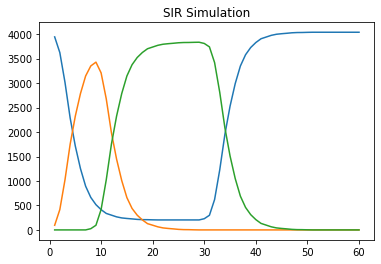

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             127 |
|      2 |   3437 |             117 |
|      3 |   1912 |              99 |
|      4 |      0 |              93 |
|      5 |   1684 |              93 |
|      6 |    348 |              31 |
|      7 |    686 |              30 |
|      8 |   2542 |              22 |
|      9 |   2111 |              20 |
|     10 |   1352 |              20 |
|     11 |   1199 |              19 |
|     12 |   2073 |              16 |
|     13 |   1826 |              15 |
|     14 |    414 |              15 |
|     15 |   1070 |              15 |
+--------+--------+-----------------+


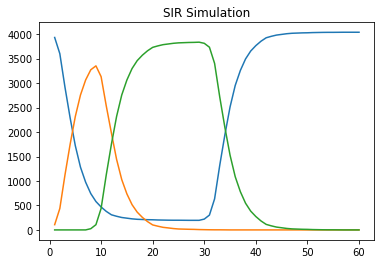

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             136 |
|      2 |   1684 |             127 |
|      3 |   3437 |             122 |
|      4 |   1912 |              71 |
|      5 |      0 |              63 |
|      6 |    686 |              36 |
|      7 |    348 |              32 |
|      8 |    414 |              28 |
|      9 |   3980 |              22 |
|     10 |   2730 |              17 |
|     11 |   2559 |              16 |
|     12 |   2007 |              15 |
|     13 |   2781 |              15 |
|     14 |    517 |              15 |
|     15 |    896 |              15 |
+--------+--------+-----------------+


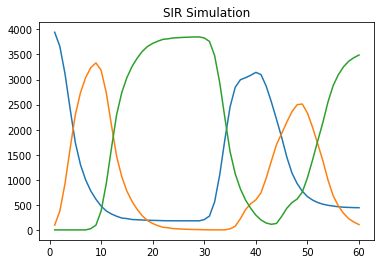

Giorno 60 :
Suscettibili: 443
Infetti: 106
Guariti: 3490
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             309 |
|      2 |   1684 |             235 |
|      3 |   3437 |             190 |
|      4 |   1912 |             171 |
|      5 |      0 |             145 |
|      6 |    348 |              84 |
|      7 |    414 |              49 |
|      8 |   3980 |              40 |
|      9 |   1718 |              27 |
|     10 |    563 |              27 |
|     11 |   3830 |              25 |
|     12 |   2007 |              24 |
|     13 |    686 |              24 |
|     14 |   1577 |              21 |
|     15 |    428 |              20 |
+--------+--------+-----------------+


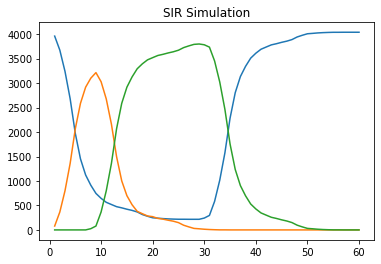

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             147 |
|      2 |   3437 |             124 |
|      3 |   1684 |             110 |
|      4 |   1912 |              99 |
|      5 |      0 |              75 |
|      6 |    483 |              28 |
|      7 |    686 |              26 |
|      8 |    414 |              26 |
|      9 |   2543 |              22 |
|     10 |   1945 |              20 |
|     11 |    698 |              20 |
|     12 |    348 |              19 |
|     13 |   1273 |              18 |
|     14 |   2190 |              18 |
|     15 |   2143 |              15 |
+--------+--------+-----------------+


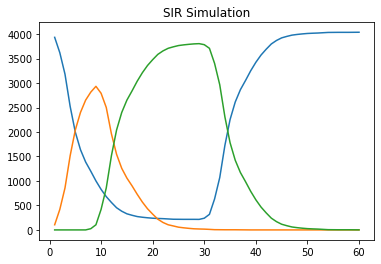

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             130 |
|      2 |   3437 |             115 |
|      3 |    107 |              92 |
|      4 |      0 |              71 |
|      5 |   1912 |              61 |
|      6 |    686 |              45 |
|      7 |   2543 |              31 |
|      8 |   2347 |              26 |
|      9 |    483 |              25 |
|     10 |    348 |              21 |
|     11 |    414 |              20 |
|     12 |    917 |              18 |
|     13 |   1376 |              16 |
|     14 |   1078 |              16 |
|     15 |   3980 |              14 |
+--------+--------+-----------------+


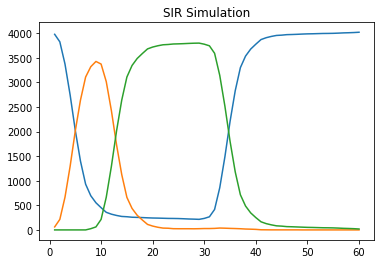

Giorno 60 :
Suscettibili: 4020
Infetti: 0
Guariti: 19
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             144 |
|      2 |    107 |             141 |
|      3 |   1684 |             130 |
|      4 |   1912 |              92 |
|      5 |      0 |              73 |
|      6 |    348 |              43 |
|      7 |    686 |              31 |
|      8 |    414 |              22 |
|      9 |   3980 |              19 |
|     10 |   2047 |              18 |
|     11 |   1399 |              18 |
|     12 |   2748 |              15 |
|     13 |   2289 |              15 |
|     14 |    698 |              14 |
|     15 |   1768 |              14 |
+--------+--------+-----------------+


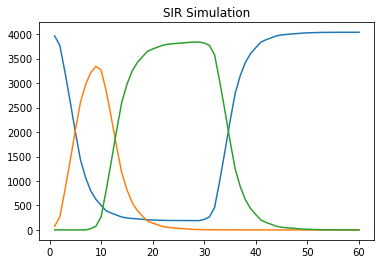

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             151 |
|      2 |   3437 |             116 |
|      3 |   1684 |             109 |
|      4 |      0 |              79 |
|      5 |   1912 |              47 |
|      6 |    348 |              41 |
|      7 |    686 |              39 |
|      8 |    414 |              24 |
|      9 |   1086 |              21 |
|     10 |   1984 |              16 |
|     11 |   2472 |              16 |
|     12 |   1345 |              15 |
|     13 |   1204 |              15 |
|     14 |    500 |              15 |
|     15 |   1964 |              15 |
+--------+--------+-----------------+


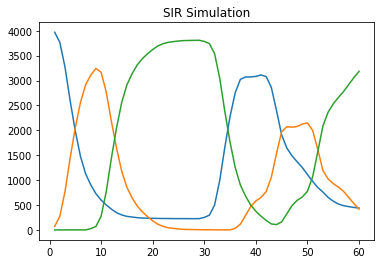

Giorno 60 :
Suscettibili: 440
Infetti: 416
Guariti: 3183
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             330 |
|      2 |   1684 |             234 |
|      3 |   3437 |             213 |
|      4 |   1912 |             194 |
|      5 |      0 |             147 |
|      6 |    348 |              61 |
|      7 |    414 |              49 |
|      8 |   1577 |              42 |
|      9 |    686 |              30 |
|     10 |   3980 |              28 |
|     11 |    483 |              28 |
|     12 |    563 |              24 |
|     13 |   1800 |              24 |
|     14 |    917 |              23 |
|     15 |   1085 |              21 |
+--------+--------+-----------------+


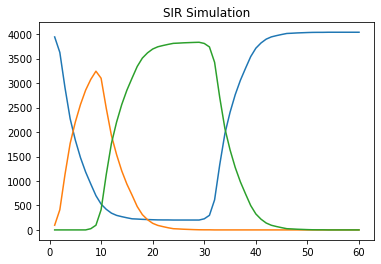

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3437 |             117 |
|      2 |   1684 |             114 |
|      3 |    107 |             106 |
|      4 |      0 |              77 |
|      5 |   1912 |              62 |
|      6 |    686 |              38 |
|      7 |    348 |              27 |
|      8 |   1554 |              20 |
|      9 |    414 |              19 |
|     10 |   2839 |              18 |
|     11 |   1577 |              17 |
|     12 |   1352 |              17 |
|     13 |    376 |              15 |
|     14 |   2040 |              15 |
|     15 |   1231 |              15 |
+--------+--------+-----------------+


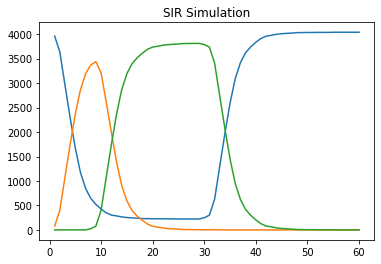

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             162 |
|      2 |   3437 |             121 |
|      3 |   1684 |             107 |
|      4 |      0 |              81 |
|      5 |   1912 |              63 |
|      6 |    348 |              37 |
|      7 |    686 |              31 |
|      8 |   1917 |              22 |
|      9 |   2266 |              21 |
|     10 |   1126 |              21 |
|     11 |   1256 |              17 |
|     12 |   2102 |              17 |
|     13 |    414 |              16 |
|     14 |   3980 |              15 |
|     15 |    376 |              15 |
+--------+--------+-----------------+


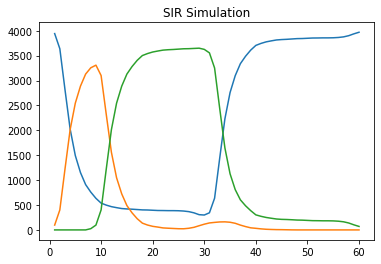

Giorno 60 :
Suscettibili: 3969
Infetti: 0
Guariti: 70
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             149 |
|      2 |   3437 |             129 |
|      3 |   1684 |              98 |
|      4 |   1912 |              79 |
|      5 |      0 |              75 |
|      6 |    348 |              35 |
|      7 |    414 |              29 |
|      8 |   1465 |              23 |
|      9 |    946 |              22 |
|     10 |    686 |              22 |
|     11 |   3980 |              20 |
|     12 |    698 |              18 |
|     13 |   1420 |              18 |
|     14 |   2960 |              17 |
|     15 |    483 |              16 |
+--------+--------+-----------------+


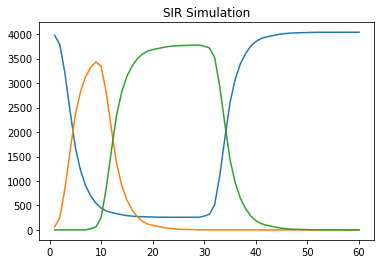

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             148 |
|      2 |    107 |             101 |
|      3 |   3437 |              92 |
|      4 |   1912 |              85 |
|      5 |      0 |              76 |
|      6 |    348 |              29 |
|      7 |    686 |              22 |
|      8 |    637 |              20 |
|      9 |   2347 |              20 |
|     10 |    966 |              19 |
|     11 |    414 |              18 |
|     12 |   1953 |              18 |
|     13 |   1367 |              15 |
|     14 |    517 |              14 |
|     15 |   1810 |              14 |
+--------+--------+-----------------+


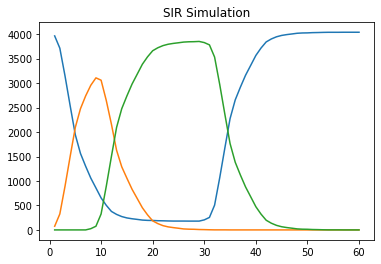

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             159 |
|      2 |   3437 |             133 |
|      3 |   1684 |             122 |
|      4 |   1912 |             110 |
|      5 |      0 |              80 |
|      6 |    348 |              41 |
|      7 |   3980 |              29 |
|      8 |    414 |              20 |
|      9 |    686 |              19 |
|     10 |    713 |              17 |
|     11 |   2786 |              16 |
|     12 |    483 |              16 |
|     13 |     26 |              15 |
|     14 |   1277 |              15 |
|     15 |    428 |              15 |
+--------+--------+-----------------+


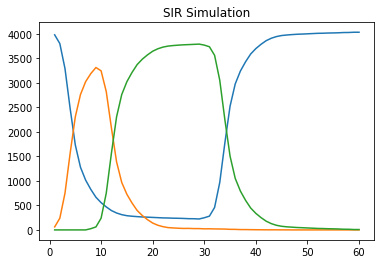

Giorno 60 :
Suscettibili: 4031
Infetti: 0
Guariti: 8
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             159 |
|      2 |   1684 |             141 |
|      3 |   3437 |              85 |
|      4 |   1912 |              84 |
|      5 |      0 |              76 |
|      6 |    348 |              36 |
|      7 |    483 |              24 |
|      8 |   3545 |              18 |
|      9 |    686 |              18 |
|     10 |   1584 |              17 |
|     11 |   2292 |              16 |
|     12 |    526 |              15 |
|     13 |   3980 |              15 |
|     14 |   2611 |              14 |
|     15 |   1473 |              14 |
+--------+--------+-----------------+


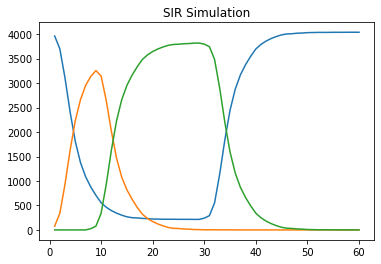

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             152 |
|      2 |   1684 |             139 |
|      3 |   3437 |             124 |
|      4 |   1912 |              87 |
|      5 |      0 |              74 |
|      6 |    348 |              35 |
|      7 |    686 |              24 |
|      8 |    925 |              18 |
|      9 |    414 |              17 |
|     10 |   2083 |              16 |
|     11 |   3033 |              16 |
|     12 |   3980 |              16 |
|     13 |   1989 |              15 |
|     14 |   1472 |              15 |
|     15 |    563 |              14 |
+--------+--------+-----------------+


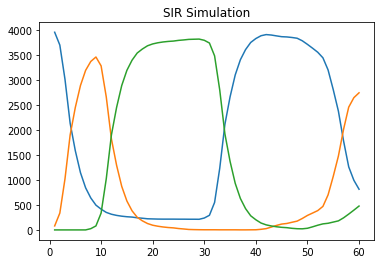

Giorno 60 :
Suscettibili: 815
Infetti: 2746
Guariti: 478
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             296 |
|      2 |   1684 |             271 |
|      3 |   1912 |             237 |
|      4 |   3437 |             225 |
|      5 |      0 |              98 |
|      6 |    348 |              76 |
|      7 |    686 |              66 |
|      8 |   1577 |              33 |
|      9 |    483 |              31 |
|     10 |    414 |              30 |
|     11 |   1800 |              25 |
|     12 |   2543 |              23 |
|     13 |   1718 |              22 |
|     14 |    412 |              22 |
|     15 |   3980 |              21 |
+--------+--------+-----------------+


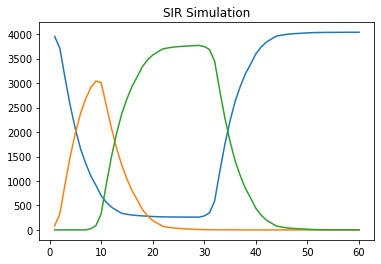

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1684 |             131 |
|      2 |    107 |             121 |
|      3 |   3437 |              95 |
|      4 |      0 |              73 |
|      5 |   1912 |              63 |
|      6 |    348 |              26 |
|      7 |    686 |              21 |
|      8 |   1971 |              20 |
|      9 |   1941 |              19 |
|     10 |    414 |              19 |
|     11 |   2199 |              17 |
|     12 |   1714 |              17 |
|     13 |   3049 |              17 |
|     14 |   2133 |              16 |
|     15 |   1101 |              15 |
+--------+--------+-----------------+


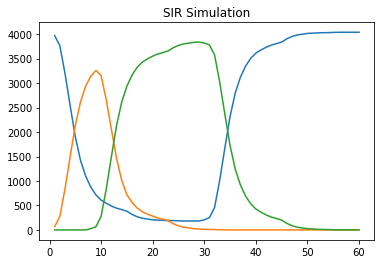

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             150 |
|      2 |   1684 |             143 |
|      3 |   3437 |             123 |
|      4 |   1912 |             102 |
|      5 |      0 |              78 |
|      6 |    348 |              34 |
|      7 |    686 |              30 |
|      8 |    414 |              25 |
|      9 |   1199 |              22 |
|     10 |   2543 |              20 |
|     11 |    698 |              19 |
|     12 |   1172 |              17 |
|     13 |   2313 |              17 |
|     14 |    200 |              15 |
|     15 |   2059 |              15 |
+--------+--------+-----------------+


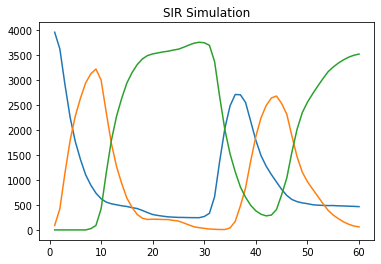

Giorno 60 :
Suscettibili: 465
Infetti: 60
Guariti: 3514
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             292 |
|      2 |   1684 |             244 |
|      3 |   3437 |             205 |
|      4 |   1912 |             203 |
|      5 |      0 |             148 |
|      6 |    348 |              62 |
|      7 |    414 |              45 |
|      8 |    483 |              37 |
|      9 |   3101 |              29 |
|     10 |    686 |              28 |
|     11 |   1663 |              25 |
|     12 |    526 |              23 |
|     13 |   2266 |              22 |
|     14 |    698 |              21 |
|     15 |   1986 |              21 |
+--------+--------+-----------------+


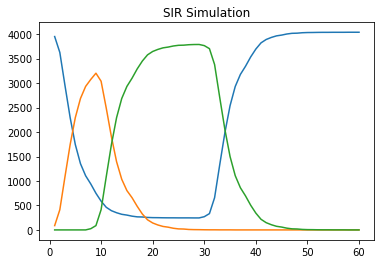

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             148 |
|      2 |   3437 |             111 |
|      3 |   1684 |             110 |
|      4 |      0 |              80 |
|      5 |   1912 |              49 |
|      6 |    348 |              32 |
|      7 |    686 |              31 |
|      8 |   2187 |              23 |
|      9 |    483 |              19 |
|     10 |    414 |              19 |
|     11 |   2266 |              17 |
|     12 |    698 |              16 |
|     13 |   2511 |              15 |
|     14 |   2308 |              14 |
|     15 |   2060 |              14 |
+--------+--------+-----------------+


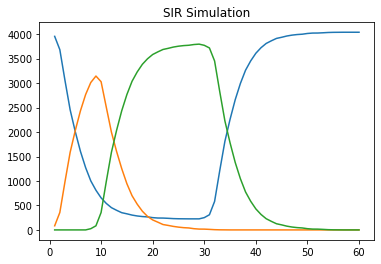

Giorno 60 :
Suscettibili: 4039
Infetti: 0
Guariti: 0
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             123 |
|      2 |   1684 |             119 |
|      3 |   3437 |             116 |
|      4 |   1912 |             101 |
|      5 |      0 |              71 |
|      6 |   1078 |              24 |
|      7 |    428 |              21 |
|      8 |    686 |              20 |
|      9 |   1948 |              18 |
|     10 |    348 |              18 |
|     11 |   1793 |              17 |
|     12 |    563 |              17 |
|     13 |    414 |              16 |
|     14 |   3321 |              15 |
|     15 |   1946 |              15 |
+--------+--------+-----------------+


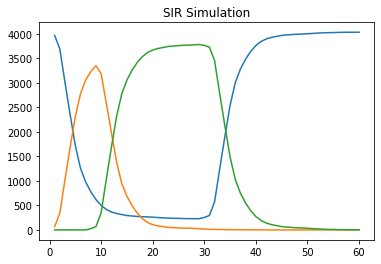

Giorno 60 :
Suscettibili: 4036
Infetti: 0
Guariti: 3
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             208 |
|      2 |   1684 |             146 |
|      3 |   3437 |             103 |
|      4 |      0 |              80 |
|      5 |   1912 |              71 |
|      6 |    348 |              41 |
|      7 |   2347 |              37 |
|      8 |    686 |              31 |
|      9 |    483 |              18 |
|     10 |   3980 |              16 |
|     11 |   1124 |              15 |
|     12 |   3327 |              14 |
|     13 |   1172 |              14 |
|     14 |   1589 |              14 |
|     15 |    925 |              12 |
+--------+--------+-----------------+


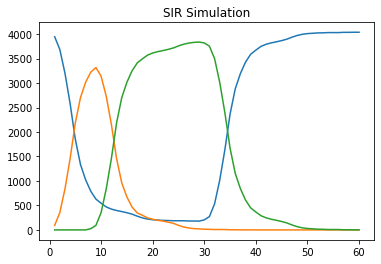

Giorno 60 :
Suscettibili: 4038
Infetti: 0
Guariti: 1
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |    107 |             156 |
|      2 |   3437 |             117 |
|      3 |   1684 |              94 |
|      4 |      0 |              79 |
|      5 |   1912 |              78 |
|      6 |    414 |              27 |
|      7 |    483 |              26 |
|      8 |    348 |              23 |
|      9 |   3830 |              21 |
|     10 |   2468 |              20 |
|     11 |   2543 |              19 |
|     12 |    686 |              19 |
|     13 |   2716 |              17 |
|     14 |    637 |              14 |
|     15 |    553 |              14 |
+--------+--------+-----------------+
+--------+--------+-------------+
|   RANK |   NODE |   FREQUENCY |
|--------+--------+-------------|
|      1 |      0 |         300 |
|      2 |   3437 |         300 |
|      3 |   1912 |         300 |
|      4 |   1684 |  

In [10]:
#input parametri simulazione:p_trans, t_rec, t_sus, t_sim, num_sim
random_simulation(25, 'facebook_combined.csv', ' ', 0.05, 7, 21, 60, 300)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: In a future version of pandas all arguments of read_csv except for the argument 'filepath_or_buffer' will be keyword-only
  if __name__ == '__main__':


Nodi Tot. Grafo:6960
Nodi Infetti Iniziali:25
:[1162, 47, 7119, 39, 7046, 532, 1582, 4509, 5754, 2388, 531, 623, 6084, 3041, 4316, 5834, 2873, 1389, 6653, 7058, 6473, 6188, 2621, 5634, 1270]
Nodi Tot. Grafo:6960
Nodi Infetti Iniziali:25
:[466, 5648, 4337, 539, 5016, 3368, 6903, 5774, 931, 437, 2157, 586, 4969, 5992, 6142, 2436, 3764, 5643, 2862, 6384, 5235, 3687, 3878, 3320, 5961]
Nodi Tot. Grafo:6960
Nodi Infetti Iniziali:25
:[3997, 5416, 683, 2724, 3509, 6838, 229, 5499, 1485, 5062, 2112, 1391, 4511, 4465, 2479, 3657, 4831, 2080, 2745, 4539, 3623, 3790, 3040, 5601, 4680]
Nodi Tot. Grafo:6960
Nodi Infetti Iniziali:25
:[6299, 4076, 2894, 451, 1011, 2215, 402, 513, 5096, 2209, 903, 1888, 955, 2938, 2703, 1353, 6175, 1929, 6603, 2095, 4731, 3292, 2660, 4749, 5737]
Nodi Tot. Grafo:6960
Nodi Infetti Iniziali:25
:[1376, 5122, 301, 3178, 1529, 2713, 1941, 4813, 2606, 1527, 1013, 2977, 696, 2525, 1153, 2735, 2082, 6471, 6496, 6543, 3727, 6065, 3014, 4496, 6476]
Nodi Tot. Grafo:6960
Nodi Infet

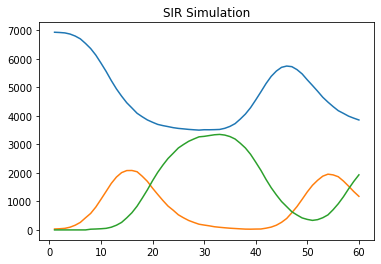

Giorno 60 :
Suscettibili: 3853
Infetti: 1177
Guariti: 1930
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             175 |
|      2 |   4949 |             138 |
|      3 |   3401 |              89 |
|      4 |    166 |              85 |
|      5 |   5842 |              79 |
|      6 |   6136 |              76 |
|      7 |   1924 |              68 |
|      8 |    581 |              65 |
|      9 |   2447 |              65 |
|     10 |   2481 |              56 |
|     11 |   2732 |              55 |
|     12 |   1598 |              48 |
|     13 |   3706 |              45 |
|     14 |   1103 |              44 |
|     15 |    675 |              39 |
+--------+--------+-----------------+


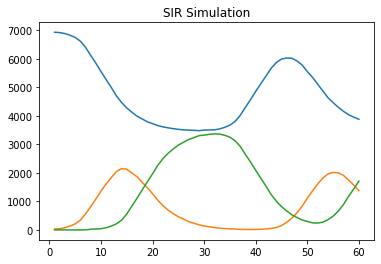

Giorno 60 :
Suscettibili: 3877
Infetti: 1373
Guariti: 1710
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             197 |
|      2 |   1773 |             154 |
|      3 |   3401 |             105 |
|      4 |    166 |              91 |
|      5 |   6136 |              78 |
|      6 |   2732 |              71 |
|      7 |   1924 |              66 |
|      8 |   5842 |              66 |
|      9 |    581 |              65 |
|     10 |   1103 |              55 |
|     11 |   3706 |              53 |
|     12 |     93 |              47 |
|     13 |   2447 |              46 |
|     14 |   4196 |              45 |
|     15 |   5269 |              39 |
+--------+--------+-----------------+


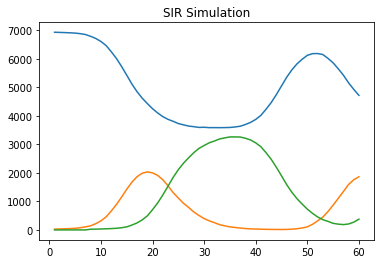

Giorno 60 :
Suscettibili: 4720
Infetti: 1864
Guariti: 376
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             185 |
|      2 |   1773 |             176 |
|      3 |   3401 |             112 |
|      4 |    166 |              92 |
|      5 |   6136 |              81 |
|      6 |   1924 |              60 |
|      7 |    581 |              58 |
|      8 |   2447 |              52 |
|      9 |   1103 |              44 |
|     10 |   5842 |              44 |
|     11 |   4016 |              40 |
|     12 |   3285 |              40 |
|     13 |   2481 |              39 |
|     14 |   4196 |              36 |
|     15 |     93 |              36 |
+--------+--------+-----------------+


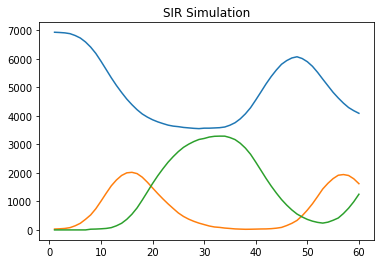

Giorno 60 :
Suscettibili: 4088
Infetti: 1621
Guariti: 1251
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             165 |
|      2 |   4949 |             143 |
|      3 |    166 |              92 |
|      4 |   3401 |              92 |
|      5 |   6136 |              75 |
|      6 |   5842 |              67 |
|      7 |   1924 |              57 |
|      8 |   2732 |              56 |
|      9 |   1103 |              49 |
|     10 |   4196 |              46 |
|     11 |    581 |              46 |
|     12 |   3285 |              45 |
|     13 |   4016 |              43 |
|     14 |   2447 |              40 |
|     15 |   2481 |              38 |
+--------+--------+-----------------+


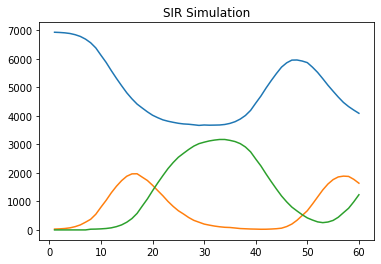

Giorno 60 :
Suscettibili: 4089
Infetti: 1638
Guariti: 1233
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             169 |
|      2 |   4949 |             163 |
|      3 |   3401 |             110 |
|      4 |   6136 |              83 |
|      5 |    581 |              80 |
|      6 |   5842 |              79 |
|      7 |   1924 |              72 |
|      8 |    166 |              60 |
|      9 |   1103 |              56 |
|     10 |   4016 |              50 |
|     11 |   4406 |              40 |
|     12 |   2447 |              40 |
|     13 |   3706 |              39 |
|     14 |   2481 |              39 |
|     15 |   2732 |              38 |
+--------+--------+-----------------+


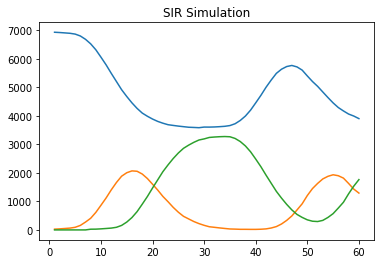

Giorno 60 :
Suscettibili: 3904
Infetti: 1292
Guariti: 1764
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             202 |
|      2 |   4949 |             171 |
|      3 |   3401 |              95 |
|      4 |   6136 |              80 |
|      5 |   5842 |              80 |
|      6 |   1924 |              64 |
|      7 |    166 |              63 |
|      8 |   2447 |              58 |
|      9 |   1103 |              53 |
|     10 |    581 |              52 |
|     11 |   2732 |              49 |
|     12 |   4196 |              48 |
|     13 |   4016 |              42 |
|     14 |   4406 |              41 |
|     15 |   2481 |              40 |
+--------+--------+-----------------+


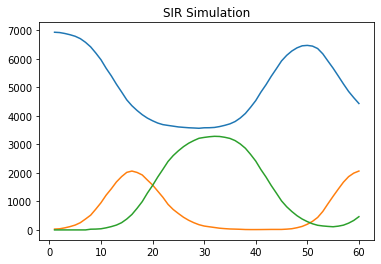

Giorno 60 :
Suscettibili: 4432
Infetti: 2064
Guariti: 464
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             182 |
|      2 |   1773 |             160 |
|      3 |   3401 |              98 |
|      4 |   6136 |              83 |
|      5 |    166 |              76 |
|      6 |   1924 |              63 |
|      7 |   5842 |              58 |
|      8 |   4196 |              53 |
|      9 |   1103 |              53 |
|     10 |    581 |              52 |
|     11 |   2732 |              51 |
|     12 |   3706 |              49 |
|     13 |   4016 |              49 |
|     14 |   2447 |              43 |
|     15 |   3285 |              40 |
+--------+--------+-----------------+


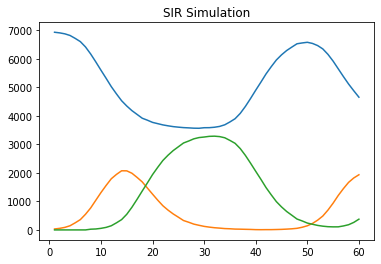

Giorno 60 :
Suscettibili: 4651
Infetti: 1933
Guariti: 376
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             184 |
|      2 |   4949 |             171 |
|      3 |   3401 |              94 |
|      4 |   5842 |              92 |
|      5 |    166 |              79 |
|      6 |   6136 |              76 |
|      7 |   2447 |              58 |
|      8 |   1103 |              45 |
|      9 |    581 |              45 |
|     10 |   3706 |              42 |
|     11 |   2732 |              42 |
|     12 |   2481 |              41 |
|     13 |   1924 |              37 |
|     14 |   1598 |              33 |
|     15 |   4016 |              31 |
+--------+--------+-----------------+


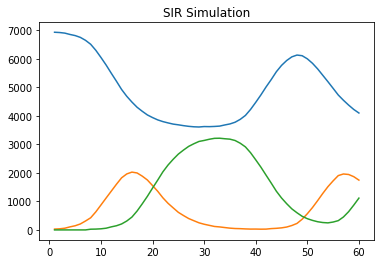

Giorno 60 :
Suscettibili: 4099
Infetti: 1746
Guariti: 1115
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             175 |
|      2 |   1773 |             149 |
|      3 |   3401 |             112 |
|      4 |   6136 |              79 |
|      5 |   1924 |              72 |
|      6 |    581 |              64 |
|      7 |   5842 |              59 |
|      8 |   2447 |              59 |
|      9 |    166 |              58 |
|     10 |   2732 |              57 |
|     11 |   4016 |              52 |
|     12 |   2481 |              44 |
|     13 |   3285 |              41 |
|     14 |   4406 |              39 |
|     15 |   1103 |              37 |
+--------+--------+-----------------+


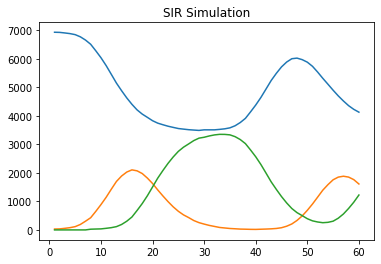

Giorno 60 :
Suscettibili: 4127
Infetti: 1610
Guariti: 1223
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             194 |
|      2 |   1773 |             180 |
|      3 |   3401 |             118 |
|      4 |   6136 |              86 |
|      5 |    166 |              68 |
|      6 |   2732 |              68 |
|      7 |    581 |              67 |
|      8 |   5842 |              59 |
|      9 |   1103 |              58 |
|     10 |   1924 |              56 |
|     11 |   2447 |              42 |
|     12 |   1598 |              42 |
|     13 |   4196 |              42 |
|     14 |     93 |              40 |
|     15 |   4406 |              40 |
+--------+--------+-----------------+


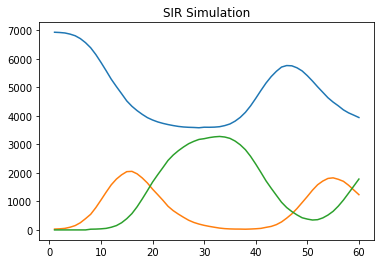

Giorno 60 :
Suscettibili: 3941
Infetti: 1236
Guariti: 1783
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             160 |
|      2 |   4949 |             157 |
|      3 |   3401 |             116 |
|      4 |   6136 |             100 |
|      5 |    166 |              75 |
|      6 |   1924 |              75 |
|      7 |   2732 |              72 |
|      8 |   5842 |              71 |
|      9 |    581 |              58 |
|     10 |   2447 |              50 |
|     11 |   1103 |              48 |
|     12 |   4406 |              43 |
|     13 |   4016 |              37 |
|     14 |   3706 |              37 |
|     15 |   4196 |              35 |
+--------+--------+-----------------+


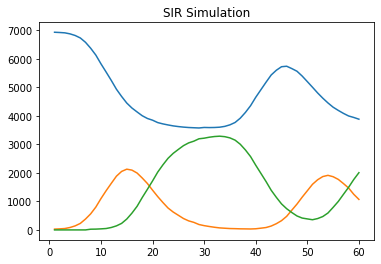

Giorno 60 :
Suscettibili: 3883
Infetti: 1070
Guariti: 2007
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             160 |
|      2 |   4949 |             147 |
|      3 |   3401 |             103 |
|      4 |   6136 |              84 |
|      5 |    166 |              84 |
|      6 |   2447 |              78 |
|      7 |    581 |              67 |
|      8 |   5842 |              65 |
|      9 |   3285 |              54 |
|     10 |   3706 |              53 |
|     11 |   1103 |              48 |
|     12 |   2732 |              44 |
|     13 |   1924 |              42 |
|     14 |   4406 |              41 |
|     15 |   4196 |              40 |
+--------+--------+-----------------+


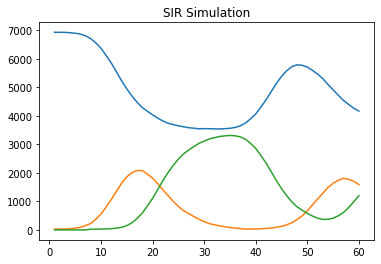

Giorno 60 :
Suscettibili: 4166
Infetti: 1590
Guariti: 1204
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             176 |
|      2 |   1773 |             171 |
|      3 |   3401 |              97 |
|      4 |   6136 |              85 |
|      5 |    166 |              70 |
|      6 |   2447 |              67 |
|      7 |   1924 |              62 |
|      8 |   5842 |              62 |
|      9 |   4196 |              51 |
|     10 |   2732 |              50 |
|     11 |   1103 |              49 |
|     12 |    581 |              49 |
|     13 |   3706 |              46 |
|     14 |   3285 |              42 |
|     15 |   4016 |              40 |
+--------+--------+-----------------+


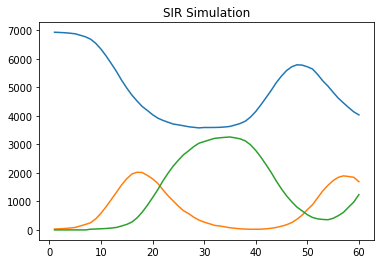

Giorno 60 :
Suscettibili: 4031
Infetti: 1692
Guariti: 1237
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             151 |
|      2 |   4949 |             138 |
|      3 |   3401 |              96 |
|      4 |   6136 |              83 |
|      5 |    166 |              76 |
|      6 |    581 |              69 |
|      7 |   5842 |              67 |
|      8 |   2447 |              63 |
|      9 |   2732 |              60 |
|     10 |   1924 |              60 |
|     11 |   1103 |              54 |
|     12 |   3706 |              51 |
|     13 |   4406 |              44 |
|     14 |   3285 |              44 |
|     15 |   4016 |              38 |
+--------+--------+-----------------+


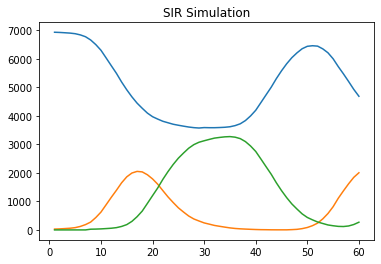

Giorno 60 :
Suscettibili: 4686
Infetti: 2004
Guariti: 270
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             178 |
|      2 |   4949 |             141 |
|      3 |   3401 |              95 |
|      4 |    166 |              89 |
|      5 |   5842 |              69 |
|      6 |   1103 |              68 |
|      7 |   6136 |              67 |
|      8 |    581 |              62 |
|      9 |   1924 |              57 |
|     10 |   2447 |              54 |
|     11 |   2732 |              51 |
|     12 |   3706 |              48 |
|     13 |   4196 |              46 |
|     14 |   4016 |              44 |
|     15 |   3285 |              39 |
+--------+--------+-----------------+


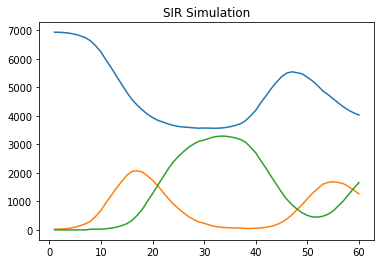

Giorno 60 :
Suscettibili: 4031
Infetti: 1267
Guariti: 1662
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             152 |
|      2 |   4949 |             143 |
|      3 |   3401 |              94 |
|      4 |   5842 |              75 |
|      5 |    166 |              69 |
|      6 |    581 |              65 |
|      7 |   1924 |              61 |
|      8 |   2447 |              60 |
|      9 |   6136 |              59 |
|     10 |   1103 |              56 |
|     11 |   3706 |              45 |
|     12 |   2481 |              40 |
|     13 |   2732 |              39 |
|     14 |   5945 |              38 |
|     15 |   4406 |              37 |
+--------+--------+-----------------+


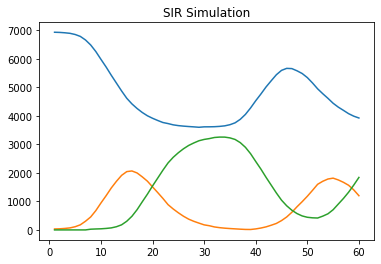

Giorno 60 :
Suscettibili: 3922
Infetti: 1199
Guariti: 1839
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             182 |
|      2 |   4949 |             151 |
|      3 |   3401 |             107 |
|      4 |   6136 |              92 |
|      5 |   1924 |              80 |
|      6 |    166 |              75 |
|      7 |    581 |              67 |
|      8 |   1103 |              62 |
|      9 |   5842 |              61 |
|     10 |   2732 |              55 |
|     11 |   4196 |              48 |
|     12 |   2447 |              46 |
|     13 |   3706 |              42 |
|     14 |   4406 |              41 |
|     15 |   2481 |              40 |
+--------+--------+-----------------+


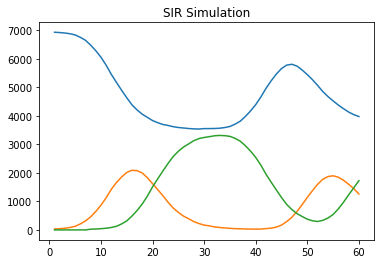

Giorno 60 :
Suscettibili: 3974
Infetti: 1259
Guariti: 1727
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             186 |
|      2 |   4949 |             134 |
|      3 |   3401 |             131 |
|      4 |   6136 |              88 |
|      5 |    166 |              84 |
|      6 |   5842 |              68 |
|      7 |   1103 |              57 |
|      8 |   1924 |              56 |
|      9 |   2732 |              52 |
|     10 |   2447 |              52 |
|     11 |    581 |              48 |
|     12 |   3706 |              48 |
|     13 |   3285 |              46 |
|     14 |   4016 |              45 |
|     15 |   1598 |              42 |
+--------+--------+-----------------+


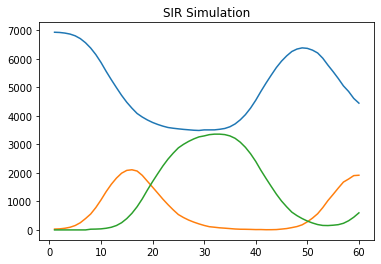

Giorno 60 :
Suscettibili: 4445
Infetti: 1917
Guariti: 598
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             174 |
|      2 |   1773 |             164 |
|      3 |   3401 |             122 |
|      4 |   6136 |             105 |
|      5 |    166 |              77 |
|      6 |   1924 |              68 |
|      7 |   5842 |              62 |
|      8 |    581 |              56 |
|      9 |   2732 |              55 |
|     10 |   1103 |              55 |
|     11 |   4196 |              51 |
|     12 |   4016 |              46 |
|     13 |   2447 |              43 |
|     14 |   2481 |              43 |
|     15 |   5269 |              38 |
+--------+--------+-----------------+


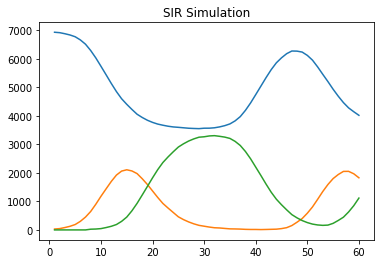

Giorno 60 :
Suscettibili: 4017
Infetti: 1827
Guariti: 1116
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             188 |
|      2 |   4949 |             184 |
|      3 |   6136 |              91 |
|      4 |   3401 |              90 |
|      5 |    166 |              87 |
|      6 |   5842 |              68 |
|      7 |    581 |              65 |
|      8 |   1924 |              64 |
|      9 |   2732 |              58 |
|     10 |   2447 |              53 |
|     11 |   3706 |              44 |
|     12 |   1103 |              42 |
|     13 |   2481 |              42 |
|     14 |   4016 |              40 |
|     15 |   3285 |              40 |
+--------+--------+-----------------+


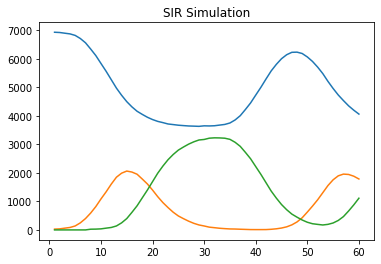

Giorno 60 :
Suscettibili: 4062
Infetti: 1786
Guariti: 1112
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             174 |
|      2 |   4949 |             167 |
|      3 |   3401 |             137 |
|      4 |    166 |              85 |
|      5 |   6136 |              75 |
|      6 |   5842 |              72 |
|      7 |   2732 |              58 |
|      8 |   1924 |              57 |
|      9 |   4016 |              53 |
|     10 |   1103 |              49 |
|     11 |   4406 |              47 |
|     12 |    581 |              45 |
|     13 |   4196 |              44 |
|     14 |   1598 |              43 |
|     15 |   2481 |              43 |
+--------+--------+-----------------+


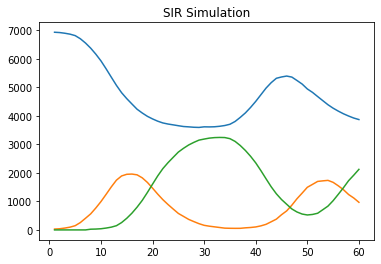

Giorno 60 :
Suscettibili: 3869
Infetti: 968
Guariti: 2123
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             178 |
|      2 |   4949 |             155 |
|      3 |   3401 |              92 |
|      4 |   6136 |              75 |
|      5 |    166 |              63 |
|      6 |   1103 |              59 |
|      7 |    581 |              56 |
|      8 |   1924 |              48 |
|      9 |   4016 |              47 |
|     10 |   5842 |              47 |
|     11 |   2447 |              45 |
|     12 |   2732 |              43 |
|     13 |   4406 |              42 |
|     14 |   1598 |              40 |
|     15 |   4196 |              38 |
+--------+--------+-----------------+


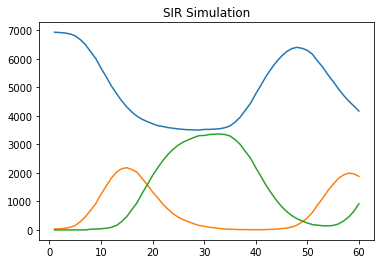

Giorno 60 :
Suscettibili: 4169
Infetti: 1876
Guariti: 915
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             190 |
|      2 |   1773 |             171 |
|      3 |   3401 |             102 |
|      4 |   2732 |              69 |
|      5 |   1103 |              69 |
|      6 |   6136 |              64 |
|      7 |   5842 |              64 |
|      8 |   1924 |              57 |
|      9 |   2447 |              56 |
|     10 |    581 |              52 |
|     11 |    166 |              51 |
|     12 |   4016 |              46 |
|     13 |   4196 |              44 |
|     14 |   3706 |              42 |
|     15 |   2466 |              40 |
+--------+--------+-----------------+


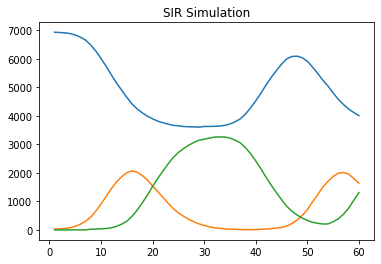

Giorno 60 :
Suscettibili: 4009
Infetti: 1640
Guariti: 1311
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             156 |
|      2 |   4949 |             150 |
|      3 |   3401 |             111 |
|      4 |    166 |              87 |
|      5 |   1924 |              76 |
|      6 |   6136 |              76 |
|      7 |   2732 |              75 |
|      8 |   5842 |              74 |
|      9 |   2447 |              59 |
|     10 |    581 |              57 |
|     11 |   1103 |              54 |
|     12 |   4406 |              49 |
|     13 |   3706 |              47 |
|     14 |   2481 |              43 |
|     15 |   2345 |              40 |
+--------+--------+-----------------+


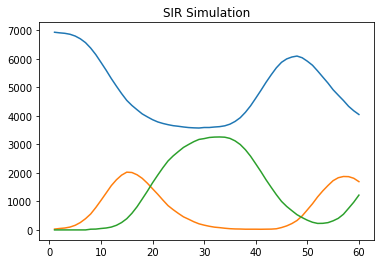

Giorno 60 :
Suscettibili: 4047
Infetti: 1693
Guariti: 1220
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             177 |
|      2 |   1773 |             175 |
|      3 |   3401 |              97 |
|      4 |   6136 |              86 |
|      5 |   1924 |              71 |
|      6 |    581 |              71 |
|      7 |   2732 |              70 |
|      8 |    166 |              62 |
|      9 |   2481 |              55 |
|     10 |   2447 |              52 |
|     11 |   5842 |              50 |
|     12 |   1103 |              47 |
|     13 |   3706 |              43 |
|     14 |   4016 |              43 |
|     15 |   4406 |              42 |
+--------+--------+-----------------+


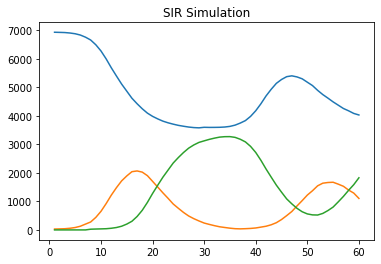

Giorno 60 :
Suscettibili: 4029
Infetti: 1104
Guariti: 1827
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             162 |
|      2 |   1773 |             124 |
|      3 |   3401 |             114 |
|      4 |    166 |              76 |
|      5 |    581 |              75 |
|      6 |   6136 |              68 |
|      7 |   5842 |              63 |
|      8 |   1924 |              60 |
|      9 |   2732 |              51 |
|     10 |   2447 |              45 |
|     11 |    792 |              45 |
|     12 |   3706 |              44 |
|     13 |   1598 |              42 |
|     14 |   4016 |              41 |
|     15 |   3285 |              40 |
+--------+--------+-----------------+


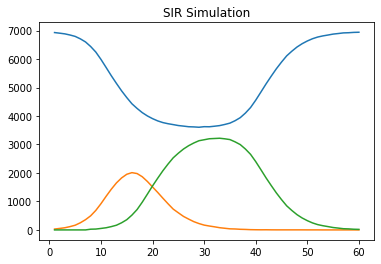

Giorno 60 :
Suscettibili: 6941
Infetti: 0
Guariti: 19
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |              92 |
|      2 |   4949 |              86 |
|      3 |   3401 |              54 |
|      4 |   5842 |              37 |
|      5 |   2447 |              34 |
|      6 |   1924 |              31 |
|      7 |   6136 |              31 |
|      8 |    166 |              27 |
|      9 |   5269 |              26 |
|     10 |   2732 |              24 |
|     11 |   3706 |              24 |
|     12 |   3285 |              22 |
|     13 |    675 |              22 |
|     14 |   1883 |              22 |
|     15 |   1103 |              22 |
+--------+--------+-----------------+


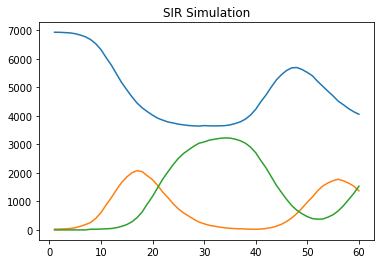

Giorno 60 :
Suscettibili: 4057
Infetti: 1369
Guariti: 1534
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             161 |
|      2 |   4949 |             144 |
|      3 |   3401 |             114 |
|      4 |   6136 |              91 |
|      5 |   5842 |              83 |
|      6 |    166 |              66 |
|      7 |   2732 |              56 |
|      8 |   1924 |              54 |
|      9 |   2447 |              52 |
|     10 |   1103 |              51 |
|     11 |   4196 |              46 |
|     12 |    581 |              46 |
|     13 |   3285 |              43 |
|     14 |   4406 |              42 |
|     15 |   2481 |              42 |
+--------+--------+-----------------+


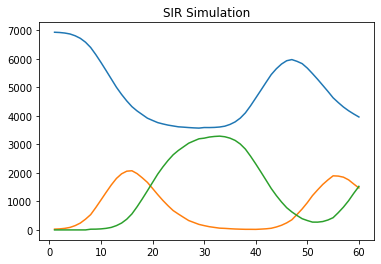

Giorno 60 :
Suscettibili: 3961
Infetti: 1472
Guariti: 1527
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             174 |
|      2 |   4949 |             150 |
|      3 |   3401 |             107 |
|      4 |   6136 |              91 |
|      5 |    166 |              88 |
|      6 |   1103 |              72 |
|      7 |   5842 |              71 |
|      8 |   1924 |              70 |
|      9 |    581 |              54 |
|     10 |   4016 |              46 |
|     11 |   2447 |              42 |
|     12 |   2732 |              42 |
|     13 |   2345 |              40 |
|     14 |   3706 |              38 |
|     15 |   4406 |              36 |
+--------+--------+-----------------+


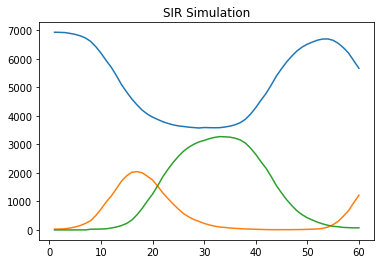

Giorno 60 :
Suscettibili: 5668
Infetti: 1218
Guariti: 74
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             166 |
|      2 |   4949 |             141 |
|      3 |   3401 |              94 |
|      4 |    166 |              64 |
|      5 |    581 |              62 |
|      6 |   6136 |              55 |
|      7 |   4016 |              46 |
|      8 |   4406 |              40 |
|      9 |   5842 |              40 |
|     10 |   1598 |              40 |
|     11 |   4196 |              39 |
|     12 |   1924 |              38 |
|     13 |   2447 |              38 |
|     14 |   1103 |              37 |
|     15 |   3285 |              36 |
+--------+--------+-----------------+


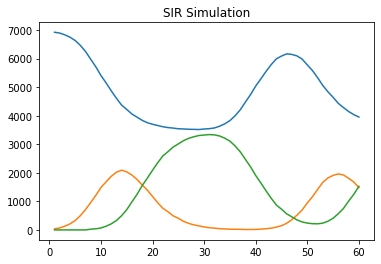

Giorno 60 :
Suscettibili: 3952
Infetti: 1482
Guariti: 1526
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             206 |
|      2 |   4949 |             187 |
|      3 |   3401 |             122 |
|      4 |   6136 |              99 |
|      5 |   5842 |              73 |
|      6 |   2732 |              62 |
|      7 |   1924 |              60 |
|      8 |    581 |              58 |
|      9 |    166 |              58 |
|     10 |   1103 |              54 |
|     11 |   2447 |              51 |
|     12 |   4016 |              46 |
|     13 |   4406 |              46 |
|     14 |   3706 |              46 |
|     15 |   1598 |              41 |
+--------+--------+-----------------+


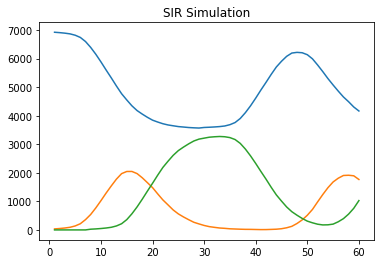

Giorno 60 :
Suscettibili: 4166
Infetti: 1767
Guariti: 1027
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             169 |
|      2 |   4949 |             145 |
|      3 |   3401 |             111 |
|      4 |    166 |             107 |
|      5 |   6136 |              85 |
|      6 |    581 |              64 |
|      7 |   1924 |              60 |
|      8 |   5842 |              57 |
|      9 |   3706 |              49 |
|     10 |   1103 |              48 |
|     11 |   4196 |              46 |
|     12 |   2732 |              44 |
|     13 |   2447 |              42 |
|     14 |   4016 |              38 |
|     15 |   4406 |              37 |
+--------+--------+-----------------+


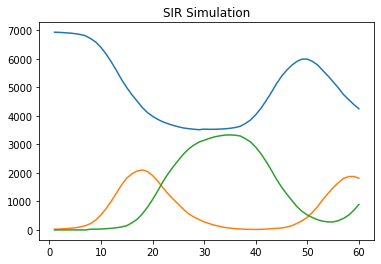

Giorno 60 :
Suscettibili: 4249
Infetti: 1818
Guariti: 893
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             174 |
|      2 |   4949 |             139 |
|      3 |   6136 |              94 |
|      4 |   3401 |              92 |
|      5 |    166 |              80 |
|      6 |   5842 |              61 |
|      7 |   4016 |              56 |
|      8 |   1924 |              52 |
|      9 |    581 |              52 |
|     10 |   2447 |              50 |
|     11 |   1103 |              50 |
|     12 |   3285 |              46 |
|     13 |   2732 |              45 |
|     14 |   2481 |              45 |
|     15 |   3706 |              44 |
+--------+--------+-----------------+


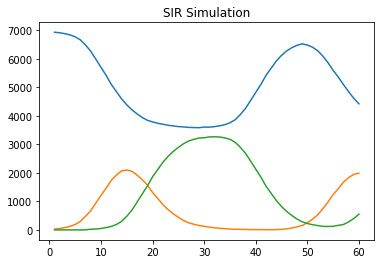

Giorno 60 :
Suscettibili: 4419
Infetti: 1989
Guariti: 552
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             168 |
|      2 |   4949 |             145 |
|      3 |   3401 |             137 |
|      4 |   6136 |              97 |
|      5 |    166 |              97 |
|      6 |   1924 |              65 |
|      7 |   1103 |              61 |
|      8 |   2447 |              60 |
|      9 |   5842 |              59 |
|     10 |   2732 |              51 |
|     11 |   1598 |              47 |
|     12 |   4016 |              46 |
|     13 |   3706 |              45 |
|     14 |   2481 |              43 |
|     15 |   3285 |              42 |
+--------+--------+-----------------+


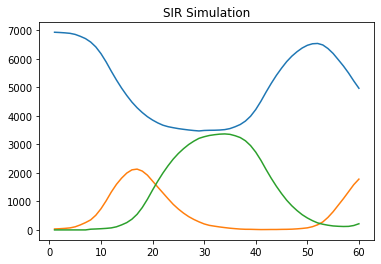

Giorno 60 :
Suscettibili: 4964
Infetti: 1780
Guariti: 216
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             161 |
|      2 |   4949 |             101 |
|      3 |    166 |              95 |
|      4 |   3401 |              88 |
|      5 |   6136 |              73 |
|      6 |   5842 |              71 |
|      7 |   1924 |              56 |
|      8 |   1103 |              51 |
|      9 |   2732 |              48 |
|     10 |   2447 |              43 |
|     11 |   4196 |              43 |
|     12 |    581 |              41 |
|     13 |   1598 |              39 |
|     14 |   4016 |              38 |
|     15 |   3706 |              37 |
+--------+--------+-----------------+


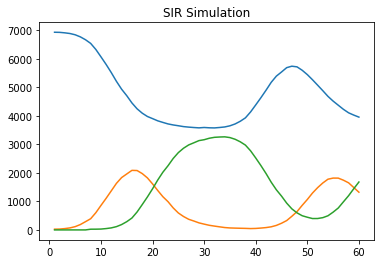

Giorno 60 :
Suscettibili: 3957
Infetti: 1323
Guariti: 1680
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             190 |
|      2 |   1773 |             174 |
|      3 |   3401 |              92 |
|      4 |   6136 |              77 |
|      5 |   2732 |              67 |
|      6 |   2447 |              61 |
|      7 |   5842 |              60 |
|      8 |   1924 |              57 |
|      9 |   4016 |              55 |
|     10 |   1103 |              53 |
|     11 |    581 |              47 |
|     12 |    166 |              46 |
|     13 |   4196 |              44 |
|     14 |   1598 |              42 |
|     15 |   6716 |              37 |
+--------+--------+-----------------+


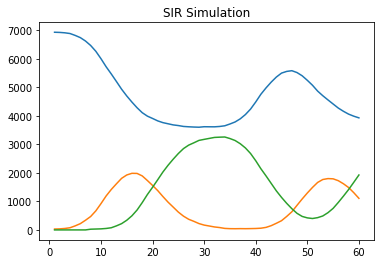

Giorno 60 :
Suscettibili: 3928
Infetti: 1107
Guariti: 1925
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             158 |
|      2 |   1773 |             142 |
|      3 |   3401 |             125 |
|      4 |   5842 |              77 |
|      5 |    166 |              73 |
|      6 |   6136 |              73 |
|      7 |   1924 |              56 |
|      8 |   1103 |              55 |
|      9 |    581 |              50 |
|     10 |   2481 |              48 |
|     11 |   3706 |              48 |
|     12 |   4016 |              44 |
|     13 |   2732 |              40 |
|     14 |   6716 |              38 |
|     15 |   4196 |              36 |
+--------+--------+-----------------+


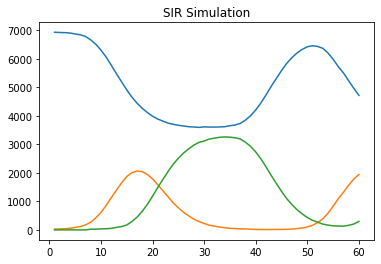

Giorno 60 :
Suscettibili: 4718
Infetti: 1944
Guariti: 298
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             176 |
|      2 |   1773 |             158 |
|      3 |   3401 |              97 |
|      4 |   6136 |              86 |
|      5 |    166 |              63 |
|      6 |   5842 |              60 |
|      7 |    581 |              58 |
|      8 |   2447 |              46 |
|      9 |   1103 |              44 |
|     10 |   4016 |              43 |
|     11 |   1883 |              42 |
|     12 |   1924 |              42 |
|     13 |   3285 |              41 |
|     14 |   4196 |              40 |
|     15 |   2732 |              37 |
+--------+--------+-----------------+


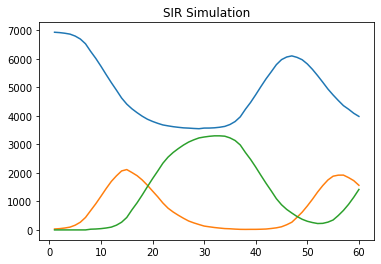

Giorno 60 :
Suscettibili: 3978
Infetti: 1564
Guariti: 1418
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             176 |
|      2 |   4949 |             152 |
|      3 |   3401 |             110 |
|      4 |   6136 |              82 |
|      5 |   1924 |              77 |
|      6 |    166 |              72 |
|      7 |   3706 |              56 |
|      8 |   2732 |              56 |
|      9 |   2447 |              55 |
|     10 |    581 |              52 |
|     11 |   4016 |              48 |
|     12 |   5842 |              45 |
|     13 |   1103 |              45 |
|     14 |   2345 |              39 |
|     15 |   2481 |              39 |
+--------+--------+-----------------+


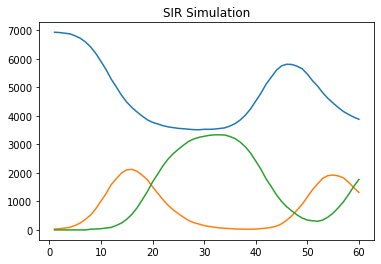

Giorno 60 :
Suscettibili: 3878
Infetti: 1313
Guariti: 1769
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             185 |
|      2 |   4949 |             140 |
|      3 |   3401 |             101 |
|      4 |    166 |              89 |
|      5 |   6136 |              88 |
|      6 |   5842 |              77 |
|      7 |   2447 |              73 |
|      8 |   1924 |              68 |
|      9 |   1103 |              67 |
|     10 |    581 |              48 |
|     11 |   3285 |              48 |
|     12 |   4196 |              48 |
|     13 |   2732 |              45 |
|     14 |   3706 |              41 |
|     15 |   2481 |              41 |
+--------+--------+-----------------+


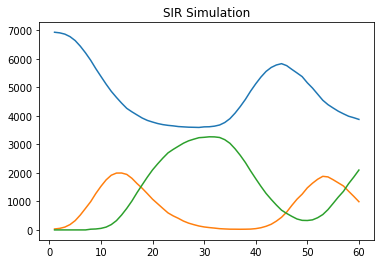

Giorno 60 :
Suscettibili: 3873
Infetti: 989
Guariti: 2098
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             172 |
|      2 |   4949 |             141 |
|      3 |   3401 |             108 |
|      4 |   6136 |              86 |
|      5 |    166 |              83 |
|      6 |   5842 |              66 |
|      7 |   2447 |              62 |
|      8 |   1924 |              60 |
|      9 |   1103 |              58 |
|     10 |    581 |              56 |
|     11 |   3706 |              53 |
|     12 |   4016 |              47 |
|     13 |   2732 |              44 |
|     14 |     93 |              43 |
|     15 |   4196 |              38 |
+--------+--------+-----------------+


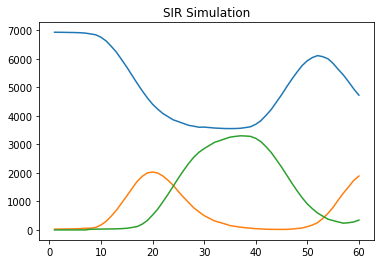

Giorno 60 :
Suscettibili: 4726
Infetti: 1890
Guariti: 344
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             172 |
|      2 |   1773 |             159 |
|      3 |   3401 |              90 |
|      4 |    581 |              83 |
|      5 |   5842 |              78 |
|      6 |   6136 |              73 |
|      7 |   1924 |              63 |
|      8 |   4016 |              52 |
|      9 |   2447 |              50 |
|     10 |    166 |              46 |
|     11 |   5345 |              43 |
|     12 |   2732 |              42 |
|     13 |   1103 |              40 |
|     14 |   3285 |              39 |
|     15 |   1883 |              34 |
+--------+--------+-----------------+


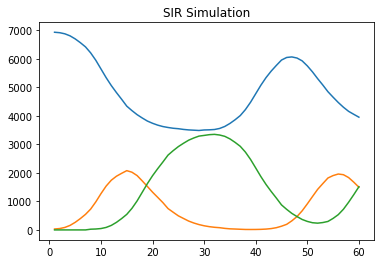

Giorno 60 :
Suscettibili: 3951
Infetti: 1496
Guariti: 1513
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             168 |
|      2 |   4949 |             164 |
|      3 |   3401 |             104 |
|      4 |   6136 |              92 |
|      5 |    166 |              87 |
|      6 |   1924 |              60 |
|      7 |   2447 |              56 |
|      8 |   5842 |              53 |
|      9 |    581 |              52 |
|     10 |   2732 |              48 |
|     11 |   3706 |              47 |
|     12 |   4406 |              46 |
|     13 |   1103 |              44 |
|     14 |   3285 |              44 |
|     15 |   2481 |              38 |
+--------+--------+-----------------+


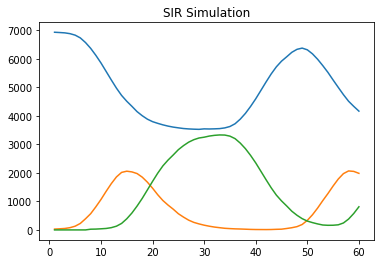

Giorno 60 :
Suscettibili: 4165
Infetti: 1984
Guariti: 811
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             195 |
|      2 |   4949 |             157 |
|      3 |   3401 |             110 |
|      4 |   6136 |              93 |
|      5 |   5842 |              69 |
|      6 |    166 |              67 |
|      7 |   2447 |              60 |
|      8 |   1924 |              59 |
|      9 |   1103 |              58 |
|     10 |   2732 |              56 |
|     11 |    581 |              55 |
|     12 |   3285 |              41 |
|     13 |   1598 |              37 |
|     14 |   3706 |              37 |
|     15 |   4406 |              37 |
+--------+--------+-----------------+


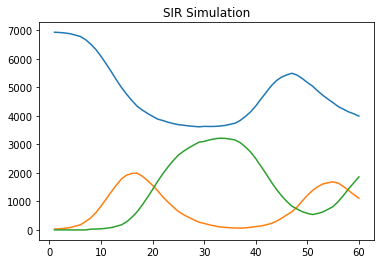

Giorno 60 :
Suscettibili: 3990
Infetti: 1112
Guariti: 1858
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             176 |
|      2 |   4949 |             142 |
|      3 |   3401 |             120 |
|      4 |   6136 |              83 |
|      5 |    166 |              74 |
|      6 |    581 |              64 |
|      7 |   1924 |              55 |
|      8 |   5842 |              55 |
|      9 |   1103 |              53 |
|     10 |   2447 |              53 |
|     11 |   4406 |              41 |
|     12 |   3706 |              40 |
|     13 |   4196 |              40 |
|     14 |   5269 |              38 |
|     15 |   3285 |              38 |
+--------+--------+-----------------+


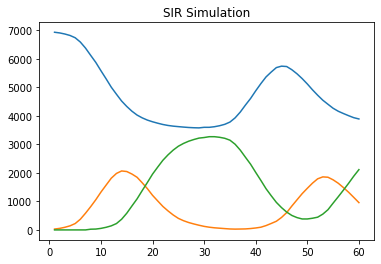

Giorno 60 :
Suscettibili: 3890
Infetti: 957
Guariti: 2113
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             167 |
|      2 |   4949 |             141 |
|      3 |   3401 |             105 |
|      4 |   6136 |              84 |
|      5 |   2732 |              72 |
|      6 |   5842 |              68 |
|      7 |    166 |              67 |
|      8 |    581 |              59 |
|      9 |   1924 |              54 |
|     10 |   2447 |              54 |
|     11 |   1103 |              52 |
|     12 |   3706 |              51 |
|     13 |   3902 |              40 |
|     14 |   1598 |              37 |
|     15 |   2481 |              35 |
+--------+--------+-----------------+


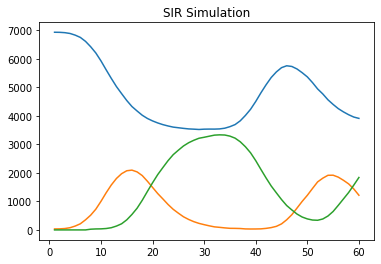

Giorno 60 :
Suscettibili: 3908
Infetti: 1215
Guariti: 1837
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             175 |
|      2 |   4949 |             156 |
|      3 |   3401 |             115 |
|      4 |   6136 |              86 |
|      5 |   1924 |              70 |
|      6 |   5842 |              70 |
|      7 |   2447 |              60 |
|      8 |   2732 |              59 |
|      9 |    166 |              59 |
|     10 |    581 |              56 |
|     11 |   1103 |              56 |
|     12 |   4196 |              43 |
|     13 |   2481 |              41 |
|     14 |   3706 |              39 |
|     15 |   4406 |              37 |
+--------+--------+-----------------+


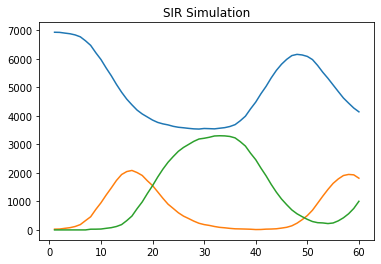

Giorno 60 :
Suscettibili: 4142
Infetti: 1814
Guariti: 1004
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             173 |
|      2 |   1773 |             164 |
|      3 |   3401 |              96 |
|      4 |   6136 |              89 |
|      5 |   5842 |              78 |
|      6 |    166 |              75 |
|      7 |   2732 |              67 |
|      8 |   2447 |              61 |
|      9 |   1103 |              60 |
|     10 |    581 |              58 |
|     11 |   1924 |              54 |
|     12 |   4016 |              52 |
|     13 |   4406 |              47 |
|     14 |   1598 |              43 |
|     15 |   5269 |              41 |
+--------+--------+-----------------+


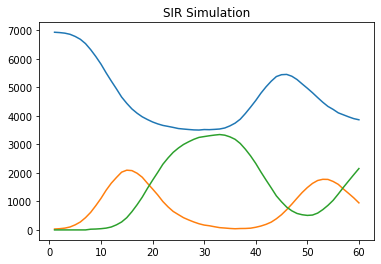

Giorno 60 :
Suscettibili: 3861
Infetti: 948
Guariti: 2151
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             159 |
|      2 |   1773 |             148 |
|      3 |   3401 |             107 |
|      4 |   6136 |              86 |
|      5 |   2732 |              69 |
|      6 |   5842 |              69 |
|      7 |    166 |              67 |
|      8 |   1103 |              62 |
|      9 |   1924 |              59 |
|     10 |   2447 |              58 |
|     11 |    581 |              51 |
|     12 |   3706 |              45 |
|     13 |   3285 |              42 |
|     14 |   2481 |              33 |
|     15 |   4406 |              33 |
+--------+--------+-----------------+


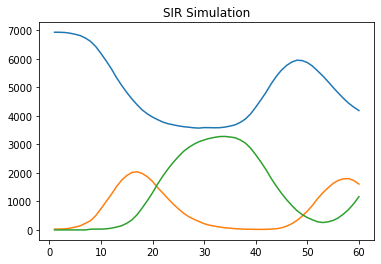

Giorno 60 :
Suscettibili: 4186
Infetti: 1607
Guariti: 1167
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             170 |
|      2 |   4949 |             146 |
|      3 |   3401 |             104 |
|      4 |   6136 |              74 |
|      5 |   1924 |              65 |
|      6 |   2447 |              63 |
|      7 |    166 |              62 |
|      8 |   1103 |              61 |
|      9 |   5842 |              53 |
|     10 |   4016 |              52 |
|     11 |    581 |              46 |
|     12 |   2732 |              42 |
|     13 |   3706 |              39 |
|     14 |   4406 |              38 |
|     15 |   2781 |              36 |
+--------+--------+-----------------+


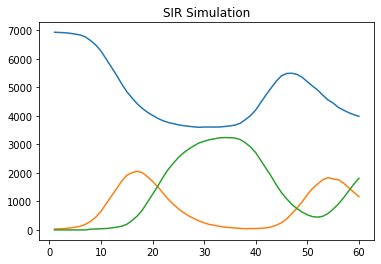

Giorno 60 :
Suscettibili: 3982
Infetti: 1167
Guariti: 1811
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             165 |
|      2 |   4949 |             164 |
|      3 |   3401 |             105 |
|      4 |    166 |              79 |
|      5 |   6136 |              70 |
|      6 |   5842 |              64 |
|      7 |   4016 |              51 |
|      8 |   3706 |              51 |
|      9 |   1103 |              50 |
|     10 |   1924 |              48 |
|     11 |   3285 |              48 |
|     12 |   2447 |              47 |
|     13 |    581 |              46 |
|     14 |   2732 |              45 |
|     15 |   4196 |              43 |
+--------+--------+-----------------+


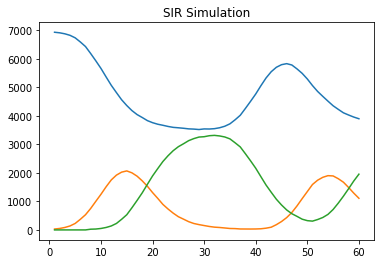

Giorno 60 :
Suscettibili: 3897
Infetti: 1109
Guariti: 1954
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             217 |
|      2 |   4949 |             160 |
|      3 |    166 |              92 |
|      4 |   3401 |              91 |
|      5 |   1924 |              78 |
|      6 |    581 |              77 |
|      7 |   6136 |              69 |
|      8 |   5842 |              65 |
|      9 |   1103 |              57 |
|     10 |   2447 |              50 |
|     11 |   3902 |              41 |
|     12 |   3706 |              39 |
|     13 |   2481 |              38 |
|     14 |   4196 |              38 |
|     15 |   2466 |              37 |
+--------+--------+-----------------+


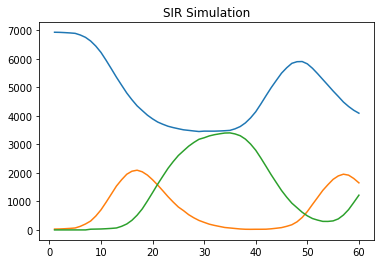

Giorno 60 :
Suscettibili: 4092
Infetti: 1650
Guariti: 1218
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             191 |
|      2 |   4949 |             156 |
|      3 |   3401 |             116 |
|      4 |   5842 |              89 |
|      5 |    166 |              80 |
|      6 |   1924 |              60 |
|      7 |   6136 |              58 |
|      8 |   2732 |              56 |
|      9 |   1103 |              55 |
|     10 |    581 |              52 |
|     11 |   3706 |              51 |
|     12 |   3285 |              51 |
|     13 |   4016 |              50 |
|     14 |   2447 |              46 |
|     15 |   2481 |              45 |
+--------+--------+-----------------+


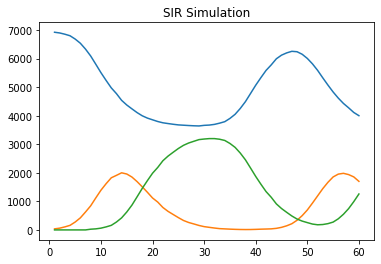

Giorno 60 :
Suscettibili: 4001
Infetti: 1701
Guariti: 1258
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             184 |
|      2 |   4949 |             159 |
|      3 |   3401 |             108 |
|      4 |   5842 |              90 |
|      5 |   6136 |              65 |
|      6 |   2447 |              60 |
|      7 |   1103 |              60 |
|      8 |   2732 |              56 |
|      9 |    166 |              53 |
|     10 |   1924 |              52 |
|     11 |    581 |              52 |
|     12 |   5269 |              43 |
|     13 |   4406 |              41 |
|     14 |   4196 |              40 |
|     15 |   3285 |              37 |
+--------+--------+-----------------+


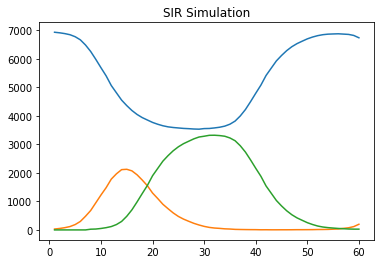

Giorno 60 :
Suscettibili: 6735
Infetti: 198
Guariti: 27
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             111 |
|      2 |   4949 |              90 |
|      3 |   3401 |              67 |
|      4 |   6136 |              61 |
|      5 |    166 |              57 |
|      6 |   2447 |              37 |
|      7 |    581 |              35 |
|      8 |   1103 |              34 |
|      9 |   1924 |              30 |
|     10 |   4076 |              25 |
|     11 |   5842 |              23 |
|     12 |   2732 |              22 |
|     13 |   3285 |              20 |
|     14 |   1598 |              19 |
|     15 |   4196 |              19 |
+--------+--------+-----------------+


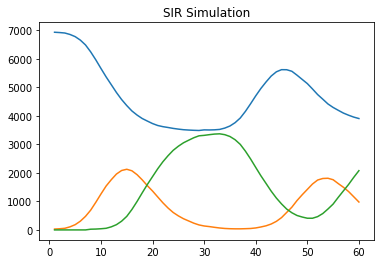

Giorno 60 :
Suscettibili: 3905
Infetti: 978
Guariti: 2077
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             168 |
|      2 |   4949 |             126 |
|      3 |   6136 |             103 |
|      4 |   3401 |              97 |
|      5 |   1924 |              91 |
|      6 |    166 |              84 |
|      7 |   5842 |              71 |
|      8 |   2447 |              55 |
|      9 |    581 |              53 |
|     10 |   2732 |              53 |
|     11 |   1103 |              51 |
|     12 |   2481 |              48 |
|     13 |   3706 |              47 |
|     14 |   4196 |              42 |
|     15 |   2345 |              39 |
+--------+--------+-----------------+


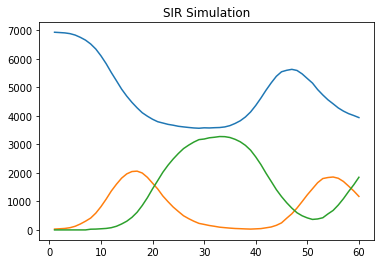

Giorno 60 :
Suscettibili: 3939
Infetti: 1175
Guariti: 1846
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             177 |
|      2 |   4949 |             164 |
|      3 |   3401 |             116 |
|      4 |   6136 |              94 |
|      5 |   1103 |              66 |
|      6 |    166 |              61 |
|      7 |   2447 |              58 |
|      8 |   5842 |              51 |
|      9 |   1924 |              51 |
|     10 |    581 |              50 |
|     11 |   2732 |              43 |
|     12 |   3706 |              43 |
|     13 |   4016 |              41 |
|     14 |   4406 |              41 |
|     15 |     93 |              39 |
+--------+--------+-----------------+


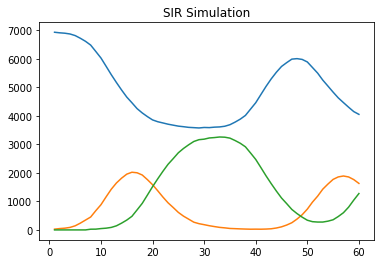

Giorno 60 :
Suscettibili: 4053
Infetti: 1631
Guariti: 1276
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             182 |
|      2 |   4949 |             159 |
|      3 |   3401 |             116 |
|      4 |   6136 |              88 |
|      5 |    166 |              82 |
|      6 |   2732 |              69 |
|      7 |   5842 |              68 |
|      8 |   2447 |              51 |
|      9 |   1103 |              50 |
|     10 |    581 |              50 |
|     11 |   1924 |              49 |
|     12 |   3285 |              43 |
|     13 |   4016 |              41 |
|     14 |   4639 |              38 |
|     15 |   4196 |              37 |
+--------+--------+-----------------+


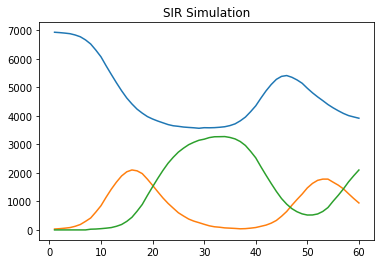

Giorno 60 :
Suscettibili: 3915
Infetti: 945
Guariti: 2100
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             169 |
|      2 |   4949 |             158 |
|      3 |   6136 |              88 |
|      4 |   5842 |              88 |
|      5 |   3401 |              77 |
|      6 |   2732 |              68 |
|      7 |   1924 |              67 |
|      8 |    166 |              61 |
|      9 |   1103 |              56 |
|     10 |   2447 |              56 |
|     11 |    581 |              53 |
|     12 |   3706 |              47 |
|     13 |   4016 |              44 |
|     14 |   3285 |              41 |
|     15 |   4406 |              37 |
+--------+--------+-----------------+


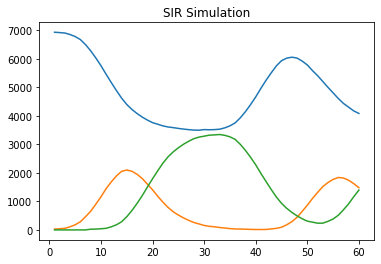

Giorno 60 :
Suscettibili: 4084
Infetti: 1480
Guariti: 1396
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             161 |
|      2 |   4949 |             155 |
|      3 |   3401 |             111 |
|      4 |   6136 |              73 |
|      5 |    581 |              70 |
|      6 |   5842 |              67 |
|      7 |    166 |              66 |
|      8 |   2447 |              63 |
|      9 |   1103 |              56 |
|     10 |   1924 |              53 |
|     11 |   2732 |              51 |
|     12 |   4196 |              50 |
|     13 |   5269 |              45 |
|     14 |   4016 |              41 |
|     15 |   3706 |              41 |
+--------+--------+-----------------+


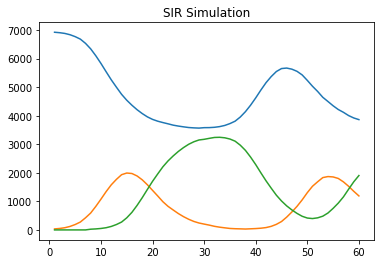

Giorno 60 :
Suscettibili: 3864
Infetti: 1191
Guariti: 1905
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             163 |
|      2 |   1773 |             136 |
|      3 |   3401 |              91 |
|      4 |   5842 |              65 |
|      5 |   6136 |              61 |
|      6 |    581 |              60 |
|      7 |   2447 |              58 |
|      8 |   1103 |              53 |
|      9 |   1924 |              52 |
|     10 |    166 |              52 |
|     11 |   2732 |              47 |
|     12 |   4016 |              46 |
|     13 |   4196 |              45 |
|     14 |   2481 |              43 |
|     15 |   3285 |              41 |
+--------+--------+-----------------+


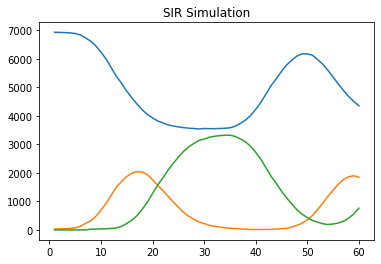

Giorno 60 :
Suscettibili: 4351
Infetti: 1847
Guariti: 762
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             176 |
|      2 |   4949 |             156 |
|      3 |   3401 |             123 |
|      4 |   6136 |              76 |
|      5 |    581 |              63 |
|      6 |    166 |              62 |
|      7 |   1924 |              61 |
|      8 |   5842 |              55 |
|      9 |   2732 |              46 |
|     10 |   3706 |              45 |
|     11 |   3285 |              44 |
|     12 |   1103 |              44 |
|     13 |   4196 |              39 |
|     14 |   2481 |              39 |
|     15 |   2447 |              38 |
+--------+--------+-----------------+


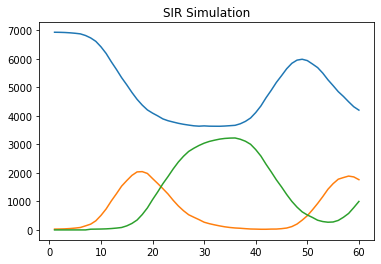

Giorno 60 :
Suscettibili: 4200
Infetti: 1762
Guariti: 998
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             180 |
|      2 |   4949 |             150 |
|      3 |   6136 |             104 |
|      4 |   3401 |              94 |
|      5 |    166 |              71 |
|      6 |   5842 |              65 |
|      7 |   2447 |              62 |
|      8 |   1924 |              62 |
|      9 |    581 |              54 |
|     10 |   1103 |              53 |
|     11 |   4196 |              48 |
|     12 |   2732 |              48 |
|     13 |   3285 |              42 |
|     14 |   3706 |              42 |
|     15 |   4016 |              42 |
+--------+--------+-----------------+


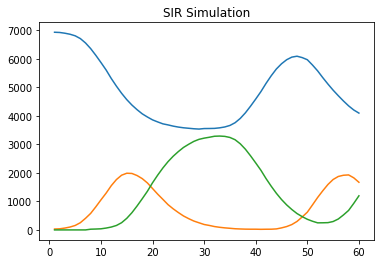

Giorno 60 :
Suscettibili: 4095
Infetti: 1670
Guariti: 1195
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             184 |
|      2 |   4949 |             136 |
|      3 |   3401 |             126 |
|      4 |   6136 |              86 |
|      5 |    166 |              75 |
|      6 |    581 |              69 |
|      7 |   1103 |              57 |
|      8 |   5842 |              56 |
|      9 |   2732 |              54 |
|     10 |   1924 |              50 |
|     11 |   2481 |              49 |
|     12 |   4016 |              42 |
|     13 |   4196 |              40 |
|     14 |   2447 |              40 |
|     15 |   3706 |              39 |
+--------+--------+-----------------+


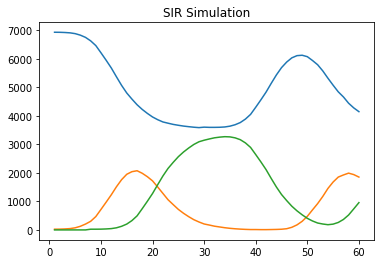

Giorno 60 :
Suscettibili: 4149
Infetti: 1854
Guariti: 957
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             184 |
|      2 |   1773 |             165 |
|      3 |   3401 |             118 |
|      4 |    166 |              75 |
|      5 |   6136 |              73 |
|      6 |   5842 |              69 |
|      7 |    581 |              67 |
|      8 |   1924 |              58 |
|      9 |   2732 |              54 |
|     10 |   2481 |              53 |
|     11 |   4016 |              50 |
|     12 |   1103 |              47 |
|     13 |   1598 |              46 |
|     14 |   2447 |              42 |
|     15 |   4196 |              40 |
+--------+--------+-----------------+


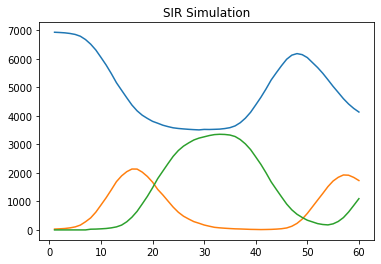

Giorno 60 :
Suscettibili: 4133
Infetti: 1731
Guariti: 1096
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             187 |
|      2 |   4949 |             168 |
|      3 |   6136 |              93 |
|      4 |   3401 |              92 |
|      5 |   5842 |              70 |
|      6 |    166 |              64 |
|      7 |    581 |              59 |
|      8 |   1924 |              54 |
|      9 |   2447 |              53 |
|     10 |   2732 |              49 |
|     11 |   1103 |              49 |
|     12 |   4406 |              45 |
|     13 |   2481 |              44 |
|     14 |   3706 |              38 |
|     15 |   4196 |              33 |
+--------+--------+-----------------+


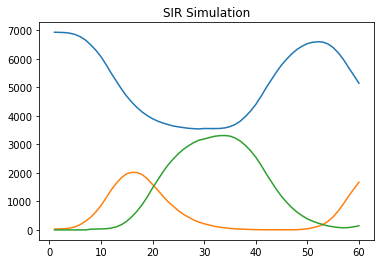

Giorno 60 :
Suscettibili: 5142
Infetti: 1671
Guariti: 147
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             204 |
|      2 |   1773 |             187 |
|      3 |   3401 |             115 |
|      4 |   6136 |             103 |
|      5 |    166 |              84 |
|      6 |   5842 |              75 |
|      7 |    581 |              68 |
|      8 |   2447 |              68 |
|      9 |   1103 |              54 |
|     10 |   2732 |              48 |
|     11 |   4016 |              41 |
|     12 |   1924 |              39 |
|     13 |     93 |              35 |
|     14 |   3706 |              34 |
|     15 |   4406 |              32 |
+--------+--------+-----------------+


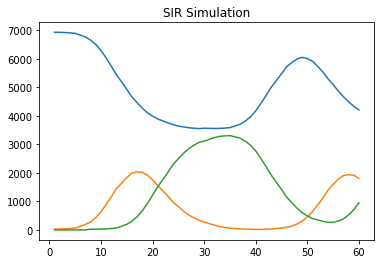

Giorno 60 :
Suscettibili: 4207
Infetti: 1806
Guariti: 947
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             159 |
|      2 |   1773 |             155 |
|      3 |   3401 |             104 |
|      4 |   6136 |              84 |
|      5 |   5842 |              70 |
|      6 |   1924 |              68 |
|      7 |   1103 |              68 |
|      8 |    166 |              65 |
|      9 |   2732 |              51 |
|     10 |   4196 |              50 |
|     11 |   4016 |              49 |
|     12 |   2447 |              48 |
|     13 |    581 |              48 |
|     14 |   3706 |              47 |
|     15 |   5945 |              37 |
+--------+--------+-----------------+


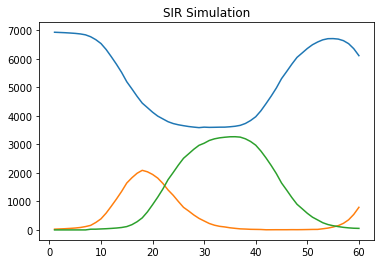

Giorno 60 :
Suscettibili: 6113
Infetti: 793
Guariti: 54
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             190 |
|      2 |   1773 |             124 |
|      3 |   3401 |              70 |
|      4 |   2732 |              57 |
|      5 |   2447 |              52 |
|      6 |   1924 |              50 |
|      7 |   6136 |              47 |
|      8 |   5842 |              44 |
|      9 |   4196 |              32 |
|     10 |   3706 |              32 |
|     11 |   4406 |              27 |
|     12 |    166 |              26 |
|     13 |   1103 |              26 |
|     14 |   1883 |              26 |
|     15 |   4016 |              25 |
+--------+--------+-----------------+


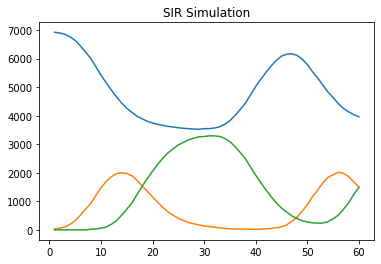

Giorno 60 :
Suscettibili: 3962
Infetti: 1503
Guariti: 1495
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             169 |
|      2 |   4949 |             144 |
|      3 |   3401 |             119 |
|      4 |   6136 |              85 |
|      5 |    166 |              72 |
|      6 |   4016 |              67 |
|      7 |   2447 |              59 |
|      8 |   2732 |              58 |
|      9 |   1103 |              58 |
|     10 |   1924 |              54 |
|     11 |   5842 |              54 |
|     12 |    581 |              53 |
|     13 |   3706 |              45 |
|     14 |   2481 |              41 |
|     15 |   3285 |              37 |
+--------+--------+-----------------+


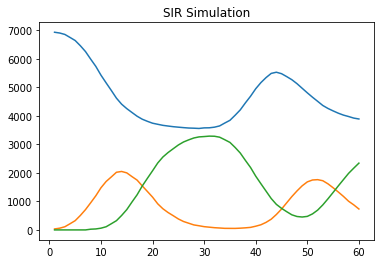

Giorno 60 :
Suscettibili: 3887
Infetti: 733
Guariti: 2340
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             155 |
|      2 |   4949 |             136 |
|      3 |   3401 |             106 |
|      4 |   6136 |              91 |
|      5 |    166 |              77 |
|      6 |   1924 |              68 |
|      7 |   5842 |              65 |
|      8 |    581 |              55 |
|      9 |   2732 |              53 |
|     10 |   2447 |              48 |
|     11 |   4016 |              46 |
|     12 |   4406 |              43 |
|     13 |   1598 |              43 |
|     14 |   3285 |              42 |
|     15 |   2481 |              41 |
+--------+--------+-----------------+


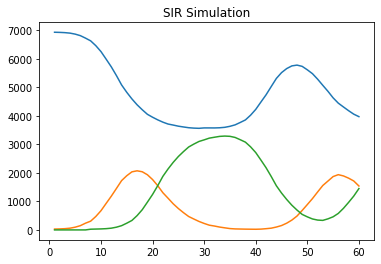

Giorno 60 :
Suscettibili: 3971
Infetti: 1540
Guariti: 1449
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             175 |
|      2 |   4949 |             130 |
|      3 |   3401 |              97 |
|      4 |   6136 |              91 |
|      5 |    581 |              79 |
|      6 |   5842 |              79 |
|      7 |    166 |              76 |
|      8 |   2732 |              62 |
|      9 |   1103 |              61 |
|     10 |   1924 |              60 |
|     11 |   4016 |              53 |
|     12 |   2447 |              52 |
|     13 |   2481 |              41 |
|     14 |   1598 |              40 |
|     15 |   4196 |              36 |
+--------+--------+-----------------+


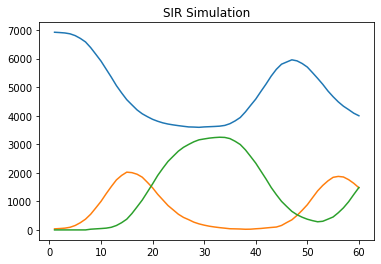

Giorno 60 :
Suscettibili: 3998
Infetti: 1477
Guariti: 1485
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             174 |
|      2 |   4949 |             163 |
|      3 |   3401 |             108 |
|      4 |   6136 |              81 |
|      5 |    166 |              70 |
|      6 |   1924 |              66 |
|      7 |   5842 |              57 |
|      8 |    581 |              56 |
|      9 |   3706 |              52 |
|     10 |   4016 |              52 |
|     11 |   1103 |              45 |
|     12 |   2732 |              45 |
|     13 |   2345 |              43 |
|     14 |   2447 |              42 |
|     15 |   2481 |              41 |
+--------+--------+-----------------+


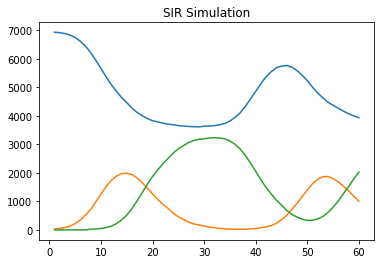

Giorno 60 :
Suscettibili: 3934
Infetti: 1002
Guariti: 2024
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             164 |
|      2 |   4949 |             148 |
|      3 |   3401 |             121 |
|      4 |   6136 |              80 |
|      5 |    166 |              70 |
|      6 |    581 |              59 |
|      7 |   2732 |              58 |
|      8 |   1103 |              54 |
|      9 |   1924 |              53 |
|     10 |   2447 |              51 |
|     11 |   5842 |              48 |
|     12 |   4406 |              41 |
|     13 |   3706 |              41 |
|     14 |   1598 |              41 |
|     15 |   4196 |              37 |
+--------+--------+-----------------+


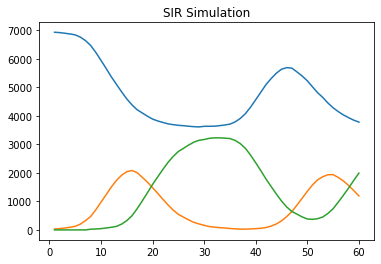

Giorno 60 :
Suscettibili: 3779
Infetti: 1191
Guariti: 1990
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             171 |
|      2 |   1773 |             169 |
|      3 |   3401 |              95 |
|      4 |    166 |              76 |
|      5 |   6136 |              75 |
|      6 |   5842 |              74 |
|      7 |   1924 |              70 |
|      8 |   1103 |              63 |
|      9 |    581 |              63 |
|     10 |   2447 |              53 |
|     11 |   2732 |              53 |
|     12 |   2481 |              50 |
|     13 |   3706 |              44 |
|     14 |     93 |              38 |
|     15 |   3902 |              38 |
+--------+--------+-----------------+


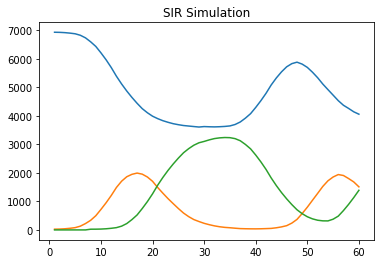

Giorno 60 :
Suscettibili: 4059
Infetti: 1511
Guariti: 1390
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             154 |
|      2 |   4949 |             133 |
|      3 |   3401 |             113 |
|      4 |   6136 |              76 |
|      5 |    166 |              76 |
|      6 |   2732 |              70 |
|      7 |   1103 |              59 |
|      8 |   5842 |              59 |
|      9 |    581 |              53 |
|     10 |   1924 |              53 |
|     11 |   3706 |              50 |
|     12 |   2447 |              47 |
|     13 |   4196 |              44 |
|     14 |   5269 |              41 |
|     15 |   3285 |              39 |
+--------+--------+-----------------+


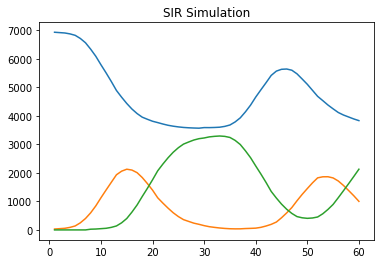

Giorno 60 :
Suscettibili: 3831
Infetti: 1001
Guariti: 2128
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             162 |
|      2 |   4949 |             139 |
|      3 |   3401 |             100 |
|      4 |   6136 |              89 |
|      5 |   5842 |              75 |
|      6 |   2732 |              67 |
|      7 |   1924 |              66 |
|      8 |   1103 |              66 |
|      9 |   2447 |              51 |
|     10 |    166 |              47 |
|     11 |   4016 |              45 |
|     12 |   5269 |              44 |
|     13 |    581 |              42 |
|     14 |   6716 |              42 |
|     15 |    675 |              41 |
+--------+--------+-----------------+


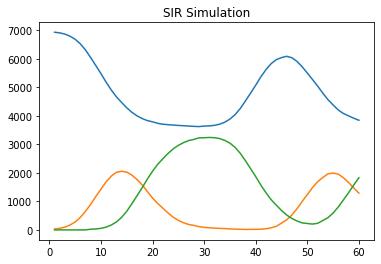

Giorno 60 :
Suscettibili: 3842
Infetti: 1289
Guariti: 1829
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             179 |
|      2 |   1773 |             162 |
|      3 |   3401 |             111 |
|      4 |   6136 |              94 |
|      5 |    166 |              78 |
|      6 |   1924 |              74 |
|      7 |   2732 |              63 |
|      8 |   5842 |              60 |
|      9 |   1103 |              58 |
|     10 |    581 |              57 |
|     11 |   2447 |              49 |
|     12 |   2481 |              45 |
|     13 |   4406 |              40 |
|     14 |   3706 |              38 |
|     15 |   3285 |              37 |
+--------+--------+-----------------+


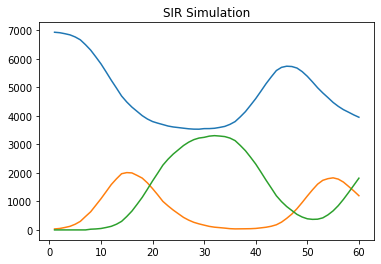

Giorno 60 :
Suscettibili: 3948
Infetti: 1199
Guariti: 1813
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             163 |
|      2 |   4949 |             129 |
|      3 |   3401 |             116 |
|      4 |   4016 |              79 |
|      5 |   6136 |              78 |
|      6 |   1924 |              69 |
|      7 |    166 |              63 |
|      8 |   2732 |              59 |
|      9 |   5842 |              57 |
|     10 |   1103 |              57 |
|     11 |   3706 |              53 |
|     12 |    581 |              50 |
|     13 |   2447 |              44 |
|     14 |   1598 |              37 |
|     15 |   3285 |              37 |
+--------+--------+-----------------+


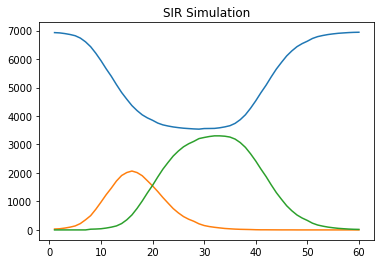

Giorno 60 :
Suscettibili: 6942
Infetti: 0
Guariti: 18
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |              79 |
|      2 |   4949 |              63 |
|      3 |   6136 |              61 |
|      4 |   3401 |              57 |
|      5 |    166 |              33 |
|      6 |   1103 |              32 |
|      7 |   2481 |              31 |
|      8 |   5842 |              31 |
|      9 |   3706 |              28 |
|     10 |   4406 |              26 |
|     11 |    581 |              25 |
|     12 |   1924 |              24 |
|     13 |   2345 |              24 |
|     14 |   2732 |              21 |
|     15 |   3285 |              20 |
+--------+--------+-----------------+


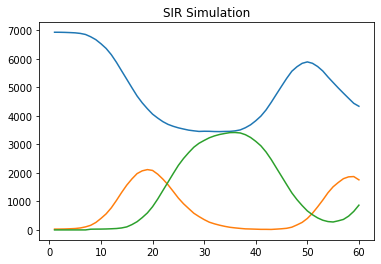

Giorno 60 :
Suscettibili: 4336
Infetti: 1756
Guariti: 868
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             170 |
|      2 |   4949 |             156 |
|      3 |   3401 |              99 |
|      4 |   6136 |              85 |
|      5 |    166 |              69 |
|      6 |   1103 |              68 |
|      7 |   5842 |              67 |
|      8 |   4196 |              54 |
|      9 |   2732 |              53 |
|     10 |   1924 |              51 |
|     11 |    581 |              49 |
|     12 |   2447 |              47 |
|     13 |   2345 |              41 |
|     14 |   3706 |              38 |
|     15 |   1883 |              37 |
+--------+--------+-----------------+


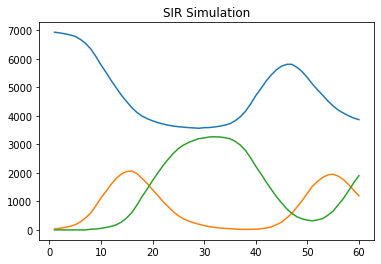

Giorno 60 :
Suscettibili: 3865
Infetti: 1196
Guariti: 1899
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             195 |
|      2 |   1773 |             175 |
|      3 |   3401 |             111 |
|      4 |   6136 |              72 |
|      5 |    166 |              68 |
|      6 |    581 |              65 |
|      7 |   1924 |              63 |
|      8 |   4196 |              59 |
|      9 |   5842 |              56 |
|     10 |   2732 |              53 |
|     11 |   4016 |              50 |
|     12 |   1598 |              44 |
|     13 |   1103 |              41 |
|     14 |   3706 |              39 |
|     15 |   2345 |              37 |
+--------+--------+-----------------+


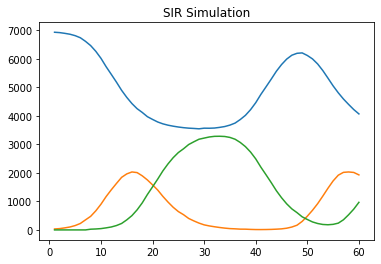

Giorno 60 :
Suscettibili: 4065
Infetti: 1928
Guariti: 967
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             182 |
|      2 |   4949 |             160 |
|      3 |   3401 |             117 |
|      4 |    166 |              97 |
|      5 |   6136 |              94 |
|      6 |   1924 |              71 |
|      7 |    581 |              70 |
|      8 |   5842 |              61 |
|      9 |   2447 |              52 |
|     10 |   2732 |              50 |
|     11 |   4196 |              48 |
|     12 |   1103 |              47 |
|     13 |   4406 |              47 |
|     14 |   4016 |              44 |
|     15 |   2481 |              41 |
+--------+--------+-----------------+


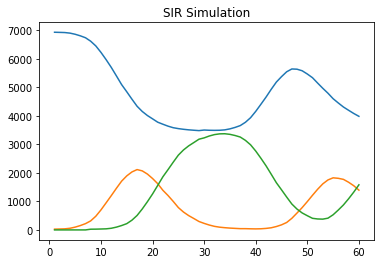

Giorno 60 :
Suscettibili: 3984
Infetti: 1395
Guariti: 1581
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             177 |
|      2 |   1773 |             154 |
|      3 |   3401 |             118 |
|      4 |   6136 |              81 |
|      5 |   5842 |              76 |
|      6 |    166 |              71 |
|      7 |   2732 |              60 |
|      8 |   4196 |              51 |
|      9 |   4406 |              50 |
|     10 |    581 |              44 |
|     11 |   5945 |              44 |
|     12 |   2447 |              43 |
|     13 |   1103 |              42 |
|     14 |   3285 |              41 |
|     15 |   1924 |              41 |
+--------+--------+-----------------+


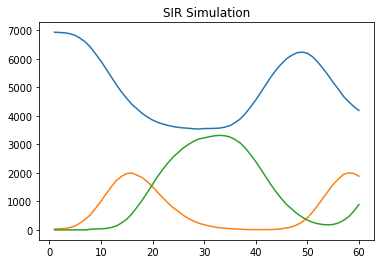

Giorno 60 :
Suscettibili: 4188
Infetti: 1882
Guariti: 890
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             186 |
|      2 |   4949 |             171 |
|      3 |   3401 |              93 |
|      4 |   6136 |              65 |
|      5 |   5842 |              65 |
|      6 |   1924 |              60 |
|      7 |    166 |              58 |
|      8 |    581 |              56 |
|      9 |   2447 |              56 |
|     10 |   2732 |              51 |
|     11 |   4016 |              49 |
|     12 |   4406 |              43 |
|     13 |   1103 |              43 |
|     14 |   1598 |              37 |
|     15 |   3706 |              37 |
+--------+--------+-----------------+


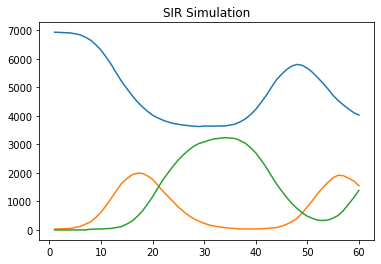

Giorno 60 :
Suscettibili: 4024
Infetti: 1549
Guariti: 1387
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             173 |
|      2 |   4949 |             143 |
|      3 |   3401 |             119 |
|      4 |   5842 |              70 |
|      5 |   1924 |              65 |
|      6 |    581 |              64 |
|      7 |    166 |              61 |
|      8 |   6136 |              60 |
|      9 |   2732 |              56 |
|     10 |   1103 |              55 |
|     11 |   3285 |              52 |
|     12 |   2447 |              50 |
|     13 |   4406 |              45 |
|     14 |   2481 |              44 |
|     15 |   3902 |              37 |
+--------+--------+-----------------+


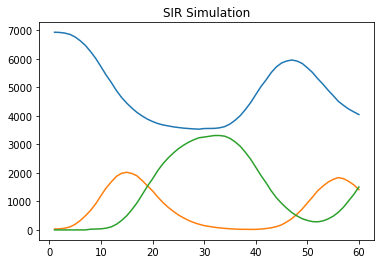

Giorno 60 :
Suscettibili: 4044
Infetti: 1412
Guariti: 1504
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             164 |
|      2 |   4949 |             152 |
|      3 |   3401 |             104 |
|      4 |   6136 |              94 |
|      5 |   5842 |              77 |
|      6 |    166 |              74 |
|      7 |    581 |              65 |
|      8 |   1924 |              65 |
|      9 |   3706 |              51 |
|     10 |   1103 |              49 |
|     11 |   2447 |              49 |
|     12 |   2732 |              44 |
|     13 |   4016 |              41 |
|     14 |   4406 |              39 |
|     15 |   3285 |              37 |
+--------+--------+-----------------+


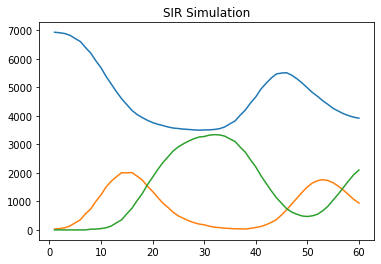

Giorno 60 :
Suscettibili: 3918
Infetti: 942
Guariti: 2100
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             188 |
|      2 |   1773 |             154 |
|      3 |   3401 |             104 |
|      4 |    166 |              95 |
|      5 |   6136 |              86 |
|      6 |   5842 |              68 |
|      7 |   4016 |              65 |
|      8 |   1924 |              57 |
|      9 |   2732 |              56 |
|     10 |   3706 |              47 |
|     11 |   1103 |              43 |
|     12 |   4196 |              43 |
|     13 |    581 |              40 |
|     14 |   2447 |              36 |
|     15 |   3285 |              34 |
+--------+--------+-----------------+


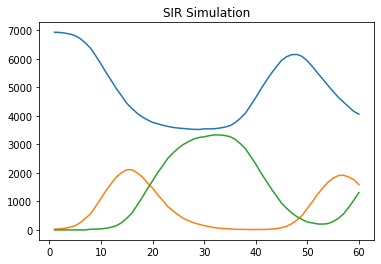

Giorno 60 :
Suscettibili: 4061
Infetti: 1589
Guariti: 1310
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             176 |
|      2 |   4949 |             158 |
|      3 |   3401 |             110 |
|      4 |    166 |              86 |
|      5 |   6136 |              83 |
|      6 |   2732 |              71 |
|      7 |   1924 |              69 |
|      8 |    581 |              54 |
|      9 |   5842 |              53 |
|     10 |   4016 |              52 |
|     11 |   2447 |              52 |
|     12 |   1103 |              48 |
|     13 |   4196 |              44 |
|     14 |   4406 |              38 |
|     15 |   3706 |              37 |
+--------+--------+-----------------+


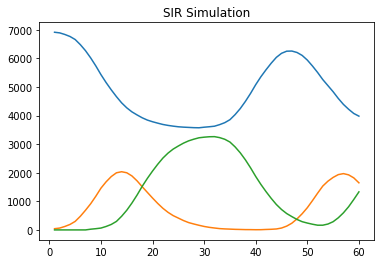

Giorno 60 :
Suscettibili: 3981
Infetti: 1648
Guariti: 1331
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             182 |
|      2 |   1773 |             170 |
|      3 |   3401 |              95 |
|      4 |   5842 |              86 |
|      5 |   6136 |              76 |
|      6 |   2732 |              75 |
|      7 |    166 |              75 |
|      8 |    581 |              59 |
|      9 |   2447 |              56 |
|     10 |   1924 |              49 |
|     11 |   1103 |              49 |
|     12 |   4196 |              49 |
|     13 |   4016 |              45 |
|     14 |   4406 |              38 |
|     15 |   3285 |              36 |
+--------+--------+-----------------+


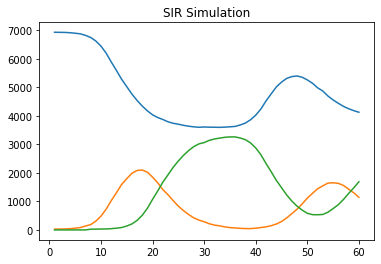

Giorno 60 :
Suscettibili: 4127
Infetti: 1144
Guariti: 1689
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             147 |
|      2 |   1773 |             141 |
|      3 |   3401 |             109 |
|      4 |   6136 |              90 |
|      5 |    581 |              74 |
|      6 |   5842 |              72 |
|      7 |   1924 |              60 |
|      8 |   1103 |              57 |
|      9 |    166 |              56 |
|     10 |   2447 |              45 |
|     11 |   1598 |              44 |
|     12 |   2732 |              44 |
|     13 |   2481 |              43 |
|     14 |   4016 |              38 |
|     15 |   5269 |              37 |
+--------+--------+-----------------+


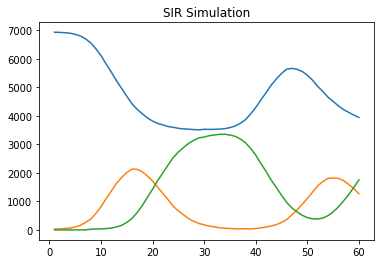

Giorno 60 :
Suscettibili: 3942
Infetti: 1266
Guariti: 1752
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             169 |
|      2 |   4949 |             156 |
|      3 |   3401 |              96 |
|      4 |    166 |              77 |
|      5 |   1924 |              71 |
|      6 |   6136 |              68 |
|      7 |    581 |              61 |
|      8 |   5842 |              61 |
|      9 |   1103 |              52 |
|     10 |   2447 |              49 |
|     11 |   2732 |              48 |
|     12 |   4196 |              47 |
|     13 |   4016 |              42 |
|     14 |   3706 |              39 |
|     15 |   3285 |              38 |
+--------+--------+-----------------+


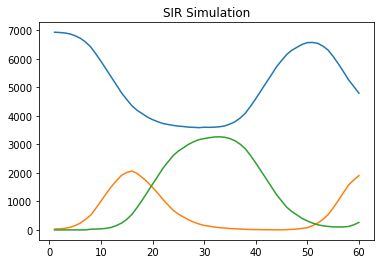

Giorno 60 :
Suscettibili: 4794
Infetti: 1904
Guariti: 262
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             175 |
|      2 |   4949 |             136 |
|      3 |   6136 |              91 |
|      4 |    166 |              91 |
|      5 |   3401 |              84 |
|      6 |   1103 |              70 |
|      7 |   2732 |              67 |
|      8 |   2447 |              58 |
|      9 |   1924 |              56 |
|     10 |   4196 |              56 |
|     11 |   2481 |              55 |
|     12 |   4016 |              54 |
|     13 |    581 |              53 |
|     14 |   5842 |              45 |
|     15 |   3706 |              43 |
+--------+--------+-----------------+


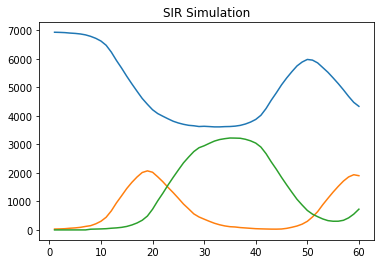

Giorno 60 :
Suscettibili: 4332
Infetti: 1901
Guariti: 727
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             152 |
|      2 |   4949 |             145 |
|      3 |   3401 |             109 |
|      4 |   6136 |              79 |
|      5 |    166 |              69 |
|      6 |   2732 |              66 |
|      7 |    581 |              61 |
|      8 |   2447 |              59 |
|      9 |   1924 |              59 |
|     10 |   5842 |              55 |
|     11 |   1103 |              51 |
|     12 |   4196 |              46 |
|     13 |   2481 |              42 |
|     14 |    675 |              37 |
|     15 |   4016 |              34 |
+--------+--------+-----------------+


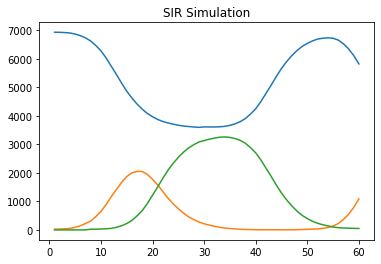

Giorno 60 :
Suscettibili: 5821
Infetti: 1089
Guariti: 50
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             199 |
|      2 |   1773 |             106 |
|      3 |   3401 |              82 |
|      4 |    166 |              75 |
|      5 |   5842 |              59 |
|      6 |   6136 |              54 |
|      7 |   4196 |              51 |
|      8 |   1103 |              38 |
|      9 |   2447 |              35 |
|     10 |   2732 |              32 |
|     11 |   2997 |              30 |
|     12 |   1924 |              30 |
|     13 |   2887 |              30 |
|     14 |    581 |              30 |
|     15 |   3285 |              30 |
+--------+--------+-----------------+


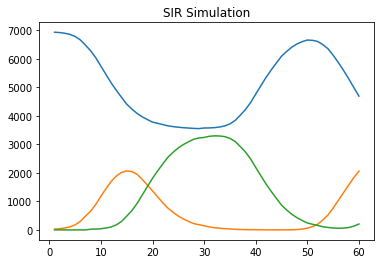

Giorno 60 :
Suscettibili: 4691
Infetti: 2062
Guariti: 207
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             194 |
|      2 |   4949 |             192 |
|      3 |   3401 |             106 |
|      4 |   5842 |              93 |
|      5 |    166 |              62 |
|      6 |   2732 |              60 |
|      7 |   6136 |              60 |
|      8 |   1924 |              54 |
|      9 |   1103 |              53 |
|     10 |   4196 |              53 |
|     11 |   3285 |              42 |
|     12 |   2447 |              41 |
|     13 |   4406 |              40 |
|     14 |   2481 |              37 |
|     15 |   3902 |              29 |
+--------+--------+-----------------+


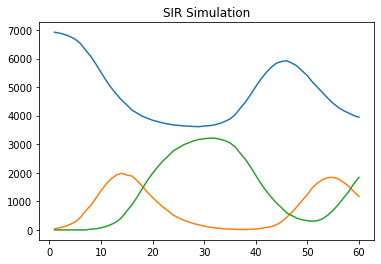

Giorno 60 :
Suscettibili: 3944
Infetti: 1177
Guariti: 1839
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             151 |
|      2 |   1773 |             137 |
|      3 |   3401 |             110 |
|      4 |    166 |              82 |
|      5 |   6136 |              78 |
|      6 |   5842 |              63 |
|      7 |   1924 |              59 |
|      8 |    581 |              58 |
|      9 |   2447 |              57 |
|     10 |   2732 |              56 |
|     11 |   1103 |              49 |
|     12 |   4016 |              48 |
|     13 |   3706 |              40 |
|     14 |   4406 |              40 |
|     15 |   5269 |              34 |
+--------+--------+-----------------+


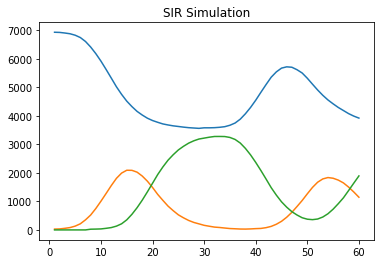

Giorno 60 :
Suscettibili: 3921
Infetti: 1146
Guariti: 1893
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             158 |
|      2 |   4949 |             155 |
|      3 |   3401 |             113 |
|      4 |   6136 |              92 |
|      5 |    166 |              83 |
|      6 |   5842 |              72 |
|      7 |   2447 |              65 |
|      8 |   1103 |              63 |
|      9 |   1924 |              62 |
|     10 |    581 |              57 |
|     11 |   2732 |              48 |
|     12 |   3285 |              46 |
|     13 |   4196 |              40 |
|     14 |   2345 |              40 |
|     15 |   4016 |              38 |
+--------+--------+-----------------+


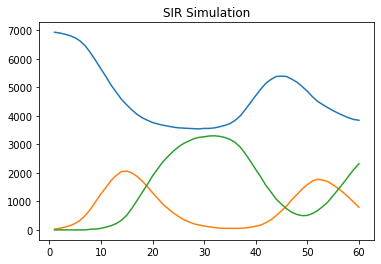

Giorno 60 :
Suscettibili: 3845
Infetti: 798
Guariti: 2317
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             152 |
|      2 |   4949 |             151 |
|      3 |   3401 |              98 |
|      4 |   6136 |              91 |
|      5 |    166 |              72 |
|      6 |   1924 |              72 |
|      7 |   5842 |              69 |
|      8 |   2447 |              68 |
|      9 |   1103 |              61 |
|     10 |   2732 |              59 |
|     11 |    581 |              56 |
|     12 |   4016 |              44 |
|     13 |   4196 |              43 |
|     14 |   3285 |              41 |
|     15 |   3706 |              38 |
+--------+--------+-----------------+


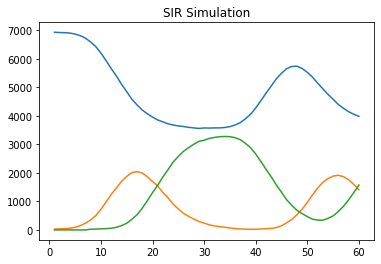

Giorno 60 :
Suscettibili: 3980
Infetti: 1407
Guariti: 1573
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             196 |
|      2 |   4949 |             154 |
|      3 |   3401 |             120 |
|      4 |   6136 |              84 |
|      5 |    166 |              79 |
|      6 |   5842 |              74 |
|      7 |   1924 |              66 |
|      8 |   1103 |              52 |
|      9 |   2447 |              51 |
|     10 |   2732 |              50 |
|     11 |   3706 |              49 |
|     12 |    581 |              47 |
|     13 |   4196 |              40 |
|     14 |   4016 |              40 |
|     15 |   4406 |              39 |
+--------+--------+-----------------+


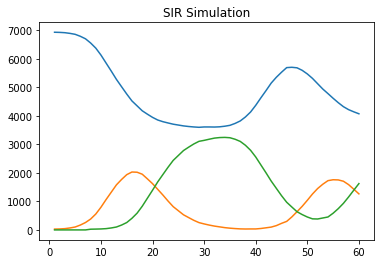

Giorno 60 :
Suscettibili: 4072
Infetti: 1264
Guariti: 1624
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             162 |
|      2 |   1773 |             130 |
|      3 |   3401 |              99 |
|      4 |   6136 |              76 |
|      5 |   1103 |              68 |
|      6 |   1924 |              63 |
|      7 |   2447 |              61 |
|      8 |   5842 |              59 |
|      9 |    166 |              59 |
|     10 |    581 |              46 |
|     11 |     93 |              45 |
|     12 |   3706 |              42 |
|     13 |   4016 |              40 |
|     14 |   2481 |              39 |
|     15 |   2732 |              39 |
+--------+--------+-----------------+


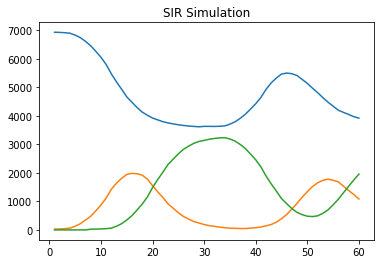

Giorno 60 :
Suscettibili: 3919
Infetti: 1084
Guariti: 1957
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             166 |
|      2 |   4949 |             156 |
|      3 |   3401 |              94 |
|      4 |   6136 |              82 |
|      5 |    581 |              71 |
|      6 |   5842 |              69 |
|      7 |    166 |              67 |
|      8 |   4196 |              60 |
|      9 |   2732 |              57 |
|     10 |   1924 |              55 |
|     11 |   2447 |              53 |
|     12 |   4016 |              51 |
|     13 |   1103 |              49 |
|     14 |   2481 |              39 |
|     15 |   3706 |              38 |
+--------+--------+-----------------+


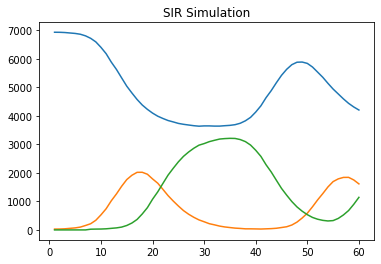

Giorno 60 :
Suscettibili: 4204
Infetti: 1614
Guariti: 1142
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             162 |
|      2 |   4949 |             156 |
|      3 |   3401 |             114 |
|      4 |    166 |              77 |
|      5 |   5842 |              71 |
|      6 |   6136 |              68 |
|      7 |    581 |              64 |
|      8 |   1924 |              59 |
|      9 |   2732 |              50 |
|     10 |   4016 |              48 |
|     11 |   2447 |              46 |
|     12 |   4406 |              42 |
|     13 |   4196 |              41 |
|     14 |   2481 |              38 |
|     15 |   3902 |              37 |
+--------+--------+-----------------+


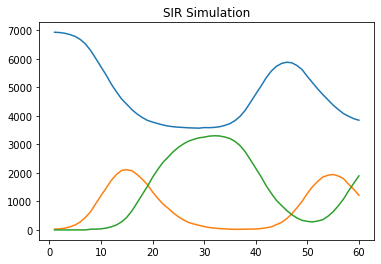

Giorno 60 :
Suscettibili: 3847
Infetti: 1218
Guariti: 1895
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             163 |
|      2 |   4949 |             159 |
|      3 |   3401 |              99 |
|      4 |    166 |              88 |
|      5 |   5842 |              86 |
|      6 |   6136 |              73 |
|      7 |   2732 |              63 |
|      8 |    581 |              60 |
|      9 |   2447 |              58 |
|     10 |   2481 |              53 |
|     11 |   1924 |              53 |
|     12 |   4196 |              50 |
|     13 |   4016 |              49 |
|     14 |   1103 |              49 |
|     15 |   4406 |              44 |
+--------+--------+-----------------+


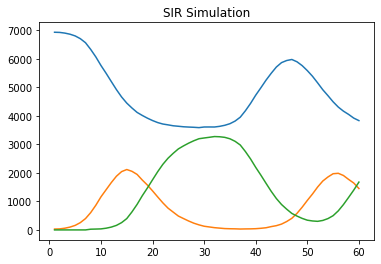

Giorno 60 :
Suscettibili: 3832
Infetti: 1452
Guariti: 1676
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             171 |
|      2 |   4949 |             161 |
|      3 |   3401 |             134 |
|      4 |   6136 |              98 |
|      5 |   1924 |              67 |
|      6 |    166 |              66 |
|      7 |   5842 |              65 |
|      8 |   2447 |              63 |
|      9 |    581 |              61 |
|     10 |   2732 |              60 |
|     11 |   4196 |              54 |
|     12 |   1103 |              50 |
|     13 |   3706 |              47 |
|     14 |   3285 |              45 |
|     15 |   1598 |              43 |
+--------+--------+-----------------+


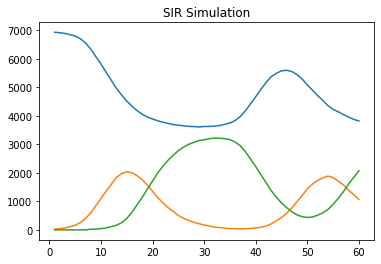

Giorno 60 :
Suscettibili: 3820
Infetti: 1065
Guariti: 2075
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             158 |
|      2 |   4949 |             154 |
|      3 |   3401 |             110 |
|      4 |   6136 |              76 |
|      5 |   1924 |              71 |
|      6 |    581 |              64 |
|      7 |    166 |              63 |
|      8 |   5842 |              62 |
|      9 |   3706 |              55 |
|     10 |   1103 |              53 |
|     11 |   2447 |              51 |
|     12 |   4016 |              46 |
|     13 |   2732 |              44 |
|     14 |   2352 |              39 |
|     15 |   4406 |              39 |
+--------+--------+-----------------+


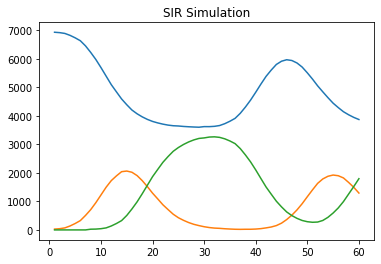

Giorno 60 :
Suscettibili: 3871
Infetti: 1293
Guariti: 1796
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             210 |
|      2 |   4949 |             171 |
|      3 |   3401 |             103 |
|      4 |   6136 |              91 |
|      5 |   5842 |              82 |
|      6 |    166 |              68 |
|      7 |   1924 |              53 |
|      8 |   1103 |              53 |
|      9 |   2732 |              52 |
|     10 |    581 |              51 |
|     11 |   4406 |              44 |
|     12 |   2447 |              42 |
|     13 |   2481 |              38 |
|     14 |   4016 |              35 |
|     15 |   5345 |              34 |
+--------+--------+-----------------+


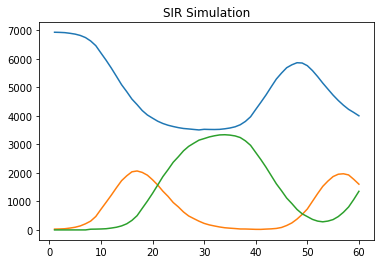

Giorno 60 :
Suscettibili: 4002
Infetti: 1604
Guariti: 1354
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             183 |
|      2 |   4949 |             164 |
|      3 |   3401 |             108 |
|      4 |   6136 |              91 |
|      5 |   2732 |              74 |
|      6 |    166 |              70 |
|      7 |   1924 |              69 |
|      8 |    581 |              65 |
|      9 |   5842 |              64 |
|     10 |   2447 |              54 |
|     11 |   1103 |              46 |
|     12 |   4196 |              45 |
|     13 |   3285 |              43 |
|     14 |   2481 |              40 |
|     15 |   3706 |              39 |
+--------+--------+-----------------+


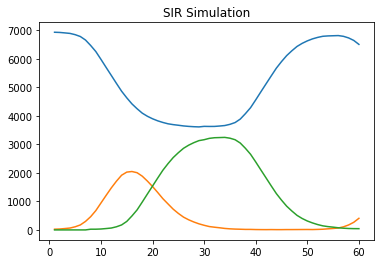

Giorno 60 :
Suscettibili: 6509
Infetti: 407
Guariti: 44
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             145 |
|      2 |   3401 |             136 |
|      3 |   4949 |              90 |
|      4 |   6136 |              70 |
|      5 |   4196 |              55 |
|      6 |   1103 |              49 |
|      7 |   1924 |              44 |
|      8 |   5842 |              35 |
|      9 |    581 |              33 |
|     10 |    166 |              27 |
|     11 |   3706 |              27 |
|     12 |   2732 |              26 |
|     13 |   1598 |              25 |
|     14 |   2447 |              21 |
|     15 |   2466 |              21 |
+--------+--------+-----------------+


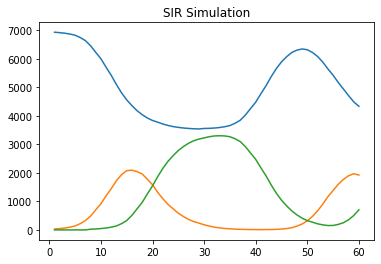

Giorno 60 :
Suscettibili: 4333
Infetti: 1922
Guariti: 705
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             177 |
|      2 |   4949 |             154 |
|      3 |   3401 |              94 |
|      4 |   5842 |              73 |
|      5 |    581 |              63 |
|      6 |    166 |              61 |
|      7 |   2447 |              56 |
|      8 |   1924 |              56 |
|      9 |   2732 |              53 |
|     10 |   4196 |              50 |
|     11 |   6136 |              46 |
|     12 |   5945 |              45 |
|     13 |   3285 |              42 |
|     14 |   1103 |              42 |
|     15 |   3902 |              40 |
+--------+--------+-----------------+


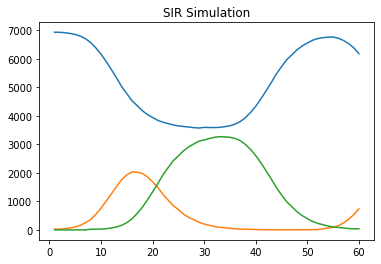

Giorno 60 :
Suscettibili: 6182
Infetti: 737
Guariti: 41
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   3401 |             134 |
|      2 |   4949 |             124 |
|      3 |   1773 |             108 |
|      4 |    166 |              65 |
|      5 |   6136 |              61 |
|      6 |   2732 |              51 |
|      7 |   2481 |              47 |
|      8 |   5842 |              45 |
|      9 |    581 |              41 |
|     10 |   2447 |              32 |
|     11 |   1103 |              29 |
|     12 |   1924 |              28 |
|     13 |   1883 |              27 |
|     14 |    274 |              26 |
|     15 |    485 |              24 |
+--------+--------+-----------------+


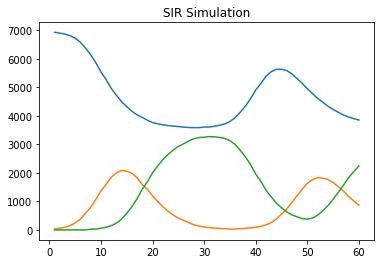

Giorno 60 :
Suscettibili: 3853
Infetti: 863
Guariti: 2244
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             162 |
|      2 |   4949 |             151 |
|      3 |   3401 |             110 |
|      4 |   5842 |              81 |
|      5 |   6136 |              71 |
|      6 |    166 |              64 |
|      7 |   2447 |              60 |
|      8 |   1924 |              58 |
|      9 |   3706 |              58 |
|     10 |   4016 |              53 |
|     11 |   2732 |              51 |
|     12 |    581 |              49 |
|     13 |   4196 |              46 |
|     14 |   1103 |              40 |
|     15 |   4639 |              32 |
+--------+--------+-----------------+


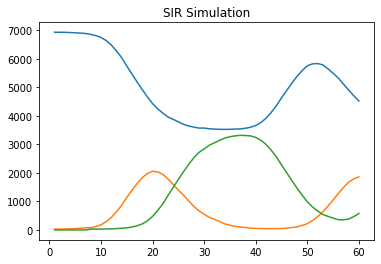

Giorno 60 :
Suscettibili: 4523
Infetti: 1859
Guariti: 578
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             165 |
|      2 |   4949 |             133 |
|      3 |   3401 |             120 |
|      4 |   6136 |              68 |
|      5 |   1924 |              66 |
|      6 |    166 |              66 |
|      7 |   2447 |              64 |
|      8 |   5842 |              61 |
|      9 |   1103 |              52 |
|     10 |    581 |              50 |
|     11 |   2732 |              50 |
|     12 |   3706 |              47 |
|     13 |   2481 |              43 |
|     14 |   3285 |              36 |
|     15 |   4016 |              36 |
+--------+--------+-----------------+


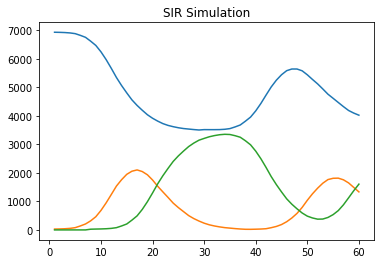

Giorno 60 :
Suscettibili: 4022
Infetti: 1333
Guariti: 1605
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             175 |
|      2 |   1773 |             144 |
|      3 |   3401 |              97 |
|      4 |   6136 |              96 |
|      5 |    166 |              82 |
|      6 |   5842 |              65 |
|      7 |   1924 |              65 |
|      8 |   1103 |              52 |
|      9 |   2447 |              52 |
|     10 |   2732 |              51 |
|     11 |    581 |              45 |
|     12 |   2481 |              40 |
|     13 |   4196 |              40 |
|     14 |   4406 |              40 |
|     15 |   4016 |              37 |
+--------+--------+-----------------+


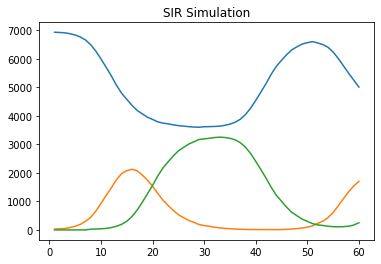

Giorno 60 :
Suscettibili: 5006
Infetti: 1702
Guariti: 252
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             161 |
|      2 |   4949 |             159 |
|      3 |   3401 |              98 |
|      4 |   6136 |              71 |
|      5 |   1103 |              69 |
|      6 |    166 |              66 |
|      7 |   5842 |              66 |
|      8 |   2732 |              65 |
|      9 |   4016 |              55 |
|     10 |   1924 |              54 |
|     11 |    581 |              52 |
|     12 |   2447 |              44 |
|     13 |   4406 |              43 |
|     14 |   4196 |              40 |
|     15 |   2466 |              39 |
+--------+--------+-----------------+


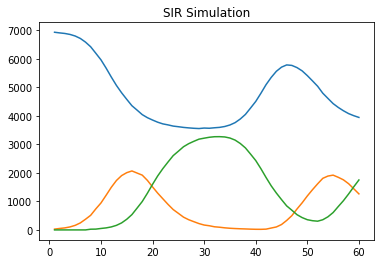

Giorno 60 :
Suscettibili: 3945
Infetti: 1264
Guariti: 1751
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             202 |
|      2 |   4949 |             181 |
|      3 |   3401 |             117 |
|      4 |   5842 |              77 |
|      5 |   1924 |              76 |
|      6 |   6136 |              71 |
|      7 |   2732 |              71 |
|      8 |    581 |              70 |
|      9 |    166 |              70 |
|     10 |   2447 |              47 |
|     11 |   1103 |              45 |
|     12 |   4196 |              38 |
|     13 |   3285 |              37 |
|     14 |   1598 |              36 |
|     15 |   3902 |              36 |
+--------+--------+-----------------+


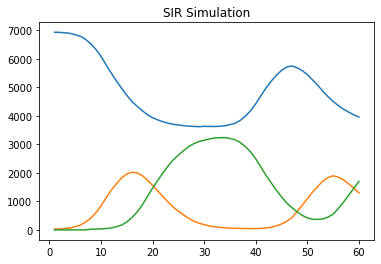

Giorno 60 :
Suscettibili: 3962
Infetti: 1300
Guariti: 1698
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             163 |
|      2 |   1773 |             158 |
|      3 |   3401 |             112 |
|      4 |   6136 |              81 |
|      5 |    581 |              77 |
|      6 |    166 |              72 |
|      7 |   1924 |              61 |
|      8 |   2732 |              56 |
|      9 |   5842 |              56 |
|     10 |   4016 |              54 |
|     11 |   2447 |              49 |
|     12 |   3706 |              47 |
|     13 |   1103 |              43 |
|     14 |   4196 |              37 |
|     15 |   2481 |              33 |
+--------+--------+-----------------+


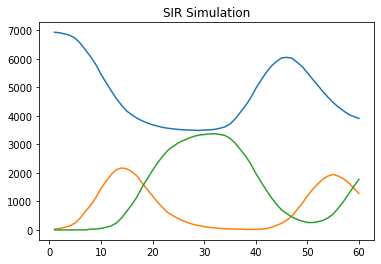

Giorno 60 :
Suscettibili: 3906
Infetti: 1280
Guariti: 1774
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             151 |
|      2 |   1773 |             139 |
|      3 |   6136 |             104 |
|      4 |   3401 |             103 |
|      5 |   5842 |              72 |
|      6 |    166 |              70 |
|      7 |   1924 |              63 |
|      8 |    581 |              60 |
|      9 |   2732 |              60 |
|     10 |   4406 |              47 |
|     11 |   3706 |              46 |
|     12 |   2481 |              45 |
|     13 |   4196 |              42 |
|     14 |   2447 |              36 |
|     15 |   1103 |              33 |
+--------+--------+-----------------+


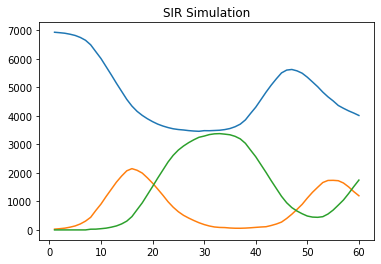

Giorno 60 :
Suscettibili: 4014
Infetti: 1198
Guariti: 1748
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             159 |
|      2 |   4949 |             136 |
|      3 |   3401 |              97 |
|      4 |    166 |              85 |
|      5 |   6136 |              82 |
|      6 |   2447 |              70 |
|      7 |   5842 |              70 |
|      8 |   1103 |              63 |
|      9 |    581 |              58 |
|     10 |   3706 |              50 |
|     11 |   2732 |              49 |
|     12 |   2481 |              42 |
|     13 |   1924 |              42 |
|     14 |   3902 |              38 |
|     15 |   4016 |              37 |
+--------+--------+-----------------+


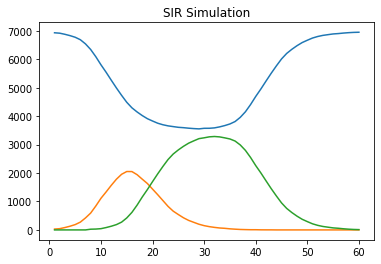

Giorno 60 :
Suscettibili: 6949
Infetti: 0
Guariti: 11
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |              89 |
|      2 |   4949 |              59 |
|      3 |    166 |              51 |
|      4 |   3401 |              50 |
|      5 |   6136 |              44 |
|      6 |   1924 |              39 |
|      7 |   2732 |              38 |
|      8 |   4196 |              29 |
|      9 |   5842 |              29 |
|     10 |   3706 |              27 |
|     11 |    581 |              25 |
|     12 |   1103 |              24 |
|     13 |   2481 |              23 |
|     14 |   2447 |              23 |
|     15 |   3285 |              22 |
+--------+--------+-----------------+


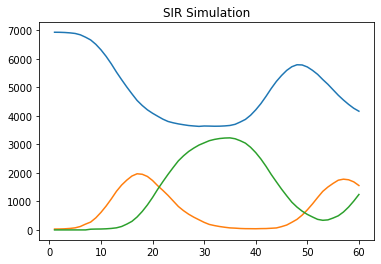

Giorno 60 :
Suscettibili: 4161
Infetti: 1557
Guariti: 1242
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             183 |
|      2 |   4949 |             144 |
|      3 |   6136 |              98 |
|      4 |   3401 |              81 |
|      5 |    166 |              79 |
|      6 |   1924 |              76 |
|      7 |    581 |              57 |
|      8 |   2447 |              57 |
|      9 |   5842 |              56 |
|     10 |   2732 |              47 |
|     11 |   3706 |              46 |
|     12 |   2466 |              43 |
|     13 |   4016 |              40 |
|     14 |   1103 |              39 |
|     15 |   1598 |              38 |
+--------+--------+-----------------+


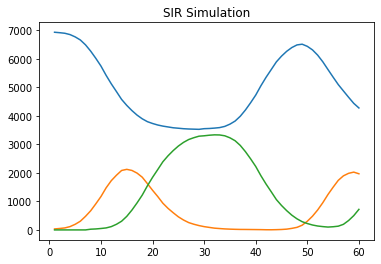

Giorno 60 :
Suscettibili: 4273
Infetti: 1967
Guariti: 720
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             174 |
|      2 |   1773 |             168 |
|      3 |   3401 |             111 |
|      4 |   6136 |              89 |
|      5 |    166 |              81 |
|      6 |   5842 |              64 |
|      7 |   2732 |              61 |
|      8 |   1924 |              61 |
|      9 |   2447 |              59 |
|     10 |   1103 |              57 |
|     11 |    581 |              54 |
|     12 |   4016 |              39 |
|     13 |   4196 |              38 |
|     14 |   1598 |              37 |
|     15 |   2481 |              35 |
+--------+--------+-----------------+


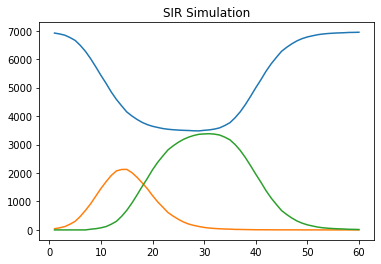

Giorno 60 :
Suscettibili: 6946
Infetti: 0
Guariti: 14
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             113 |
|      2 |   4949 |              92 |
|      3 |   3401 |              65 |
|      4 |   6136 |              37 |
|      5 |    166 |              35 |
|      6 |   2732 |              33 |
|      7 |   5842 |              33 |
|      8 |   1924 |              29 |
|      9 |   4196 |              26 |
|     10 |   1103 |              26 |
|     11 |     93 |              21 |
|     12 |   3285 |              21 |
|     13 |   4016 |              20 |
|     14 |   4406 |              20 |
|     15 |   1883 |              20 |
+--------+--------+-----------------+


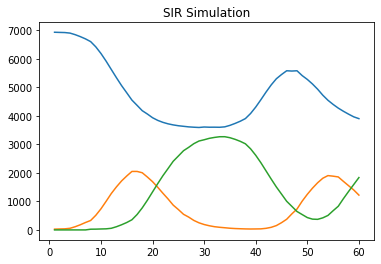

Giorno 60 :
Suscettibili: 3903
Infetti: 1221
Guariti: 1836
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             161 |
|      2 |   1773 |             151 |
|      3 |   3401 |             123 |
|      4 |   5842 |              81 |
|      5 |   6136 |              79 |
|      6 |   1924 |              72 |
|      7 |   2447 |              59 |
|      8 |   2732 |              58 |
|      9 |    166 |              58 |
|     10 |   3706 |              52 |
|     11 |    581 |              50 |
|     12 |   4196 |              44 |
|     13 |   4406 |              44 |
|     14 |   1103 |              38 |
|     15 |   3285 |              38 |
+--------+--------+-----------------+


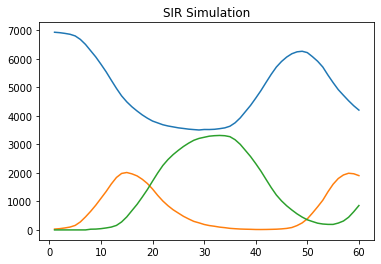

Giorno 60 :
Suscettibili: 4201
Infetti: 1904
Guariti: 855
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             176 |
|      2 |   4949 |             161 |
|      3 |   3401 |             128 |
|      4 |   6136 |              88 |
|      5 |   5842 |              71 |
|      6 |    166 |              70 |
|      7 |    581 |              67 |
|      8 |   2732 |              66 |
|      9 |   1924 |              66 |
|     10 |   1103 |              56 |
|     11 |   3706 |              53 |
|     12 |   2447 |              49 |
|     13 |   4196 |              42 |
|     14 |   4016 |              41 |
|     15 |   2481 |              40 |
+--------+--------+-----------------+


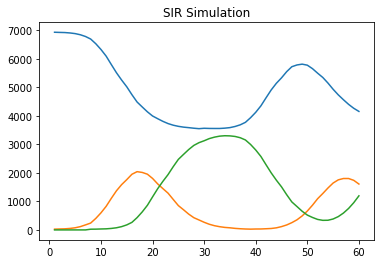

Giorno 60 :
Suscettibili: 4156
Infetti: 1609
Guariti: 1195
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             176 |
|      2 |   4949 |             129 |
|      3 |   3401 |             102 |
|      4 |   6136 |              94 |
|      5 |   1103 |              67 |
|      6 |   1924 |              64 |
|      7 |    166 |              62 |
|      8 |   5842 |              61 |
|      9 |   2732 |              48 |
|     10 |    581 |              46 |
|     11 |   4016 |              44 |
|     12 |   2481 |              43 |
|     13 |   2447 |              42 |
|     14 |   4196 |              38 |
|     15 |   3706 |              38 |
+--------+--------+-----------------+


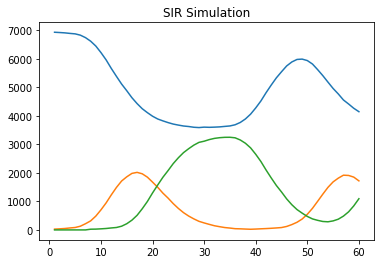

Giorno 60 :
Suscettibili: 4146
Infetti: 1720
Guariti: 1094
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             164 |
|      2 |   4949 |             139 |
|      3 |   6136 |              95 |
|      4 |   2732 |              80 |
|      5 |    166 |              74 |
|      6 |   3401 |              73 |
|      7 |   1924 |              65 |
|      8 |    581 |              62 |
|      9 |   5842 |              60 |
|     10 |   2447 |              57 |
|     11 |   1103 |              47 |
|     12 |   3285 |              46 |
|     13 |   4016 |              42 |
|     14 |   4196 |              41 |
|     15 |   2481 |              40 |
+--------+--------+-----------------+


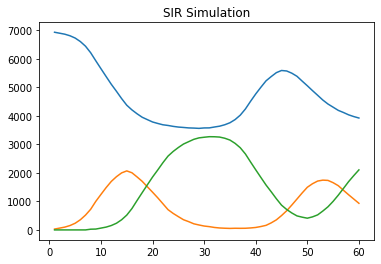

Giorno 60 :
Suscettibili: 3923
Infetti: 933
Guariti: 2104
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             165 |
|      2 |   4949 |             142 |
|      3 |   3401 |              86 |
|      4 |   6136 |              86 |
|      5 |   5842 |              74 |
|      6 |    166 |              68 |
|      7 |   2732 |              59 |
|      8 |   1924 |              56 |
|      9 |    581 |              46 |
|     10 |   2447 |              45 |
|     11 |   4016 |              43 |
|     12 |   3706 |              43 |
|     13 |     93 |              42 |
|     14 |   1103 |              38 |
|     15 |    792 |              37 |
+--------+--------+-----------------+


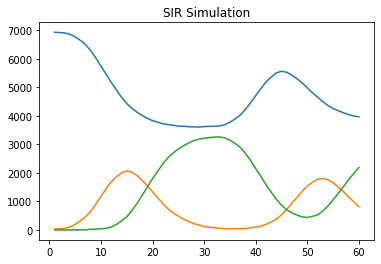

Giorno 60 :
Suscettibili: 3965
Infetti: 808
Guariti: 2187
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             169 |
|      2 |   4949 |             164 |
|      3 |   3401 |             104 |
|      4 |    166 |              72 |
|      5 |   5842 |              69 |
|      6 |   6136 |              64 |
|      7 |    581 |              57 |
|      8 |   1924 |              55 |
|      9 |   2447 |              46 |
|     10 |   1103 |              45 |
|     11 |   3902 |              45 |
|     12 |   4016 |              44 |
|     13 |   3706 |              43 |
|     14 |   4196 |              43 |
|     15 |   2732 |              36 |
+--------+--------+-----------------+


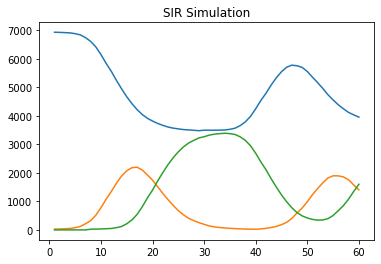

Giorno 60 :
Suscettibili: 3955
Infetti: 1404
Guariti: 1601
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             190 |
|      2 |   4949 |             166 |
|      3 |   3401 |             102 |
|      4 |   6136 |              94 |
|      5 |   5842 |              64 |
|      6 |    166 |              63 |
|      7 |   1924 |              56 |
|      8 |   2732 |              55 |
|      9 |   4196 |              52 |
|     10 |    581 |              51 |
|     11 |   1103 |              48 |
|     12 |   2447 |              47 |
|     13 |   3285 |              41 |
|     14 |   4016 |              39 |
|     15 |   2481 |              39 |
+--------+--------+-----------------+


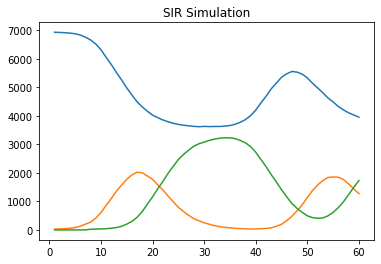

Giorno 60 :
Suscettibili: 3953
Infetti: 1275
Guariti: 1732
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             176 |
|      2 |   1773 |             142 |
|      3 |   3401 |             106 |
|      4 |    166 |              83 |
|      5 |   1924 |              78 |
|      6 |    581 |              74 |
|      7 |   5842 |              67 |
|      8 |   1103 |              62 |
|      9 |   6136 |              61 |
|     10 |   2732 |              54 |
|     11 |   2447 |              49 |
|     12 |   4016 |              48 |
|     13 |   4406 |              44 |
|     14 |   1598 |              44 |
|     15 |   3706 |              40 |
+--------+--------+-----------------+


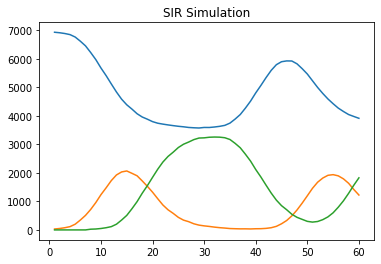

Giorno 60 :
Suscettibili: 3912
Infetti: 1223
Guariti: 1825
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             169 |
|      2 |   4949 |             167 |
|      3 |   3401 |             102 |
|      4 |    166 |              85 |
|      5 |   6136 |              79 |
|      6 |   5842 |              69 |
|      7 |   4016 |              63 |
|      8 |   1924 |              54 |
|      9 |   2732 |              50 |
|     10 |   2447 |              50 |
|     11 |   2481 |              48 |
|     12 |   1103 |              46 |
|     13 |   1598 |              45 |
|     14 |    581 |              38 |
|     15 |   4406 |              35 |
+--------+--------+-----------------+


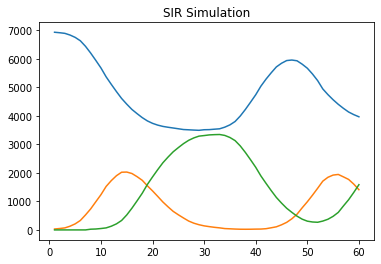

Giorno 60 :
Suscettibili: 3965
Infetti: 1410
Guariti: 1585
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             167 |
|      2 |   1773 |             160 |
|      3 |   3401 |             103 |
|      4 |   6136 |              91 |
|      5 |   5842 |              75 |
|      6 |    166 |              74 |
|      7 |   1924 |              69 |
|      8 |    581 |              66 |
|      9 |   2732 |              58 |
|     10 |   2447 |              52 |
|     11 |   1103 |              51 |
|     12 |   3285 |              41 |
|     13 |   4016 |              40 |
|     14 |   4406 |              38 |
|     15 |     93 |              38 |
+--------+--------+-----------------+


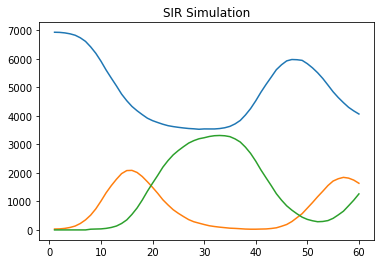

Giorno 60 :
Suscettibili: 4063
Infetti: 1635
Guariti: 1262
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             187 |
|      2 |   4949 |             149 |
|      3 |   3401 |             108 |
|      4 |   6136 |              82 |
|      5 |   5842 |              75 |
|      6 |    581 |              70 |
|      7 |    166 |              63 |
|      8 |   2732 |              55 |
|      9 |   1924 |              53 |
|     10 |   4016 |              52 |
|     11 |   1103 |              52 |
|     12 |   2447 |              49 |
|     13 |   2481 |              47 |
|     14 |   3285 |              43 |
|     15 |   2345 |              42 |
+--------+--------+-----------------+


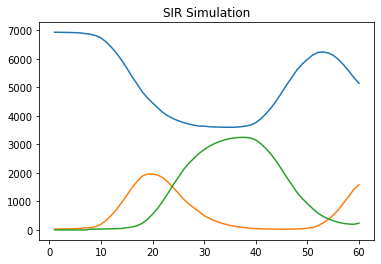

Giorno 60 :
Suscettibili: 5141
Infetti: 1582
Guariti: 237
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             165 |
|      2 |   3401 |             124 |
|      3 |   4949 |             120 |
|      4 |   6136 |              69 |
|      5 |   1924 |              68 |
|      6 |    581 |              48 |
|      7 |   2732 |              48 |
|      8 |   3285 |              47 |
|      9 |   1103 |              45 |
|     10 |   4196 |              42 |
|     11 |    166 |              41 |
|     12 |   5842 |              39 |
|     13 |   4016 |              39 |
|     14 |   4406 |              37 |
|     15 |   2481 |              35 |
+--------+--------+-----------------+


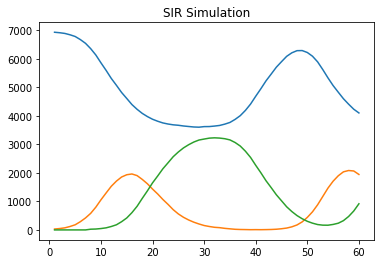

Giorno 60 :
Suscettibili: 4100
Infetti: 1944
Guariti: 916
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             159 |
|      2 |   4949 |             139 |
|      3 |   1924 |              86 |
|      4 |   3401 |              80 |
|      5 |   2447 |              78 |
|      6 |    166 |              70 |
|      7 |   6136 |              70 |
|      8 |   5842 |              70 |
|      9 |    581 |              65 |
|     10 |   2732 |              60 |
|     11 |   4016 |              52 |
|     12 |   1103 |              52 |
|     13 |   4196 |              42 |
|     14 |   4406 |              38 |
|     15 |   1598 |              36 |
+--------+--------+-----------------+


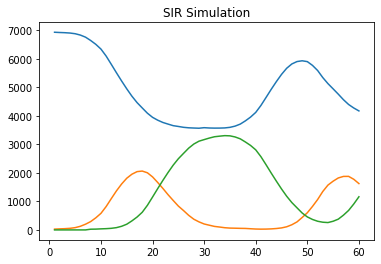

Giorno 60 :
Suscettibili: 4173
Infetti: 1625
Guariti: 1162
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             163 |
|      2 |   1773 |             161 |
|      3 |   3401 |              97 |
|      4 |   6136 |              80 |
|      5 |    166 |              77 |
|      6 |   5842 |              72 |
|      7 |   1924 |              62 |
|      8 |    581 |              49 |
|      9 |   4016 |              47 |
|     10 |   1103 |              46 |
|     11 |   2447 |              44 |
|     12 |   2732 |              44 |
|     13 |   4406 |              42 |
|     14 |   3706 |              42 |
|     15 |   2466 |              37 |
+--------+--------+-----------------+


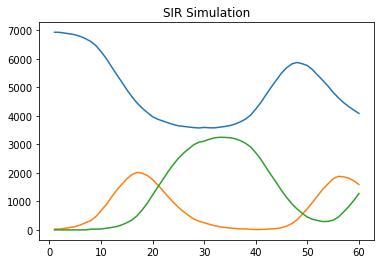

Giorno 60 :
Suscettibili: 4086
Infetti: 1596
Guariti: 1278
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             176 |
|      2 |   4949 |             162 |
|      3 |   3401 |             113 |
|      4 |   6136 |             103 |
|      5 |   5842 |              61 |
|      6 |   1924 |              61 |
|      7 |   2732 |              59 |
|      8 |    166 |              55 |
|      9 |   1103 |              50 |
|     10 |   2447 |              50 |
|     11 |    581 |              43 |
|     12 |   2997 |              42 |
|     13 |   6716 |              42 |
|     14 |   3706 |              42 |
|     15 |    792 |              40 |
+--------+--------+-----------------+


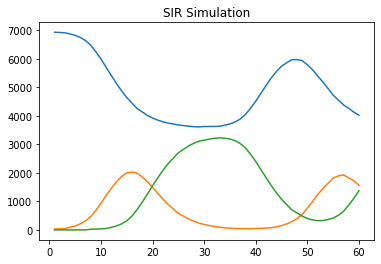

Giorno 60 :
Suscettibili: 4022
Infetti: 1563
Guariti: 1375
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             161 |
|      2 |   4949 |             144 |
|      3 |   3401 |             115 |
|      4 |   6136 |              83 |
|      5 |    581 |              77 |
|      6 |   1103 |              71 |
|      7 |    166 |              65 |
|      8 |   1924 |              62 |
|      9 |   2732 |              62 |
|     10 |   5842 |              60 |
|     11 |   2447 |              59 |
|     12 |   4196 |              51 |
|     13 |   4016 |              50 |
|     14 |   3706 |              48 |
|     15 |   3285 |              41 |
+--------+--------+-----------------+


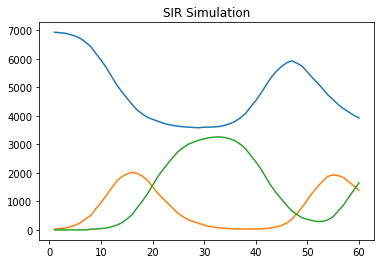

Giorno 60 :
Suscettibili: 3926
Infetti: 1387
Guariti: 1647
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             172 |
|      2 |   4949 |             145 |
|      3 |   3401 |             111 |
|      4 |   5842 |              81 |
|      5 |   1924 |              73 |
|      6 |    166 |              71 |
|      7 |   6136 |              71 |
|      8 |    581 |              65 |
|      9 |   4016 |              57 |
|     10 |   2447 |              52 |
|     11 |   2732 |              44 |
|     12 |   4406 |              39 |
|     13 |   3706 |              38 |
|     14 |   2481 |              37 |
|     15 |   5945 |              36 |
+--------+--------+-----------------+


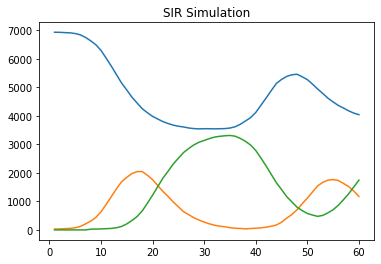

Giorno 60 :
Suscettibili: 4040
Infetti: 1175
Guariti: 1745
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             160 |
|      2 |   4949 |             145 |
|      3 |   3401 |             117 |
|      4 |   6136 |              89 |
|      5 |    581 |              65 |
|      6 |   2447 |              62 |
|      7 |    166 |              61 |
|      8 |   1924 |              59 |
|      9 |   2732 |              55 |
|     10 |   5842 |              51 |
|     11 |   1103 |              50 |
|     12 |   3706 |              45 |
|     13 |   4196 |              44 |
|     14 |   2481 |              40 |
|     15 |   3902 |              36 |
+--------+--------+-----------------+


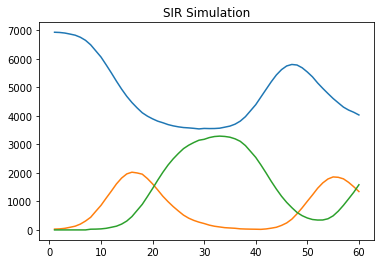

Giorno 60 :
Suscettibili: 4031
Infetti: 1346
Guariti: 1583
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             166 |
|      2 |   4949 |             130 |
|      3 |   3401 |             114 |
|      4 |    166 |              80 |
|      5 |   6136 |              78 |
|      6 |   5842 |              64 |
|      7 |   2732 |              62 |
|      8 |   2447 |              58 |
|      9 |    581 |              57 |
|     10 |   1924 |              45 |
|     11 |   1103 |              44 |
|     12 |   4406 |              40 |
|     13 |   2352 |              40 |
|     14 |   5945 |              37 |
|     15 |   3706 |              37 |
+--------+--------+-----------------+


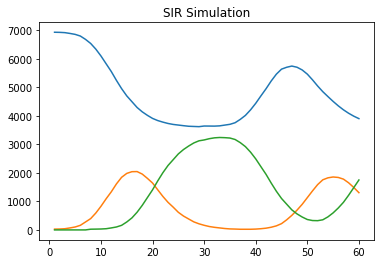

Giorno 60 :
Suscettibili: 3903
Infetti: 1306
Guariti: 1751
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             162 |
|      2 |   4949 |             143 |
|      3 |   3401 |             112 |
|      4 |   5842 |              88 |
|      5 |    581 |              74 |
|      6 |   6136 |              73 |
|      7 |   1924 |              72 |
|      8 |    166 |              66 |
|      9 |   2732 |              59 |
|     10 |   2447 |              59 |
|     11 |   1103 |              47 |
|     12 |   4406 |              40 |
|     13 |    675 |              37 |
|     14 |   2466 |              34 |
|     15 |   3285 |              33 |
+--------+--------+-----------------+


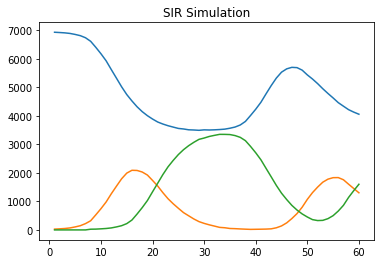

Giorno 60 :
Suscettibili: 4057
Infetti: 1302
Guariti: 1601
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             172 |
|      2 |   4949 |             163 |
|      3 |   3401 |             120 |
|      4 |    166 |              90 |
|      5 |   6136 |              77 |
|      6 |   1924 |              72 |
|      7 |   5842 |              63 |
|      8 |    581 |              59 |
|      9 |   2447 |              51 |
|     10 |   2732 |              49 |
|     11 |   4196 |              47 |
|     12 |   3706 |              43 |
|     13 |   3285 |              41 |
|     14 |   4016 |              38 |
|     15 |   4406 |              38 |
+--------+--------+-----------------+


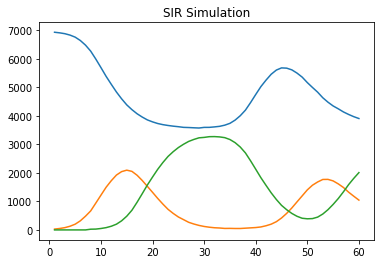

Giorno 60 :
Suscettibili: 3906
Infetti: 1045
Guariti: 2009
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             170 |
|      2 |   4949 |             161 |
|      3 |   3401 |             115 |
|      4 |   6136 |              88 |
|      5 |   2732 |              67 |
|      6 |   5842 |              63 |
|      7 |    581 |              62 |
|      8 |   1103 |              60 |
|      9 |    166 |              58 |
|     10 |   4016 |              43 |
|     11 |   2447 |              42 |
|     12 |   1924 |              41 |
|     13 |   3706 |              41 |
|     14 |   4196 |              38 |
|     15 |     93 |              36 |
+--------+--------+-----------------+


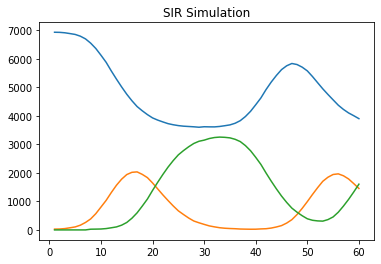

Giorno 60 :
Suscettibili: 3902
Infetti: 1454
Guariti: 1604
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             192 |
|      2 |   4949 |             145 |
|      3 |   3401 |             101 |
|      4 |   6136 |              76 |
|      5 |    166 |              75 |
|      6 |   2447 |              63 |
|      7 |   5842 |              62 |
|      8 |   1924 |              61 |
|      9 |   2732 |              60 |
|     10 |   1103 |              58 |
|     11 |    581 |              52 |
|     12 |   3706 |              49 |
|     13 |   2481 |              43 |
|     14 |   4016 |              42 |
|     15 |   3285 |              41 |
+--------+--------+-----------------+


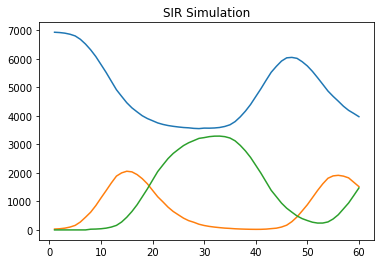

Giorno 60 :
Suscettibili: 3970
Infetti: 1519
Guariti: 1471
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             162 |
|      2 |   4949 |             152 |
|      3 |   3401 |              99 |
|      4 |   6136 |              80 |
|      5 |   5842 |              79 |
|      6 |    166 |              65 |
|      7 |   1924 |              64 |
|      8 |   2732 |              59 |
|      9 |   2447 |              59 |
|     10 |   4016 |              56 |
|     11 |   3706 |              54 |
|     12 |   1103 |              54 |
|     13 |   2481 |              46 |
|     14 |    581 |              45 |
|     15 |   4196 |              41 |
+--------+--------+-----------------+


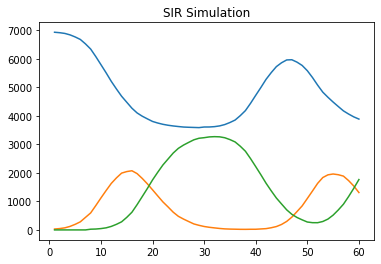

Giorno 60 :
Suscettibili: 3885
Infetti: 1310
Guariti: 1765
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             167 |
|      2 |   1773 |             143 |
|      3 |   3401 |             102 |
|      4 |   5842 |              79 |
|      5 |   6136 |              68 |
|      6 |   1924 |              66 |
|      7 |    166 |              62 |
|      8 |    581 |              58 |
|      9 |   2732 |              55 |
|     10 |   4406 |              53 |
|     11 |   2447 |              47 |
|     12 |   3706 |              46 |
|     13 |   1103 |              42 |
|     14 |   1883 |              40 |
|     15 |   1598 |              39 |
+--------+--------+-----------------+


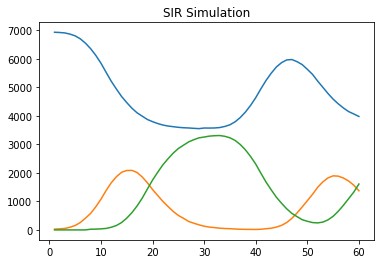

Giorno 60 :
Suscettibili: 3979
Infetti: 1372
Guariti: 1609
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             185 |
|      2 |   4949 |             141 |
|      3 |   3401 |             109 |
|      4 |   6136 |              97 |
|      5 |    166 |              96 |
|      6 |   5842 |              87 |
|      7 |    581 |              67 |
|      8 |   1924 |              60 |
|      9 |   2732 |              54 |
|     10 |   2447 |              53 |
|     11 |   3706 |              51 |
|     12 |   4016 |              47 |
|     13 |   1103 |              43 |
|     14 |   2481 |              43 |
|     15 |   4406 |              40 |
+--------+--------+-----------------+


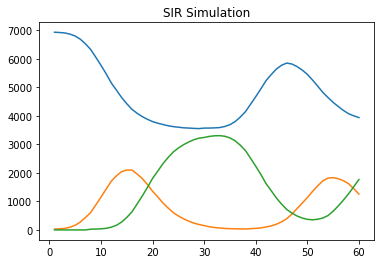

Giorno 60 :
Suscettibili: 3938
Infetti: 1256
Guariti: 1766
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             169 |
|      2 |   1773 |             163 |
|      3 |   3401 |             100 |
|      4 |    166 |              86 |
|      5 |   6136 |              77 |
|      6 |   1924 |              73 |
|      7 |   5842 |              68 |
|      8 |   1103 |              63 |
|      9 |   2732 |              61 |
|     10 |    581 |              59 |
|     11 |   2447 |              51 |
|     12 |   3706 |              49 |
|     13 |   4016 |              45 |
|     14 |   4196 |              41 |
|     15 |   1598 |              41 |
+--------+--------+-----------------+


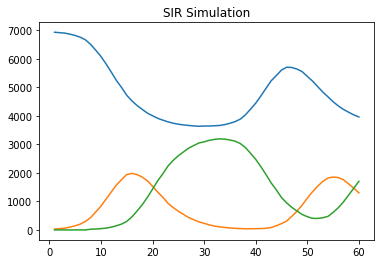

Giorno 60 :
Suscettibili: 3958
Infetti: 1299
Guariti: 1703
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             169 |
|      2 |   4949 |             164 |
|      3 |   3401 |             104 |
|      4 |   6136 |              98 |
|      5 |    166 |              81 |
|      6 |   5842 |              63 |
|      7 |    581 |              59 |
|      8 |   2732 |              58 |
|      9 |   2447 |              53 |
|     10 |   1924 |              48 |
|     11 |   1103 |              46 |
|     12 |   3706 |              46 |
|     13 |   4016 |              45 |
|     14 |   3285 |              41 |
|     15 |   1883 |              37 |
+--------+--------+-----------------+


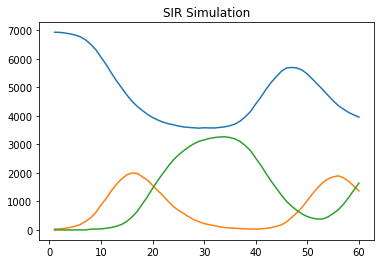

Giorno 60 :
Suscettibili: 3955
Infetti: 1368
Guariti: 1637
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             180 |
|      2 |   1773 |             165 |
|      3 |   3401 |             118 |
|      4 |   6136 |              83 |
|      5 |    166 |              81 |
|      6 |   1924 |              64 |
|      7 |   2732 |              55 |
|      8 |   5842 |              51 |
|      9 |   1103 |              51 |
|     10 |    581 |              50 |
|     11 |   4016 |              46 |
|     12 |   4196 |              43 |
|     13 |   2447 |              42 |
|     14 |   4406 |              39 |
|     15 |   5945 |              37 |
+--------+--------+-----------------+


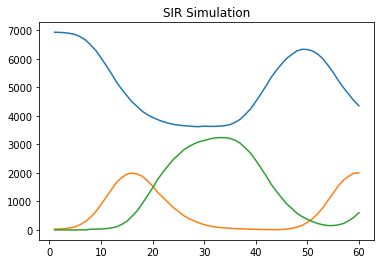

Giorno 60 :
Suscettibili: 4353
Infetti: 2001
Guariti: 606
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             181 |
|      2 |   4949 |             173 |
|      3 |   3401 |             127 |
|      4 |   1924 |              81 |
|      5 |   5842 |              76 |
|      6 |   6136 |              72 |
|      7 |    166 |              58 |
|      8 |   2732 |              56 |
|      9 |   2447 |              55 |
|     10 |   1103 |              49 |
|     11 |   4196 |              45 |
|     12 |    581 |              44 |
|     13 |   4406 |              43 |
|     14 |   2481 |              39 |
|     15 |    675 |              38 |
+--------+--------+-----------------+


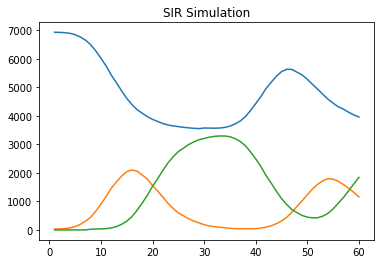

Giorno 60 :
Suscettibili: 3958
Infetti: 1158
Guariti: 1844
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             186 |
|      2 |   4949 |             174 |
|      3 |   3401 |             102 |
|      4 |   5842 |              77 |
|      5 |   6136 |              74 |
|      6 |   1924 |              60 |
|      7 |    166 |              60 |
|      8 |   2732 |              54 |
|      9 |    581 |              49 |
|     10 |   2481 |              47 |
|     11 |   1103 |              45 |
|     12 |   3706 |              39 |
|     13 |   4016 |              37 |
|     14 |   2352 |              35 |
|     15 |    792 |              34 |
+--------+--------+-----------------+


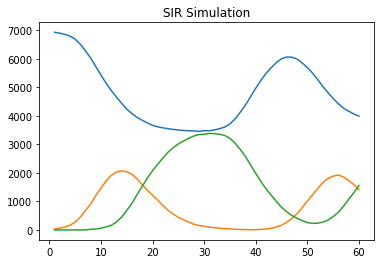

Giorno 60 :
Suscettibili: 3991
Infetti: 1413
Guariti: 1556
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             217 |
|      2 |   4949 |             149 |
|      3 |   3401 |             102 |
|      4 |   5842 |              75 |
|      5 |   6136 |              75 |
|      6 |    581 |              67 |
|      7 |   1924 |              61 |
|      8 |    166 |              54 |
|      9 |   4016 |              52 |
|     10 |   2447 |              43 |
|     11 |   2481 |              43 |
|     12 |   2732 |              41 |
|     13 |   2345 |              40 |
|     14 |   3706 |              39 |
|     15 |   1103 |              38 |
+--------+--------+-----------------+


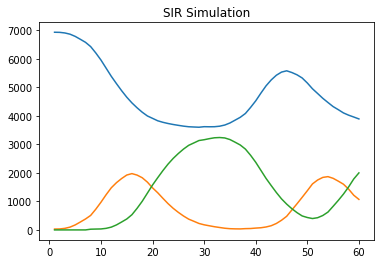

Giorno 60 :
Suscettibili: 3891
Infetti: 1070
Guariti: 1999
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             156 |
|      2 |   4949 |             129 |
|      3 |   3401 |             106 |
|      4 |    166 |              89 |
|      5 |   6136 |              81 |
|      6 |   5842 |              57 |
|      7 |    581 |              56 |
|      8 |   2447 |              56 |
|      9 |   1103 |              54 |
|     10 |   1924 |              53 |
|     11 |   3706 |              52 |
|     12 |   2732 |              51 |
|     13 |   4016 |              47 |
|     14 |   1598 |              36 |
|     15 |   5269 |              36 |
+--------+--------+-----------------+


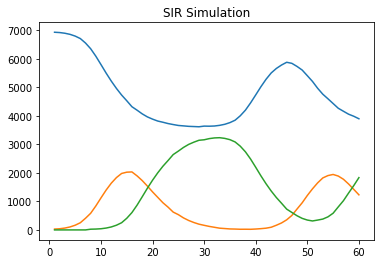

Giorno 60 :
Suscettibili: 3897
Infetti: 1230
Guariti: 1833
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             180 |
|      2 |   1773 |             159 |
|      3 |   3401 |              90 |
|      4 |    166 |              71 |
|      5 |   1924 |              68 |
|      6 |    581 |              67 |
|      7 |   5842 |              66 |
|      8 |   2447 |              65 |
|      9 |   6136 |              64 |
|     10 |   1103 |              53 |
|     11 |   3706 |              52 |
|     12 |   2732 |              46 |
|     13 |   4016 |              45 |
|     14 |   3285 |              42 |
|     15 |     93 |              38 |
+--------+--------+-----------------+


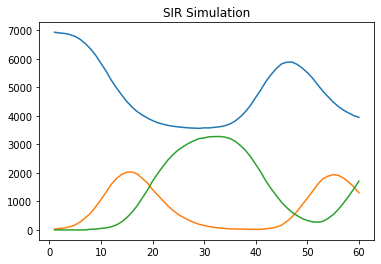

Giorno 60 :
Suscettibili: 3947
Infetti: 1301
Guariti: 1712
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             163 |
|      2 |   4949 |             160 |
|      3 |   3401 |             108 |
|      4 |   5842 |              79 |
|      5 |   6136 |              77 |
|      6 |    166 |              71 |
|      7 |   1924 |              67 |
|      8 |   2732 |              65 |
|      9 |    581 |              58 |
|     10 |   3285 |              50 |
|     11 |   4196 |              48 |
|     12 |   1103 |              48 |
|     13 |   2447 |              45 |
|     14 |   1598 |              39 |
|     15 |   1883 |              39 |
+--------+--------+-----------------+


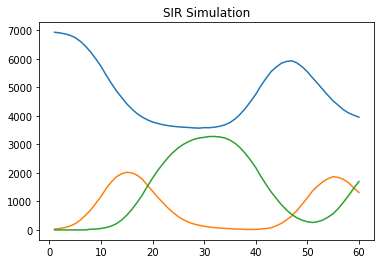

Giorno 60 :
Suscettibili: 3953
Infetti: 1310
Guariti: 1697
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             193 |
|      2 |   4949 |             180 |
|      3 |   3401 |             106 |
|      4 |    166 |              86 |
|      5 |   6136 |              83 |
|      6 |   1924 |              68 |
|      7 |    581 |              67 |
|      8 |   5842 |              55 |
|      9 |   2732 |              53 |
|     10 |   4016 |              46 |
|     11 |   3285 |              43 |
|     12 |   4196 |              42 |
|     13 |   3706 |              41 |
|     14 |   2447 |              41 |
|     15 |   2887 |              37 |
+--------+--------+-----------------+


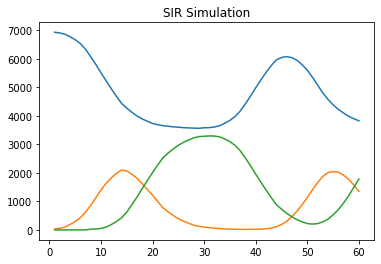

Giorno 60 :
Suscettibili: 3825
Infetti: 1353
Guariti: 1782
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             178 |
|      2 |   4949 |             159 |
|      3 |   3401 |             120 |
|      4 |   5842 |              90 |
|      5 |   6136 |              81 |
|      6 |    166 |              80 |
|      7 |   2345 |              53 |
|      8 |   2732 |              53 |
|      9 |   1924 |              51 |
|     10 |    581 |              47 |
|     11 |   4016 |              45 |
|     12 |   1103 |              43 |
|     13 |   4196 |              39 |
|     14 |   3285 |              37 |
|     15 |   1883 |              35 |
+--------+--------+-----------------+


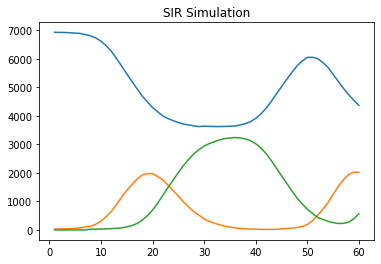

Giorno 60 :
Suscettibili: 4369
Infetti: 2021
Guariti: 570
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             177 |
|      2 |   4949 |             159 |
|      3 |   3401 |             138 |
|      4 |   1924 |              83 |
|      5 |   6136 |              82 |
|      6 |    166 |              73 |
|      7 |    581 |              72 |
|      8 |   5842 |              67 |
|      9 |   2732 |              66 |
|     10 |   1103 |              60 |
|     11 |   2447 |              57 |
|     12 |   1598 |              48 |
|     13 |   4196 |              46 |
|     14 |   3706 |              46 |
|     15 |   3285 |              44 |
+--------+--------+-----------------+


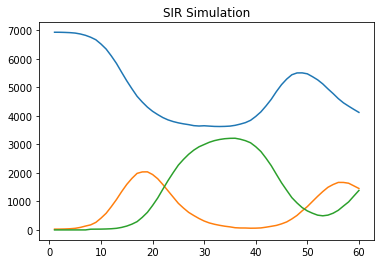

Giorno 60 :
Suscettibili: 4122
Infetti: 1454
Guariti: 1384
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             164 |
|      2 |   4949 |             130 |
|      3 |   3401 |              96 |
|      4 |   6136 |              84 |
|      5 |    166 |              80 |
|      6 |    581 |              77 |
|      7 |   1924 |              60 |
|      8 |   5842 |              56 |
|      9 |   2732 |              54 |
|     10 |   2447 |              52 |
|     11 |   4406 |              44 |
|     12 |   1103 |              43 |
|     13 |   3902 |              40 |
|     14 |   4196 |              40 |
|     15 |     93 |              36 |
+--------+--------+-----------------+


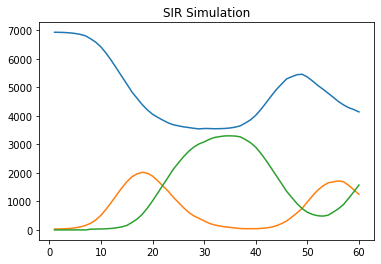

Giorno 60 :
Suscettibili: 4137
Infetti: 1250
Guariti: 1573
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             158 |
|      2 |   1773 |             155 |
|      3 |   3401 |             104 |
|      4 |   6136 |              81 |
|      5 |   1924 |              73 |
|      6 |    166 |              68 |
|      7 |    581 |              54 |
|      8 |   2732 |              52 |
|      9 |   2447 |              51 |
|     10 |   4196 |              50 |
|     11 |   4016 |              49 |
|     12 |   2481 |              48 |
|     13 |   1103 |              48 |
|     14 |   5842 |              46 |
|     15 |   1598 |              41 |
+--------+--------+-----------------+


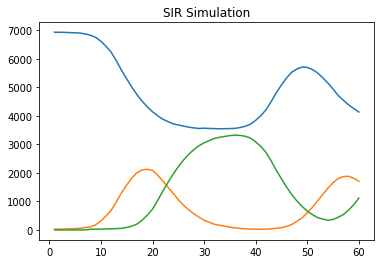

Giorno 60 :
Suscettibili: 4136
Infetti: 1708
Guariti: 1116
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             187 |
|      2 |   4949 |             152 |
|      3 |   3401 |             101 |
|      4 |   6136 |              79 |
|      5 |    581 |              71 |
|      6 |    166 |              71 |
|      7 |   5842 |              65 |
|      8 |   1924 |              61 |
|      9 |   2447 |              52 |
|     10 |   1103 |              51 |
|     11 |   2732 |              45 |
|     12 |   3706 |              45 |
|     13 |   4196 |              45 |
|     14 |   4406 |              45 |
|     15 |   4016 |              42 |
+--------+--------+-----------------+


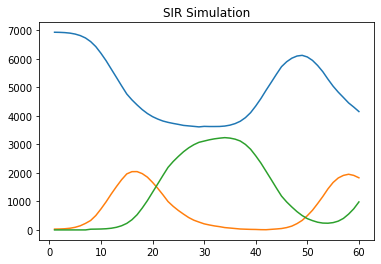

Giorno 60 :
Suscettibili: 4151
Infetti: 1828
Guariti: 981
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             174 |
|      2 |   4949 |             140 |
|      3 |   3401 |              98 |
|      4 |   5842 |              85 |
|      5 |   6136 |              81 |
|      6 |    166 |              69 |
|      7 |    581 |              65 |
|      8 |   2447 |              59 |
|      9 |   1924 |              48 |
|     10 |   2732 |              47 |
|     11 |   4016 |              40 |
|     12 |   4196 |              38 |
|     13 |   5269 |              37 |
|     14 |   1103 |              37 |
|     15 |   3285 |              35 |
+--------+--------+-----------------+


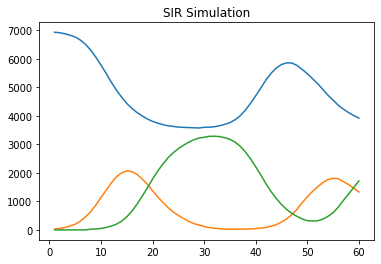

Giorno 60 :
Suscettibili: 3917
Infetti: 1329
Guariti: 1714
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             163 |
|      2 |   1773 |             155 |
|      3 |   3401 |              94 |
|      4 |   6136 |              72 |
|      5 |    581 |              71 |
|      6 |   5842 |              70 |
|      7 |   1924 |              66 |
|      8 |    166 |              64 |
|      9 |   1103 |              61 |
|     10 |   2447 |              53 |
|     11 |   3706 |              52 |
|     12 |   2732 |              44 |
|     13 |   1883 |              42 |
|     14 |   4016 |              41 |
|     15 |   3285 |              41 |
+--------+--------+-----------------+


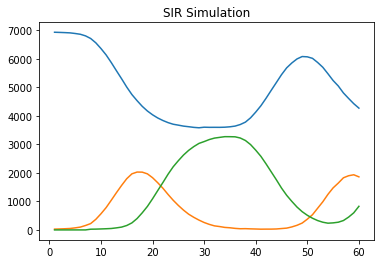

Giorno 60 :
Suscettibili: 4271
Infetti: 1861
Guariti: 828
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             192 |
|      2 |   1773 |             185 |
|      3 |   3401 |             108 |
|      4 |   6136 |              86 |
|      5 |    166 |              65 |
|      6 |   5842 |              53 |
|      7 |   2447 |              50 |
|      8 |   1924 |              49 |
|      9 |   1103 |              46 |
|     10 |    581 |              45 |
|     11 |   3706 |              44 |
|     12 |   2732 |              39 |
|     13 |   4196 |              38 |
|     14 |   4406 |              38 |
|     15 |   2997 |              37 |
+--------+--------+-----------------+


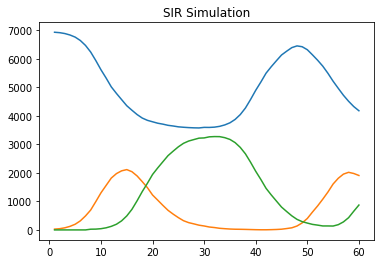

Giorno 60 :
Suscettibili: 4179
Infetti: 1909
Guariti: 872
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             174 |
|      2 |   4949 |             171 |
|      3 |   6136 |             102 |
|      4 |   3401 |             101 |
|      5 |    166 |              88 |
|      6 |   1924 |              87 |
|      7 |   1103 |              70 |
|      8 |    581 |              68 |
|      9 |   5842 |              67 |
|     10 |   2732 |              60 |
|     11 |   2447 |              57 |
|     12 |   4016 |              50 |
|     13 |   1598 |              38 |
|     14 |   4196 |              33 |
|     15 |   1883 |              32 |
+--------+--------+-----------------+


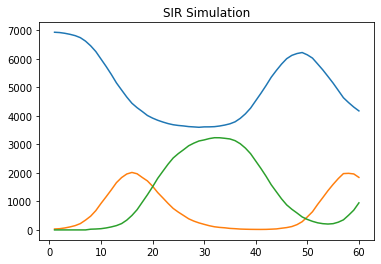

Giorno 60 :
Suscettibili: 4171
Infetti: 1841
Guariti: 948
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             187 |
|      2 |   4949 |             147 |
|      3 |   3401 |              99 |
|      4 |   6136 |              95 |
|      5 |    166 |              78 |
|      6 |   5842 |              66 |
|      7 |   1103 |              64 |
|      8 |    581 |              61 |
|      9 |   2732 |              57 |
|     10 |   1924 |              56 |
|     11 |   2447 |              49 |
|     12 |   3902 |              39 |
|     13 |   4406 |              37 |
|     14 |   2481 |              35 |
|     15 |   3285 |              35 |
+--------+--------+-----------------+


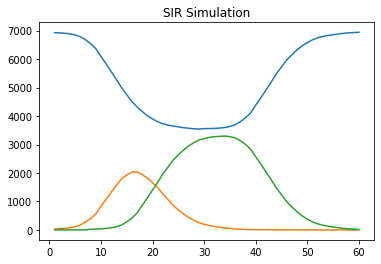

Giorno 60 :
Suscettibili: 6943
Infetti: 0
Guariti: 17
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |              94 |
|      2 |   1773 |              75 |
|      3 |   3401 |              64 |
|      4 |   6136 |              43 |
|      5 |   2447 |              38 |
|      6 |    166 |              33 |
|      7 |   5842 |              33 |
|      8 |    581 |              31 |
|      9 |   2732 |              30 |
|     10 |   3706 |              26 |
|     11 |   4016 |              25 |
|     12 |   1924 |              22 |
|     13 |   4196 |              20 |
|     14 |     93 |              19 |
|     15 |   2466 |              19 |
+--------+--------+-----------------+


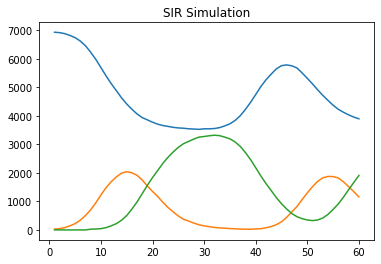

Giorno 60 :
Suscettibili: 3895
Infetti: 1157
Guariti: 1908
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             189 |
|      2 |   1773 |             144 |
|      3 |   3401 |             111 |
|      4 |   6136 |              82 |
|      5 |   1924 |              75 |
|      6 |    166 |              75 |
|      7 |    581 |              72 |
|      8 |   2732 |              69 |
|      9 |   5842 |              68 |
|     10 |   2447 |              51 |
|     11 |   1103 |              51 |
|     12 |   4196 |              48 |
|     13 |   3706 |              46 |
|     14 |   4016 |              46 |
|     15 |   4406 |              42 |
+--------+--------+-----------------+


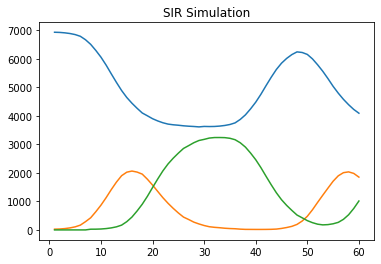

Giorno 60 :
Suscettibili: 4094
Infetti: 1852
Guariti: 1014
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             202 |
|      2 |   1773 |             179 |
|      3 |   3401 |             104 |
|      4 |   5842 |              80 |
|      5 |   6136 |              72 |
|      6 |    166 |              65 |
|      7 |   4196 |              63 |
|      8 |   1924 |              57 |
|      9 |   2732 |              56 |
|     10 |   4406 |              55 |
|     11 |    581 |              55 |
|     12 |   1103 |              53 |
|     13 |   4016 |              53 |
|     14 |   3706 |              48 |
|     15 |   2447 |              40 |
+--------+--------+-----------------+


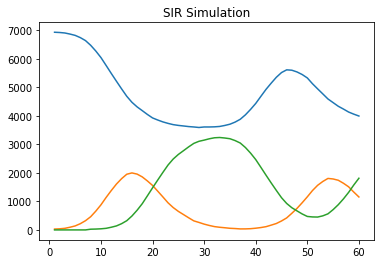

Giorno 60 :
Suscettibili: 3993
Infetti: 1155
Guariti: 1812
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             168 |
|      2 |   4949 |             147 |
|      3 |   3401 |             111 |
|      4 |    166 |              87 |
|      5 |   6136 |              86 |
|      6 |   5842 |              67 |
|      7 |   2447 |              59 |
|      8 |   3706 |              54 |
|      9 |   1924 |              54 |
|     10 |   1103 |              51 |
|     11 |    581 |              51 |
|     12 |   2732 |              51 |
|     13 |   4196 |              41 |
|     14 |   2481 |              37 |
|     15 |   4016 |              37 |
+--------+--------+-----------------+


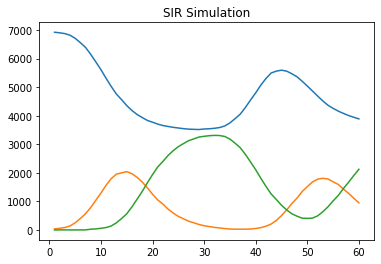

Giorno 60 :
Suscettibili: 3889
Infetti: 947
Guariti: 2124
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             166 |
|      2 |   1773 |             155 |
|      3 |   3401 |             104 |
|      4 |   1924 |              78 |
|      5 |    166 |              71 |
|      6 |   6136 |              70 |
|      7 |    581 |              69 |
|      8 |   5842 |              56 |
|      9 |   1103 |              49 |
|     10 |   2732 |              48 |
|     11 |   3706 |              42 |
|     12 |   6716 |              42 |
|     13 |   2447 |              40 |
|     14 |   2887 |              38 |
|     15 |   4406 |              38 |
+--------+--------+-----------------+


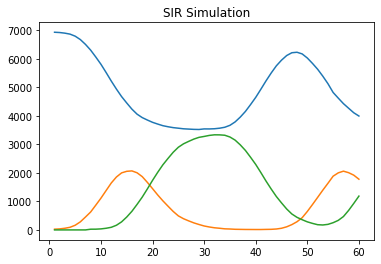

Giorno 60 :
Suscettibili: 3995
Infetti: 1779
Guariti: 1186
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             193 |
|      2 |   4949 |             168 |
|      3 |   3401 |              93 |
|      4 |    166 |              92 |
|      5 |   6136 |              89 |
|      6 |   2447 |              65 |
|      7 |    581 |              64 |
|      8 |   5842 |              62 |
|      9 |   2732 |              56 |
|     10 |   3285 |              50 |
|     11 |   1924 |              47 |
|     12 |   3706 |              45 |
|     13 |   2481 |              44 |
|     14 |   1103 |              41 |
|     15 |   4406 |              40 |
+--------+--------+-----------------+


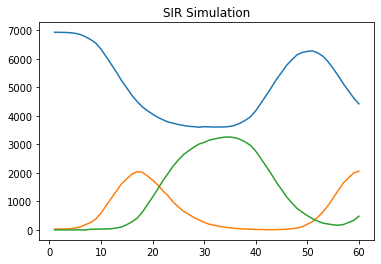

Giorno 60 :
Suscettibili: 4420
Infetti: 2059
Guariti: 481
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             176 |
|      2 |   1773 |             153 |
|      3 |   3401 |             119 |
|      4 |    166 |              89 |
|      5 |   1924 |              73 |
|      6 |   6136 |              68 |
|      7 |   5842 |              61 |
|      8 |   1103 |              55 |
|      9 |   3706 |              51 |
|     10 |    581 |              51 |
|     11 |   2732 |              45 |
|     12 |   4016 |              43 |
|     13 |   2466 |              40 |
|     14 |   2447 |              40 |
|     15 |   2481 |              38 |
+--------+--------+-----------------+


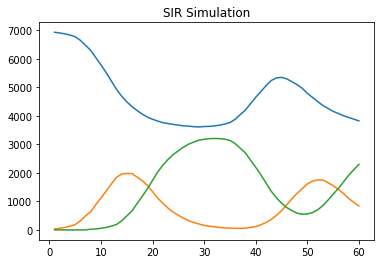

Giorno 60 :
Suscettibili: 3822
Infetti: 840
Guariti: 2298
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             150 |
|      2 |   4949 |             127 |
|      3 |    166 |              99 |
|      4 |   3401 |              98 |
|      5 |   6136 |              84 |
|      6 |   5842 |              77 |
|      7 |   1924 |              70 |
|      8 |    581 |              65 |
|      9 |   1103 |              61 |
|     10 |   4016 |              58 |
|     11 |   2732 |              54 |
|     12 |   2481 |              43 |
|     13 |   4196 |              41 |
|     14 |   2447 |              40 |
|     15 |   6716 |              40 |
+--------+--------+-----------------+


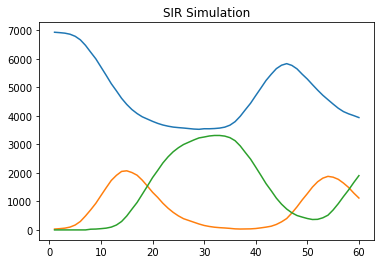

Giorno 60 :
Suscettibili: 3939
Infetti: 1118
Guariti: 1903
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             166 |
|      2 |   4949 |             139 |
|      3 |   3401 |             105 |
|      4 |   6136 |             102 |
|      5 |    166 |              81 |
|      6 |   5842 |              78 |
|      7 |   1924 |              74 |
|      8 |    581 |              68 |
|      9 |   2732 |              55 |
|     10 |   4016 |              50 |
|     11 |   2481 |              48 |
|     12 |   3706 |              47 |
|     13 |   4196 |              41 |
|     14 |   1103 |              37 |
|     15 |   1883 |              37 |
+--------+--------+-----------------+


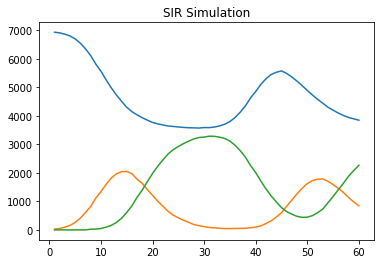

Giorno 60 :
Suscettibili: 3847
Infetti: 846
Guariti: 2267
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             166 |
|      2 |   4949 |             123 |
|      3 |   3401 |             110 |
|      4 |   6136 |             102 |
|      5 |   5842 |              73 |
|      6 |    166 |              68 |
|      7 |    581 |              62 |
|      8 |   1924 |              57 |
|      9 |   2447 |              56 |
|     10 |   1598 |              56 |
|     11 |   2732 |              50 |
|     12 |   1103 |              49 |
|     13 |   4196 |              45 |
|     14 |   4406 |              42 |
|     15 |   6716 |              41 |
+--------+--------+-----------------+


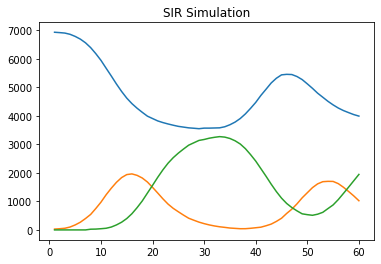

Giorno 60 :
Suscettibili: 3991
Infetti: 1023
Guariti: 1946
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             184 |
|      2 |   4949 |             148 |
|      3 |   3401 |             122 |
|      4 |   6136 |              73 |
|      5 |   5842 |              68 |
|      6 |    166 |              58 |
|      7 |    581 |              55 |
|      8 |   1924 |              53 |
|      9 |   2732 |              47 |
|     10 |   2447 |              47 |
|     11 |   3706 |              45 |
|     12 |   1103 |              42 |
|     13 |   4196 |              38 |
|     14 |   1883 |              35 |
|     15 |   3902 |              34 |
+--------+--------+-----------------+


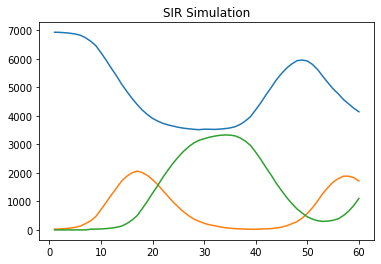

Giorno 60 :
Suscettibili: 4142
Infetti: 1713
Guariti: 1105
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             163 |
|      2 |   4949 |             163 |
|      3 |   3401 |             105 |
|      4 |   6136 |              82 |
|      5 |    166 |              75 |
|      6 |   5842 |              70 |
|      7 |   1103 |              60 |
|      8 |   1924 |              56 |
|      9 |    581 |              56 |
|     10 |   2732 |              54 |
|     11 |   4016 |              48 |
|     12 |   2447 |              48 |
|     13 |   4196 |              46 |
|     14 |   3706 |              41 |
|     15 |   1598 |              36 |
+--------+--------+-----------------+


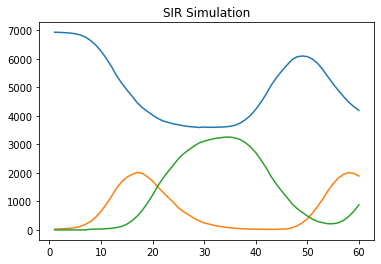

Giorno 60 :
Suscettibili: 4190
Infetti: 1890
Guariti: 880
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             160 |
|      2 |   4949 |             156 |
|      3 |   6136 |              89 |
|      4 |   3401 |              75 |
|      5 |   1924 |              65 |
|      6 |    166 |              61 |
|      7 |    581 |              61 |
|      8 |   2447 |              57 |
|      9 |   5842 |              55 |
|     10 |   4196 |              54 |
|     11 |   1103 |              52 |
|     12 |   4406 |              50 |
|     13 |   2732 |              48 |
|     14 |   3706 |              47 |
|     15 |   4016 |              45 |
+--------+--------+-----------------+


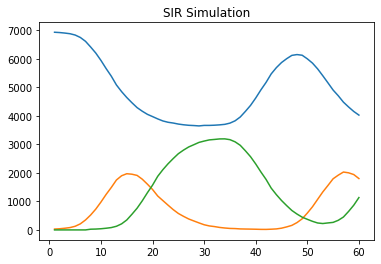

Giorno 60 :
Suscettibili: 4025
Infetti: 1801
Guariti: 1134
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             162 |
|      2 |   4949 |             161 |
|      3 |   3401 |             111 |
|      4 |   6136 |              67 |
|      5 |   2447 |              65 |
|      6 |   1924 |              63 |
|      7 |    581 |              60 |
|      8 |   2732 |              60 |
|      9 |    166 |              57 |
|     10 |   5842 |              53 |
|     11 |   1103 |              49 |
|     12 |   4406 |              44 |
|     13 |   2481 |              37 |
|     14 |   4016 |              37 |
|     15 |   6716 |              36 |
+--------+--------+-----------------+


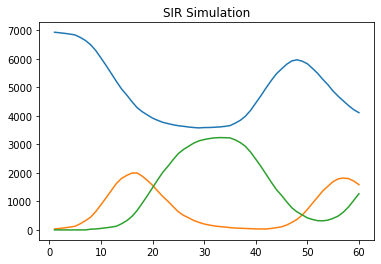

Giorno 60 :
Suscettibili: 4108
Infetti: 1586
Guariti: 1266
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             168 |
|      2 |   4949 |             158 |
|      3 |   3401 |              85 |
|      4 |    166 |              81 |
|      5 |   5842 |              70 |
|      6 |   6136 |              68 |
|      7 |   1924 |              67 |
|      8 |    581 |              60 |
|      9 |   1103 |              53 |
|     10 |   4196 |              51 |
|     11 |   2732 |              49 |
|     12 |   4016 |              45 |
|     13 |   1883 |              39 |
|     14 |   2481 |              38 |
|     15 |   3706 |              34 |
+--------+--------+-----------------+


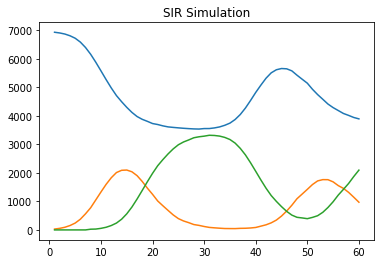

Giorno 60 :
Suscettibili: 3893
Infetti: 971
Guariti: 2096
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             170 |
|      2 |   4949 |             143 |
|      3 |   3401 |             101 |
|      4 |    166 |              84 |
|      5 |   6136 |              82 |
|      6 |   5842 |              82 |
|      7 |   1924 |              70 |
|      8 |    581 |              70 |
|      9 |   2732 |              58 |
|     10 |   1103 |              56 |
|     11 |   2447 |              52 |
|     12 |   3706 |              47 |
|     13 |   4016 |              46 |
|     14 |   2481 |              40 |
|     15 |   3285 |              39 |
+--------+--------+-----------------+


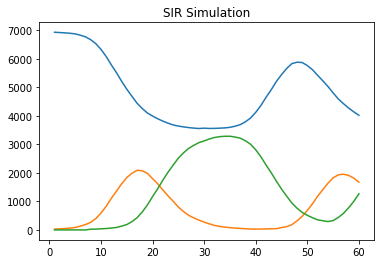

Giorno 60 :
Suscettibili: 4019
Infetti: 1674
Guariti: 1267
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             169 |
|      2 |   4949 |             168 |
|      3 |   3401 |             107 |
|      4 |   6136 |             100 |
|      5 |   5842 |              75 |
|      6 |    166 |              73 |
|      7 |   1924 |              67 |
|      8 |    581 |              57 |
|      9 |   3706 |              57 |
|     10 |   4406 |              51 |
|     11 |   4196 |              50 |
|     12 |   2732 |              48 |
|     13 |   1103 |              47 |
|     14 |   1598 |              44 |
|     15 |   3285 |              44 |
+--------+--------+-----------------+


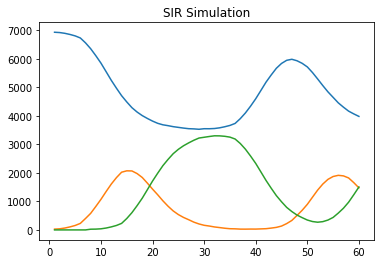

Giorno 60 :
Suscettibili: 3981
Infetti: 1475
Guariti: 1504
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             190 |
|      2 |   1773 |             173 |
|      3 |   3401 |             118 |
|      4 |   1924 |              78 |
|      5 |   6136 |              71 |
|      6 |    166 |              70 |
|      7 |   5842 |              64 |
|      8 |    581 |              58 |
|      9 |   2732 |              57 |
|     10 |   2447 |              51 |
|     11 |   3706 |              48 |
|     12 |   1103 |              46 |
|     13 |   4016 |              45 |
|     14 |   4196 |              39 |
|     15 |   4406 |              38 |
+--------+--------+-----------------+


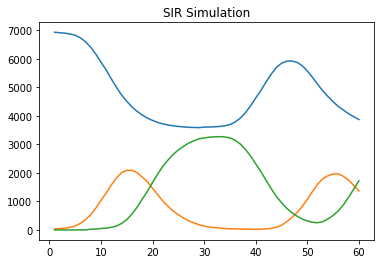

Giorno 60 :
Suscettibili: 3871
Infetti: 1369
Guariti: 1720
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             169 |
|      2 |   4949 |             164 |
|      3 |   3401 |             121 |
|      4 |    166 |              76 |
|      5 |    581 |              72 |
|      6 |   5842 |              70 |
|      7 |   6136 |              69 |
|      8 |   2732 |              69 |
|      9 |   1924 |              56 |
|     10 |   2447 |              50 |
|     11 |   1103 |              48 |
|     12 |   4016 |              45 |
|     13 |   3706 |              43 |
|     14 |   4639 |              42 |
|     15 |   2481 |              38 |
+--------+--------+-----------------+


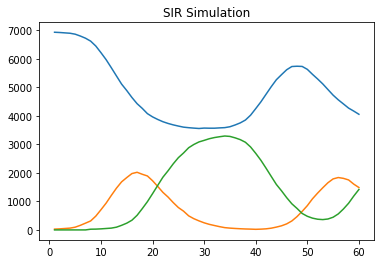

Giorno 60 :
Suscettibili: 4055
Infetti: 1487
Guariti: 1418
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             196 |
|      2 |   4949 |             164 |
|      3 |   3401 |             115 |
|      4 |    166 |              83 |
|      5 |   6136 |              69 |
|      6 |   1103 |              66 |
|      7 |    581 |              61 |
|      8 |   4196 |              57 |
|      9 |   4016 |              56 |
|     10 |   5842 |              51 |
|     11 |   1598 |              43 |
|     12 |   3706 |              43 |
|     13 |   2447 |              42 |
|     14 |   2732 |              42 |
|     15 |   1924 |              41 |
+--------+--------+-----------------+


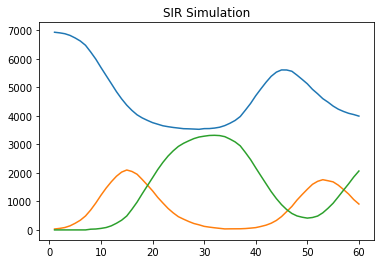

Giorno 60 :
Suscettibili: 3989
Infetti: 907
Guariti: 2064
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             191 |
|      2 |   4949 |             131 |
|      3 |   3401 |             125 |
|      4 |   5842 |              72 |
|      5 |   6136 |              70 |
|      6 |    581 |              67 |
|      7 |    166 |              64 |
|      8 |   2732 |              59 |
|      9 |   1924 |              55 |
|     10 |   1103 |              53 |
|     11 |   2447 |              52 |
|     12 |   4196 |              47 |
|     13 |   3706 |              45 |
|     14 |    675 |              41 |
|     15 |   3285 |              35 |
+--------+--------+-----------------+


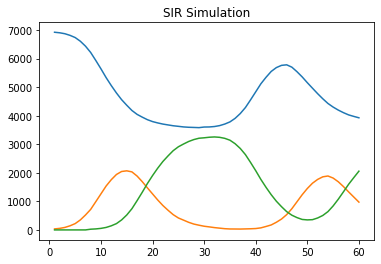

Giorno 60 :
Suscettibili: 3928
Infetti: 974
Guariti: 2058
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             173 |
|      2 |   4949 |             160 |
|      3 |   6136 |              99 |
|      4 |   3401 |              96 |
|      5 |   5842 |              78 |
|      6 |    166 |              77 |
|      7 |   1924 |              61 |
|      8 |    581 |              55 |
|      9 |   2732 |              53 |
|     10 |   3706 |              50 |
|     11 |   2481 |              43 |
|     12 |   2345 |              41 |
|     13 |   4016 |              40 |
|     14 |   2447 |              40 |
|     15 |   4406 |              38 |
+--------+--------+-----------------+


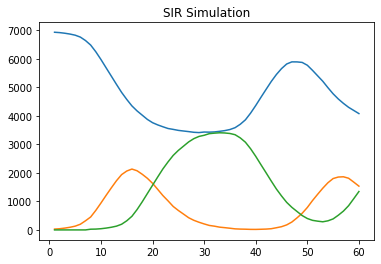

Giorno 60 :
Suscettibili: 4079
Infetti: 1535
Guariti: 1346
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             176 |
|      2 |   1773 |             176 |
|      3 |   3401 |              97 |
|      4 |   1924 |              84 |
|      5 |   6136 |              81 |
|      6 |    166 |              77 |
|      7 |   2732 |              72 |
|      8 |    581 |              72 |
|      9 |   1103 |              58 |
|     10 |   5842 |              50 |
|     11 |   2481 |              47 |
|     12 |   3285 |              45 |
|     13 |   2447 |              44 |
|     14 |   4016 |              43 |
|     15 |   3706 |              40 |
+--------+--------+-----------------+


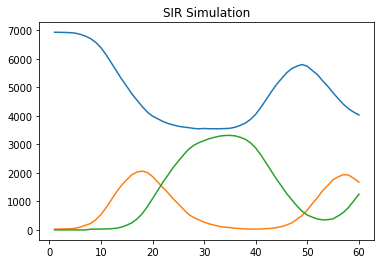

Giorno 60 :
Suscettibili: 4032
Infetti: 1677
Guariti: 1251
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             173 |
|      2 |   1773 |             159 |
|      3 |   3401 |             113 |
|      4 |    166 |              90 |
|      5 |   6136 |              79 |
|      6 |   2732 |              74 |
|      7 |   5842 |              66 |
|      8 |   1924 |              60 |
|      9 |   4196 |              54 |
|     10 |    581 |              53 |
|     11 |   3706 |              49 |
|     12 |   2447 |              48 |
|     13 |   1103 |              46 |
|     14 |   4406 |              36 |
|     15 |   2481 |              36 |
+--------+--------+-----------------+


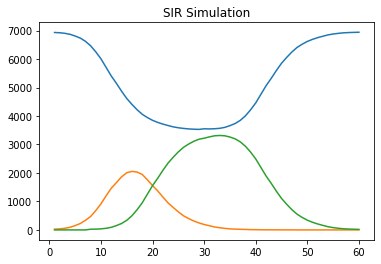

Giorno 60 :
Suscettibili: 6941
Infetti: 0
Guariti: 19
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |              88 |
|      2 |   1773 |              84 |
|      3 |   5842 |              52 |
|      4 |   3401 |              48 |
|      5 |   6136 |              44 |
|      6 |   2732 |              38 |
|      7 |   1103 |              34 |
|      8 |   1924 |              32 |
|      9 |    581 |              29 |
|     10 |   2447 |              26 |
|     11 |   4406 |              25 |
|     12 |   3706 |              23 |
|     13 |   2481 |              21 |
|     14 |   5345 |              19 |
|     15 |    166 |              19 |
+--------+--------+-----------------+


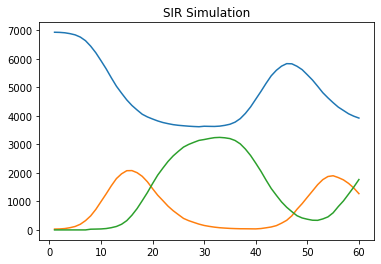

Giorno 60 :
Suscettibili: 3922
Infetti: 1272
Guariti: 1766
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             170 |
|      2 |   4949 |             165 |
|      3 |   3401 |             132 |
|      4 |   6136 |              89 |
|      5 |    166 |              76 |
|      6 |   5842 |              73 |
|      7 |   1924 |              65 |
|      8 |   1103 |              56 |
|      9 |   2732 |              52 |
|     10 |    581 |              49 |
|     11 |   2447 |              48 |
|     12 |   4196 |              39 |
|     13 |   1883 |              38 |
|     14 |   3706 |              38 |
|     15 |   2481 |              38 |
+--------+--------+-----------------+


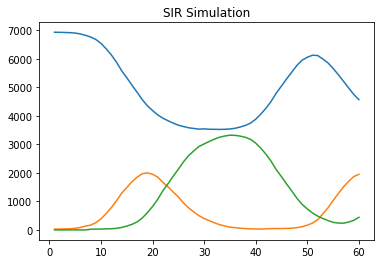

Giorno 60 :
Suscettibili: 4568
Infetti: 1949
Guariti: 443
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             188 |
|      2 |   3401 |             122 |
|      3 |   1773 |             122 |
|      4 |   1924 |              82 |
|      5 |   5842 |              68 |
|      6 |   6136 |              67 |
|      7 |   2732 |              66 |
|      8 |    166 |              66 |
|      9 |    581 |              63 |
|     10 |   2447 |              51 |
|     11 |   2345 |              47 |
|     12 |   3706 |              44 |
|     13 |   4016 |              40 |
|     14 |   2481 |              39 |
|     15 |   4406 |              39 |
+--------+--------+-----------------+


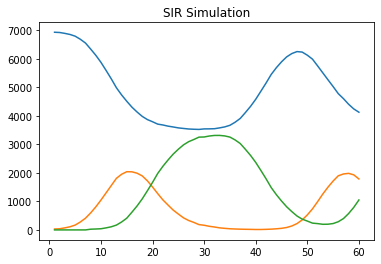

Giorno 60 :
Suscettibili: 4125
Infetti: 1786
Guariti: 1049
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             170 |
|      2 |   4949 |             155 |
|      3 |   3401 |             104 |
|      4 |    166 |              82 |
|      5 |   6136 |              75 |
|      6 |   1924 |              71 |
|      7 |    581 |              58 |
|      8 |   5842 |              48 |
|      9 |   1103 |              48 |
|     10 |   2481 |              43 |
|     11 |   2466 |              41 |
|     12 |   2447 |              40 |
|     13 |   4016 |              38 |
|     14 |   2732 |              38 |
|     15 |   3285 |              38 |
+--------+--------+-----------------+


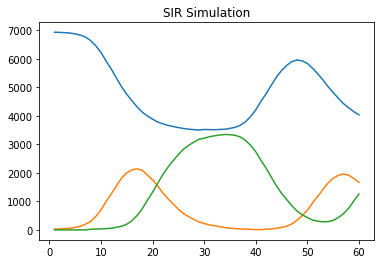

Giorno 60 :
Suscettibili: 4035
Infetti: 1666
Guariti: 1259
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             182 |
|      2 |   4949 |             163 |
|      3 |   3401 |              96 |
|      4 |   6136 |              78 |
|      5 |   1924 |              77 |
|      6 |   5842 |              70 |
|      7 |   2447 |              68 |
|      8 |    581 |              59 |
|      9 |    166 |              57 |
|     10 |   4016 |              56 |
|     11 |   2732 |              52 |
|     12 |   1103 |              52 |
|     13 |   2481 |              47 |
|     14 |   4196 |              42 |
|     15 |   1598 |              40 |
+--------+--------+-----------------+


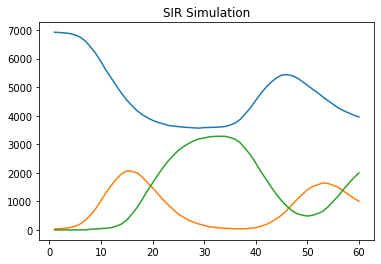

Giorno 60 :
Suscettibili: 3958
Infetti: 1006
Guariti: 1996
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             166 |
|      2 |   4949 |             153 |
|      3 |   3401 |             107 |
|      4 |   6136 |              93 |
|      5 |    166 |              79 |
|      6 |    581 |              77 |
|      7 |   1103 |              60 |
|      8 |   2447 |              52 |
|      9 |   4016 |              49 |
|     10 |   1924 |              48 |
|     11 |   2732 |              45 |
|     12 |   5842 |              45 |
|     13 |   4406 |              39 |
|     14 |   3706 |              39 |
|     15 |   1598 |              38 |
+--------+--------+-----------------+


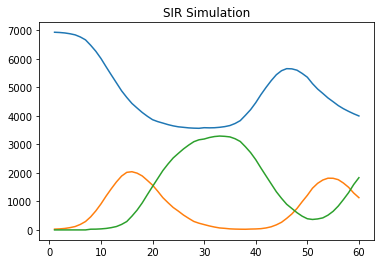

Giorno 60 :
Suscettibili: 3997
Infetti: 1131
Guariti: 1832
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             145 |
|      2 |   4949 |             142 |
|      3 |   3401 |             113 |
|      4 |   6136 |              79 |
|      5 |    166 |              75 |
|      6 |   5842 |              73 |
|      7 |   2732 |              64 |
|      8 |   1924 |              62 |
|      9 |   1103 |              59 |
|     10 |   4016 |              57 |
|     11 |    581 |              52 |
|     12 |   3706 |              51 |
|     13 |   5945 |              41 |
|     14 |   2447 |              39 |
|     15 |   3285 |              39 |
+--------+--------+-----------------+


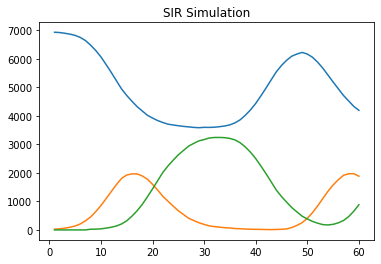

Giorno 60 :
Suscettibili: 4193
Infetti: 1884
Guariti: 883
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             210 |
|      2 |   4949 |             167 |
|      3 |   3401 |             101 |
|      4 |   5842 |              86 |
|      5 |   1924 |              70 |
|      6 |    166 |              69 |
|      7 |   6136 |              65 |
|      8 |   2447 |              60 |
|      9 |   1103 |              55 |
|     10 |   2732 |              53 |
|     11 |   4016 |              53 |
|     12 |    581 |              47 |
|     13 |   4406 |              46 |
|     14 |   1598 |              41 |
|     15 |   4196 |              35 |
+--------+--------+-----------------+


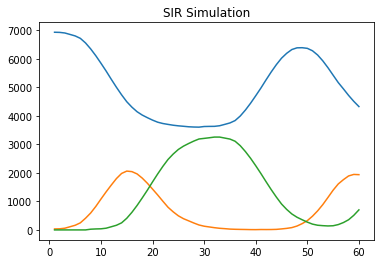

Giorno 60 :
Suscettibili: 4322
Infetti: 1936
Guariti: 702
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             180 |
|      2 |   1773 |             163 |
|      3 |   3401 |             113 |
|      4 |    166 |              86 |
|      5 |   6136 |              86 |
|      6 |   5842 |              71 |
|      7 |    581 |              67 |
|      8 |   1924 |              61 |
|      9 |   2732 |              59 |
|     10 |   2447 |              51 |
|     11 |   1103 |              50 |
|     12 |   4196 |              45 |
|     13 |   2481 |              44 |
|     14 |   3706 |              42 |
|     15 |   4016 |              41 |
+--------+--------+-----------------+


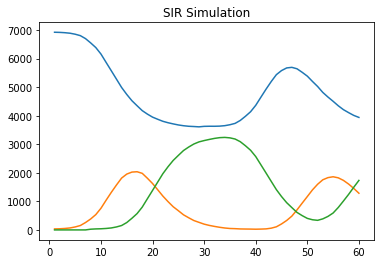

Giorno 60 :
Suscettibili: 3941
Infetti: 1285
Guariti: 1734
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             172 |
|      2 |   4949 |             158 |
|      3 |   3401 |             127 |
|      4 |   5842 |              76 |
|      5 |   6136 |              75 |
|      6 |    166 |              73 |
|      7 |   2447 |              66 |
|      8 |   2732 |              61 |
|      9 |   3706 |              52 |
|     10 |   1103 |              46 |
|     11 |   4016 |              46 |
|     12 |   1924 |              45 |
|     13 |   2481 |              41 |
|     14 |   4196 |              39 |
|     15 |    581 |              38 |
+--------+--------+-----------------+


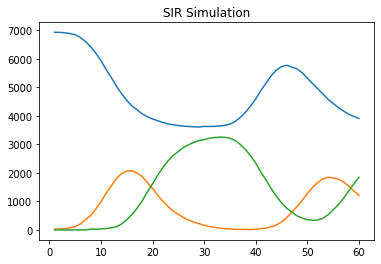

Giorno 60 :
Suscettibili: 3908
Infetti: 1207
Guariti: 1845
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             180 |
|      2 |   4949 |             177 |
|      3 |   3401 |             108 |
|      4 |   6136 |              78 |
|      5 |   5842 |              70 |
|      6 |    166 |              69 |
|      7 |    581 |              66 |
|      8 |   2447 |              66 |
|      9 |   1924 |              57 |
|     10 |   2732 |              52 |
|     11 |   1103 |              51 |
|     12 |   4016 |              50 |
|     13 |   4406 |              43 |
|     14 |   3706 |              42 |
|     15 |   4196 |              41 |
+--------+--------+-----------------+


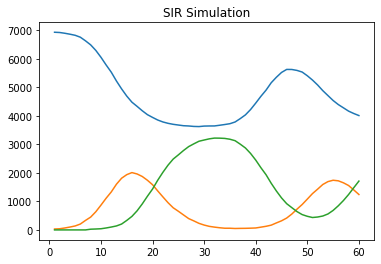

Giorno 60 :
Suscettibili: 4008
Infetti: 1241
Guariti: 1711
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             167 |
|      2 |   1773 |             160 |
|      3 |   3401 |             107 |
|      4 |    166 |              74 |
|      5 |   6136 |              71 |
|      6 |   2447 |              57 |
|      7 |   2732 |              56 |
|      8 |   3285 |              49 |
|      9 |    581 |              45 |
|     10 |   3706 |              45 |
|     11 |   1103 |              45 |
|     12 |   5842 |              45 |
|     13 |   1924 |              44 |
|     14 |   4016 |              41 |
|     15 |   4196 |              37 |
+--------+--------+-----------------+


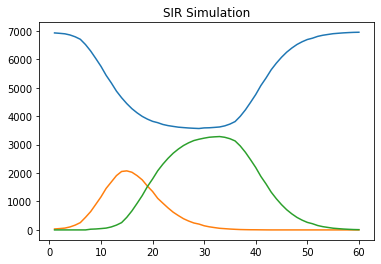

Giorno 60 :
Suscettibili: 6951
Infetti: 0
Guariti: 9
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |              95 |
|      2 |   4949 |              77 |
|      3 |   3401 |              58 |
|      4 |   6136 |              43 |
|      5 |    166 |              43 |
|      6 |   1924 |              39 |
|      7 |   1103 |              31 |
|      8 |   4196 |              29 |
|      9 |   5842 |              29 |
|     10 |   2447 |              28 |
|     11 |   2481 |              23 |
|     12 |   4016 |              22 |
|     13 |    581 |              22 |
|     14 |   1883 |              21 |
|     15 |   3902 |              18 |
+--------+--------+-----------------+


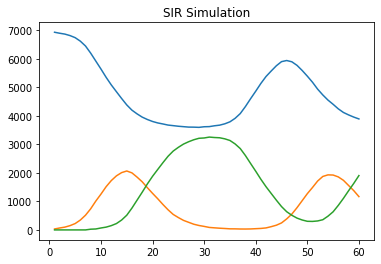

Giorno 60 :
Suscettibili: 3889
Infetti: 1167
Guariti: 1904
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             154 |
|      2 |   4949 |             151 |
|      3 |   3401 |             111 |
|      4 |   6136 |              94 |
|      5 |   5842 |              82 |
|      6 |    166 |              76 |
|      7 |    581 |              65 |
|      8 |   2447 |              58 |
|      9 |   2732 |              55 |
|     10 |   4016 |              54 |
|     11 |   1924 |              53 |
|     12 |   2481 |              51 |
|     13 |   4406 |              49 |
|     14 |   1103 |              48 |
|     15 |   3706 |              45 |
+--------+--------+-----------------+


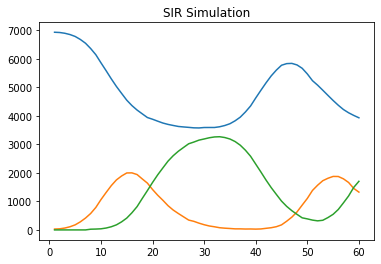

Giorno 60 :
Suscettibili: 3931
Infetti: 1325
Guariti: 1704
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             166 |
|      2 |   4949 |             163 |
|      3 |   3401 |             134 |
|      4 |   6136 |              90 |
|      5 |    166 |              69 |
|      6 |   1924 |              65 |
|      7 |    581 |              61 |
|      8 |   2447 |              59 |
|      9 |   5842 |              57 |
|     10 |   1103 |              57 |
|     11 |   2732 |              57 |
|     12 |   4016 |              56 |
|     13 |   3285 |              37 |
|     14 |   4406 |              36 |
|     15 |   3706 |              35 |
+--------+--------+-----------------+


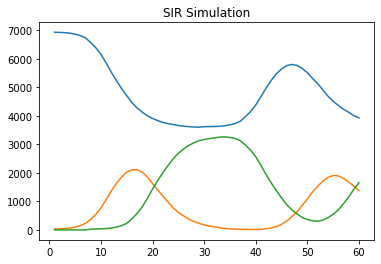

Giorno 60 :
Suscettibili: 3927
Infetti: 1380
Guariti: 1653
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             186 |
|      2 |   1773 |             167 |
|      3 |   3401 |             112 |
|      4 |    166 |             100 |
|      5 |   6136 |              78 |
|      6 |   1924 |              71 |
|      7 |   2447 |              61 |
|      8 |   5842 |              58 |
|      9 |   1103 |              55 |
|     10 |   3285 |              53 |
|     11 |    581 |              43 |
|     12 |     93 |              42 |
|     13 |   1598 |              41 |
|     14 |   4196 |              41 |
|     15 |   2732 |              37 |
+--------+--------+-----------------+


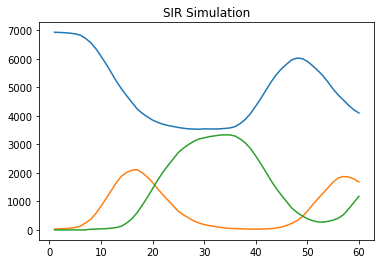

Giorno 60 :
Suscettibili: 4100
Infetti: 1682
Guariti: 1178
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             183 |
|      2 |   1773 |             167 |
|      3 |   3401 |             116 |
|      4 |    166 |              83 |
|      5 |   5842 |              67 |
|      6 |   1924 |              66 |
|      7 |   6136 |              62 |
|      8 |    581 |              61 |
|      9 |   1103 |              57 |
|     10 |   4016 |              50 |
|     11 |   2732 |              48 |
|     12 |   2447 |              47 |
|     13 |   3285 |              42 |
|     14 |   3706 |              42 |
|     15 |   5269 |              39 |
+--------+--------+-----------------+


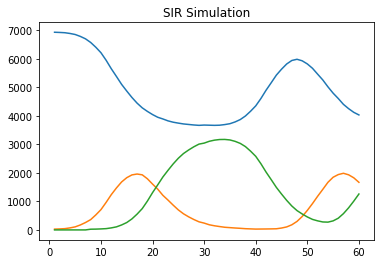

Giorno 60 :
Suscettibili: 4032
Infetti: 1669
Guariti: 1259
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             157 |
|      2 |   4949 |             147 |
|      3 |   3401 |             113 |
|      4 |   6136 |              82 |
|      5 |   1924 |              77 |
|      6 |    166 |              75 |
|      7 |   2447 |              55 |
|      8 |   5842 |              53 |
|      9 |   2732 |              53 |
|     10 |   4016 |              51 |
|     11 |   3706 |              48 |
|     12 |   1103 |              48 |
|     13 |    581 |              48 |
|     14 |   4406 |              43 |
|     15 |   4196 |              43 |
+--------+--------+-----------------+


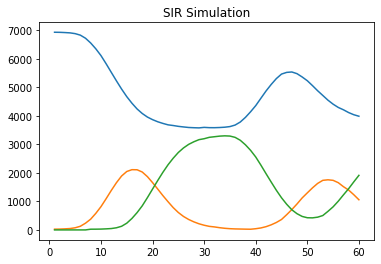

Giorno 60 :
Suscettibili: 3988
Infetti: 1058
Guariti: 1914
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             170 |
|      2 |   4949 |             160 |
|      3 |   3401 |             103 |
|      4 |   6136 |              99 |
|      5 |   1924 |              70 |
|      6 |    166 |              67 |
|      7 |   1103 |              65 |
|      8 |    581 |              57 |
|      9 |   2732 |              55 |
|     10 |   5842 |              53 |
|     11 |   2447 |              51 |
|     12 |   3706 |              39 |
|     13 |   4016 |              38 |
|     14 |   5269 |              34 |
|     15 |   2481 |              34 |
+--------+--------+-----------------+


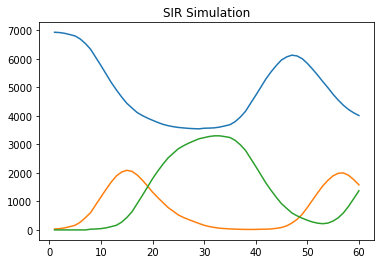

Giorno 60 :
Suscettibili: 4008
Infetti: 1580
Guariti: 1372
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             149 |
|      2 |   1773 |             147 |
|      3 |   3401 |              96 |
|      4 |    166 |              87 |
|      5 |   6136 |              85 |
|      6 |   1103 |              63 |
|      7 |   4016 |              61 |
|      8 |   5842 |              58 |
|      9 |   2732 |              57 |
|     10 |   1924 |              54 |
|     11 |   2447 |              49 |
|     12 |    581 |              48 |
|     13 |   4196 |              45 |
|     14 |   2345 |              38 |
|     15 |   4406 |              34 |
+--------+--------+-----------------+


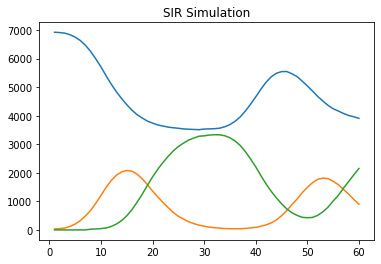

Giorno 60 :
Suscettibili: 3909
Infetti: 900
Guariti: 2151
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             186 |
|      2 |   4949 |             125 |
|      3 |   3401 |              94 |
|      4 |   6136 |              69 |
|      5 |   1924 |              68 |
|      6 |    166 |              66 |
|      7 |    581 |              63 |
|      8 |   5842 |              61 |
|      9 |   1103 |              51 |
|     10 |   2732 |              49 |
|     11 |   2447 |              45 |
|     12 |   4016 |              42 |
|     13 |   1598 |              38 |
|     14 |   4406 |              38 |
|     15 |   3285 |              33 |
+--------+--------+-----------------+


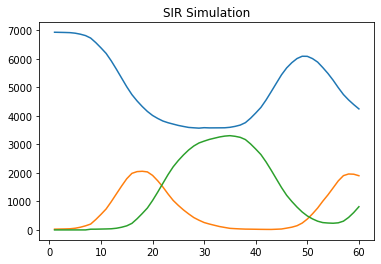

Giorno 60 :
Suscettibili: 4245
Infetti: 1901
Guariti: 814
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             187 |
|      2 |   4949 |             148 |
|      3 |   3401 |             115 |
|      4 |   6136 |              81 |
|      5 |   5842 |              81 |
|      6 |    166 |              69 |
|      7 |   1924 |              67 |
|      8 |    581 |              61 |
|      9 |   1103 |              61 |
|     10 |   2732 |              60 |
|     11 |   2447 |              49 |
|     12 |   2481 |              46 |
|     13 |   3285 |              40 |
|     14 |   1598 |              38 |
|     15 |   4016 |              37 |
+--------+--------+-----------------+


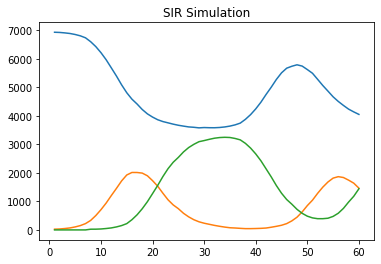

Giorno 60 :
Suscettibili: 4052
Infetti: 1465
Guariti: 1443
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             168 |
|      2 |   1773 |             137 |
|      3 |   3401 |              99 |
|      4 |   6136 |              85 |
|      5 |    166 |              81 |
|      6 |   2732 |              78 |
|      7 |   1924 |              67 |
|      8 |   1103 |              65 |
|      9 |    581 |              62 |
|     10 |   5842 |              61 |
|     11 |   4016 |              46 |
|     12 |   2481 |              45 |
|     13 |   4196 |              41 |
|     14 |   3706 |              39 |
|     15 |     93 |              39 |
+--------+--------+-----------------+


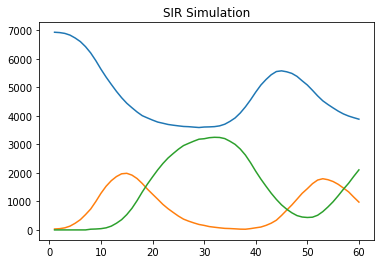

Giorno 60 :
Suscettibili: 3881
Infetti: 975
Guariti: 2104
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             180 |
|      2 |   4949 |             156 |
|      3 |   3401 |              91 |
|      4 |   6136 |              90 |
|      5 |   5842 |              80 |
|      6 |    166 |              76 |
|      7 |   1924 |              61 |
|      8 |   2447 |              58 |
|      9 |   2732 |              56 |
|     10 |   1103 |              54 |
|     11 |    581 |              44 |
|     12 |   4406 |              44 |
|     13 |   3902 |              43 |
|     14 |   4196 |              43 |
|     15 |   3706 |              36 |
+--------+--------+-----------------+


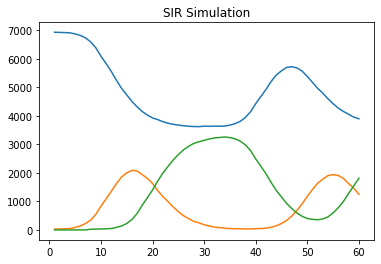

Giorno 60 :
Suscettibili: 3897
Infetti: 1251
Guariti: 1812
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             161 |
|      2 |   4949 |             158 |
|      3 |   3401 |             109 |
|      4 |   5842 |              77 |
|      5 |    166 |              76 |
|      6 |   6136 |              75 |
|      7 |   2447 |              65 |
|      8 |   1924 |              62 |
|      9 |   2732 |              56 |
|     10 |   3285 |              55 |
|     11 |    581 |              52 |
|     12 |   1103 |              50 |
|     13 |   4016 |              41 |
|     14 |   4406 |              40 |
|     15 |    675 |              39 |
+--------+--------+-----------------+


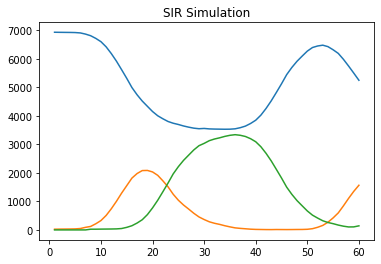

Giorno 60 :
Suscettibili: 5250
Infetti: 1567
Guariti: 143
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             194 |
|      2 |   1773 |             137 |
|      3 |   6136 |              91 |
|      4 |   3401 |              88 |
|      5 |   1924 |              87 |
|      6 |    581 |              81 |
|      7 |   3285 |              62 |
|      8 |   2732 |              56 |
|      9 |   2447 |              53 |
|     10 |   5842 |              44 |
|     11 |    166 |              42 |
|     12 |   1598 |              41 |
|     13 |   2481 |              37 |
|     14 |   1103 |              37 |
|     15 |   2345 |              35 |
+--------+--------+-----------------+


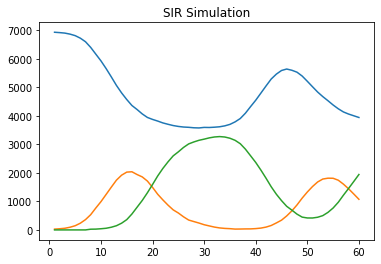

Giorno 60 :
Suscettibili: 3943
Infetti: 1074
Guariti: 1943
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             150 |
|      2 |   4949 |             130 |
|      3 |   3401 |              82 |
|      4 |   5842 |              82 |
|      5 |   6136 |              74 |
|      6 |   1924 |              69 |
|      7 |    166 |              63 |
|      8 |   2447 |              60 |
|      9 |   2732 |              53 |
|     10 |    581 |              52 |
|     11 |   1103 |              51 |
|     12 |   3706 |              48 |
|     13 |   3285 |              46 |
|     14 |   4196 |              40 |
|     15 |   5945 |              40 |
+--------+--------+-----------------+


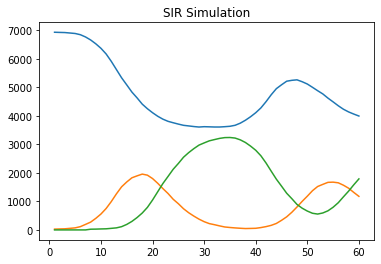

Giorno 60 :
Suscettibili: 3994
Infetti: 1177
Guariti: 1789
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             171 |
|      2 |   4949 |             156 |
|      3 |   3401 |             113 |
|      4 |   6136 |              69 |
|      5 |   5842 |              68 |
|      6 |   1924 |              68 |
|      7 |    166 |              65 |
|      8 |   2732 |              65 |
|      9 |   1103 |              51 |
|     10 |    581 |              45 |
|     11 |   2447 |              43 |
|     12 |   1598 |              42 |
|     13 |   4196 |              38 |
|     14 |   4406 |              37 |
|     15 |   4016 |              37 |
+--------+--------+-----------------+


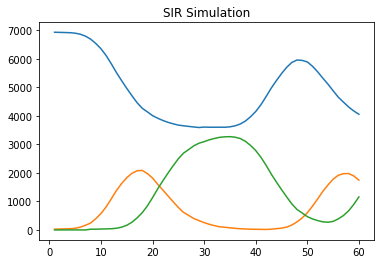

Giorno 60 :
Suscettibili: 4057
Infetti: 1746
Guariti: 1157
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             171 |
|      2 |   4949 |             137 |
|      3 |   3401 |              97 |
|      4 |   5842 |              80 |
|      5 |   6136 |              72 |
|      6 |    166 |              72 |
|      7 |   2447 |              61 |
|      8 |    581 |              61 |
|      9 |   1924 |              55 |
|     10 |   2732 |              48 |
|     11 |   2345 |              45 |
|     12 |   1103 |              45 |
|     13 |   4016 |              43 |
|     14 |   1598 |              37 |
|     15 |   4406 |              36 |
+--------+--------+-----------------+


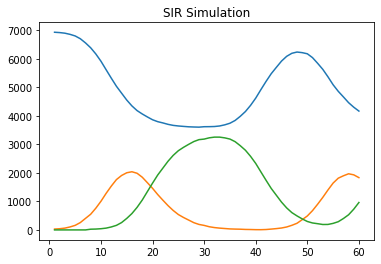

Giorno 60 :
Suscettibili: 4166
Infetti: 1833
Guariti: 961
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             188 |
|      2 |   4949 |             166 |
|      3 |   3401 |             117 |
|      4 |    166 |              85 |
|      5 |   6136 |              77 |
|      6 |   5842 |              75 |
|      7 |   1103 |              67 |
|      8 |   2732 |              63 |
|      9 |    581 |              49 |
|     10 |   1924 |              48 |
|     11 |   4016 |              47 |
|     12 |   2997 |              42 |
|     13 |   2481 |              41 |
|     14 |   3706 |              40 |
|     15 |   2447 |              37 |
+--------+--------+-----------------+


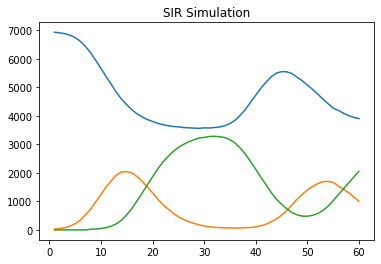

Giorno 60 :
Suscettibili: 3904
Infetti: 1003
Guariti: 2053
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             154 |
|      2 |   4949 |             134 |
|      3 |   3401 |             104 |
|      4 |   5842 |              81 |
|      5 |   6136 |              76 |
|      6 |   1924 |              75 |
|      7 |    581 |              62 |
|      8 |    166 |              60 |
|      9 |   2732 |              54 |
|     10 |   1103 |              51 |
|     11 |   2447 |              48 |
|     12 |   3706 |              46 |
|     13 |   5269 |              40 |
|     14 |   4406 |              38 |
|     15 |   3285 |              38 |
+--------+--------+-----------------+


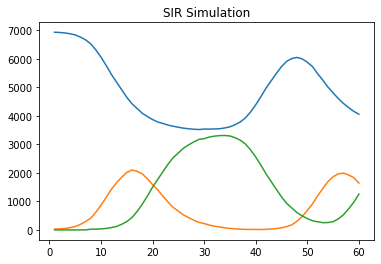

Giorno 60 :
Suscettibili: 4059
Infetti: 1643
Guariti: 1258
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             161 |
|      2 |   4949 |             156 |
|      3 |   3401 |             110 |
|      4 |   5842 |              75 |
|      5 |   1924 |              74 |
|      6 |   2447 |              71 |
|      7 |   6136 |              71 |
|      8 |    166 |              69 |
|      9 |   2732 |              68 |
|     10 |   4016 |              53 |
|     11 |    581 |              47 |
|     12 |   1598 |              45 |
|     13 |   1103 |              43 |
|     14 |    675 |              42 |
|     15 |   4196 |              42 |
+--------+--------+-----------------+


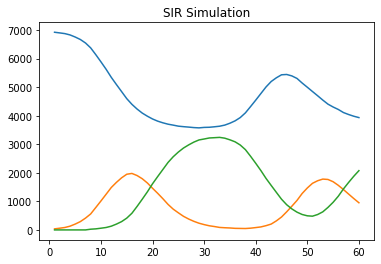

Giorno 60 :
Suscettibili: 3934
Infetti: 951
Guariti: 2075
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             175 |
|      2 |   4949 |             142 |
|      3 |   3401 |              93 |
|      4 |   5842 |              73 |
|      5 |    166 |              73 |
|      6 |    581 |              73 |
|      7 |   6136 |              65 |
|      8 |   1103 |              57 |
|      9 |   2447 |              56 |
|     10 |   2481 |              55 |
|     11 |   4406 |              51 |
|     12 |   1924 |              51 |
|     13 |   2732 |              47 |
|     14 |   2781 |              42 |
|     15 |   3285 |              42 |
+--------+--------+-----------------+


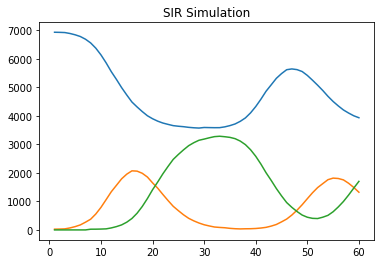

Giorno 60 :
Suscettibili: 3935
Infetti: 1322
Guariti: 1703
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             173 |
|      2 |   1773 |             165 |
|      3 |   3401 |             128 |
|      4 |   6136 |              74 |
|      5 |    166 |              74 |
|      6 |   1103 |              70 |
|      7 |   1924 |              64 |
|      8 |   2732 |              62 |
|      9 |   5842 |              57 |
|     10 |    581 |              57 |
|     11 |   4196 |              54 |
|     12 |   2447 |              51 |
|     13 |   3706 |              49 |
|     14 |   4406 |              44 |
|     15 |   4016 |              38 |
+--------+--------+-----------------+


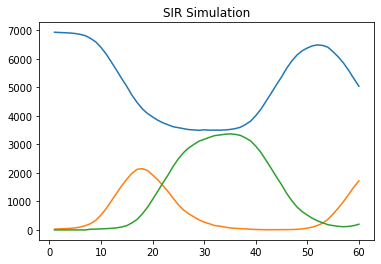

Giorno 60 :
Suscettibili: 5039
Infetti: 1721
Guariti: 200
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             132 |
|      2 |   4949 |             123 |
|      3 |   3401 |              98 |
|      4 |    166 |              81 |
|      5 |   5842 |              71 |
|      6 |   6136 |              67 |
|      7 |   1924 |              58 |
|      8 |    581 |              50 |
|      9 |   3706 |              50 |
|     10 |   2732 |              48 |
|     11 |   2447 |              42 |
|     12 |   2481 |              42 |
|     13 |   4196 |              41 |
|     14 |   1598 |              40 |
|     15 |   1103 |              39 |
+--------+--------+-----------------+


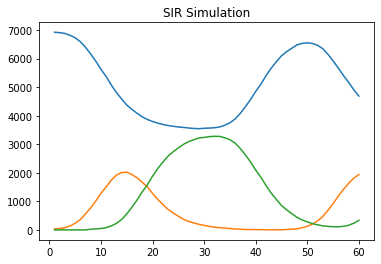

Giorno 60 :
Suscettibili: 4687
Infetti: 1938
Guariti: 335
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             191 |
|      2 |   1773 |             173 |
|      3 |   3401 |             126 |
|      4 |   6136 |              93 |
|      5 |   1924 |              70 |
|      6 |   5842 |              67 |
|      7 |   4016 |              63 |
|      8 |    581 |              62 |
|      9 |   1103 |              54 |
|     10 |    166 |              46 |
|     11 |   2732 |              45 |
|     12 |   2481 |              42 |
|     13 |   2447 |              41 |
|     14 |   3706 |              39 |
|     15 |   4196 |              38 |
+--------+--------+-----------------+


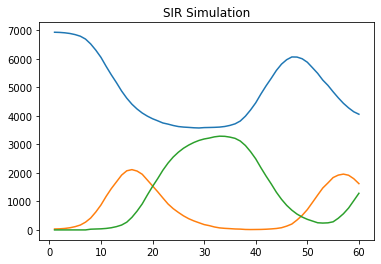

Giorno 60 :
Suscettibili: 4054
Infetti: 1622
Guariti: 1284
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             154 |
|      2 |   1773 |             154 |
|      3 |   3401 |              97 |
|      4 |    166 |              79 |
|      5 |   6136 |              77 |
|      6 |   5842 |              69 |
|      7 |   2732 |              66 |
|      8 |   1924 |              63 |
|      9 |    581 |              60 |
|     10 |   4016 |              51 |
|     11 |   2447 |              49 |
|     12 |   1103 |              49 |
|     13 |   4196 |              48 |
|     14 |   2481 |              48 |
|     15 |   3706 |              46 |
+--------+--------+-----------------+


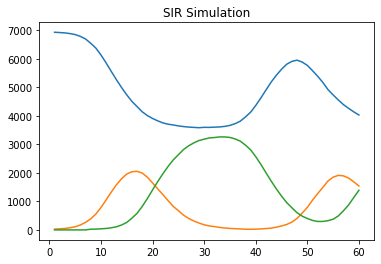

Giorno 60 :
Suscettibili: 4030
Infetti: 1541
Guariti: 1389
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             176 |
|      2 |   4949 |             157 |
|      3 |   6136 |              85 |
|      4 |    166 |              79 |
|      5 |   3401 |              77 |
|      6 |   1924 |              74 |
|      7 |   5842 |              74 |
|      8 |   4016 |              54 |
|      9 |    581 |              52 |
|     10 |   2732 |              49 |
|     11 |   1103 |              42 |
|     12 |   4406 |              42 |
|     13 |   3285 |              41 |
|     14 |   3706 |              40 |
|     15 |   1598 |              38 |
+--------+--------+-----------------+


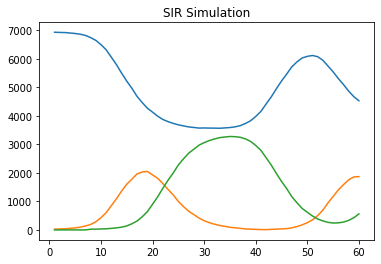

Giorno 60 :
Suscettibili: 4530
Infetti: 1869
Guariti: 561
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             153 |
|      2 |   1773 |             147 |
|      3 |   3401 |             116 |
|      4 |   6136 |              80 |
|      5 |   5842 |              66 |
|      6 |    581 |              61 |
|      7 |   2447 |              56 |
|      8 |    166 |              55 |
|      9 |   2732 |              53 |
|     10 |   1103 |              52 |
|     11 |   1924 |              49 |
|     12 |   1598 |              42 |
|     13 |   3706 |              41 |
|     14 |   4016 |              41 |
|     15 |   2481 |              38 |
+--------+--------+-----------------+


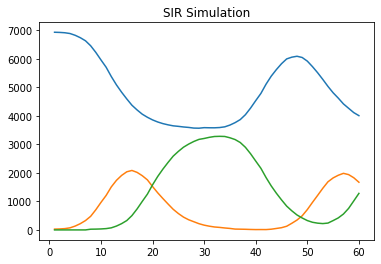

Giorno 60 :
Suscettibili: 4007
Infetti: 1672
Guariti: 1281
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             182 |
|      2 |   4949 |             154 |
|      3 |   3401 |             115 |
|      4 |    166 |              85 |
|      5 |   6136 |              84 |
|      6 |   1924 |              72 |
|      7 |    581 |              69 |
|      8 |   4016 |              68 |
|      9 |   5842 |              67 |
|     10 |   2447 |              63 |
|     11 |   2732 |              58 |
|     12 |   2481 |              41 |
|     13 |   4406 |              37 |
|     14 |   4196 |              37 |
|     15 |   3706 |              35 |
+--------+--------+-----------------+


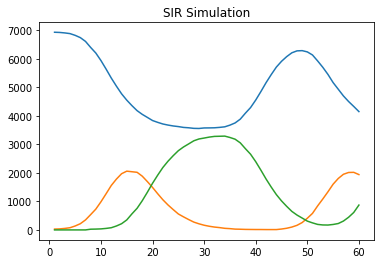

Giorno 60 :
Suscettibili: 4149
Infetti: 1940
Guariti: 871
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             179 |
|      2 |   4949 |             157 |
|      3 |   3401 |             121 |
|      4 |   5842 |              83 |
|      5 |   6136 |              76 |
|      6 |   1924 |              75 |
|      7 |   2732 |              64 |
|      8 |   1103 |              61 |
|      9 |    581 |              57 |
|     10 |    166 |              53 |
|     11 |   2447 |              44 |
|     12 |   4196 |              42 |
|     13 |   4406 |              41 |
|     14 |   3706 |              39 |
|     15 |   4016 |              39 |
+--------+--------+-----------------+


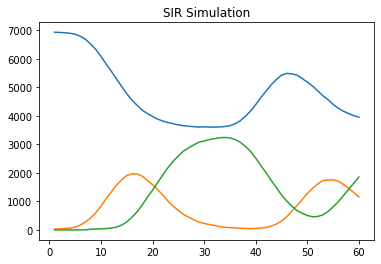

Giorno 60 :
Suscettibili: 3950
Infetti: 1157
Guariti: 1853
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             170 |
|      2 |   4949 |             141 |
|      3 |   3401 |              92 |
|      4 |    166 |              75 |
|      5 |   6136 |              67 |
|      6 |   5842 |              61 |
|      7 |   2732 |              60 |
|      8 |   1924 |              55 |
|      9 |   2447 |              51 |
|     10 |   4016 |              50 |
|     11 |    581 |              49 |
|     12 |   4406 |              46 |
|     13 |   3706 |              43 |
|     14 |   4196 |              43 |
|     15 |   1598 |              41 |
+--------+--------+-----------------+


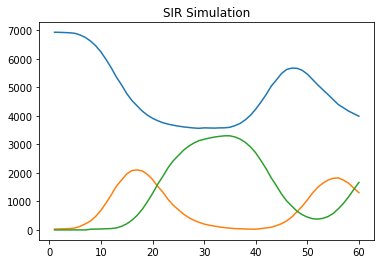

Giorno 60 :
Suscettibili: 3988
Infetti: 1307
Guariti: 1665
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             170 |
|      2 |   4949 |             162 |
|      3 |   3401 |              92 |
|      4 |   6136 |              79 |
|      5 |    166 |              77 |
|      6 |    581 |              69 |
|      7 |   2447 |              65 |
|      8 |   2732 |              55 |
|      9 |   1924 |              54 |
|     10 |   5842 |              53 |
|     11 |   4196 |              50 |
|     12 |   4016 |              48 |
|     13 |   3706 |              42 |
|     14 |   3285 |              39 |
|     15 |   4406 |              38 |
+--------+--------+-----------------+


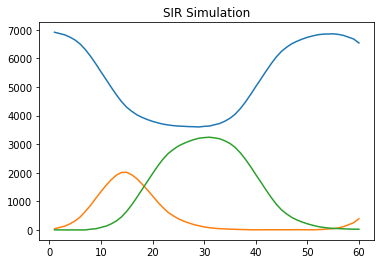

Giorno 60 :
Suscettibili: 6543
Infetti: 391
Guariti: 26
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             104 |
|      2 |   1773 |              96 |
|      3 |    166 |              71 |
|      4 |   1924 |              69 |
|      5 |    581 |              64 |
|      6 |   6136 |              59 |
|      7 |   3401 |              58 |
|      8 |   3706 |              55 |
|      9 |   5842 |              43 |
|     10 |   4406 |              43 |
|     11 |   1103 |              42 |
|     12 |   2447 |              41 |
|     13 |   2732 |              34 |
|     14 |   4016 |              31 |
|     15 |   2345 |              26 |
+--------+--------+-----------------+


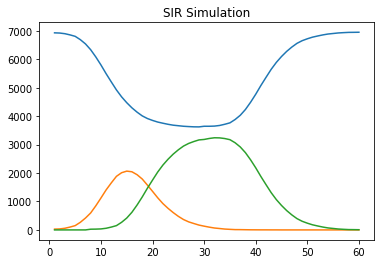

Giorno 60 :
Suscettibili: 6953
Infetti: 0
Guariti: 7
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |              85 |
|      2 |   4949 |              73 |
|      3 |   3401 |              58 |
|      4 |   5842 |              49 |
|      5 |    166 |              46 |
|      6 |   3706 |              30 |
|      7 |   6136 |              30 |
|      8 |   2447 |              25 |
|      9 |   1924 |              25 |
|     10 |    581 |              25 |
|     11 |   1103 |              24 |
|     12 |   4016 |              23 |
|     13 |   4406 |              23 |
|     14 |   2026 |              22 |
|     15 |   4196 |              20 |
+--------+--------+-----------------+


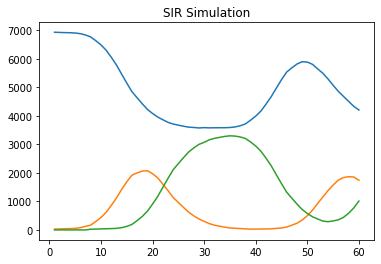

Giorno 60 :
Suscettibili: 4206
Infetti: 1743
Guariti: 1011
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             175 |
|      2 |   1773 |             148 |
|      3 |   1924 |              86 |
|      4 |   6136 |              80 |
|      5 |   5842 |              79 |
|      6 |   3401 |              79 |
|      7 |    166 |              71 |
|      8 |    581 |              62 |
|      9 |   2732 |              62 |
|     10 |   2447 |              55 |
|     11 |   1103 |              52 |
|     12 |   4016 |              46 |
|     13 |   3285 |              43 |
|     14 |   4196 |              39 |
|     15 |   2481 |              38 |
+--------+--------+-----------------+


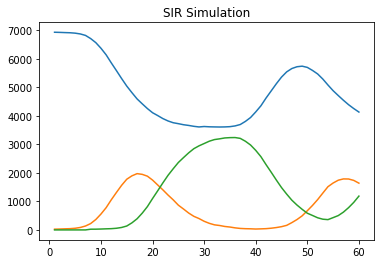

Giorno 60 :
Suscettibili: 4134
Infetti: 1640
Guariti: 1186
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             165 |
|      2 |   1773 |             153 |
|      3 |   3401 |             115 |
|      4 |   6136 |              78 |
|      5 |   5842 |              74 |
|      6 |   1924 |              73 |
|      7 |    581 |              68 |
|      8 |    166 |              67 |
|      9 |   1103 |              59 |
|     10 |   2732 |              50 |
|     11 |   2447 |              50 |
|     12 |   3285 |              41 |
|     13 |   2481 |              41 |
|     14 |   4016 |              37 |
|     15 |   3706 |              36 |
+--------+--------+-----------------+


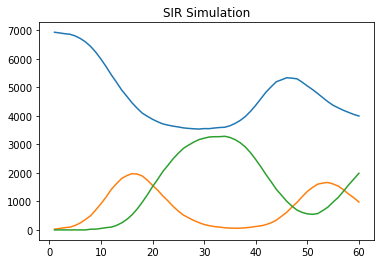

Giorno 60 :
Suscettibili: 3995
Infetti: 979
Guariti: 1986
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             178 |
|      2 |   4949 |             136 |
|      3 |   3401 |              93 |
|      4 |   5842 |              89 |
|      5 |    166 |              78 |
|      6 |    581 |              75 |
|      7 |   6136 |              71 |
|      8 |   2732 |              65 |
|      9 |   1924 |              64 |
|     10 |   1103 |              54 |
|     11 |   4016 |              44 |
|     12 |   2481 |              42 |
|     13 |   3706 |              41 |
|     14 |   2447 |              40 |
|     15 |   6716 |              37 |
+--------+--------+-----------------+


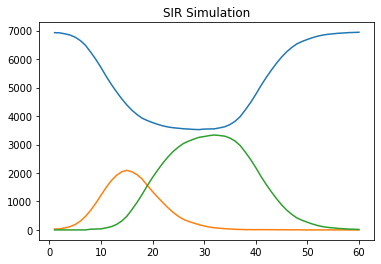

Giorno 60 :
Suscettibili: 6944
Infetti: 0
Guariti: 16
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             109 |
|      2 |   1773 |              70 |
|      3 |   3401 |              64 |
|      4 |   6136 |              50 |
|      5 |   2732 |              42 |
|      6 |    166 |              39 |
|      7 |   1103 |              32 |
|      8 |    581 |              32 |
|      9 |   2447 |              30 |
|     10 |   1924 |              30 |
|     11 |   5842 |              29 |
|     12 |   4016 |              29 |
|     13 |   3706 |              25 |
|     14 |   2481 |              24 |
|     15 |   5269 |              21 |
+--------+--------+-----------------+


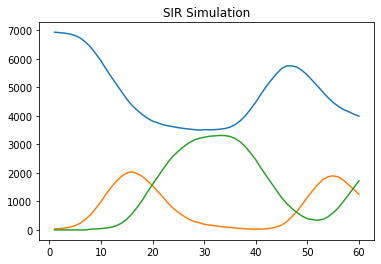

Giorno 60 :
Suscettibili: 3988
Infetti: 1250
Guariti: 1722
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             182 |
|      2 |   1773 |             147 |
|      3 |   3401 |              95 |
|      4 |   6136 |              89 |
|      5 |   1103 |              70 |
|      6 |   1924 |              66 |
|      7 |   2447 |              58 |
|      8 |   5842 |              54 |
|      9 |    581 |              53 |
|     10 |    166 |              53 |
|     11 |   4016 |              47 |
|     12 |   4196 |              45 |
|     13 |   2732 |              43 |
|     14 |   5945 |              42 |
|     15 |   1598 |              39 |
+--------+--------+-----------------+


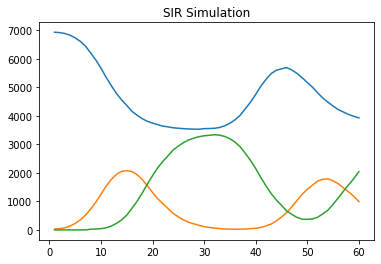

Giorno 60 :
Suscettibili: 3926
Infetti: 993
Guariti: 2041
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             157 |
|      2 |   1773 |             155 |
|      3 |   3401 |              97 |
|      4 |   6136 |              89 |
|      5 |    166 |              68 |
|      6 |   1103 |              54 |
|      7 |   5842 |              53 |
|      8 |    581 |              49 |
|      9 |   2732 |              49 |
|     10 |   1924 |              48 |
|     11 |   2447 |              43 |
|     12 |   3706 |              43 |
|     13 |   4196 |              42 |
|     14 |   5945 |              40 |
|     15 |   1883 |              37 |
+--------+--------+-----------------+


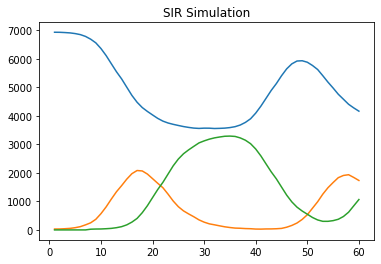

Giorno 60 :
Suscettibili: 4162
Infetti: 1733
Guariti: 1065
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             189 |
|      2 |   4949 |             163 |
|      3 |   3401 |              98 |
|      4 |   6136 |              83 |
|      5 |   5842 |              80 |
|      6 |    166 |              71 |
|      7 |   1924 |              69 |
|      8 |   2732 |              59 |
|      9 |   1103 |              55 |
|     10 |   2447 |              55 |
|     11 |    581 |              54 |
|     12 |   4196 |              43 |
|     13 |   3706 |              42 |
|     14 |   3285 |              35 |
|     15 |   2481 |              33 |
+--------+--------+-----------------+


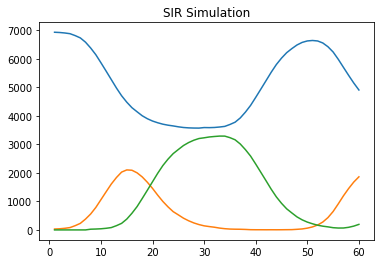

Giorno 60 :
Suscettibili: 4905
Infetti: 1861
Guariti: 194
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             163 |
|      2 |   1773 |             137 |
|      3 |   3401 |              98 |
|      4 |   6136 |              78 |
|      5 |   5842 |              65 |
|      6 |    166 |              63 |
|      7 |   1924 |              59 |
|      8 |   4016 |              52 |
|      9 |    581 |              51 |
|     10 |   1103 |              47 |
|     11 |   2447 |              44 |
|     12 |   2481 |              43 |
|     13 |   4406 |              42 |
|     14 |   1598 |              37 |
|     15 |     93 |              36 |
+--------+--------+-----------------+


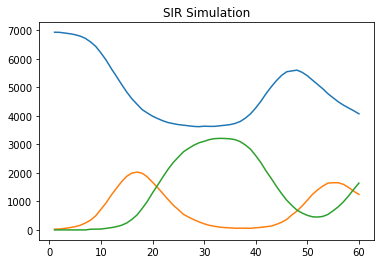

Giorno 60 :
Suscettibili: 4072
Infetti: 1246
Guariti: 1642
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             154 |
|      2 |   1773 |             137 |
|      3 |   3401 |             104 |
|      4 |   6136 |              78 |
|      5 |    166 |              76 |
|      6 |   5842 |              69 |
|      7 |   1924 |              61 |
|      8 |    581 |              60 |
|      9 |   1103 |              55 |
|     10 |   2732 |              54 |
|     11 |   2447 |              49 |
|     12 |   3285 |              42 |
|     13 |   2481 |              40 |
|     14 |   4196 |              34 |
|     15 |   4016 |              34 |
+--------+--------+-----------------+


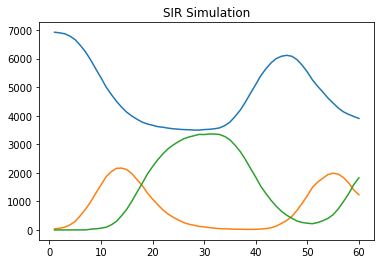

Giorno 60 :
Suscettibili: 3903
Infetti: 1231
Guariti: 1826
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             182 |
|      2 |   1773 |             159 |
|      3 |   3401 |             113 |
|      4 |    166 |              91 |
|      5 |   6136 |              89 |
|      6 |   1103 |              80 |
|      7 |   1924 |              74 |
|      8 |    581 |              55 |
|      9 |   2447 |              54 |
|     10 |   5842 |              51 |
|     11 |   2732 |              50 |
|     12 |   4406 |              44 |
|     13 |   3285 |              42 |
|     14 |   3706 |              42 |
|     15 |   2997 |              40 |
+--------+--------+-----------------+


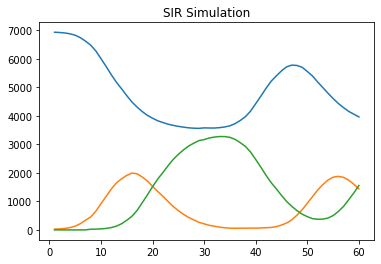

Giorno 60 :
Suscettibili: 3963
Infetti: 1439
Guariti: 1558
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             182 |
|      2 |   4949 |             149 |
|      3 |   3401 |             101 |
|      4 |   5842 |              80 |
|      5 |   6136 |              74 |
|      6 |   1103 |              71 |
|      7 |    166 |              69 |
|      8 |   2732 |              59 |
|      9 |    581 |              58 |
|     10 |   2447 |              49 |
|     11 |   1924 |              45 |
|     12 |   4406 |              44 |
|     13 |   4196 |              44 |
|     14 |   2481 |              42 |
|     15 |   1598 |              40 |
+--------+--------+-----------------+


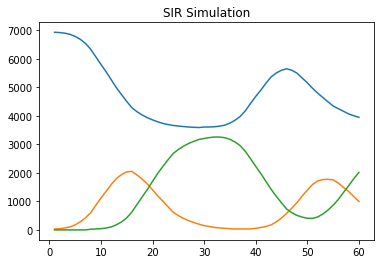

Giorno 60 :
Suscettibili: 3946
Infetti: 998
Guariti: 2016
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             170 |
|      2 |   1773 |             163 |
|      3 |   6136 |              96 |
|      4 |   3401 |              74 |
|      5 |    166 |              67 |
|      6 |   2732 |              59 |
|      7 |   1924 |              57 |
|      8 |   5842 |              56 |
|      9 |    581 |              52 |
|     10 |   2447 |              49 |
|     11 |   1103 |              49 |
|     12 |   3285 |              49 |
|     13 |   3706 |              47 |
|     14 |   4406 |              43 |
|     15 |   4016 |              42 |
+--------+--------+-----------------+


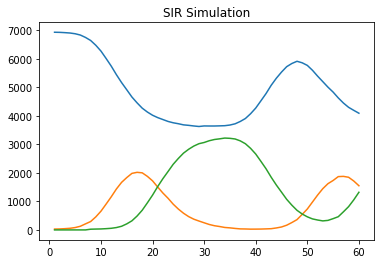

Giorno 60 :
Suscettibili: 4091
Infetti: 1549
Guariti: 1320
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             142 |
|      2 |   4949 |             140 |
|      3 |   3401 |             103 |
|      4 |   2447 |              75 |
|      5 |    166 |              75 |
|      6 |   6136 |              74 |
|      7 |   5842 |              68 |
|      8 |    581 |              67 |
|      9 |   1103 |              64 |
|     10 |   1924 |              59 |
|     11 |   4196 |              52 |
|     12 |   2732 |              52 |
|     13 |   2481 |              48 |
|     14 |   3902 |              46 |
|     15 |   3706 |              45 |
+--------+--------+-----------------+


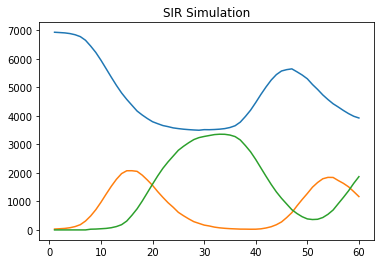

Giorno 60 :
Suscettibili: 3924
Infetti: 1169
Guariti: 1867
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             175 |
|      2 |   4949 |             166 |
|      3 |   3401 |             112 |
|      4 |    166 |              72 |
|      5 |   6136 |              71 |
|      6 |   5842 |              62 |
|      7 |    581 |              60 |
|      8 |   2447 |              58 |
|      9 |   1924 |              53 |
|     10 |   3285 |              52 |
|     11 |   1103 |              51 |
|     12 |   2732 |              49 |
|     13 |   2481 |              47 |
|     14 |   3706 |              44 |
|     15 |   4196 |              42 |
+--------+--------+-----------------+


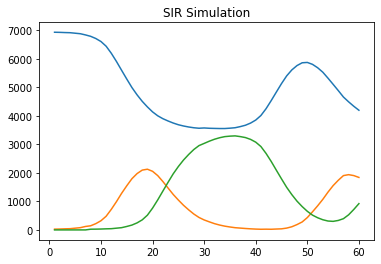

Giorno 60 :
Suscettibili: 4197
Infetti: 1841
Guariti: 922
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             160 |
|      2 |   1773 |             145 |
|      3 |   6136 |              92 |
|      4 |   3401 |              86 |
|      5 |    581 |              68 |
|      6 |    166 |              64 |
|      7 |   5842 |              62 |
|      8 |   4016 |              57 |
|      9 |   2732 |              56 |
|     10 |   1924 |              54 |
|     11 |   1103 |              46 |
|     12 |   4196 |              46 |
|     13 |   3706 |              42 |
|     14 |   1883 |              39 |
|     15 |   2997 |              38 |
+--------+--------+-----------------+


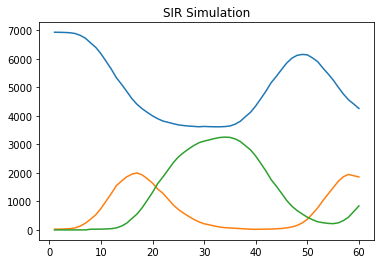

Giorno 60 :
Suscettibili: 4261
Infetti: 1858
Guariti: 841
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             186 |
|      2 |   1773 |             171 |
|      3 |   3401 |             121 |
|      4 |   6136 |             105 |
|      5 |   5842 |              78 |
|      6 |    166 |              69 |
|      7 |   1924 |              52 |
|      8 |    581 |              52 |
|      9 |   2732 |              52 |
|     10 |   2447 |              49 |
|     11 |   3706 |              45 |
|     12 |   4016 |              40 |
|     13 |   2466 |              40 |
|     14 |   4196 |              37 |
|     15 |   1103 |              37 |
+--------+--------+-----------------+


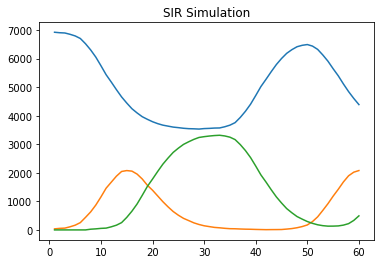

Giorno 60 :
Suscettibili: 4389
Infetti: 2079
Guariti: 492
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             189 |
|      2 |   1773 |             163 |
|      3 |   3401 |             103 |
|      4 |   6136 |             102 |
|      5 |   5842 |              86 |
|      6 |   1924 |              83 |
|      7 |    166 |              76 |
|      8 |   1103 |              69 |
|      9 |   3706 |              58 |
|     10 |   2447 |              54 |
|     11 |   4196 |              52 |
|     12 |    581 |              48 |
|     13 |   2732 |              42 |
|     14 |   4016 |              39 |
|     15 |   2481 |              35 |
+--------+--------+-----------------+


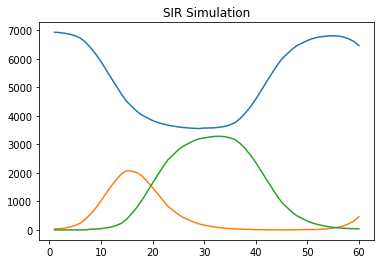

Giorno 60 :
Suscettibili: 6459
Infetti: 462
Guariti: 39
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |              73 |
|      2 |   1773 |              72 |
|      3 |    166 |              58 |
|      4 |   6136 |              55 |
|      5 |   3401 |              55 |
|      6 |   2732 |              52 |
|      7 |   1924 |              48 |
|      8 |   3706 |              47 |
|      9 |   4016 |              40 |
|     10 |   1103 |              39 |
|     11 |   5345 |              38 |
|     12 |   1598 |              36 |
|     13 |   4406 |              35 |
|     14 |    581 |              28 |
|     15 |   2447 |              27 |
+--------+--------+-----------------+


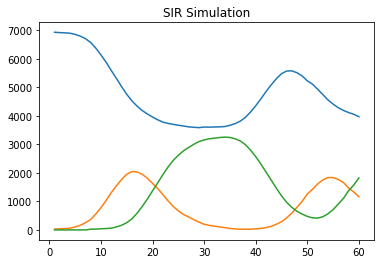

Giorno 60 :
Suscettibili: 3971
Infetti: 1163
Guariti: 1826
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             182 |
|      2 |   4949 |             156 |
|      3 |   3401 |             102 |
|      4 |   6136 |              84 |
|      5 |   5842 |              80 |
|      6 |    581 |              75 |
|      7 |    166 |              70 |
|      8 |   2732 |              66 |
|      9 |   1103 |              53 |
|     10 |   2481 |              45 |
|     11 |   1924 |              44 |
|     12 |   3706 |              44 |
|     13 |   3285 |              42 |
|     14 |   4196 |              40 |
|     15 |   5269 |              38 |
+--------+--------+-----------------+


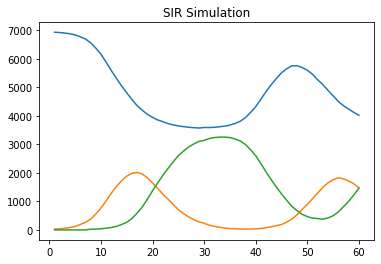

Giorno 60 :
Suscettibili: 4020
Infetti: 1475
Guariti: 1465
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             160 |
|      2 |   1773 |             146 |
|      3 |   3401 |             104 |
|      4 |   5842 |              84 |
|      5 |   6136 |              77 |
|      6 |    166 |              71 |
|      7 |   2732 |              69 |
|      8 |    581 |              62 |
|      9 |   1924 |              56 |
|     10 |   4016 |              45 |
|     11 |   3706 |              44 |
|     12 |   1103 |              44 |
|     13 |   4406 |              39 |
|     14 |   2481 |              39 |
|     15 |   3285 |              35 |
+--------+--------+-----------------+


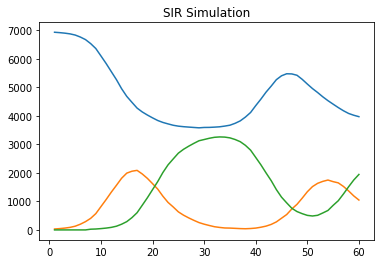

Giorno 60 :
Suscettibili: 3969
Infetti: 1047
Guariti: 1944
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             154 |
|      2 |   4949 |             137 |
|      3 |   3401 |             103 |
|      4 |   6136 |              74 |
|      5 |   2732 |              68 |
|      6 |   5842 |              62 |
|      7 |    581 |              56 |
|      8 |   1924 |              54 |
|      9 |    166 |              49 |
|     10 |   2447 |              49 |
|     11 |   1103 |              48 |
|     12 |     93 |              48 |
|     13 |   4016 |              47 |
|     14 |   3706 |              38 |
|     15 |   4196 |              37 |
+--------+--------+-----------------+


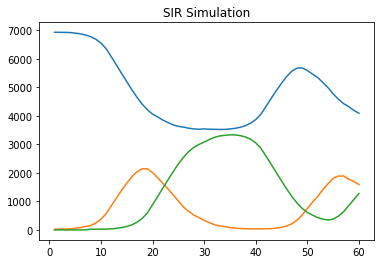

Giorno 60 :
Suscettibili: 4094
Infetti: 1589
Guariti: 1277
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             179 |
|      2 |   4949 |             146 |
|      3 |   3401 |             111 |
|      4 |    166 |              83 |
|      5 |   6136 |              81 |
|      6 |   5842 |              80 |
|      7 |    581 |              58 |
|      8 |   1924 |              54 |
|      9 |   2447 |              53 |
|     10 |   2732 |              49 |
|     11 |   4016 |              45 |
|     12 |   1103 |              44 |
|     13 |   3706 |              43 |
|     14 |   4196 |              41 |
|     15 |   1598 |              36 |
+--------+--------+-----------------+


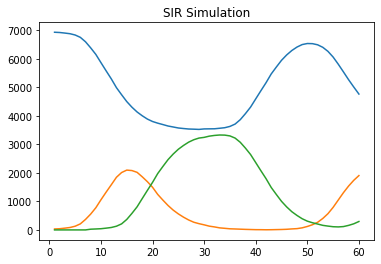

Giorno 60 :
Suscettibili: 4761
Infetti: 1904
Guariti: 295
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             183 |
|      2 |   4949 |             132 |
|      3 |   3401 |             109 |
|      4 |    166 |              82 |
|      5 |   6136 |              78 |
|      6 |   2447 |              57 |
|      7 |    581 |              57 |
|      8 |   1924 |              54 |
|      9 |   5842 |              53 |
|     10 |   1103 |              46 |
|     11 |   4406 |              39 |
|     12 |   3706 |              38 |
|     13 |   2352 |              38 |
|     14 |   3285 |              36 |
|     15 |     93 |              36 |
+--------+--------+-----------------+


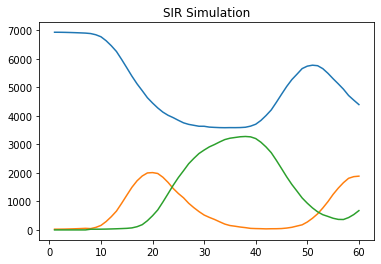

Giorno 60 :
Suscettibili: 4397
Infetti: 1886
Guariti: 677
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             172 |
|      2 |   4949 |             140 |
|      3 |   3401 |             118 |
|      4 |   5842 |             104 |
|      5 |    581 |              76 |
|      6 |   6136 |              72 |
|      7 |    166 |              70 |
|      8 |   1924 |              68 |
|      9 |   4196 |              53 |
|     10 |   1103 |              52 |
|     11 |   2732 |              50 |
|     12 |   2447 |              45 |
|     13 |   4016 |              44 |
|     14 |   3706 |              43 |
|     15 |   2481 |              38 |
+--------+--------+-----------------+


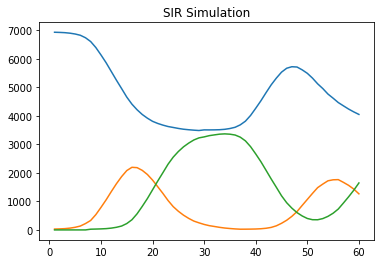

Giorno 60 :
Suscettibili: 4049
Infetti: 1265
Guariti: 1646
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             167 |
|      2 |   4949 |             152 |
|      3 |   3401 |             106 |
|      4 |    166 |              85 |
|      5 |   2732 |              67 |
|      6 |   2447 |              61 |
|      7 |   6136 |              60 |
|      8 |   1924 |              59 |
|      9 |   1103 |              57 |
|     10 |    581 |              57 |
|     11 |   5842 |              54 |
|     12 |   3706 |              45 |
|     13 |   3285 |              43 |
|     14 |   2481 |              42 |
|     15 |   4406 |              38 |
+--------+--------+-----------------+


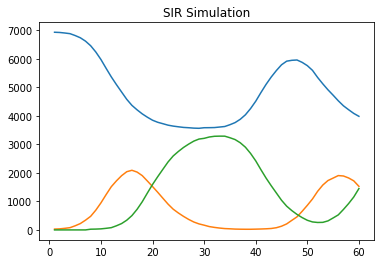

Giorno 60 :
Suscettibili: 3983
Infetti: 1528
Guariti: 1449
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             195 |
|      2 |   4949 |             153 |
|      3 |   3401 |             110 |
|      4 |   5842 |              90 |
|      5 |   6136 |              82 |
|      6 |    166 |              69 |
|      7 |   1924 |              53 |
|      8 |   2732 |              49 |
|      9 |    581 |              45 |
|     10 |   1103 |              41 |
|     11 |   2447 |              37 |
|     12 |   1598 |              36 |
|     13 |   1883 |              34 |
|     14 |   4196 |              33 |
|     15 |    675 |              32 |
+--------+--------+-----------------+


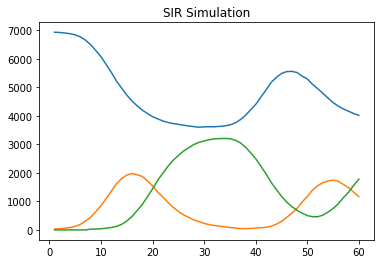

Giorno 60 :
Suscettibili: 4015
Infetti: 1165
Guariti: 1780
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             162 |
|      2 |   4949 |             146 |
|      3 |   3401 |              95 |
|      4 |   5842 |              74 |
|      5 |    166 |              70 |
|      6 |    581 |              69 |
|      7 |   6136 |              69 |
|      8 |   1924 |              59 |
|      9 |   1103 |              56 |
|     10 |   2732 |              52 |
|     11 |   4016 |              50 |
|     12 |   2447 |              45 |
|     13 |   3706 |              40 |
|     14 |   3902 |              38 |
|     15 |   3285 |              36 |
+--------+--------+-----------------+


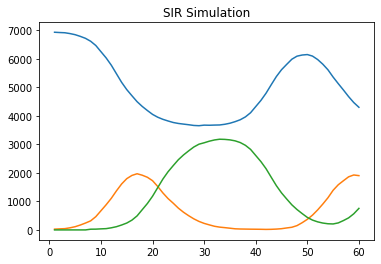

Giorno 60 :
Suscettibili: 4301
Infetti: 1904
Guariti: 755
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             178 |
|      2 |   4949 |             138 |
|      3 |   3401 |             135 |
|      4 |   6136 |              83 |
|      5 |   1924 |              79 |
|      6 |   5842 |              66 |
|      7 |   1103 |              63 |
|      8 |   2732 |              54 |
|      9 |    581 |              54 |
|     10 |    166 |              46 |
|     11 |   4196 |              44 |
|     12 |   3706 |              44 |
|     13 |   3285 |              43 |
|     14 |   2447 |              38 |
|     15 |   2481 |              36 |
+--------+--------+-----------------+


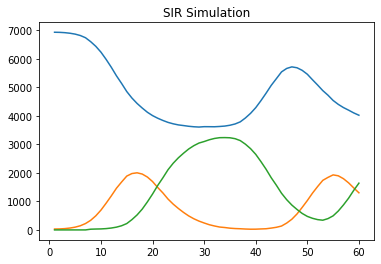

Giorno 60 :
Suscettibili: 4020
Infetti: 1301
Guariti: 1639
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             184 |
|      2 |   4949 |             153 |
|      3 |   3401 |             103 |
|      4 |    166 |              78 |
|      5 |   6136 |              66 |
|      6 |   1103 |              65 |
|      7 |   1924 |              63 |
|      8 |   5842 |              59 |
|      9 |    581 |              55 |
|     10 |   2447 |              50 |
|     11 |   4016 |              50 |
|     12 |   4196 |              46 |
|     13 |   2732 |              44 |
|     14 |   2345 |              42 |
|     15 |   4406 |              41 |
+--------+--------+-----------------+


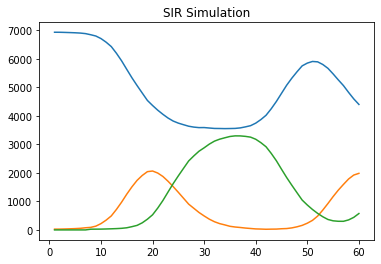

Giorno 60 :
Suscettibili: 4401
Infetti: 1984
Guariti: 575
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             179 |
|      2 |   4949 |             140 |
|      3 |   6136 |              98 |
|      4 |   3401 |              91 |
|      5 |    166 |              71 |
|      6 |   5842 |              71 |
|      7 |   1924 |              70 |
|      8 |   2732 |              59 |
|      9 |   1103 |              56 |
|     10 |   2447 |              51 |
|     11 |    581 |              47 |
|     12 |   3706 |              45 |
|     13 |   4016 |              44 |
|     14 |   3285 |              39 |
|     15 |   1598 |              39 |
+--------+--------+-----------------+


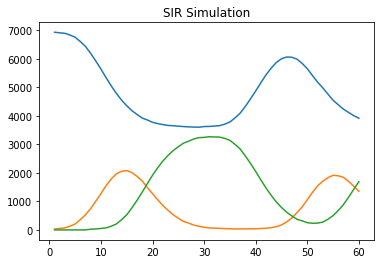

Giorno 60 :
Suscettibili: 3915
Infetti: 1356
Guariti: 1689
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             178 |
|      2 |   1773 |             170 |
|      3 |   3401 |              90 |
|      4 |   6136 |              82 |
|      5 |    166 |              71 |
|      6 |   5842 |              71 |
|      7 |   2732 |              65 |
|      8 |   1924 |              63 |
|      9 |    581 |              60 |
|     10 |   1103 |              49 |
|     11 |   4016 |              48 |
|     12 |   4196 |              43 |
|     13 |   3706 |              42 |
|     14 |   5269 |              39 |
|     15 |   2447 |              38 |
+--------+--------+-----------------+


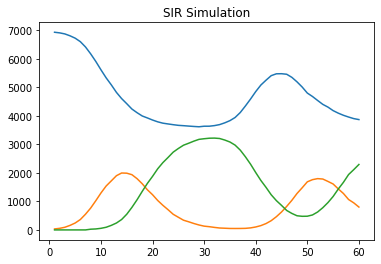

Giorno 60 :
Suscettibili: 3866
Infetti: 801
Guariti: 2293
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             158 |
|      2 |   4949 |             132 |
|      3 |   6136 |             104 |
|      4 |   3401 |             102 |
|      5 |   1924 |              81 |
|      6 |   5842 |              76 |
|      7 |    166 |              65 |
|      8 |    581 |              63 |
|      9 |   1103 |              61 |
|     10 |   2732 |              59 |
|     11 |   2447 |              49 |
|     12 |   2481 |              40 |
|     13 |   1598 |              37 |
|     14 |   2345 |              36 |
|     15 |    675 |              35 |
+--------+--------+-----------------+


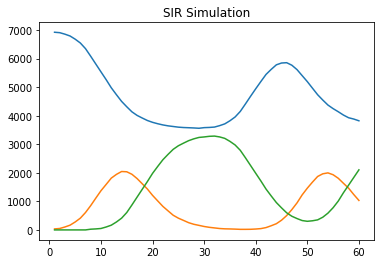

Giorno 60 :
Suscettibili: 3823
Infetti: 1033
Guariti: 2104
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             162 |
|      2 |   4949 |             147 |
|      3 |   3401 |              95 |
|      4 |   5842 |              86 |
|      5 |   6136 |              83 |
|      6 |    166 |              66 |
|      7 |   1924 |              64 |
|      8 |    581 |              63 |
|      9 |   2732 |              57 |
|     10 |   1103 |              53 |
|     11 |   2447 |              49 |
|     12 |   4196 |              41 |
|     13 |   4406 |              40 |
|     14 |   4016 |              36 |
|     15 |   5945 |              33 |
+--------+--------+-----------------+


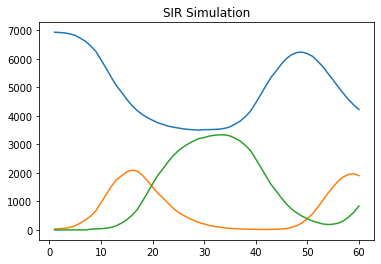

Giorno 60 :
Suscettibili: 4220
Infetti: 1903
Guariti: 837
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             176 |
|      2 |   4949 |             149 |
|      3 |   3401 |             121 |
|      4 |    166 |              94 |
|      5 |   6136 |              78 |
|      6 |   5842 |              72 |
|      7 |   2447 |              60 |
|      8 |    581 |              53 |
|      9 |   1924 |              51 |
|     10 |   2732 |              49 |
|     11 |   2781 |              40 |
|     12 |    675 |              39 |
|     13 |   1103 |              39 |
|     14 |   2887 |              38 |
|     15 |   3706 |              38 |
+--------+--------+-----------------+


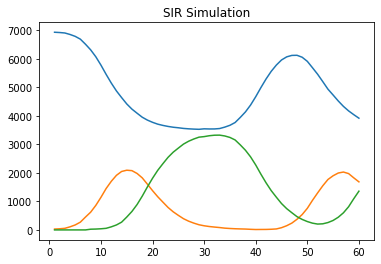

Giorno 60 :
Suscettibili: 3917
Infetti: 1685
Guariti: 1358
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             184 |
|      2 |   4949 |             161 |
|      3 |   3401 |             111 |
|      4 |    581 |              74 |
|      5 |    166 |              72 |
|      6 |   6136 |              71 |
|      7 |   5842 |              70 |
|      8 |   1924 |              64 |
|      9 |   4016 |              55 |
|     10 |   2732 |              53 |
|     11 |   2447 |              46 |
|     12 |   1103 |              45 |
|     13 |   3706 |              45 |
|     14 |   4196 |              44 |
|     15 |   2481 |              40 |
+--------+--------+-----------------+


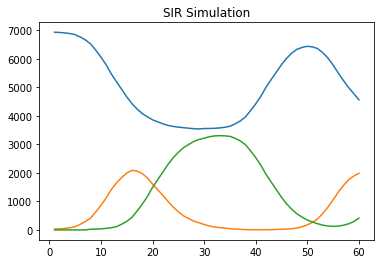

Giorno 60 :
Suscettibili: 4561
Infetti: 1986
Guariti: 413
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             178 |
|      2 |   1773 |             138 |
|      3 |   3401 |              91 |
|      4 |    166 |              87 |
|      5 |   6136 |              71 |
|      6 |   2732 |              63 |
|      7 |    581 |              62 |
|      8 |   5842 |              58 |
|      9 |   1924 |              56 |
|     10 |   3706 |              46 |
|     11 |   2447 |              44 |
|     12 |   1103 |              41 |
|     13 |   3285 |              40 |
|     14 |     93 |              40 |
|     15 |   4196 |              38 |
+--------+--------+-----------------+


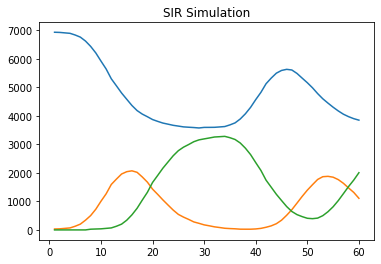

Giorno 60 :
Suscettibili: 3847
Infetti: 1108
Guariti: 2005
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             173 |
|      2 |   1773 |             159 |
|      3 |   3401 |             115 |
|      4 |   6136 |             102 |
|      5 |   5842 |              63 |
|      6 |    166 |              63 |
|      7 |   1924 |              62 |
|      8 |    581 |              53 |
|      9 |   2732 |              53 |
|     10 |   2447 |              47 |
|     11 |   1103 |              46 |
|     12 |   5269 |              39 |
|     13 |   4196 |              38 |
|     14 |   4406 |              38 |
|     15 |   4016 |              37 |
+--------+--------+-----------------+


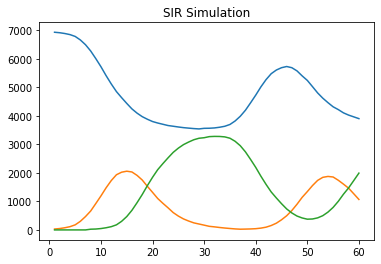

Giorno 60 :
Suscettibili: 3901
Infetti: 1068
Guariti: 1991
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             174 |
|      2 |   1773 |             163 |
|      3 |   3401 |             125 |
|      4 |   6136 |              92 |
|      5 |    581 |              77 |
|      6 |    166 |              73 |
|      7 |   5842 |              67 |
|      8 |   1924 |              63 |
|      9 |   2732 |              51 |
|     10 |   1103 |              48 |
|     11 |   2481 |              45 |
|     12 |   4196 |              43 |
|     13 |   2352 |              42 |
|     14 |   3706 |              38 |
|     15 |   4406 |              38 |
+--------+--------+-----------------+


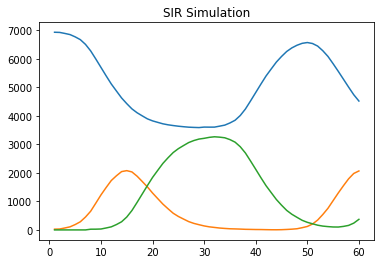

Giorno 60 :
Suscettibili: 4521
Infetti: 2068
Guariti: 371
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             162 |
|      2 |   4949 |             138 |
|      3 |   6136 |             101 |
|      4 |   3401 |             100 |
|      5 |   5842 |              83 |
|      6 |   1924 |              75 |
|      7 |    166 |              60 |
|      8 |   2732 |              60 |
|      9 |   3706 |              51 |
|     10 |   2447 |              51 |
|     11 |    581 |              50 |
|     12 |   4196 |              48 |
|     13 |   1103 |              47 |
|     14 |   3285 |              43 |
|     15 |   5269 |              39 |
+--------+--------+-----------------+


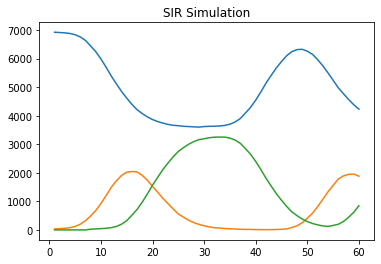

Giorno 60 :
Suscettibili: 4231
Infetti: 1882
Guariti: 847
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             170 |
|      2 |   4949 |             166 |
|      3 |   3401 |             132 |
|      4 |   6136 |              73 |
|      5 |    166 |              70 |
|      6 |   2447 |              68 |
|      7 |   5842 |              63 |
|      8 |   1103 |              58 |
|      9 |   2732 |              57 |
|     10 |   1924 |              54 |
|     11 |    581 |              48 |
|     12 |   4016 |              43 |
|     13 |   3285 |              43 |
|     14 |   3902 |              38 |
|     15 |   4406 |              37 |
+--------+--------+-----------------+


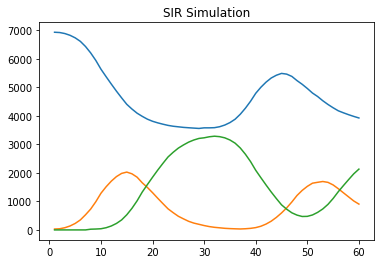

Giorno 60 :
Suscettibili: 3924
Infetti: 905
Guariti: 2131
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             174 |
|      2 |   4949 |             160 |
|      3 |   3401 |             103 |
|      4 |   6136 |             102 |
|      5 |   1924 |              68 |
|      6 |    166 |              65 |
|      7 |   5842 |              64 |
|      8 |   2732 |              56 |
|      9 |    581 |              55 |
|     10 |   1103 |              51 |
|     11 |   2447 |              47 |
|     12 |   3706 |              46 |
|     13 |   4016 |              38 |
|     14 |   4196 |              34 |
|     15 |   2481 |              29 |
+--------+--------+-----------------+


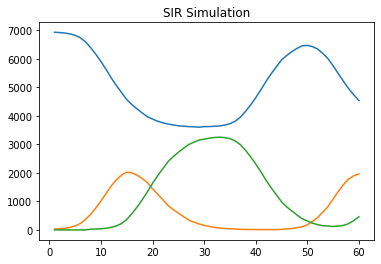

Giorno 60 :
Suscettibili: 4535
Infetti: 1963
Guariti: 462
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             167 |
|      2 |   4949 |             150 |
|      3 |   3401 |             108 |
|      4 |   6136 |              90 |
|      5 |    166 |              74 |
|      6 |   1924 |              62 |
|      7 |    581 |              59 |
|      8 |   5842 |              59 |
|      9 |   1103 |              48 |
|     10 |   2732 |              48 |
|     11 |   4016 |              45 |
|     12 |   4196 |              45 |
|     13 |   3706 |              42 |
|     14 |   2447 |              40 |
|     15 |   3285 |              36 |
+--------+--------+-----------------+


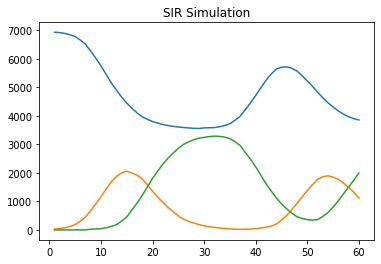

Giorno 60 :
Suscettibili: 3852
Infetti: 1115
Guariti: 1993
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             173 |
|      2 |   4949 |             152 |
|      3 |   3401 |             101 |
|      4 |   6136 |              86 |
|      5 |   5842 |              83 |
|      6 |   2732 |              69 |
|      7 |    581 |              66 |
|      8 |    166 |              57 |
|      9 |   1924 |              56 |
|     10 |   4196 |              53 |
|     11 |   2447 |              44 |
|     12 |   1103 |              42 |
|     13 |   2466 |              42 |
|     14 |   3285 |              38 |
|     15 |   4016 |              36 |
+--------+--------+-----------------+


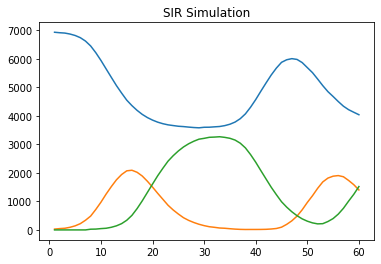

Giorno 60 :
Suscettibili: 4039
Infetti: 1401
Guariti: 1520
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             191 |
|      2 |   4949 |             180 |
|      3 |   3401 |             114 |
|      4 |   6136 |              80 |
|      5 |   5842 |              76 |
|      6 |    166 |              65 |
|      7 |   1924 |              56 |
|      8 |   2732 |              54 |
|      9 |   2447 |              53 |
|     10 |   4196 |              49 |
|     11 |    581 |              49 |
|     12 |   4016 |              42 |
|     13 |   3706 |              41 |
|     14 |   1598 |              38 |
|     15 |   2352 |              37 |
+--------+--------+-----------------+


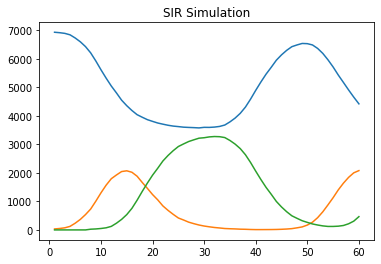

Giorno 60 :
Suscettibili: 4417
Infetti: 2078
Guariti: 465
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             168 |
|      2 |   4949 |             159 |
|      3 |   3401 |             117 |
|      4 |    166 |              93 |
|      5 |   5842 |              82 |
|      6 |   6136 |              79 |
|      7 |   2447 |              73 |
|      8 |   1924 |              59 |
|      9 |   1103 |              54 |
|     10 |   2732 |              48 |
|     11 |   3706 |              48 |
|     12 |   4016 |              46 |
|     13 |   2481 |              45 |
|     14 |    581 |              40 |
|     15 |   3285 |              38 |
+--------+--------+-----------------+


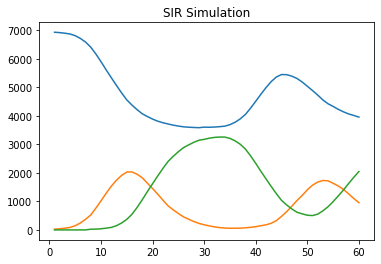

Giorno 60 :
Suscettibili: 3956
Infetti: 956
Guariti: 2048
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             168 |
|      2 |   4949 |             158 |
|      3 |   3401 |              84 |
|      4 |   6136 |              82 |
|      5 |    166 |              65 |
|      6 |    581 |              62 |
|      7 |   2732 |              53 |
|      8 |   5842 |              52 |
|      9 |   1103 |              49 |
|     10 |   4016 |              48 |
|     11 |   2447 |              48 |
|     12 |   1924 |              47 |
|     13 |   1598 |              42 |
|     14 |   3706 |              40 |
|     15 |   2481 |              36 |
+--------+--------+-----------------+


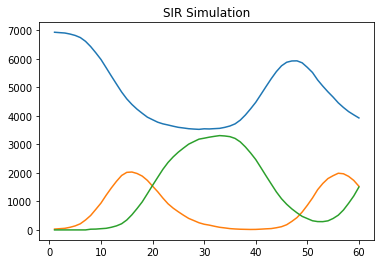

Giorno 60 :
Suscettibili: 3926
Infetti: 1531
Guariti: 1503
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             159 |
|      2 |   1773 |             155 |
|      3 |   3401 |              93 |
|      4 |    166 |              83 |
|      5 |    581 |              82 |
|      6 |   6136 |              81 |
|      7 |   1924 |              69 |
|      8 |   2447 |              66 |
|      9 |   5842 |              64 |
|     10 |   4196 |              60 |
|     11 |   2481 |              50 |
|     12 |   2732 |              45 |
|     13 |   1103 |              43 |
|     14 |   3285 |              41 |
|     15 |   1598 |              37 |
+--------+--------+-----------------+


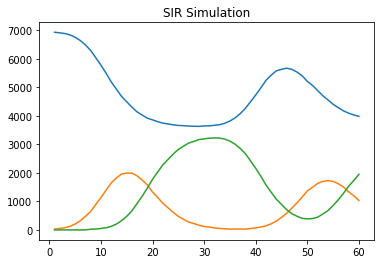

Giorno 60 :
Suscettibili: 3979
Infetti: 1030
Guariti: 1951
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             189 |
|      2 |   4949 |             134 |
|      3 |   3401 |              99 |
|      4 |   6136 |              90 |
|      5 |    166 |              76 |
|      6 |   5842 |              66 |
|      7 |    581 |              61 |
|      8 |   2732 |              58 |
|      9 |   1924 |              56 |
|     10 |   1103 |              48 |
|     11 |   2447 |              44 |
|     12 |   3706 |              42 |
|     13 |   1598 |              42 |
|     14 |   4016 |              41 |
|     15 |   4196 |              41 |
+--------+--------+-----------------+


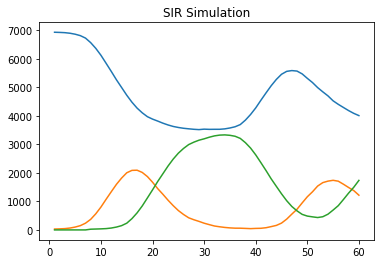

Giorno 60 :
Suscettibili: 4007
Infetti: 1217
Guariti: 1736
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             165 |
|      2 |   4949 |             149 |
|      3 |   3401 |              86 |
|      4 |   6136 |              76 |
|      5 |    581 |              63 |
|      6 |   1924 |              58 |
|      7 |    166 |              53 |
|      8 |   5842 |              53 |
|      9 |   4196 |              50 |
|     10 |   2732 |              49 |
|     11 |   4406 |              49 |
|     12 |   2447 |              49 |
|     13 |   1103 |              47 |
|     14 |   4016 |              46 |
|     15 |   1598 |              42 |
+--------+--------+-----------------+


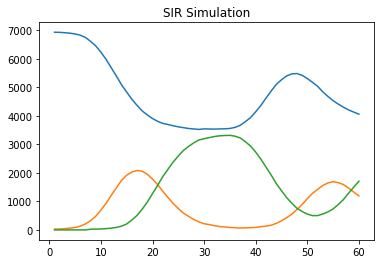

Giorno 60 :
Suscettibili: 4058
Infetti: 1193
Guariti: 1709
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             187 |
|      2 |   4949 |             126 |
|      3 |   3401 |             101 |
|      4 |   6136 |              85 |
|      5 |    166 |              77 |
|      6 |   1103 |              72 |
|      7 |   5842 |              64 |
|      8 |    581 |              58 |
|      9 |   1924 |              51 |
|     10 |   2732 |              51 |
|     11 |   4196 |              48 |
|     12 |   2447 |              44 |
|     13 |   3285 |              39 |
|     14 |   5269 |              38 |
|     15 |   4016 |              38 |
+--------+--------+-----------------+


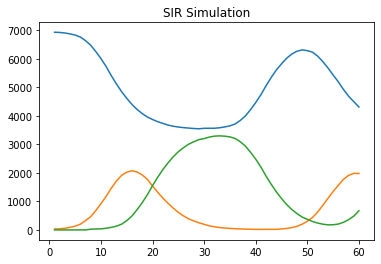

Giorno 60 :
Suscettibili: 4309
Infetti: 1980
Guariti: 671
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             183 |
|      2 |   4949 |             174 |
|      3 |   3401 |             105 |
|      4 |   6136 |              80 |
|      5 |   5842 |              79 |
|      6 |    581 |              67 |
|      7 |   1924 |              66 |
|      8 |   2732 |              66 |
|      9 |    166 |              65 |
|     10 |   1103 |              51 |
|     11 |   3706 |              44 |
|     12 |   2447 |              43 |
|     13 |   3285 |              42 |
|     14 |   1598 |              39 |
|     15 |   2481 |              37 |
+--------+--------+-----------------+


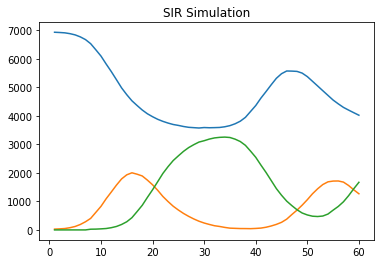

Giorno 60 :
Suscettibili: 4022
Infetti: 1268
Guariti: 1670
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             172 |
|      2 |   4949 |             133 |
|      3 |   3401 |             111 |
|      4 |   6136 |              95 |
|      5 |    166 |              93 |
|      6 |   1924 |              73 |
|      7 |   5842 |              61 |
|      8 |    581 |              59 |
|      9 |   1103 |              55 |
|     10 |   2447 |              54 |
|     11 |   2732 |              48 |
|     12 |   3285 |              40 |
|     13 |   3706 |              38 |
|     14 |   2481 |              37 |
|     15 |   5428 |              36 |
+--------+--------+-----------------+


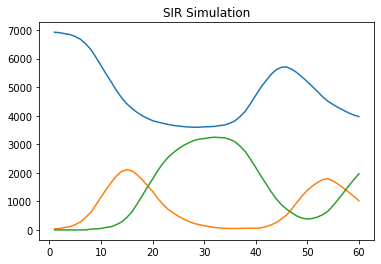

Giorno 60 :
Suscettibili: 3971
Infetti: 1022
Guariti: 1967
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             169 |
|      2 |   4949 |             163 |
|      3 |   3401 |             100 |
|      4 |    166 |              90 |
|      5 |   6136 |              84 |
|      6 |   5842 |              83 |
|      7 |    581 |              66 |
|      8 |   2732 |              59 |
|      9 |   1924 |              58 |
|     10 |   2447 |              58 |
|     11 |   1103 |              53 |
|     12 |   4016 |              47 |
|     13 |   3706 |              40 |
|     14 |   3902 |              37 |
|     15 |   2481 |              35 |
+--------+--------+-----------------+


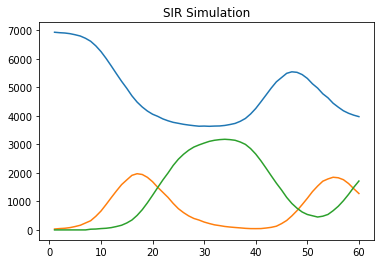

Giorno 60 :
Suscettibili: 3971
Infetti: 1276
Guariti: 1713
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             165 |
|      2 |   1773 |             156 |
|      3 |   3401 |             100 |
|      4 |   6136 |              75 |
|      5 |   5842 |              69 |
|      6 |    166 |              64 |
|      7 |   1924 |              60 |
|      8 |   2447 |              58 |
|      9 |   2732 |              48 |
|     10 |   4406 |              45 |
|     11 |    581 |              45 |
|     12 |   1103 |              42 |
|     13 |   4016 |              41 |
|     14 |     93 |              37 |
|     15 |   3285 |              37 |
+--------+--------+-----------------+


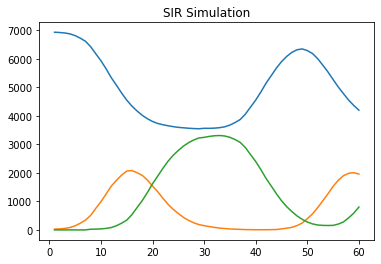

Giorno 60 :
Suscettibili: 4199
Infetti: 1959
Guariti: 802
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             193 |
|      2 |   4949 |             166 |
|      3 |   3401 |             116 |
|      4 |   1924 |              93 |
|      5 |    581 |              71 |
|      6 |    166 |              68 |
|      7 |   6136 |              64 |
|      8 |   5842 |              57 |
|      9 |   2447 |              55 |
|     10 |   1103 |              54 |
|     11 |   4016 |              51 |
|     12 |   2732 |              50 |
|     13 |   4196 |              41 |
|     14 |   1883 |              35 |
|     15 |   3706 |              35 |
+--------+--------+-----------------+


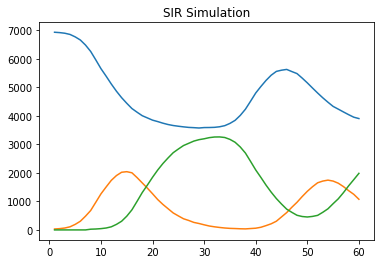

Giorno 60 :
Suscettibili: 3903
Infetti: 1074
Guariti: 1983
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   4949 |             169 |
|      2 |   1773 |             166 |
|      3 |   3401 |             125 |
|      4 |   6136 |              94 |
|      5 |    166 |              82 |
|      6 |   1924 |              67 |
|      7 |   5842 |              61 |
|      8 |    581 |              59 |
|      9 |   1103 |              49 |
|     10 |   2447 |              45 |
|     11 |   2732 |              45 |
|     12 |     93 |              44 |
|     13 |   3706 |              43 |
|     14 |   2481 |              42 |
|     15 |   5269 |              37 |
+--------+--------+-----------------+


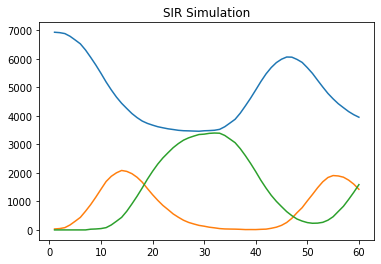

Giorno 60 :
Suscettibili: 3949
Infetti: 1424
Guariti: 1587
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             173 |
|      2 |   4949 |             165 |
|      3 |    166 |             100 |
|      4 |   6136 |              91 |
|      5 |   3401 |              83 |
|      6 |   5842 |              81 |
|      7 |   2732 |              72 |
|      8 |   1924 |              61 |
|      9 |    581 |              61 |
|     10 |   2447 |              58 |
|     11 |   4016 |              53 |
|     12 |   4406 |              40 |
|     13 |    675 |              40 |
|     14 |   1103 |              38 |
|     15 |   3706 |              38 |
+--------+--------+-----------------+


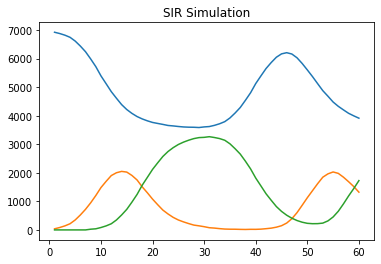

Giorno 60 :
Suscettibili: 3912
Infetti: 1322
Guariti: 1726
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             175 |
|      2 |   4949 |             160 |
|      3 |   3401 |             111 |
|      4 |   5842 |              97 |
|      5 |    166 |              72 |
|      6 |   6136 |              65 |
|      7 |    581 |              60 |
|      8 |   1924 |              58 |
|      9 |   2732 |              57 |
|     10 |   1103 |              52 |
|     11 |   2447 |              45 |
|     12 |   3706 |              44 |
|     13 |   3902 |              43 |
|     14 |   4196 |              40 |
|     15 |   3285 |              40 |
+--------+--------+-----------------+


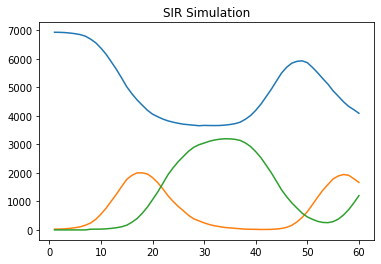

Giorno 60 :
Suscettibili: 4092
Infetti: 1667
Guariti: 1201
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             172 |
|      2 |   4949 |             159 |
|      3 |   3401 |             128 |
|      4 |   6136 |              77 |
|      5 |   5842 |              72 |
|      6 |    581 |              64 |
|      7 |   1103 |              62 |
|      8 |    166 |              60 |
|      9 |   1924 |              59 |
|     10 |   2447 |              49 |
|     11 |   3285 |              43 |
|     12 |   2345 |              42 |
|     13 |   1598 |              39 |
|     14 |   5269 |              38 |
|     15 |   2481 |              37 |
+--------+--------+-----------------+


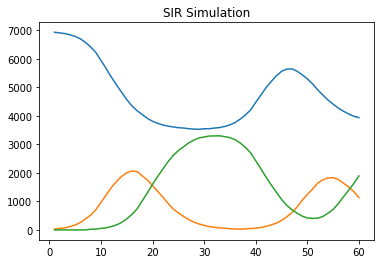

Giorno 60 :
Suscettibili: 3937
Infetti: 1131
Guariti: 1892
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             153 |
|      2 |   4949 |             132 |
|      3 |   3401 |             114 |
|      4 |   6136 |              78 |
|      5 |   1924 |              71 |
|      6 |    166 |              64 |
|      7 |    581 |              60 |
|      8 |   2732 |              58 |
|      9 |   5842 |              48 |
|     10 |   1103 |              48 |
|     11 |   3706 |              42 |
|     12 |   4406 |              42 |
|     13 |   2447 |              41 |
|     14 |   1598 |              39 |
|     15 |   2481 |              37 |
+--------+--------+-----------------+


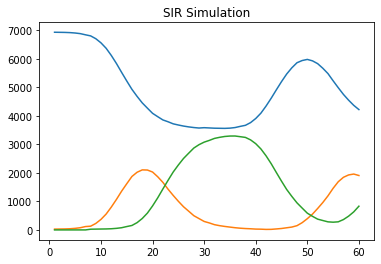

Giorno 60 :
Suscettibili: 4220
Infetti: 1908
Guariti: 832
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             170 |
|      2 |   4949 |             164 |
|      3 |   3401 |             125 |
|      4 |   5842 |              91 |
|      5 |    166 |              87 |
|      6 |   6136 |              61 |
|      7 |   1103 |              60 |
|      8 |   2732 |              52 |
|      9 |   1924 |              50 |
|     10 |   2447 |              49 |
|     11 |   4016 |              45 |
|     12 |   1598 |              45 |
|     13 |   4406 |              43 |
|     14 |   3706 |              40 |
|     15 |   5428 |              36 |
+--------+--------+-----------------+


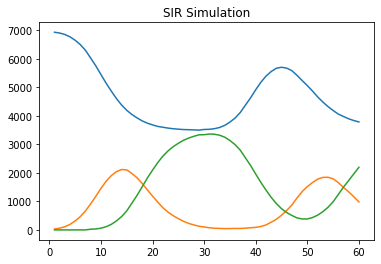

Giorno 60 :
Suscettibili: 3784
Infetti: 982
Guariti: 2194
+--------+--------+-----------------+
|   RANK |   NODE |   SPREAD_COUNTS |
|--------+--------+-----------------|
|      1 |   1773 |             191 |
|      2 |   4949 |             164 |
|      3 |   3401 |             110 |
|      4 |   6136 |              79 |
|      5 |    581 |              76 |
|      6 |    166 |              72 |
|      7 |   5842 |              69 |
|      8 |   2732 |              59 |
|      9 |   1924 |              54 |
|     10 |   4016 |              51 |
|     11 |   2447 |              48 |
|     12 |   1103 |              47 |
|     13 |   4196 |              45 |
|     14 |   3285 |              37 |
|     15 |   4406 |              34 |
+--------+--------+-----------------+
+--------+--------+-------------+
|   RANK |   NODE |   FREQUENCY |
|--------+--------+-------------|
|      1 |   1773 |         300 |
|      2 |    166 |         300 |
|      3 |   6136 |         300 |
|      4 |   494

In [9]:
#input parametri simulazione:p_trans, t_rec, t_sus, t_sim, num_sim
random_simulation(25, 'musae_ENGB_edges.csv', ',', 0.02, 7, 21, 60, 300)

HEATMAP DELLE METRICHE DI CENTRALITA E TOP NODI

In [ ]:
import centralitynodes

In [ ]:
fb = getNetwork('facebook_combined.csv', ' ')
tw = getNetwork('musae_ENGB_edges.csv', ' ')

In [ ]:
heatmap_centrality(fb, 'betweenness centrality')
heatmap_centrality(fb, 'closeness centrality')
heatmap_centrality(fb, 'eigenvector centrality')
heatmap_centrality(fb, 'degree centrality')

In [ ]:
heatmap_centrality(tw, 'betweenness centrality')
heatmap_centrality(tw, 'closeness centrality')
heatmap_centrality(tw, 'eigenvector centrality')
heatmap_centrality(tw, 'degree centrality')

In [ ]:
top_centrality_node(fb)
top_centrality_node(tw)

+----+------+------+------+------+------+
|    |   BC |   CC |   EC |   DC |   VR |
|----+------+------+------+------+------|
|  1 |  107 |  107 | 1912 |  107 |  107 |
|  2 | 1684 |   58 | 2266 | 1684 | 1684 |
|  3 | 3437 |  428 | 2206 | 1912 | 1912 |
|  4 | 1912 |  563 | 2233 | 3437 | 3437 |
|  5 | 1085 | 1684 | 2464 |    0 |    0 |
|  6 |    0 |  171 | 2142 | 2543 | 2543 |
|  7 |  698 |  348 | 2218 | 2347 | 2347 |
|  8 |  567 |  483 | 2078 | 1888 | 1888 |
|  9 |   58 |  414 | 2123 | 1800 | 1800 |
| 10 |  428 |  376 | 1993 | 1663 |  348 |
| 11 |  563 |  475 | 2410 | 2266 |  483 |
| 12 |  860 |  566 | 2244 | 1352 | 2266 |
| 13 |  414 | 1666 | 2507 |  483 | 1663 |
| 14 | 1577 | 1534 | 2240 |  348 | 1352 |
| 15 |  348 |  484 | 2340 | 1730 | 1941 |
+----+------+------+------+------+------+


/content/NetworkSIR.py:278: FutureWarning: Passing 'suffixes' which cause duplicate columns {'node_x'} in the result is deprecated and will raise a MergeError in a future version.
  ss =pd.merge(ss, DC, left_index=True, right_index=True)
